In [2]:
import torch
import torchvision
import matplotlib.pyplot as plt
from tqdm import tqdm
from torchvision import datasets, transforms
import scipy
import numpy as np
import pandas as pd
import copy
import statsmodels.api as sm
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.tensorboard import SummaryWriter
import time
import os
import math
%env WANDB_API_KEY=34e59dda416003a2ce211c0c800924effb78801a
import wandb
wandb.login(key=os.environ["WANDB_API_KEY"])
import traceback

env: WANDB_API_KEY=34e59dda416003a2ce211c0c800924effb78801a


Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Currently logged in as: pvn2106. Use `wandb login --relogin` to force relogin
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: /Users/philipnielsen/.netrc


In [2]:
!PYTORCH_ENABLE_MPS_FALLBACK=1
device = torch.device("cuda:0" if torch.cuda.is_available() else ('mps' if torch.backends.mps.is_available() else "cpu"))
print(device)

mps


/Users/philipnielsen/anaconda3/lib/python3.11/pty.py:89: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid, fd = os.forkpty()


In [3]:
def load_MNIST():
    transform = transforms.Compose([transforms.ToTensor(),
                                transforms.Normalize((0.1307,), (0.3081,)),
                                ])

    # transform = transforms.Compose([transforms.ToTensor()
    #                               ])

    train_dataset = datasets.MNIST('./mnist/MNIST_data/', download=True, train=True, transform=transform)
    test_dataset = datasets.MNIST('./mnist/MNIST_data/', download=True, train=False, transform=transform)

    train_dataloader = torch.utils.data.DataLoader(train_dataset, batch_size=len(train_dataset), shuffle=True)
    test_dataloader = torch.utils.data.DataLoader(test_dataset, batch_size=len(test_dataset), shuffle=True)

    train_dataset = [x for x in train_dataloader]
    test_dataset = [x for x in test_dataloader]
    x_train, y_train = train_dataset[0]
    x_test, y_test = test_dataset[0]
    x_train, y_train, x_test, y_test = x_train.to(device), y_train.to(device), x_test.to(device), y_test.to(device)
    return {'Train': (x_train, y_train), 'Test': (x_test, y_test)}

In [4]:
def load_CIFAR10():
    transform = transforms.Compose(
        [transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

    trainset = torchvision.datasets.CIFAR10(root='./data', train=True,
                                            download=True, transform=transform)
    trainloader = torch.utils.data.DataLoader(trainset, batch_size=len(trainset), shuffle=True)

    testset = torchvision.datasets.CIFAR10(root='./data', train=False,
                                        download=True, transform=transform)
    testloader = torch.utils.data.DataLoader(testset, batch_size=len(testset), shuffle=False)


    train_dataset = [x for x in trainloader]
    test_dataset = [x for x in testloader]
    x_train, y_train = train_dataset[0]
    x_test, y_test = test_dataset[0]
    x_train, y_train, x_test, y_test = x_train.to(device).view(-1,3,32,32), y_train.to(device), x_test.to(device).view(-1,3,32,32), y_test.to(device)

    # classes = ('plane', 'car', 'bird', 'cat',
    #         'deer', 'dog', 'frog', 'horse', 'ship', 'truck')
    return {'Train': (x_train, y_train), 'Test': (x_test, y_test)}

In [5]:
def get_weight_variances(act, q_star_lower = .1, q_star_upper=5, q_star_guesses = 100, num_simulations = 1000000):
    weight_variances = []
    bias_variances = []
    q_star_list = torch.logspace(np.log10(q_star_lower),np.log10(q_star_upper), q_star_guesses)
    z = torch.randn(num_simulations,requires_grad=True)
    for q_star in q_star_list:
        z.grad=torch.zeros_like(z)
        activations = act(z*q_star**.5)
        activations.sum().backward()
        weight_variance = 1/torch.square(z.grad).mean().item()
        bias_variance = (q_star - torch.square(activations).mean()*weight_variance).item()
        weight_variances.append(weight_variance)
        bias_variances.append(bias_variance)
    weight_variances, bias_variances = np.array(weight_variances), np.array(bias_variances)
    allowed_indices = (weight_variances>0)*(bias_variances>0)
    weight_variances, bias_variances = weight_variances[allowed_indices], bias_variances[allowed_indices]
    idx = bias_variances.argmin()
    weight_variance, bias_variance = weight_variances[idx], bias_variances[idx]
    return weight_variance, bias_variance

In [6]:
def residual_htanh(x):
    return nn.functional.hardtanh(x) + x

In [7]:
class FCNetwork(nn.Module):
    def __init__(self, width=200, depth = 5, input_dimensions=(1,28,28), output_size=10, act=residual_htanh):
        super(FCNetwork, self).__init__()
        self.depth = depth
        self.input_size = np.product(input_dimensions)
        self.act = act

        self.layers = nn.ModuleList([nn.Linear(self.input_size,width)] + 
                                            [nn.Linear(width,width) for i in range(depth-2)]
        )
        self.final_layer = nn.Linear(width,output_size)

        weight_var, bias_var = get_weight_variances(self.act)
        for l in self.layers:
            torch.nn.init.orthogonal_(l.weight, gain=np.sqrt(weight_var/l.weight.shape[-1]))
            torch.nn.init.normal_(l.bias.data, std=np.sqrt(bias_var))
        
        torch.nn.init.orthogonal_(self.final_layer.weight, gain=np.sqrt(1/self.final_layer.weight.shape[-1]))
        self.final_layer.bias.data.fill_(0)

    def forward(self, x):
        x = x.view(-1,self.input_size)
        for layer in self.layers:
            x = self.act(layer(x))
        x = self.final_layer(x)
        return x

In [8]:
class CNN(nn.Module):
    def __init__(self, width=200, depth = 5, input_dimensions=(1,28,28), output_size=10, act=residual_htanh):
        super(CNN, self).__init__()
        self.output_size = output_size
        self.depth = depth
        self.input_size = np.product(input_dimensions)
        self.act = act

        self.layers = nn.ModuleList([nn.Conv2d(input_dimensions[0], width, 3)] + 
                                    [nn.Conv2d(width, width, 3) for _ in range(depth-2)]
                                    )
        self.final_layer = nn.Conv2d(width, output_size, 3)
        
    def forward(self, x):
        for layer in self.layers:
            x = self.act(layer(x))
        x = self.final_layer(x).mean(dim=(-1,-2))
        return x

In [9]:
data = load_CIFAR10()

Files already downloaded and verified
Files already downloaded and verified


In [10]:
cnn = CNN(width=4,depth = 2, input_dimensions=(3,32,32)).to(device)
output = cnn(data['Test'][0])
output.var()

/var/folders/y3/v5bw1qds23152m_g_1tzz7q80000gn/T/ipykernel_7022/2688407266.py:1: DeprecationWarning: `product` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `prod` instead.
  cnn = CNN(width=4,depth = 2, input_dimensions=(3,32,32)).to(device)


tensor(0.0498, device='mps:0', grad_fn=<VarBackward0>)

In [11]:
del output

In [12]:
def get_epoch_stats(model, activation, data, objective):
    model.eval()
    epoch_stats_dict = {}
    for split in ['Train', 'Test']:
        x, y = data[split]
        model_preds = activation(model(x))
        epoch_stats_dict[split] = {}
        if 'n' in model_preds:
            evidence = model_preds['n'].mean()
            epoch_stats_dict[split].update({'Evidence': evidence})
        if 'p' in model_preds or 'log_p' in model_preds:
            log_p = model_preds['log_p'] if 'log_p' in model_preds else torch.log(model_preds['p'])
            loss = objective(log_p, y).item()
            pred_label = log_p.max(1, keepdim=True)[1]
            accuracy = (pred_label.eq(y.view_as(pred_label)).sum().item()/y.shape[0])
            epoch_stats_dict[split].update({'Accuracy': accuracy, 'Loss': loss})
    model.train()
    return epoch_stats_dict

In [13]:
def print_stats(epoch, epoch_stats_dict, printed_stats):
    stat_block = "{stat}: {value:.4f}"
    split_stat_string_list = [f'{split} - ' + '  '.join([stat_block.format(stat=stat, value=epoch_stats_dict[split][stat]) for stat in printed_stats]) for split in ['Train', 'Test']]
    print(f'Epoch {epoch} \t' + '  '.join(split_stat_string_list))

In [14]:
def circular_activation(x):
    x_squared = torch.square(x)
    n=x_squared.sum(axis=1, keepdim=True)
    p = x_squared/n
    return {'n': n, 'p': p}

def log_softmax(x):
    log_p = F.log_softmax(x, dim=-1)
    return {'log_p': log_p}

In [15]:
def neg_sqrt_loss(model_preds, y):
    if 'p' in model_preds:
        p = model_preds['p']
    elif 'log_p' in model_preds:
        p = torch.exp(model_preds['log_p'])
    return -torch.sqrt(p[torch.arange(y.shape[0]),y]).mean()

def nll_loss(model_preds, y):
    if 'log_p' in model_preds:
        log_p = model_preds['log_p']
    elif 'p' in model_preds:
        log_p = torch.log(model_preds['p'])
    return nn.functional.nll_loss(log_p, y)

In [16]:
dataset_facts = {'CIFAR10':{'input_dimension':(3,32,32)}, 
                 'MNIST':{'input_dimension': (1,28,28)}
                 }

In [17]:
loaded_dataset_name = None
dataset_loaders = {'MNIST': load_MNIST,
                   'CIFAR10': load_CIFAR10
}

In [18]:
hidden_activation_dict = {'selu': F.selu,
                          'relu': F.relu,
                          'residual_htanh': residual_htanh,
                          'gelu': F.gelu,
                          'tanh': F.tanh,
                          'elu': F.elu,
                          'leaky_relu': F.leaky_relu,
                          'softplus': F.softplus
                          }

output_activation_dict = {'circular_activation': circular_activation,
                          'log_softmax': log_softmax
                          }

training_loss_dict = {'neg_sqrt_loss': neg_sqrt_loss,
                      'nll_loss': nll_loss
                      }

optimizer_dict = {'Adam':torch.optim.Adam,
                  'SGD': torch.optim.SGD
                  }

architecture_dict = {'FC': FCNetwork,
                     'CNN': CNN
                     }

In [19]:
dataset_name = 'CIFAR10'
config = {
    'network_width': 15,
    'network_depth': 4,
    'hidden_activation': 'elu',
    'architecture': 'CNN',
    'activation': ['circular_activation', 'log_softmax'][1],
    'training_loss': ['neg_sqrt_loss', 'nll_loss'][1],
    'learning_rate': 5e-3,
    'batch_size': 125,
    'optimizer': 'Adam',
    'training_time' : float('inf')
    }

if dataset_name != loaded_dataset_name:
    print(f'Loading {dataset_name} data into memory...')
    data = dataset_loaders[dataset_name]()
    print('Loading done')
    loaded_dataset_name = dataset_name

using_wandb = True
printed_stats = ['Accuracy', 'Loss']
epochs_per_stats_print = 1

if using_wandb:
    wandb.init(project=f"evidential-{dataset_name}", config=config)
    config=wandb.config
    
model = architecture_dict[config['architecture']](act = hidden_activation_dict[config['hidden_activation']], 
                  width = config['network_width'], 
                  depth = config['network_depth'], 
                  input_dimensions=dataset_facts[dataset_name]['input_dimension']
                  ).to(device)
optimizer = optimizer_dict[config['optimizer']](model.parameters(), lr=config['learning_rate'])
activation = output_activation_dict[config['activation']]
training_loss = training_loss_dict[config['training_loss']]

x_train_batched, y_train_batched = (torch.split(x_or_y, config['batch_size']) for x_or_y in data['Train'])
best_loss = float('inf')
best_accuracy = 0

epoch = 0

print('Training...')
try:
    timeout = time.time() + config['training_time']
    while True:
        epoch +=1
        for i in range(len(x_train_batched)):
            x_train_batch, y_train_batch = x_train_batched[i], y_train_batched[i]
            x = model(x_train_batch)
            model_preds = activation(x)
            L= training_loss(model_preds, y_train_batch)
            
            optimizer.zero_grad()
            L.backward()
            optimizer.step()
        if time.time()>timeout:
            break
        epoch_stats_dict = get_epoch_stats(model, activation, data, nn.functional.nll_loss)
        if using_wandb:
            wandb.log(epoch_stats_dict)
        test_loss = epoch_stats_dict['Test']['Loss']

        if epoch % epochs_per_stats_print == 0:
            print_stats(epoch, epoch_stats_dict, printed_stats)

        if math.isnan(test_loss):
            break
        
        if test_loss < best_loss:
            best_loss = test_loss
            best_model = copy.deepcopy(model)
    wandb.finish()
    print('finished wandb')
except KeyboardInterrupt:
    if using_wandb:
        wandb.finish()
        print('finished wandb')
except Exception:
    traceback.print_exc()
    if using_wandb:
        wandb.finish()
        print('finished wandb')

Loading CIFAR10 data into memory...
Files already downloaded and verified
Files already downloaded and verified
Loading done


/var/folders/y3/v5bw1qds23152m_g_1tzz7q80000gn/T/ipykernel_7022/396013103.py:29: DeprecationWarning: `product` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `prod` instead.
  model = architecture_dict[config['architecture']](act = hidden_activation_dict[config['hidden_activation']],


Training...


Traceback (most recent call last):
  File "/var/folders/y3/v5bw1qds23152m_g_1tzz7q80000gn/T/ipykernel_7022/396013103.py", line 60, in <module>
    epoch_stats_dict = get_epoch_stats(model, activation, data, nn.functional.nll_loss)
                       ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/var/folders/y3/v5bw1qds23152m_g_1tzz7q80000gn/T/ipykernel_7022/3384374138.py", line 6, in get_epoch_stats
    model_preds = activation(model(x))
                             ^^^^^^^^
  File "/Users/philipnielsen/anaconda3/lib/python3.11/site-packages/torch/nn/modules/module.py", line 1518, in _wrapped_call_impl
    return self._call_impl(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/philipnielsen/anaconda3/lib/python3.11/site-packages/torch/nn/modules/module.py", line 1527, in _call_impl
    return forward_call(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/var/folders/y3/v5bw1qds23152m_g_1tzz7q80000gn/T/ipykernel_

finished wandb


In [20]:
def train(config=None):
    if using_wandb:
        wandb.init(project=f"evidential-{dataset_name}", config=config)
        
        config=wandb.config
    model = FCNetwork(act = hidden_activation_dict[config['hidden_activation']], 
                    width = config['network_width'], 
                    depth = config['network_depth'], 
                    input_dimensions=dataset_facts[dataset_name]['input_dimension']
                    ).to(device)
    optimizer = optimizer_dict[config['optimizer']](model.parameters(), lr=config['learning_rate'])
    activation = output_activation_dict[config['activation']]
    training_loss = training_loss_dict[config['training_loss']]

    x_train_batched, y_train_batched = (torch.split(x_or_y, config['batch_size']) for x_or_y in data['Train'])
    best_models = {'Loss':{'value': float('inf')},
                   'Accuracy':{'value': 0}}
    
    epoch = 0
    print('Training...')
    try:
        timeout = time.time() + config['training_time']
        while True:
            epoch +=1
            for i in range(len(x_train_batched)):
                x_train_batch, y_train_batch = x_train_batched[i], y_train_batched[i]
                x = model(x_train_batch)
                model_preds = activation(x)
                L= training_loss(model_preds, y_train_batch)
                optimizer.zero_grad()
                L.backward()
                optimizer.step()
            if time.time()>timeout:
                break
            epoch_stats_dict = get_epoch_stats(model, activation, data, nn.functional.nll_loss)
            if using_wandb:
                wandb.log(epoch_stats_dict)
            test_loss = epoch_stats_dict['Test']['Loss']

            if epoch % epochs_per_stats_print == 0:
                print_stats(epoch, epoch_stats_dict, printed_stats)

            if math.isnan(test_loss):
                break
            for stat in ['Loss', 'Accuracy']:
                stat_value = epoch_stats_dict['Test'][stat]
                if stat_value < best_models[stat]['value']:
                    best_models[stat]['value'] = stat_value
                    best_models[stat]['model'] = copy.deepcopy(model)
                    wandb.log({f'Best_{stat}': stat_value}, step=epoch)
        wandb.finish()
        print('finished wandb')
    except KeyboardInterrupt:
        if using_wandb:
            wandb.finish()
            print('finished wandb')
    except Exception:
        traceback.print_exc()
        if using_wandb:
            wandb.finish()
            print('finished wandb')

In [21]:
torch.cat([torch.tensor([1,2,3]),torch.tensor([1,2,3])])

tensor([1, 2, 3, 1, 2, 3])

In [9]:
a = torch.tensor([[1,2,3],[4,6,5],[9,8,7]]).to('mps')
b = torch.tensor([[2],[0],[0]]).to('mps')


In [11]:
%timeit a.argmax(dim=-1,keepdim=True).eq(b)

47 µs ± 1.92 µs per loop (mean ± std. dev. of 7 runs, 10,000 loops each)


In [13]:
torch.vstack([a,a])

tensor([[1, 2, 3],
        [4, 6, 5],
        [9, 8, 7],
        [1, 2, 3],
        [4, 6, 5],
        [9, 8, 7]], device='mps:0')

In [16]:
import math

In [17]:
math.isnan(torch.log(torch.tensor([-1])))

True

In [22]:
dataset_name = 'CIFAR10'
config = {
    'network_width': 200,
    'network_depth': 5,
    'hidden_activation': 'selu',
    'activation': ['circular_activation', 'log_softmax'][1],
    'training_loss': ['neg_sqrt_loss', 'nll_loss'][1],
    'learning_rate': 1e-5,
    'batch_size': 1000,
    'optimizer': 'Adam',
    'training_time' : float('inf')
    }

if dataset_name != loaded_dataset_name:
    print(f'Loading {dataset_name} data into memory...')
    data = dataset_loaders[dataset_name]()
    print('Loading done')
    loaded_dataset_name = dataset_name

using_wandb = True
printed_stats = ['Accuracy', 'Loss']
epochs_per_stats_print = 1

train(config=config)

Problem at: /Users/philipnielsen/anaconda3/lib/python3.11/site-packages/wandb/sdk/wandb_init.py 852 getcaller


KeyboardInterrupt: 

In [ ]:
wandb.finish()

In [ ]:
sweep_config = {
    'method': 'bayes'
    }
metric = {
    'name': 'Best_Loss',
    'goal': 'minimize'   
    }

sweep_config['metric'] = metric

parameters_dict = {
    'network_width': {
        'values': [50, 100, 200, 250, 300, 400, 500, 750]
        },
    'network_depth': {
        'values': [3, 4, 5, 6, 7, 8, 9, 10, 12, 15, 20, 25]
        },
    'hidden_activation': {
          'values': ['selu', 'relu', 'residual_htanh', 'gelu', 'tanh', 'elu', 'leaky_relu', 'softplus']
        },
    'activation': {
          'values': ['circular_activation', 'log_softmax']
        },
    'training_loss': {
          'values': ['neg_sqrt_loss', 'nll_loss']
        },
    'learning_rate': {
          'values': [1e-2, 3e-2, 1e-3, 3e-3, 1e-4, 3e-4, 1e-5, 3e-5, 1e-6, 3e-6]
        },
    'batch_size': {
          'values': [10, 25, 50, 100, 250, 500, 1000, 2500, 5000, 10000, 25000, 50000]
        },
    }

parameters_dict.update({
    'optimizer': {
        'value': 'Adam'},
    'training_time': {
        'value': 120},
    })

sweep_config['parameters'] = parameters_dict
sweep_id = wandb.sweep(sweep_config, project=f'evidential-{dataset_name}')
wandb.agent(sweep_id, train, count=100000)

Create sweep with ID: 8040ksxd
Sweep URL: https://wandb.ai/pvn2106/evidential-CIFAR10/sweeps/8040ksxd


wandb: Agent Starting Run: 5a5qagx4 with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 10
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 5
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: neg_sqrt_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.4019  Loss: 1.9717  Test - Accuracy: 0.4059  Loss: 1.9743
Epoch 2 	Train - Accuracy: 0.4559  Loss: 1.8451  Test - Accuracy: 0.4458  Loss: 1.8955
Epoch 3 	Train - Accuracy: 0.4918  Loss: 1.7903  Test - Accuracy: 0.4686  Loss: 1.8916
Epoch 4 	Train - Accuracy: 0.5260  Loss: 1.7179  Test - Accuracy: 0.4860  Loss: 1.8691
Epoch 5 	Train - Accuracy: 0.5452  Loss: 1.6810  Test - Accuracy: 0.4946  Loss: 1.8828


Best_Loss,█▃▂▁
Best_Loss,1.86906


finished wandb


wandb: Agent Starting Run: 2rx4y952 with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 500
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 0.01
wandb: 	network_depth: 7
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: neg_sqrt_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3053  Test - Accuracy: 0.0999  Loss: 2.3053
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3049  Test - Accuracy: 0.1000  Loss: 2.3049
Epoch 3 	Train - Accuracy: 0.1967  Loss: 2.1446  Test - Accuracy: 0.1916  Loss: 2.1423
Epoch 4 	Train - Accuracy: 0.2252  Loss: 2.1153  Test - Accuracy: 0.2265  Loss: 2.1085
Epoch 5 	Train - Accuracy: 0.2490  Loss: 2.2785  Test - Accuracy: 0.2428  Loss: 2.2949
Epoch 6 	Train - Accuracy: 0.2750  Loss: 2.2725  Test - Accuracy: 0.2780  Loss: 2.2637
Epoch 7 	Train - Accuracy: 0.2893  Loss: 2.1936  Test - Accuracy: 0.2848  Loss: 2.1981
Epoch 8 	Train - Accuracy: 0.3147  Loss: 2.1585  Test - Accuracy: 0.3105  Loss: 2.1711
Epoch 9 	Train - Accuracy: 0.3408  Loss: 2.0781  Test - Accuracy: 0.3289  Loss: 2.1154
Epoch 10 	Train - Accuracy: 0.3815  Loss: 2.1295  Test - Accuracy: 0.3687  Loss: 2.1836
Epoch 11 	Train - Accuracy: 0.4258  Loss: 2.0267  Test - Accuracy: 0.4124  Loss: 2.0855
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▄▄▃▃▂▂▁
Best_Loss,1.9803


finished wandb


wandb: Agent Starting Run: cyz1ki79 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 250
wandb: 	hidden_activation: gelu
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 6
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: neg_sqrt_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1633  Loss: 2.2770  Test - Accuracy: 0.1625  Loss: 2.2768
Epoch 2 	Train - Accuracy: 0.1841  Loss: 2.1672  Test - Accuracy: 0.1812  Loss: 2.1733
Epoch 3 	Train - Accuracy: 0.2271  Loss: 2.2562  Test - Accuracy: 0.2204  Loss: 2.2786
Epoch 4 	Train - Accuracy: 0.0000  Loss: nan  Test - Accuracy: 0.0000  Loss: nan


Best_Loss,█▁
Best_Loss,2.17332


finished wandb


wandb: Agent Starting Run: eui8s147 with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 250
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 0.01
wandb: 	network_depth: 5
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1472  Loss: 2.2156  Test - Accuracy: 0.1492  Loss: 2.2185
Epoch 2 	Train - Accuracy: 0.1489  Loss: 2.2090  Test - Accuracy: 0.1489  Loss: 2.2091
Epoch 3 	Train - Accuracy: 0.2012  Loss: 2.1072  Test - Accuracy: 0.2026  Loss: 2.1076
Epoch 4 	Train - Accuracy: 0.2010  Loss: 2.0795  Test - Accuracy: 0.2028  Loss: 2.0809
Epoch 5 	Train - Accuracy: 0.2532  Loss: 1.9551  Test - Accuracy: 0.2563  Loss: 1.9541
Epoch 6 	Train - Accuracy: 0.1548  Loss: 2.1688  Test - Accuracy: 0.1563  Loss: 2.1650
Epoch 7 	Train - Accuracy: 0.2540  Loss: 2.0007  Test - Accuracy: 0.2570  Loss: 1.9991
Epoch 8 	Train - Accuracy: 0.3154  Loss: 1.8226  Test - Accuracy: 0.3157  Loss: 1.8288
Epoch 9 	Train - Accuracy: 0.3104  Loss: 1.8761  Test - Accuracy: 0.3070  Loss: 1.8932
Epoch 10 	Train - Accuracy: 0.2737  Loss: 2.1066  Test - Accuracy: 0.2750  Loss: 2.1248
Epoch 11 	Train - Accuracy: 0.2371  Loss: 2.2508  Test - Accuracy: 0.2386  Loss: 2.2735
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▇▆▄▄▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁
Best_Loss,1.45082


finished wandb


wandb: Agent Starting Run: v8qlo5p3 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 500
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 0.03
wandb: 	network_depth: 7
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2392  Loss: 1.9596  Test - Accuracy: 0.2363  Loss: 1.9686
Epoch 2 	Train - Accuracy: 0.2919  Loss: 1.8214  Test - Accuracy: 0.2924  Loss: 1.8300
Epoch 3 	Train - Accuracy: 0.2637  Loss: 1.8988  Test - Accuracy: 0.2624  Loss: 1.9013
Epoch 4 	Train - Accuracy: 0.2346  Loss: 1.9664  Test - Accuracy: 0.2333  Loss: 1.9795
Epoch 5 	Train - Accuracy: 0.3092  Loss: 1.8124  Test - Accuracy: 0.3098  Loss: 1.8192
Epoch 6 	Train - Accuracy: 0.2848  Loss: 1.8561  Test - Accuracy: 0.2873  Loss: 1.8719
Epoch 7 	Train - Accuracy: 0.3011  Loss: 1.8531  Test - Accuracy: 0.3038  Loss: 1.8618
Epoch 8 	Train - Accuracy: 0.2794  Loss: 1.8626  Test - Accuracy: 0.2758  Loss: 1.8758
Epoch 9 	Train - Accuracy: 0.2749  Loss: 1.8706  Test - Accuracy: 0.2675  Loss: 1.8816
Epoch 10 	Train - Accuracy: 0.2442  Loss: 1.9577  Test - Accuracy: 0.2456  Loss: 1.9644
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.3036  Test - Accuracy: 0.1000  Loss: 2.3036
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▂▁
Best_Loss,1.81921


finished wandb


wandb: Agent Starting Run: gjt4dvn8 with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 500
wandb: 	hidden_activation: residual_htanh
wandb: 	learning_rate: 0.001
wandb: 	network_depth: 8
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1001  Loss: 2.3041  Test - Accuracy: 0.0998  Loss: 2.3046
Epoch 2 	Train - Accuracy: 0.0999  Loss: 2.3045  Test - Accuracy: 0.1000  Loss: 2.3044
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3049  Test - Accuracy: 0.1001  Loss: 2.3047
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3049  Test - Accuracy: 0.1000  Loss: 2.3049
Epoch 5 	Train - Accuracy: 0.0999  Loss: 2.3049  Test - Accuracy: 0.1000  Loss: 2.3050
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3056  Test - Accuracy: 0.1000  Loss: 2.3055
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3056  Test - Accuracy: 0.0998  Loss: 2.3051
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3055  Test - Accuracy: 0.1000  Loss: 2.3055
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.3052  Test - Accuracy: 0.1000  Loss: 2.3052
Epoch 10 	Train - Accuracy: 0.1000  Loss: 2.3051  Test - Accuracy: 0.1000  Loss: 2.3051
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.3050  Test - Accuracy: 0.1000  Loss: 2.3050
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▇▇▇▆▆▆▆▆▅▅▅▅▄▄▄▄▄▄▄▃▂▂▁▁
Best_Loss,2.30314


finished wandb


wandb: Agent Starting Run: q4ymhvbl with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 3e-06
wandb: 	network_depth: 15
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 10 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▇▇▆▆▅▅▅▅▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁
Best_Loss,2.30258


finished wandb


wandb: Agent Starting Run: r6ezt9jx with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 500
wandb: 	hidden_activation: residual_htanh
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 5
wandb: 	network_width: 50
wandb: 	optimizer: Adam
wandb: 	training_loss: neg_sqrt_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.3388  Loss: 2.0093  Test - Accuracy: 0.3437  Loss: 2.0036
Epoch 2 	Train - Accuracy: 0.3904  Loss: 1.9186  Test - Accuracy: 0.3877  Loss: 1.9134
Epoch 3 	Train - Accuracy: 0.4124  Loss: 1.8857  Test - Accuracy: 0.4073  Loss: 1.8952
Epoch 4 	Train - Accuracy: 0.4230  Loss: 1.8650  Test - Accuracy: 0.4159  Loss: 1.9062
Epoch 5 	Train - Accuracy: 0.4313  Loss: 1.8418  Test - Accuracy: 0.4192  Loss: 1.8984
Epoch 6 	Train - Accuracy: 0.4384  Loss: 1.8137  Test - Accuracy: 0.4242  Loss: 1.8871
Epoch 7 	Train - Accuracy: 0.4435  Loss: 1.7975  Test - Accuracy: 0.4261  Loss: 1.8777
Epoch 8 	Train - Accuracy: 0.4474  Loss: 1.7847  Test - Accuracy: 0.4282  Loss: 1.8813
Epoch 9 	Train - Accuracy: 0.4533  Loss: 1.7685  Test - Accuracy: 0.4313  Loss: 1.8791
Epoch 10 	Train - Accuracy: 0.4577  Loss: 1.7522  Test - Accuracy: 0.4330  Loss: 1.8706
Epoch 11 	Train - Accuracy: 0.4610  Loss: 1.7436  Test - Accuracy: 0.4349  Loss: 1.8653
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
Best_Loss,1.81438


finished wandb


wandb: Agent Starting Run: ws6mfktv with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 5000
wandb: 	hidden_activation: gelu
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 7
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: neg_sqrt_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1550  Loss: 2.3497  Test - Accuracy: 0.1537  Loss: 2.3730
Epoch 2 	Train - Accuracy: 0.1597  Loss: 2.2182  Test - Accuracy: 0.1613  Loss: 2.2189
Epoch 3 	Train - Accuracy: 0.1562  Loss: 2.2824  Test - Accuracy: 0.1556  Loss: 2.3079
Epoch 4 	Train - Accuracy: 0.1723  Loss: 2.2965  Test - Accuracy: 0.1714  Loss: 2.2959
Epoch 5 	Train - Accuracy: 0.1764  Loss: 2.2357  Test - Accuracy: 0.1762  Loss: 2.2359
Epoch 6 	Train - Accuracy: 0.1784  Loss: 2.2080  Test - Accuracy: 0.1778  Loss: 2.2118
Epoch 7 	Train - Accuracy: 0.1809  Loss: 2.1962  Test - Accuracy: 0.1804  Loss: 2.2036
Epoch 8 	Train - Accuracy: 0.1818  Loss: 2.2053  Test - Accuracy: 0.1799  Loss: 2.2089
Epoch 9 	Train - Accuracy: 0.1847  Loss: 2.1765  Test - Accuracy: 0.1847  Loss: 2.1722
Epoch 10 	Train - Accuracy: 0.1981  Loss: 2.2068  Test - Accuracy: 0.1984  Loss: 2.2102
Epoch 11 	Train - Accuracy: 0.1963  Loss: 2.1570  Test - Accuracy: 0.1973  Loss: 2.1533
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▅▅▅▅▄▄▄▃▂▁
Best_Loss,1.9636


finished wandb


wandb: Agent Starting Run: 9cv1ds8v with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 2500
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 0.001
wandb: 	network_depth: 10
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 10 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▃▃▂▁▁▁
Best_Loss,2.30258


finished wandb


wandb: Agent Starting Run: m918mgvc with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 0.01
wandb: 	network_depth: 6
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3836  Test - Accuracy: 0.1000  Loss: 2.3836
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3914  Test - Accuracy: 0.1000  Loss: 2.3914
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3847  Test - Accuracy: 0.1000  Loss: 2.3847
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3819  Test - Accuracy: 0.1000  Loss: 2.3819
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3803  Test - Accuracy: 0.1000  Loss: 2.3803
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3792  Test - Accuracy: 0.1000  Loss: 2.3792
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3782  Test - Accuracy: 0.1000  Loss: 2.3782
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3776  Test - Accuracy: 0.1000  Loss: 2.3776
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.3773  Test - Accuracy: 0.1000  Loss: 2.3773
Epoch 10 	Train - Accuracy: 0.1000  Loss: 2.3773  Test - Accuracy: 0.1000  Loss: 2.3773
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.3773  Test - Accuracy: 0.1000  Loss: 2.3773
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▄▃▂▁▁▁▁▁▁
Best_Loss,2.37725


finished wandb


wandb: Agent Starting Run: pgjgflp0 with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 5000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 6
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: neg_sqrt_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1438  Loss: 2.2833  Test - Accuracy: 0.1446  Loss: 2.2832
Epoch 2 	Train - Accuracy: 0.1749  Loss: 2.1959  Test - Accuracy: 0.1749  Loss: 2.1958
Epoch 3 	Train - Accuracy: 0.1744  Loss: 2.1673  Test - Accuracy: 0.1738  Loss: 2.1741
Epoch 4 	Train - Accuracy: 0.1820  Loss: 2.1923  Test - Accuracy: 0.1799  Loss: 2.2024
Epoch 5 	Train - Accuracy: 0.1863  Loss: 2.1173  Test - Accuracy: 0.1845  Loss: 2.1247
Epoch 6 	Train - Accuracy: 0.1882  Loss: 2.0751  Test - Accuracy: 0.1879  Loss: 2.0794
Epoch 7 	Train - Accuracy: 0.1926  Loss: 2.0743  Test - Accuracy: 0.1894  Loss: 2.0842
Epoch 8 	Train - Accuracy: 0.1940  Loss: 2.0747  Test - Accuracy: 0.1938  Loss: 2.0863
Epoch 9 	Train - Accuracy: 0.2015  Loss: 2.0718  Test - Accuracy: 0.2005  Loss: 2.0777
Epoch 10 	Train - Accuracy: 0.2290  Loss: 2.0232  Test - Accuracy: 0.2235  Loss: 2.0283
Epoch 11 	Train - Accuracy: 0.2793  Loss: 1.9929  Test - Accuracy: 0.2845  Loss: 2.0033
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▆▅▄▄▃▃▃▂▁
Best_Loss,1.89205


finished wandb


wandb: Agent Starting Run: 4jhopm23 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: gelu
wandb: 	learning_rate: 3e-05
wandb: 	network_depth: 12
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 10 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▇▆▆▅▅▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
Best_Loss,2.30258


finished wandb


wandb: Agent Starting Run: zfrauj4p with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10
wandb: 	hidden_activation: residual_htanh
wandb: 	learning_rate: 3e-06
wandb: 	network_depth: 4
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: neg_sqrt_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1780  Loss: 2.1333  Test - Accuracy: 0.1770  Loss: 2.1344
Epoch 2 	Train - Accuracy: 0.2641  Loss: 2.1297  Test - Accuracy: 0.2615  Loss: 2.1198
Epoch 3 	Train - Accuracy: 0.2756  Loss: 2.1558  Test - Accuracy: 0.2741  Loss: 2.1431
Epoch 4 	Train - Accuracy: 0.3020  Loss: 2.1105  Test - Accuracy: 0.3017  Loss: 2.1011
Epoch 5 	Train - Accuracy: 0.3269  Loss: 2.1415  Test - Accuracy: 0.3264  Loss: 2.1362


Best_Loss,█▅▁
Best_Loss,2.10108


finished wandb


wandb: Agent Starting Run: 0c0n44ut with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 50
wandb: 	hidden_activation: tanh
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 3
wandb: 	network_width: 50
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2973  Loss: 1.9947  Test - Accuracy: 0.2860  Loss: 1.9987
Epoch 2 	Train - Accuracy: 0.2740  Loss: 2.0922  Test - Accuracy: 0.2695  Loss: 2.0934
Epoch 3 	Train - Accuracy: 0.2599  Loss: 2.1347  Test - Accuracy: 0.2633  Loss: 2.1319
Epoch 4 	Train - Accuracy: 0.2417  Loss: 2.1634  Test - Accuracy: 0.2459  Loss: 2.1584
Epoch 5 	Train - Accuracy: 0.2528  Loss: 2.1636  Test - Accuracy: 0.2502  Loss: 2.1614
Epoch 6 	Train - Accuracy: 0.2486  Loss: 2.2198  Test - Accuracy: 0.2502  Loss: 2.2087
Epoch 7 	Train - Accuracy: 0.2401  Loss: 2.1723  Test - Accuracy: 0.2395  Loss: 2.1766
Epoch 8 	Train - Accuracy: 0.2311  Loss: 2.2347  Test - Accuracy: 0.2312  Loss: 2.2418
Epoch 9 	Train - Accuracy: 0.2306  Loss: 2.2120  Test - Accuracy: 0.2295  Loss: 2.2222
Epoch 10 	Train - Accuracy: 0.2469  Loss: 2.1764  Test - Accuracy: 0.2460  Loss: 2.1812
Epoch 11 	Train - Accuracy: 0.2613  Loss: 2.1437  Test - Accuracy: 0.2643  Loss: 2.1492
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▄▁
Best_Loss,1.99141


finished wandb


wandb: Agent Starting Run: xww91o4w with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 25000
wandb: 	hidden_activation: tanh
wandb: 	learning_rate: 0.001
wandb: 	network_depth: 9
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.4432  Test - Accuracy: 0.1000  Loss: 2.4432
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3615  Test - Accuracy: 0.1000  Loss: 2.3615
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3300  Test - Accuracy: 0.1000  Loss: 2.3300
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3217  Test - Accuracy: 0.1000  Loss: 2.3217
Epoch 5 	Train - Accuracy: 0.1018  Loss: 2.3200  Test - Accuracy: 0.1003  Loss: 2.3199
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3128  Test - Accuracy: 0.1000  Loss: 2.3128
Epoch 7 	Train - Accuracy: 0.1398  Loss: 2.2859  Test - Accuracy: 0.1402  Loss: 2.2864
Epoch 8 	Train - Accuracy: 0.1399  Loss: 2.2357  Test - Accuracy: 0.1398  Loss: 2.2366
Epoch 9 	Train - Accuracy: 0.1772  Loss: 2.1999  Test - Accuracy: 0.1783  Loss: 2.2020
Epoch 10 	Train - Accuracy: 0.1810  Loss: 2.1778  Test - Accuracy: 0.1800  Loss: 2.1800
Epoch 11 	Train - Accuracy: 0.1736  Loss: 2.1552  Test - Accuracy: 0.1744  Loss: 2.1552
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▇▆▆▆▆▅▅▅▄▄▄▃▃▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁
Best_Loss,1.91218


finished wandb


wandb: Agent Starting Run: ioo4dv23 with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 100
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 3e-05
wandb: 	network_depth: 4
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1904  Loss: 2.0636  Test - Accuracy: 0.1846  Loss: 2.0658
Epoch 2 	Train - Accuracy: 0.2895  Loss: 1.9715  Test - Accuracy: 0.2842  Loss: 1.9762
Epoch 3 	Train - Accuracy: 0.2185  Loss: 2.1657  Test - Accuracy: 0.2169  Loss: 2.1614
Epoch 4 	Train - Accuracy: 0.2243  Loss: 2.0445  Test - Accuracy: 0.2230  Loss: 2.0403
Epoch 5 	Train - Accuracy: 0.2055  Loss: 2.0480  Test - Accuracy: 0.2037  Loss: 2.0414
Epoch 6 	Train - Accuracy: 0.3048  Loss: 1.9292  Test - Accuracy: 0.3024  Loss: 1.9268
Epoch 7 	Train - Accuracy: 0.1976  Loss: 2.1440  Test - Accuracy: 0.1924  Loss: 2.1478
Epoch 8 	Train - Accuracy: 0.2365  Loss: 2.0342  Test - Accuracy: 0.2389  Loss: 2.0320
Epoch 9 	Train - Accuracy: 0.2742  Loss: 1.9838  Test - Accuracy: 0.2758  Loss: 1.9813
Epoch 10 	Train - Accuracy: 0.2244  Loss: 2.0412  Test - Accuracy: 0.2197  Loss: 2.0373
Epoch 11 	Train - Accuracy: 0.3058  Loss: 1.9380  Test - Accuracy: 0.3033  Loss: 1.9375
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▄▃▃▂▂▂▁▁
Best_Loss,1.80266


finished wandb


wandb: Agent Starting Run: qjqeotex with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 1000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 3e-06
wandb: 	network_depth: 9
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: neg_sqrt_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3027  Test - Accuracy: 0.1000  Loss: 2.3027
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 10 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▄▂▁▁▁▁▁
Best_Loss,2.30259


finished wandb


wandb: Agent Starting Run: awfdxci2 with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 50000
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 0.03
wandb: 	network_depth: 9
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: neg_sqrt_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3071  Test - Accuracy: 0.1000  Loss: 2.3071
Epoch 2 	Train - Accuracy: 0.0759  Loss: 2.3405  Test - Accuracy: 0.0757  Loss: 2.3435
Epoch 3 	Train - Accuracy: 0.1284  Loss: 2.2966  Test - Accuracy: 0.1282  Loss: 2.2969
Epoch 4 	Train - Accuracy: 0.1189  Loss: 2.2893  Test - Accuracy: 0.1190  Loss: 2.2889
Epoch 5 	Train - Accuracy: 0.1442  Loss: 2.6019  Test - Accuracy: 0.1445  Loss: 2.5865
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3922  Test - Accuracy: 0.1000  Loss: 2.3882
Epoch 7 	Train - Accuracy: 0.1478  Loss: 2.3059  Test - Accuracy: 0.1480  Loss: 2.3060
Epoch 8 	Train - Accuracy: 0.1383  Loss: 2.3511  Test - Accuracy: 0.1400  Loss: 2.3522
Epoch 9 	Train - Accuracy: 0.1393  Loss: 2.3042  Test - Accuracy: 0.1407  Loss: 2.3055
Epoch 10 	Train - Accuracy: 0.1399  Loss: 2.2920  Test - Accuracy: 0.1414  Loss: 2.2926
Epoch 11 	Train - Accuracy: 0.1399  Loss: 2.2855  Test - Accuracy: 0.1413  Loss: 2.2858
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▆▆▅▅▅▄▃▃▃▂▂▂▂▂▁▁▁
Best_Loss,2.23924


finished wandb


wandb: Agent Starting Run: jy3wmvc1 with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 2500
wandb: 	hidden_activation: residual_htanh
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 4
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: neg_sqrt_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1013  Loss: 2.3113  Test - Accuracy: 0.1026  Loss: 2.3087
Epoch 2 	Train - Accuracy: 0.1202  Loss: 2.3124  Test - Accuracy: 0.1165  Loss: 2.3119
Epoch 3 	Train - Accuracy: 0.1032  Loss: 2.3100  Test - Accuracy: 0.1028  Loss: 2.3087
Epoch 4 	Train - Accuracy: 0.1104  Loss: 2.3100  Test - Accuracy: 0.1124  Loss: 2.3092
Epoch 5 	Train - Accuracy: 0.1207  Loss: 2.3118  Test - Accuracy: 0.1185  Loss: 2.3112
Epoch 6 	Train - Accuracy: 0.1061  Loss: 2.3069  Test - Accuracy: 0.1054  Loss: 2.3097
Epoch 7 	Train - Accuracy: 0.1027  Loss: 2.3053  Test - Accuracy: 0.1008  Loss: 2.3074
Epoch 8 	Train - Accuracy: 0.1002  Loss: 2.3046  Test - Accuracy: 0.0993  Loss: 2.3034
Epoch 9 	Train - Accuracy: 0.1018  Loss: 2.3051  Test - Accuracy: 0.1036  Loss: 2.3049
Epoch 10 	Train - Accuracy: 0.1008  Loss: 2.3063  Test - Accuracy: 0.1008  Loss: 2.3051
Epoch 11 	Train - Accuracy: 0.1009  Loss: 2.3042  Test - Accuracy: 0.1005  Loss: 2.3039
Epoch 12 	Train - Accuracy: 0

Best_Loss,█████████▆▅▅▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
Best_Loss,1.90091


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: hynv09zu with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 10000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 9
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3079  Test - Accuracy: 0.1000  Loss: 2.3079
Epoch 2 	Train - Accuracy: 0.1084  Loss: 2.2355  Test - Accuracy: 0.1069  Loss: 2.2345
Epoch 3 	Train - Accuracy: 0.1323  Loss: 2.2762  Test - Accuracy: 0.1333  Loss: 2.2833
Epoch 4 	Train - Accuracy: 0.1159  Loss: 2.2945  Test - Accuracy: 0.1158  Loss: 2.2961
Epoch 5 	Train - Accuracy: 0.1343  Loss: 2.2639  Test - Accuracy: 0.1309  Loss: 2.2655
Epoch 6 	Train - Accuracy: 0.1564  Loss: 2.2258  Test - Accuracy: 0.1544  Loss: 2.2235
Epoch 7 	Train - Accuracy: 0.1843  Loss: 2.1745  Test - Accuracy: 0.1861  Loss: 2.1673
Epoch 8 	Train - Accuracy: 0.1890  Loss: 2.1150  Test - Accuracy: 0.1898  Loss: 2.1152
Epoch 9 	Train - Accuracy: 0.2007  Loss: 2.0747  Test - Accuracy: 0.2012  Loss: 2.0715
Epoch 10 	Train - Accuracy: 0.2148  Loss: 2.0467  Test - Accuracy: 0.2106  Loss: 2.0483
Epoch 11 	Train - Accuracy: 0.2155  Loss: 2.0337  Test - Accuracy: 0.2102  Loss: 2.0348
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▇▆▆▆▅▅▅▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
Best_Loss,1.51445


finished wandb


wandb: Agent Starting Run: wrhgok5m with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 25000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.001
wandb: 	network_depth: 12
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3272  Test - Accuracy: 0.1000  Loss: 2.3272
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3152  Test - Accuracy: 0.1000  Loss: 2.3152
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3105  Test - Accuracy: 0.1000  Loss: 2.3105
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3088  Test - Accuracy: 0.1000  Loss: 2.3088
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3082  Test - Accuracy: 0.1000  Loss: 2.3082
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3076  Test - Accuracy: 0.1000  Loss: 2.3076
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3068  Test - Accuracy: 0.1000  Loss: 2.3068
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3058  Test - Accuracy: 0.1000  Loss: 2.3058
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.3050  Test - Accuracy: 0.1000  Loss: 2.3050
Epoch 10 	Train - Accuracy: 0.1000  Loss: 2.3043  Test - Accuracy: 0.1000  Loss: 2.3043
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.3038  Test - Accuracy: 0.1000  Loss: 2.3038
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▇▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▅▅▄▃▁
Best_Loss,2.23949


finished wandb


wandb: Agent Starting Run: s406bay0 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 250
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 20
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 10 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 12 	Train - Accuracy: 0

Best_Loss,▁
Best_Loss,2.30263


finished wandb


wandb: Agent Starting Run: nkmr3hof with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 1000
wandb: 	hidden_activation: residual_htanh
wandb: 	learning_rate: 0.01
wandb: 	network_depth: 12
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: neg_sqrt_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.0000  Loss: nan  Test - Accuracy: 0.0000  Loss: nan


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 8tlgcrke with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 500
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 12
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: neg_sqrt_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 10 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▃▂▂▁▁▁
Best_Loss,2.30259


finished wandb


wandb: Agent Starting Run: 7iw6snmh with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 1000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 7
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: neg_sqrt_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 5 	Train - Accuracy: 0.1052  Loss: 2.4276  Test - Accuracy: 0.1030  Loss: 2.4245
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 10 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▅▄▁
Best_Loss,2.30257


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: prlui0ja with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 2500
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 3
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2076  Loss: 2.1176  Test - Accuracy: 0.2144  Loss: 2.1200
Epoch 2 	Train - Accuracy: 0.1566  Loss: 2.5411  Test - Accuracy: 0.1574  Loss: 2.5471
Epoch 3 	Train - Accuracy: 0.1112  Loss: 2.4471  Test - Accuracy: 0.1063  Loss: 2.4479
Epoch 4 	Train - Accuracy: 0.1249  Loss: 2.3986  Test - Accuracy: 0.1290  Loss: 2.3924
Epoch 5 	Train - Accuracy: 0.1579  Loss: 2.3568  Test - Accuracy: 0.1600  Loss: 2.3311
Epoch 6 	Train - Accuracy: 0.1692  Loss: 2.3213  Test - Accuracy: 0.1722  Loss: 2.3255
Epoch 7 	Train - Accuracy: 0.1404  Loss: 2.3150  Test - Accuracy: 0.1354  Loss: 2.3156
Epoch 8 	Train - Accuracy: 0.1344  Loss: 2.3155  Test - Accuracy: 0.1359  Loss: 2.3185
Epoch 9 	Train - Accuracy: 0.1451  Loss: 2.3164  Test - Accuracy: 0.1458  Loss: 2.3298
Epoch 10 	Train - Accuracy: 0.1694  Loss: 2.3916  Test - Accuracy: 0.1747  Loss: 2.3850
Epoch 11 	Train - Accuracy: 0.1801  Loss: 2.2996  Test - Accuracy: 0.1856  Loss: 2.3038
Epoch 12 	Train - Accuracy: 0

Best_Loss,███▇▇▇▇▇▇▆▆▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▁▁▁
Best_Loss,1.57828


finished wandb


wandb: Agent Starting Run: w9evj3e8 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 0.03
wandb: 	network_depth: 15
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 4.5176  Test - Accuracy: 0.1000  Loss: 4.5176
Epoch 2 	Train - Accuracy: 0.1000  Loss: 5.7214  Test - Accuracy: 0.1000  Loss: 5.7214
Epoch 3 	Train - Accuracy: 0.1000  Loss: 5.0763  Test - Accuracy: 0.1000  Loss: 5.0763
Epoch 4 	Train - Accuracy: 0.1000  Loss: 6.1554  Test - Accuracy: 0.1000  Loss: 6.1554
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.4046  Test - Accuracy: 0.1000  Loss: 2.4046
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.5270  Test - Accuracy: 0.1000  Loss: 2.5270


Best_Loss,█▁
Best_Loss,2.40462


finished wandb


wandb: Agent Starting Run: k3rl4vng with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 10
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 3e-06
wandb: 	network_depth: 5
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1707  Loss: 2.0932  Test - Accuracy: 0.1687  Loss: 2.0953
Epoch 2 	Train - Accuracy: 0.1800  Loss: 2.2043  Test - Accuracy: 0.1774  Loss: 2.2023
Epoch 3 	Train - Accuracy: 0.1741  Loss: 2.0838  Test - Accuracy: 0.1733  Loss: 2.0839
Epoch 4 	Train - Accuracy: 0.1818  Loss: 2.1224  Test - Accuracy: 0.1794  Loss: 2.1220
Epoch 5 	Train - Accuracy: 0.2061  Loss: 2.0574  Test - Accuracy: 0.2022  Loss: 2.0556
Epoch 6 	Train - Accuracy: 0.2417  Loss: 2.0182  Test - Accuracy: 0.2382  Loss: 2.0165


Best_Loss,█▇▄▁
Best_Loss,2.01648


finished wandb


wandb: Agent Starting Run: osinr4bo with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 10
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 6
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: neg_sqrt_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.4028  Loss: 2.1123  Test - Accuracy: 0.4016  Loss: 2.1151
Epoch 2 	Train - Accuracy: 0.4857  Loss: 1.7981  Test - Accuracy: 0.4577  Loss: 1.9119
Epoch 3 	Train - Accuracy: 0.5265  Loss: 1.7377  Test - Accuracy: 0.4824  Loss: 1.9291
Epoch 4 	Train - Accuracy: 0.5606  Loss: 1.6553  Test - Accuracy: 0.4980  Loss: 1.9298


Best_Loss,█▁
Best_Loss,1.91194


finished wandb


wandb: Agent Starting Run: y3b4ke1o with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 1000
wandb: 	hidden_activation: residual_htanh
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 10
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: neg_sqrt_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3037  Test - Accuracy: 0.1002  Loss: 2.3035
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3036  Test - Accuracy: 0.1000  Loss: 2.3037
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3039  Test - Accuracy: 0.1000  Loss: 2.3039
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3040  Test - Accuracy: 0.1000  Loss: 2.3040
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3042  Test - Accuracy: 0.1000  Loss: 2.3042
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3043  Test - Accuracy: 0.1000  Loss: 2.3043
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3043  Test - Accuracy: 0.1000  Loss: 2.3043
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3044  Test - Accuracy: 0.1000  Loss: 2.3044
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.3045  Test - Accuracy: 0.1000  Loss: 2.3045
Epoch 10 	Train - Accuracy: 0.1000  Loss: 2.3045  Test - Accuracy: 0.1000  Loss: 2.3045
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.3046  Test - Accuracy: 0.1000  Loss: 2.3046
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▇▇▆▆▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▁▁▁▁
Best_Loss,2.30301


finished wandb


wandb: Agent Starting Run: 3h7dp4td with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 5000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 5
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2051  Loss: 2.1638  Test - Accuracy: 0.2099  Loss: 2.1549
Epoch 2 	Train - Accuracy: 0.2123  Loss: 2.0518  Test - Accuracy: 0.2121  Loss: 2.0539
Epoch 3 	Train - Accuracy: 0.2483  Loss: 1.9435  Test - Accuracy: 0.2511  Loss: 1.9383
Epoch 4 	Train - Accuracy: 0.2980  Loss: 1.8856  Test - Accuracy: 0.2955  Loss: 1.8883
Epoch 5 	Train - Accuracy: 0.2955  Loss: 1.8836  Test - Accuracy: 0.2884  Loss: 1.8902
Epoch 6 	Train - Accuracy: 0.2769  Loss: 1.9215  Test - Accuracy: 0.2765  Loss: 1.9226
Epoch 7 	Train - Accuracy: 0.2723  Loss: 1.9018  Test - Accuracy: 0.2744  Loss: 1.9044
Epoch 8 	Train - Accuracy: 0.2655  Loss: 1.9294  Test - Accuracy: 0.2631  Loss: 1.9377
Epoch 9 	Train - Accuracy: 0.2479  Loss: 1.9992  Test - Accuracy: 0.2483  Loss: 2.0029
Epoch 10 	Train - Accuracy: 0.2733  Loss: 1.9345  Test - Accuracy: 0.2740  Loss: 1.9403
Epoch 11 	Train - Accuracy: 0.1934  Loss: 2.1238  Test - Accuracy: 0.1962  Loss: 2.1306
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.47186


finished wandb


wandb: Agent Starting Run: hxpby0w6 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 5
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3020  Test - Accuracy: 0.1000  Loss: 2.3020
Epoch 2 	Train - Accuracy: 0.1552  Loss: 2.2819  Test - Accuracy: 0.1567  Loss: 2.2816
Epoch 3 	Train - Accuracy: 0.1622  Loss: 2.1817  Test - Accuracy: 0.1611  Loss: 2.1803
Epoch 4 	Train - Accuracy: 0.1681  Loss: 2.1414  Test - Accuracy: 0.1673  Loss: 2.1393
Epoch 5 	Train - Accuracy: 0.1754  Loss: 2.1047  Test - Accuracy: 0.1738  Loss: 2.1052
Epoch 6 	Train - Accuracy: 0.1819  Loss: 2.0829  Test - Accuracy: 0.1798  Loss: 2.0846
Epoch 7 	Train - Accuracy: 0.1814  Loss: 2.0672  Test - Accuracy: 0.1794  Loss: 2.0691
Epoch 8 	Train - Accuracy: 0.1835  Loss: 2.0595  Test - Accuracy: 0.1818  Loss: 2.0606
Epoch 9 	Train - Accuracy: 0.1855  Loss: 2.0516  Test - Accuracy: 0.1850  Loss: 2.0512
Epoch 10 	Train - Accuracy: 0.1870  Loss: 2.0427  Test - Accuracy: 0.1812  Loss: 2.0433
Epoch 11 	Train - Accuracy: 0.1909  Loss: 2.0338  Test - Accuracy: 0.1859  Loss: 2.0333
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▆▆▆▆▆▆▅▅▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
Best_Loss,1.42904


finished wandb


wandb: Agent Starting Run: kh1g3pga with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 7
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3030  Test - Accuracy: 0.1000  Loss: 2.3030
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3029  Test - Accuracy: 0.1000  Loss: 2.3029
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3029  Test - Accuracy: 0.1000  Loss: 2.3029
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3028  Test - Accuracy: 0.1000  Loss: 2.3028
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3027  Test - Accuracy: 0.1000  Loss: 2.3027
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3027  Test - Accuracy: 0.1000  Loss: 2.3027
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3027  Test - Accuracy: 0.1000  Loss: 2.3027
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 10 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▅▄▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,2.30258


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: ux8r960s with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 10000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 6
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3069  Test - Accuracy: 0.1000  Loss: 2.3068
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3030  Test - Accuracy: 0.1000  Loss: 2.3030
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3024  Test - Accuracy: 0.1000  Loss: 2.3024
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3017  Test - Accuracy: 0.1000  Loss: 2.3017
Epoch 5 	Train - Accuracy: 0.1186  Loss: 2.3005  Test - Accuracy: 0.1199  Loss: 2.3006
Epoch 6 	Train - Accuracy: 0.1063  Loss: 2.2992  Test - Accuracy: 0.1049  Loss: 2.2992
Epoch 7 	Train - Accuracy: 0.1018  Loss: 2.2970  Test - Accuracy: 0.1018  Loss: 2.2970
Epoch 8 	Train - Accuracy: 0.0971  Loss: 2.2928  Test - Accuracy: 0.0967  Loss: 2.2929
Epoch 9 	Train - Accuracy: 0.1155  Loss: 2.2834  Test - Accuracy: 0.1142  Loss: 2.2838
Epoch 10 	Train - Accuracy: 0.1696  Loss: 2.2626  Test - Accuracy: 0.1678  Loss: 2.2633
Epoch 11 	Train - Accuracy: 0.1712  Loss: 2.2231  Test - Accuracy: 0.1692  Loss: 2.2247
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.6264


finished wandb


wandb: Agent Starting Run: 1smgiai5 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 6
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1592  Loss: 2.2135  Test - Accuracy: 0.1555  Loss: 2.2152
Epoch 2 	Train - Accuracy: 0.2356  Loss: 1.9941  Test - Accuracy: 0.2391  Loss: 1.9894
Epoch 3 	Train - Accuracy: 0.2975  Loss: 1.8733  Test - Accuracy: 0.2964  Loss: 1.8743
Epoch 4 	Train - Accuracy: 0.3452  Loss: 1.7753  Test - Accuracy: 0.3490  Loss: 1.7741
Epoch 5 	Train - Accuracy: 0.3791  Loss: 1.6798  Test - Accuracy: 0.3831  Loss: 1.6862
Epoch 6 	Train - Accuracy: 0.4278  Loss: 1.5834  Test - Accuracy: 0.4256  Loss: 1.6023
Epoch 7 	Train - Accuracy: 0.4509  Loss: 1.5163  Test - Accuracy: 0.4489  Loss: 1.5430
Epoch 8 	Train - Accuracy: 0.4766  Loss: 1.4588  Test - Accuracy: 0.4649  Loss: 1.5041
Epoch 9 	Train - Accuracy: 0.5009  Loss: 1.3921  Test - Accuracy: 0.4803  Loss: 1.4600
Epoch 10 	Train - Accuracy: 0.5277  Loss: 1.3203  Test - Accuracy: 0.4947  Loss: 1.4194
Epoch 11 	Train - Accuracy: 0.5431  Loss: 1.2705  Test - Accuracy: 0.5064  Loss: 1.3959
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▅▄▄▃▂▂▂▁▁▁▁▁
Best_Loss,1.37529


finished wandb


wandb: Agent Starting Run: mk6zl3nl with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 4
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2489  Loss: 2.0060  Test - Accuracy: 0.2530  Loss: 1.9967
Epoch 2 	Train - Accuracy: 0.3259  Loss: 1.8621  Test - Accuracy: 0.3306  Loss: 1.8590
Epoch 3 	Train - Accuracy: 0.3750  Loss: 1.7349  Test - Accuracy: 0.3792  Loss: 1.7309
Epoch 4 	Train - Accuracy: 0.4121  Loss: 1.6343  Test - Accuracy: 0.4136  Loss: 1.6368
Epoch 5 	Train - Accuracy: 0.4449  Loss: 1.5616  Test - Accuracy: 0.4419  Loss: 1.5802
Epoch 6 	Train - Accuracy: 0.4685  Loss: 1.4934  Test - Accuracy: 0.4537  Loss: 1.5357
Epoch 7 	Train - Accuracy: 0.4946  Loss: 1.4191  Test - Accuracy: 0.4764  Loss: 1.4779
Epoch 8 	Train - Accuracy: 0.5185  Loss: 1.3507  Test - Accuracy: 0.4950  Loss: 1.4391
Epoch 9 	Train - Accuracy: 0.5345  Loss: 1.3042  Test - Accuracy: 0.4954  Loss: 1.4250
Epoch 10 	Train - Accuracy: 0.5461  Loss: 1.2662  Test - Accuracy: 0.4963  Loss: 1.4216
Epoch 11 	Train - Accuracy: 0.5659  Loss: 1.2133  Test - Accuracy: 0.5086  Loss: 1.4001
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▅▄▃▃▂▂▂▂▁▁▁
Best_Loss,1.37675


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: tjk6m28i with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: tanh
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 3
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2671  Loss: 2.0272  Test - Accuracy: 0.2692  Loss: 2.0248
Epoch 2 	Train - Accuracy: 0.3090  Loss: 1.9274  Test - Accuracy: 0.3054  Loss: 1.9290
Epoch 3 	Train - Accuracy: 0.3399  Loss: 1.8508  Test - Accuracy: 0.3380  Loss: 1.8543
Epoch 4 	Train - Accuracy: 0.3672  Loss: 1.7884  Test - Accuracy: 0.3687  Loss: 1.7960
Epoch 5 	Train - Accuracy: 0.3866  Loss: 1.7293  Test - Accuracy: 0.3871  Loss: 1.7420
Epoch 6 	Train - Accuracy: 0.4101  Loss: 1.6730  Test - Accuracy: 0.4052  Loss: 1.6947
Epoch 7 	Train - Accuracy: 0.4301  Loss: 1.6207  Test - Accuracy: 0.4212  Loss: 1.6565
Epoch 8 	Train - Accuracy: 0.4498  Loss: 1.5703  Test - Accuracy: 0.4374  Loss: 1.6255
Epoch 9 	Train - Accuracy: 0.4676  Loss: 1.5233  Test - Accuracy: 0.4443  Loss: 1.6035
Epoch 10 	Train - Accuracy: 0.4808  Loss: 1.4848  Test - Accuracy: 0.4499  Loss: 1.5907
Epoch 11 	Train - Accuracy: 0.4980  Loss: 1.4371  Test - Accuracy: 0.4519  Loss: 1.5749
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▅▅▄▃▂▂▂▁▁▁▁
Best_Loss,1.56351


finished wandb


wandb: Agent Starting Run: 4qija6j4 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 3
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2212  Loss: 2.1862  Test - Accuracy: 0.2291  Loss: 2.1845
Epoch 2 	Train - Accuracy: 0.2546  Loss: 2.0388  Test - Accuracy: 0.2583  Loss: 2.0330
Epoch 3 	Train - Accuracy: 0.2989  Loss: 1.9274  Test - Accuracy: 0.2963  Loss: 1.9277
Epoch 4 	Train - Accuracy: 0.3291  Loss: 1.8505  Test - Accuracy: 0.3319  Loss: 1.8495
Epoch 5 	Train - Accuracy: 0.3534  Loss: 1.7892  Test - Accuracy: 0.3534  Loss: 1.7881
Epoch 6 	Train - Accuracy: 0.3718  Loss: 1.7398  Test - Accuracy: 0.3720  Loss: 1.7373
Epoch 7 	Train - Accuracy: 0.3885  Loss: 1.6931  Test - Accuracy: 0.3910  Loss: 1.6908
Epoch 8 	Train - Accuracy: 0.4079  Loss: 1.6530  Test - Accuracy: 0.4110  Loss: 1.6512
Epoch 9 	Train - Accuracy: 0.4238  Loss: 1.6181  Test - Accuracy: 0.4232  Loss: 1.6201
Epoch 10 	Train - Accuracy: 0.4367  Loss: 1.5844  Test - Accuracy: 0.4325  Loss: 1.5914
Epoch 11 	Train - Accuracy: 0.4477  Loss: 1.5523  Test - Accuracy: 0.4460  Loss: 1.5656
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.3451


finished wandb


wandb: Agent Starting Run: k8ynjn2m with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 4
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1120  Loss: 2.3079  Test - Accuracy: 0.1120  Loss: 2.3078
Epoch 2 	Train - Accuracy: 0.1458  Loss: 2.3035  Test - Accuracy: 0.1433  Loss: 2.3036
Epoch 3 	Train - Accuracy: 0.1692  Loss: 2.2519  Test - Accuracy: 0.1713  Loss: 2.2525
Epoch 4 	Train - Accuracy: 0.1573  Loss: 2.2943  Test - Accuracy: 0.1573  Loss: 2.2866
Epoch 5 	Train - Accuracy: 0.1397  Loss: 2.4878  Test - Accuracy: 0.1366  Loss: 2.4806
Epoch 6 	Train - Accuracy: 0.1689  Loss: 2.1610  Test - Accuracy: 0.1633  Loss: 2.1621
Epoch 7 	Train - Accuracy: 0.1988  Loss: 2.1610  Test - Accuracy: 0.1981  Loss: 2.1610
Epoch 8 	Train - Accuracy: 0.1536  Loss: 2.1523  Test - Accuracy: 0.1546  Loss: 2.1504
Epoch 9 	Train - Accuracy: 0.1763  Loss: 2.1133  Test - Accuracy: 0.1796  Loss: 2.1086
Epoch 10 	Train - Accuracy: 0.1881  Loss: 2.0901  Test - Accuracy: 0.1872  Loss: 2.0876
Epoch 11 	Train - Accuracy: 0.2149  Loss: 2.0650  Test - Accuracy: 0.2125  Loss: 2.0660
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▇▆▆▆▆▅▅▅▅▄▄▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁
Best_Loss,1.36772


finished wandb


wandb: Agent Starting Run: k3pwbp9g with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 3
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1030  Loss: 2.3027  Test - Accuracy: 0.1043  Loss: 2.3027
Epoch 2 	Train - Accuracy: 0.1315  Loss: 2.3018  Test - Accuracy: 0.1313  Loss: 2.3018
Epoch 3 	Train - Accuracy: 0.1196  Loss: 2.3004  Test - Accuracy: 0.1202  Loss: 2.3004
Epoch 4 	Train - Accuracy: 0.1201  Loss: 2.2980  Test - Accuracy: 0.1208  Loss: 2.2979
Epoch 5 	Train - Accuracy: 0.1469  Loss: 2.2946  Test - Accuracy: 0.1459  Loss: 2.2944
Epoch 6 	Train - Accuracy: 0.1647  Loss: 2.2900  Test - Accuracy: 0.1661  Loss: 2.2897
Epoch 7 	Train - Accuracy: 0.1853  Loss: 2.2838  Test - Accuracy: 0.1872  Loss: 2.2834
Epoch 8 	Train - Accuracy: 0.2021  Loss: 2.2756  Test - Accuracy: 0.2040  Loss: 2.2750
Epoch 9 	Train - Accuracy: 0.2045  Loss: 2.2649  Test - Accuracy: 0.2108  Loss: 2.2641
Epoch 10 	Train - Accuracy: 0.1919  Loss: 2.2518  Test - Accuracy: 0.1991  Loss: 2.2507
Epoch 11 	Train - Accuracy: 0.1882  Loss: 2.2365  Test - Accuracy: 0.1928  Loss: 2.2351
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▆▆▆▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.34641


finished wandb


wandb: Agent Starting Run: ngrgmu3m with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: tanh
wandb: 	learning_rate: 0.001
wandb: 	network_depth: 4
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1219  Loss: 2.3030  Test - Accuracy: 0.1214  Loss: 2.3030
Epoch 2 	Train - Accuracy: 0.1518  Loss: 2.2962  Test - Accuracy: 0.1498  Loss: 2.2961
Epoch 3 	Train - Accuracy: 0.1789  Loss: 2.2719  Test - Accuracy: 0.1751  Loss: 2.2717
Epoch 4 	Train - Accuracy: 0.1789  Loss: 2.2176  Test - Accuracy: 0.1749  Loss: 2.2170
Epoch 5 	Train - Accuracy: 0.1774  Loss: 2.1546  Test - Accuracy: 0.1770  Loss: 2.1539
Epoch 6 	Train - Accuracy: 0.1834  Loss: 2.1246  Test - Accuracy: 0.1845  Loss: 2.1228
Epoch 7 	Train - Accuracy: 0.1860  Loss: 2.1263  Test - Accuracy: 0.1883  Loss: 2.1250
Epoch 8 	Train - Accuracy: 0.1943  Loss: 2.0988  Test - Accuracy: 0.1965  Loss: 2.0990
Epoch 9 	Train - Accuracy: 0.2110  Loss: 2.0578  Test - Accuracy: 0.2091  Loss: 2.0585
Epoch 10 	Train - Accuracy: 0.2221  Loss: 2.0399  Test - Accuracy: 0.2211  Loss: 2.0393
Epoch 11 	Train - Accuracy: 0.2281  Loss: 2.0346  Test - Accuracy: 0.2334  Loss: 2.0327
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▆▆▆▅▅▅▅▅▅▅▄▄▄▄▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁
Best_Loss,1.52156


finished wandb


wandb: Agent Starting Run: hmtxf6fk with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 3
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3037  Test - Accuracy: 0.1000  Loss: 2.3037
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3035  Test - Accuracy: 0.1000  Loss: 2.3035
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3033  Test - Accuracy: 0.1000  Loss: 2.3033
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3032  Test - Accuracy: 0.1000  Loss: 2.3032
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3030  Test - Accuracy: 0.1000  Loss: 2.3030
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3029  Test - Accuracy: 0.1000  Loss: 2.3029
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3028  Test - Accuracy: 0.1000  Loss: 2.3028
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3027  Test - Accuracy: 0.1000  Loss: 2.3027
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 10 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.3024  Test - Accuracy: 0.1000  Loss: 2.3024
Epoch 12 	Train - Accuracy: 0

Best_Loss,███▇▇▆▆▆▆▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁
Best_Loss,1.63132


finished wandb


wandb: Agent Starting Run: dwdw6cdb with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 4
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3027  Test - Accuracy: 0.1000  Loss: 2.3027
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3027  Test - Accuracy: 0.1000  Loss: 2.3027
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3028  Test - Accuracy: 0.1000  Loss: 2.3028
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 5 	Train - Accuracy: 0.1330  Loss: 2.3024  Test - Accuracy: 0.1340  Loss: 2.3024
Epoch 6 	Train - Accuracy: 0.1015  Loss: 2.3023  Test - Accuracy: 0.1012  Loss: 2.3023
Epoch 7 	Train - Accuracy: 0.1003  Loss: 2.3020  Test - Accuracy: 0.1003  Loss: 2.3020
Epoch 8 	Train - Accuracy: 0.1510  Loss: 2.3015  Test - Accuracy: 0.1546  Loss: 2.3015
Epoch 9 	Train - Accuracy: 0.1316  Loss: 2.3006  Test - Accuracy: 0.1351  Loss: 2.3006
Epoch 10 	Train - Accuracy: 0.1554  Loss: 2.2993  Test - Accuracy: 0.1584  Loss: 2.2992
Epoch 11 	Train - Accuracy: 0.1612  Loss: 2.2971  Test - Accuracy: 0.1611  Loss: 2.2970
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▇▆▆▆▆▆▅▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.41188


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 19tac2yf with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 5
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 3 	Train - Accuracy: 0.1010  Loss: 2.3025  Test - Accuracy: 0.1008  Loss: 2.3025
Epoch 4 	Train - Accuracy: 0.1015  Loss: 2.3024  Test - Accuracy: 0.1015  Loss: 2.3024
Epoch 5 	Train - Accuracy: 0.1286  Loss: 2.3023  Test - Accuracy: 0.1307  Loss: 2.3023
Epoch 6 	Train - Accuracy: 0.1473  Loss: 2.3019  Test - Accuracy: 0.1459  Loss: 2.3019
Epoch 7 	Train - Accuracy: 0.1490  Loss: 2.3012  Test - Accuracy: 0.1484  Loss: 2.3012
Epoch 8 	Train - Accuracy: 0.1620  Loss: 2.3000  Test - Accuracy: 0.1614  Loss: 2.2999
Epoch 9 	Train - Accuracy: 0.1669  Loss: 2.2978  Test - Accuracy: 0.1647  Loss: 2.2978
Epoch 10 	Train - Accuracy: 0.1613  Loss: 2.2944  Test - Accuracy: 0.1611  Loss: 2.2943
Epoch 11 	Train - Accuracy: 0.1599  Loss: 2.2890  Test - Accuracy: 0.1594  Loss: 2.2889
Epoch 12 	Train - Accuracy: 0

Best_Loss,███▇▆▆▆▆▆▆▅▅▅▅▅▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
Best_Loss,1.51195


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: l8mwmujw with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 3
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3015  Test - Accuracy: 0.1001  Loss: 2.3015
Epoch 2 	Train - Accuracy: 0.1381  Loss: 2.2992  Test - Accuracy: 0.1407  Loss: 2.2991
Epoch 3 	Train - Accuracy: 0.1463  Loss: 2.2940  Test - Accuracy: 0.1483  Loss: 2.2938
Epoch 4 	Train - Accuracy: 0.1961  Loss: 2.2845  Test - Accuracy: 0.2019  Loss: 2.2842
Epoch 5 	Train - Accuracy: 0.1949  Loss: 2.2681  Test - Accuracy: 0.2017  Loss: 2.2674
Epoch 6 	Train - Accuracy: 0.1902  Loss: 2.2426  Test - Accuracy: 0.1949  Loss: 2.2415
Epoch 7 	Train - Accuracy: 0.1884  Loss: 2.2105  Test - Accuracy: 0.1920  Loss: 2.2086
Epoch 8 	Train - Accuracy: 0.1899  Loss: 2.1800  Test - Accuracy: 0.1957  Loss: 2.1772
Epoch 9 	Train - Accuracy: 0.1963  Loss: 2.1554  Test - Accuracy: 0.2073  Loss: 2.1518
Epoch 10 	Train - Accuracy: 0.2082  Loss: 2.1314  Test - Accuracy: 0.2139  Loss: 2.1275
Epoch 11 	Train - Accuracy: 0.2222  Loss: 2.1071  Test - Accuracy: 0.2244  Loss: 2.1033
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▆▆▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.35897


finished wandb


wandb: Agent Starting Run: c924jq1j with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 0.01
wandb: 	network_depth: 3
wandb: 	network_width: 50
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2636  Loss: 1.9426  Test - Accuracy: 0.2616  Loss: 1.9483
Epoch 2 	Train - Accuracy: 0.2340  Loss: 1.9684  Test - Accuracy: 0.2293  Loss: 1.9797
Epoch 3 	Train - Accuracy: 0.2947  Loss: 1.8816  Test - Accuracy: 0.2883  Loss: 1.9124
Epoch 4 	Train - Accuracy: 0.3315  Loss: 1.8435  Test - Accuracy: 0.3218  Loss: 1.8778
Epoch 5 	Train - Accuracy: 0.3239  Loss: 1.8057  Test - Accuracy: 0.3146  Loss: 1.8474
Epoch 6 	Train - Accuracy: 0.3323  Loss: 1.7876  Test - Accuracy: 0.3159  Loss: 1.8418
Epoch 7 	Train - Accuracy: 0.3394  Loss: 1.7628  Test - Accuracy: 0.3183  Loss: 1.8289
Epoch 8 	Train - Accuracy: 0.3574  Loss: 1.7461  Test - Accuracy: 0.3370  Loss: 1.8134
Epoch 9 	Train - Accuracy: 0.3588  Loss: 1.7508  Test - Accuracy: 0.3352  Loss: 1.8304
Epoch 10 	Train - Accuracy: 0.3472  Loss: 1.8011  Test - Accuracy: 0.3271  Loss: 1.8881
Epoch 11 	Train - Accuracy: 0.3568  Loss: 1.7586  Test - Accuracy: 0.3297  Loss: 1.8529
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▄▃▂▂▁
Best_Loss,1.81335


finished wandb


wandb: Agent Starting Run: u50j2e9w with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 2500
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 0.01
wandb: 	network_depth: 4
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2866  Loss: 1.9267  Test - Accuracy: 0.2908  Loss: 1.9307
Epoch 2 	Train - Accuracy: 0.3823  Loss: 1.7104  Test - Accuracy: 0.3820  Loss: 1.7158
Epoch 3 	Train - Accuracy: 0.4394  Loss: 1.5607  Test - Accuracy: 0.4422  Loss: 1.5836
Epoch 4 	Train - Accuracy: 0.4839  Loss: 1.4496  Test - Accuracy: 0.4659  Loss: 1.5025
Epoch 5 	Train - Accuracy: 0.5124  Loss: 1.3663  Test - Accuracy: 0.4887  Loss: 1.4572
Epoch 6 	Train - Accuracy: 0.5316  Loss: 1.3147  Test - Accuracy: 0.4904  Loss: 1.4578
Epoch 7 	Train - Accuracy: 0.5548  Loss: 1.2483  Test - Accuracy: 0.4965  Loss: 1.4345
Epoch 8 	Train - Accuracy: 0.5658  Loss: 1.2028  Test - Accuracy: 0.4983  Loss: 1.4353
Epoch 9 	Train - Accuracy: 0.5759  Loss: 1.1723  Test - Accuracy: 0.4957  Loss: 1.4594
Epoch 10 	Train - Accuracy: 0.5915  Loss: 1.1379  Test - Accuracy: 0.5026  Loss: 1.4590
Epoch 11 	Train - Accuracy: 0.5997  Loss: 1.1065  Test - Accuracy: 0.5038  Loss: 1.4660
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▅▃▂▁▁
Best_Loss,1.43454


finished wandb


wandb: Agent Starting Run: 75j4jvmo with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 3
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1364  Loss: 2.3023  Test - Accuracy: 0.1339  Loss: 2.3023
Epoch 2 	Train - Accuracy: 0.1328  Loss: 2.3020  Test - Accuracy: 0.1297  Loss: 2.3020
Epoch 3 	Train - Accuracy: 0.1318  Loss: 2.3016  Test - Accuracy: 0.1282  Loss: 2.3015
Epoch 4 	Train - Accuracy: 0.1781  Loss: 2.3011  Test - Accuracy: 0.1754  Loss: 2.3011
Epoch 5 	Train - Accuracy: 0.2105  Loss: 2.3005  Test - Accuracy: 0.2111  Loss: 2.3005
Epoch 6 	Train - Accuracy: 0.2233  Loss: 2.2999  Test - Accuracy: 0.2277  Loss: 2.2998
Epoch 7 	Train - Accuracy: 0.2271  Loss: 2.2991  Test - Accuracy: 0.2336  Loss: 2.2990
Epoch 8 	Train - Accuracy: 0.2271  Loss: 2.2982  Test - Accuracy: 0.2362  Loss: 2.2981
Epoch 9 	Train - Accuracy: 0.2252  Loss: 2.2972  Test - Accuracy: 0.2352  Loss: 2.2971
Epoch 10 	Train - Accuracy: 0.2240  Loss: 2.2959  Test - Accuracy: 0.2327  Loss: 2.2959
Epoch 11 	Train - Accuracy: 0.2232  Loss: 2.2946  Test - Accuracy: 0.2313  Loss: 2.2945
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▇▆▆▅▅▅▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.35346


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 8iwrd7pq with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 5
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3023  Test - Accuracy: 0.1000  Loss: 2.3023
Epoch 3 	Train - Accuracy: 0.1612  Loss: 2.2987  Test - Accuracy: 0.1619  Loss: 2.2986
Epoch 4 	Train - Accuracy: 0.1611  Loss: 2.2691  Test - Accuracy: 0.1618  Loss: 2.2691
Epoch 5 	Train - Accuracy: 0.1622  Loss: 2.1606  Test - Accuracy: 0.1622  Loss: 2.1601
Epoch 6 	Train - Accuracy: 0.1715  Loss: 2.1106  Test - Accuracy: 0.1706  Loss: 2.1076
Epoch 7 	Train - Accuracy: 0.1778  Loss: 2.0827  Test - Accuracy: 0.1754  Loss: 2.0798
Epoch 8 	Train - Accuracy: 0.1839  Loss: 2.0596  Test - Accuracy: 0.1816  Loss: 2.0570
Epoch 9 	Train - Accuracy: 0.1877  Loss: 2.0436  Test - Accuracy: 0.1837  Loss: 2.0419
Epoch 10 	Train - Accuracy: 0.1874  Loss: 2.0293  Test - Accuracy: 0.1850  Loss: 2.0288
Epoch 11 	Train - Accuracy: 0.1892  Loss: 2.0158  Test - Accuracy: 0.1882  Loss: 2.0153
Epoch 12 	Train - Accuracy: 0

Best_Loss,███▇▆▆▆▅▅▅▅▅▄▄▄▄▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
Best_Loss,1.52079


finished wandb


wandb: Agent Starting Run: ej3lj939 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 3
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1523  Loss: 2.3020  Test - Accuracy: 0.1528  Loss: 2.3020
Epoch 2 	Train - Accuracy: 0.1456  Loss: 2.2961  Test - Accuracy: 0.1512  Loss: 2.2960
Epoch 3 	Train - Accuracy: 0.2003  Loss: 2.2792  Test - Accuracy: 0.2067  Loss: 2.2787
Epoch 4 	Train - Accuracy: 0.1888  Loss: 2.2384  Test - Accuracy: 0.1916  Loss: 2.2370
Epoch 5 	Train - Accuracy: 0.1838  Loss: 2.1852  Test - Accuracy: 0.1867  Loss: 2.1819
Epoch 6 	Train - Accuracy: 0.2022  Loss: 2.1533  Test - Accuracy: 0.2069  Loss: 2.1486
Epoch 7 	Train - Accuracy: 0.2164  Loss: 2.1179  Test - Accuracy: 0.2181  Loss: 2.1134
Epoch 8 	Train - Accuracy: 0.2327  Loss: 2.0824  Test - Accuracy: 0.2394  Loss: 2.0785
Epoch 9 	Train - Accuracy: 0.2428  Loss: 2.0510  Test - Accuracy: 0.2499  Loss: 2.0472
Epoch 10 	Train - Accuracy: 0.2523  Loss: 2.0214  Test - Accuracy: 0.2560  Loss: 2.0171
Epoch 11 	Train - Accuracy: 0.2612  Loss: 1.9984  Test - Accuracy: 0.2640  Loss: 1.9939
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.35551


finished wandb


wandb: Agent Starting Run: w3um5j0v with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 500
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 0.01
wandb: 	network_depth: 3
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.4392  Loss: 1.5809  Test - Accuracy: 0.4358  Loss: 1.6080
Epoch 2 	Train - Accuracy: 0.4827  Loss: 1.4668  Test - Accuracy: 0.4582  Loss: 1.5401
Epoch 3 	Train - Accuracy: 0.5074  Loss: 1.3987  Test - Accuracy: 0.4726  Loss: 1.5040
Epoch 4 	Train - Accuracy: 0.5193  Loss: 1.3522  Test - Accuracy: 0.4797  Loss: 1.5026
Epoch 5 	Train - Accuracy: 0.5351  Loss: 1.3085  Test - Accuracy: 0.4883  Loss: 1.4923
Epoch 6 	Train - Accuracy: 0.5418  Loss: 1.2906  Test - Accuracy: 0.4818  Loss: 1.5196
Epoch 7 	Train - Accuracy: 0.5475  Loss: 1.2777  Test - Accuracy: 0.4790  Loss: 1.5282
Epoch 8 	Train - Accuracy: 0.5519  Loss: 1.2704  Test - Accuracy: 0.4778  Loss: 1.5662
Epoch 9 	Train - Accuracy: 0.5608  Loss: 1.2448  Test - Accuracy: 0.4813  Loss: 1.5394
Epoch 10 	Train - Accuracy: 0.5762  Loss: 1.1951  Test - Accuracy: 0.4908  Loss: 1.5379
Epoch 11 	Train - Accuracy: 0.5762  Loss: 1.2000  Test - Accuracy: 0.4813  Loss: 1.5762
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▄▂▂▁
Best_Loss,1.49228


finished wandb


wandb: Agent Starting Run: esqm03zk with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: gelu
wandb: 	learning_rate: 0.001
wandb: 	network_depth: 3
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2708  Loss: 1.9801  Test - Accuracy: 0.2757  Loss: 1.9755
Epoch 2 	Train - Accuracy: 0.3483  Loss: 1.8131  Test - Accuracy: 0.3504  Loss: 1.8109
Epoch 3 	Train - Accuracy: 0.3831  Loss: 1.7066  Test - Accuracy: 0.3893  Loss: 1.7023
Epoch 4 	Train - Accuracy: 0.4186  Loss: 1.6222  Test - Accuracy: 0.4209  Loss: 1.6230
Epoch 5 	Train - Accuracy: 0.4458  Loss: 1.5452  Test - Accuracy: 0.4441  Loss: 1.5591
Epoch 6 	Train - Accuracy: 0.4716  Loss: 1.4780  Test - Accuracy: 0.4688  Loss: 1.5057
Epoch 7 	Train - Accuracy: 0.4939  Loss: 1.4205  Test - Accuracy: 0.4835  Loss: 1.4654
Epoch 8 	Train - Accuracy: 0.5106  Loss: 1.3714  Test - Accuracy: 0.4925  Loss: 1.4341
Epoch 9 	Train - Accuracy: 0.5331  Loss: 1.3169  Test - Accuracy: 0.5026  Loss: 1.4044
Epoch 10 	Train - Accuracy: 0.5509  Loss: 1.2669  Test - Accuracy: 0.5134  Loss: 1.3819
Epoch 11 	Train - Accuracy: 0.5690  Loss: 1.2163  Test - Accuracy: 0.5206  Loss: 1.3595
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▅▄▄▃▃▂▂▂▂▁▁▁▁
Best_Loss,1.31031


finished wandb


wandb: Agent Starting Run: go4o02f1 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 250
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 0.01
wandb: 	network_depth: 3
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.4230  Loss: 1.5954  Test - Accuracy: 0.4127  Loss: 1.6400
Epoch 2 	Train - Accuracy: 0.4486  Loss: 1.5378  Test - Accuracy: 0.4179  Loss: 1.6366
Epoch 3 	Train - Accuracy: 0.4702  Loss: 1.4689  Test - Accuracy: 0.4317  Loss: 1.6070
Epoch 4 	Train - Accuracy: 0.4729  Loss: 1.4473  Test - Accuracy: 0.4261  Loss: 1.6106
Epoch 5 	Train - Accuracy: 0.4769  Loss: 1.4200  Test - Accuracy: 0.4282  Loss: 1.6036
Epoch 6 	Train - Accuracy: 0.4860  Loss: 1.4330  Test - Accuracy: 0.4303  Loss: 1.6418
Epoch 7 	Train - Accuracy: 0.4982  Loss: 1.4063  Test - Accuracy: 0.4370  Loss: 1.6397
Epoch 8 	Train - Accuracy: 0.4924  Loss: 1.4076  Test - Accuracy: 0.4330  Loss: 1.6683
Epoch 9 	Train - Accuracy: 0.5054  Loss: 1.3652  Test - Accuracy: 0.4330  Loss: 1.6727
Epoch 10 	Train - Accuracy: 0.5080  Loss: 1.3661  Test - Accuracy: 0.4287  Loss: 1.7225
Epoch 11 	Train - Accuracy: 0.5184  Loss: 1.3943  Test - Accuracy: 0.4373  Loss: 1.7691
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▂▁
Best_Loss,1.60364


finished wandb


wandb: Agent Starting Run: vmlnh8j0 with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 1000
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 0.01
wandb: 	network_depth: 3
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2958  Loss: 1.9254  Test - Accuracy: 0.3046  Loss: 1.9200
Epoch 2 	Train - Accuracy: 0.3289  Loss: 1.8997  Test - Accuracy: 0.3318  Loss: 1.8998
Epoch 3 	Train - Accuracy: 0.2677  Loss: 1.9995  Test - Accuracy: 0.2722  Loss: 1.9994
Epoch 4 	Train - Accuracy: 0.3186  Loss: 1.8765  Test - Accuracy: 0.3236  Loss: 1.8766
Epoch 5 	Train - Accuracy: 0.3406  Loss: 1.8061  Test - Accuracy: 0.3488  Loss: 1.8108
Epoch 6 	Train - Accuracy: 0.3678  Loss: 1.7491  Test - Accuracy: 0.3713  Loss: 1.7527
Epoch 7 	Train - Accuracy: 0.2441  Loss: 2.3651  Test - Accuracy: 0.2391  Loss: 2.3920
Epoch 8 	Train - Accuracy: 0.2776  Loss: 2.0279  Test - Accuracy: 0.2763  Loss: 2.0329
Epoch 9 	Train - Accuracy: 0.2868  Loss: 1.9484  Test - Accuracy: 0.2925  Loss: 1.9615
Epoch 10 	Train - Accuracy: 0.3117  Loss: 1.9495  Test - Accuracy: 0.3152  Loss: 1.9494
Epoch 11 	Train - Accuracy: 0.2928  Loss: 1.9112  Test - Accuracy: 0.3019  Loss: 1.8979
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▆▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁
Best_Loss,1.45511


finished wandb


wandb: Agent Starting Run: d14kmari with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 500
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 0.03
wandb: 	network_depth: 3
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1394  Loss: 2.5035  Test - Accuracy: 0.1400  Loss: 2.5029
Epoch 2 	Train - Accuracy: 0.1401  Loss: 2.5176  Test - Accuracy: 0.1362  Loss: 2.5214
Epoch 3 	Train - Accuracy: 0.1098  Loss: 2.4799  Test - Accuracy: 0.1075  Loss: 2.4743
Epoch 4 	Train - Accuracy: 0.1615  Loss: 2.4298  Test - Accuracy: 0.1564  Loss: 2.4312
Epoch 5 	Train - Accuracy: 0.1419  Loss: 2.4195  Test - Accuracy: 0.1420  Loss: 2.4315
Epoch 6 	Train - Accuracy: 0.1473  Loss: 2.4155  Test - Accuracy: 0.1447  Loss: 2.4136
Epoch 7 	Train - Accuracy: 0.1337  Loss: 2.4119  Test - Accuracy: 0.1359  Loss: 2.3912
Epoch 8 	Train - Accuracy: 0.1359  Loss: 2.4093  Test - Accuracy: 0.1347  Loss: 2.4179
Epoch 9 	Train - Accuracy: 0.1166  Loss: 2.7115  Test - Accuracy: 0.1188  Loss: 2.7033
Epoch 10 	Train - Accuracy: 0.1123  Loss: 2.5977  Test - Accuracy: 0.1142  Loss: 2.6075
Epoch 11 	Train - Accuracy: 0.1479  Loss: 2.4815  Test - Accuracy: 0.1503  Loss: 2.5013
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▇▆▆▆▅▅▅▅▅▅▅▅▅▄▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
Best_Loss,1.4949


finished wandb


wandb: Agent Starting Run: nzx1x8gm with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 10
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 0.01
wandb: 	network_depth: 3
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1642  Loss: 2.2981  Test - Accuracy: 0.1704  Loss: 2.2824
Epoch 2 	Train - Accuracy: 0.2015  Loss: 2.2423  Test - Accuracy: 0.1930  Loss: 2.2367
Epoch 3 	Train - Accuracy: 0.2755  Loss: 2.0451  Test - Accuracy: 0.2752  Loss: 2.0433
Epoch 4 	Train - Accuracy: 0.2985  Loss: 1.9997  Test - Accuracy: 0.3001  Loss: 1.9993
Epoch 5 	Train - Accuracy: 0.3238  Loss: 1.9138  Test - Accuracy: 0.3219  Loss: 1.9204
Epoch 6 	Train - Accuracy: 0.3479  Loss: 1.8350  Test - Accuracy: 0.3543  Loss: 1.8368
Epoch 7 	Train - Accuracy: 0.3610  Loss: 1.8806  Test - Accuracy: 0.3692  Loss: 1.8863
Epoch 8 	Train - Accuracy: 0.3774  Loss: 1.8091  Test - Accuracy: 0.3812  Loss: 1.8274
Epoch 9 	Train - Accuracy: 0.3533  Loss: 1.9726  Test - Accuracy: 0.3537  Loss: 1.9806
Epoch 10 	Train - Accuracy: 0.3576  Loss: 1.8312  Test - Accuracy: 0.3613  Loss: 1.8523


Best_Loss,█▇▄▄▂▁▁
Best_Loss,1.82738


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: zqudteap with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 5000
wandb: 	hidden_activation: residual_htanh
wandb: 	learning_rate: 0.01
wandb: 	network_depth: 3
wandb: 	network_width: 50
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1100  Loss: 2.4909  Test - Accuracy: 0.1122  Loss: 2.4790
Epoch 2 	Train - Accuracy: 0.1111  Loss: 2.4309  Test - Accuracy: 0.1117  Loss: 2.4206
Epoch 3 	Train - Accuracy: 0.1002  Loss: 2.4145  Test - Accuracy: 0.1019  Loss: 2.4071
Epoch 4 	Train - Accuracy: 0.1026  Loss: 2.3850  Test - Accuracy: 0.1020  Loss: 2.3860
Epoch 5 	Train - Accuracy: 0.0829  Loss: 2.4330  Test - Accuracy: 0.0793  Loss: 2.4282
Epoch 6 	Train - Accuracy: 0.0802  Loss: 2.4736  Test - Accuracy: 0.0787  Loss: 2.4730
Epoch 7 	Train - Accuracy: 0.1045  Loss: 2.4961  Test - Accuracy: 0.1007  Loss: 2.4971
Epoch 8 	Train - Accuracy: 0.1210  Loss: 2.5192  Test - Accuracy: 0.1165  Loss: 2.5169
Epoch 9 	Train - Accuracy: 0.1095  Loss: 2.4873  Test - Accuracy: 0.1069  Loss: 2.4872
Epoch 10 	Train - Accuracy: 0.0988  Loss: 2.5045  Test - Accuracy: 0.0959  Loss: 2.5118
Epoch 11 	Train - Accuracy: 0.0990  Loss: 2.5369  Test - Accuracy: 0.0995  Loss: 2.5433
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▄▃▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,2.30489


finished wandb


wandb: Agent Starting Run: fzbngfco with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: tanh
wandb: 	learning_rate: 3e-05
wandb: 	network_depth: 3
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1192  Loss: 2.3022  Test - Accuracy: 0.1176  Loss: 2.3022
Epoch 2 	Train - Accuracy: 0.1606  Loss: 2.3016  Test - Accuracy: 0.1606  Loss: 2.3016
Epoch 3 	Train - Accuracy: 0.1959  Loss: 2.3007  Test - Accuracy: 0.1966  Loss: 2.3007
Epoch 4 	Train - Accuracy: 0.2109  Loss: 2.2996  Test - Accuracy: 0.2158  Loss: 2.2996
Epoch 5 	Train - Accuracy: 0.2182  Loss: 2.2981  Test - Accuracy: 0.2223  Loss: 2.2980
Epoch 6 	Train - Accuracy: 0.2198  Loss: 2.2962  Test - Accuracy: 0.2260  Loss: 2.2961
Epoch 7 	Train - Accuracy: 0.2198  Loss: 2.2938  Test - Accuracy: 0.2260  Loss: 2.2937
Epoch 8 	Train - Accuracy: 0.2195  Loss: 2.2909  Test - Accuracy: 0.2261  Loss: 2.2907
Epoch 9 	Train - Accuracy: 0.2175  Loss: 2.2873  Test - Accuracy: 0.2248  Loss: 2.2871
Epoch 10 	Train - Accuracy: 0.2156  Loss: 2.2831  Test - Accuracy: 0.2213  Loss: 2.2828
Epoch 11 	Train - Accuracy: 0.2144  Loss: 2.2782  Test - Accuracy: 0.2200  Loss: 2.2779
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▆▆▆▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.45785


finished wandb


wandb: Agent Starting Run: ezklex8p with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.03
wandb: 	network_depth: 3
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 9.7179  Test - Accuracy: 0.1000  Loss: 9.5985
Epoch 2 	Train - Accuracy: 0.1000  Loss: 489.6547  Test - Accuracy: 0.1000  Loss: 484.5863
Epoch 3 	Train - Accuracy: 0.1000  Loss: 163.9216  Test - Accuracy: 0.1000  Loss: 161.6311
Epoch 4 	Train - Accuracy: 0.1254  Loss: 46.0481  Test - Accuracy: 0.1270  Loss: 45.1372
Epoch 5 	Train - Accuracy: 0.0955  Loss: 29.4199  Test - Accuracy: 0.0987  Loss: 29.4164
Epoch 6 	Train - Accuracy: 0.0938  Loss: 36.0134  Test - Accuracy: 0.0962  Loss: 36.0783
Epoch 7 	Train - Accuracy: 0.1276  Loss: 33.3268  Test - Accuracy: 0.1303  Loss: 33.2795
Epoch 8 	Train - Accuracy: 0.1373  Loss: 34.2415  Test - Accuracy: 0.1357  Loss: 34.4604
Epoch 9 	Train - Accuracy: 0.1621  Loss: 31.9344  Test - Accuracy: 0.1657  Loss: 31.6346
Epoch 10 	Train - Accuracy: 0.1546  Loss: 25.1321  Test - Accuracy: 0.1513  Loss: 25.2515
Epoch 11 	Train - Accuracy: 0.1120  Loss: 21.6989  Test - Accuracy: 0.1080  Loss: 22.4318
Epoch

Best_Loss,█▇▆▆▅▅▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.53183


finished wandb


wandb: Agent Starting Run: wtfisoq0 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 3
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3027  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1495  Loss: 2.3025  Test - Accuracy: 0.1497  Loss: 2.3024
Epoch 3 	Train - Accuracy: 0.1342  Loss: 2.2909  Test - Accuracy: 0.1337  Loss: 2.2906
Epoch 4 	Train - Accuracy: 0.1670  Loss: 2.2711  Test - Accuracy: 0.1719  Loss: 2.2701
Epoch 5 	Train - Accuracy: 0.1589  Loss: 2.2379  Test - Accuracy: 0.1607  Loss: 2.2354
Epoch 6 	Train - Accuracy: 0.1573  Loss: 2.2010  Test - Accuracy: 0.1583  Loss: 2.1957
Epoch 7 	Train - Accuracy: 0.1785  Loss: 2.1783  Test - Accuracy: 0.1784  Loss: 2.1712
Epoch 8 	Train - Accuracy: 0.2114  Loss: 2.1542  Test - Accuracy: 0.2152  Loss: 2.1476
Epoch 9 	Train - Accuracy: 0.2162  Loss: 2.1202  Test - Accuracy: 0.2125  Loss: 2.1147
Epoch 10 	Train - Accuracy: 0.2363  Loss: 2.0866  Test - Accuracy: 0.2348  Loss: 2.0826
Epoch 11 	Train - Accuracy: 0.2463  Loss: 2.0607  Test - Accuracy: 0.2512  Loss: 2.0579
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▆▆▅▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.34626


finished wandb


wandb: Agent Starting Run: 7xi9uhg0 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 3
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2190  Loss: 2.2501  Test - Accuracy: 0.2199  Loss: 2.2494
Epoch 2 	Train - Accuracy: 0.2050  Loss: 2.1309  Test - Accuracy: 0.2057  Loss: 2.1283
Epoch 3 	Train - Accuracy: 0.2290  Loss: 2.0510  Test - Accuracy: 0.2292  Loss: 2.0495
Epoch 4 	Train - Accuracy: 0.2564  Loss: 1.9972  Test - Accuracy: 0.2552  Loss: 1.9934
Epoch 5 	Train - Accuracy: 0.2824  Loss: 1.9520  Test - Accuracy: 0.2829  Loss: 1.9493
Epoch 6 	Train - Accuracy: 0.3026  Loss: 1.9127  Test - Accuracy: 0.2996  Loss: 1.9123
Epoch 7 	Train - Accuracy: 0.3191  Loss: 1.8819  Test - Accuracy: 0.3175  Loss: 1.8819
Epoch 8 	Train - Accuracy: 0.3288  Loss: 1.8516  Test - Accuracy: 0.3257  Loss: 1.8515
Epoch 9 	Train - Accuracy: 0.3407  Loss: 1.8210  Test - Accuracy: 0.3405  Loss: 1.8203
Epoch 10 	Train - Accuracy: 0.3506  Loss: 1.7895  Test - Accuracy: 0.3515  Loss: 1.7881
Epoch 11 	Train - Accuracy: 0.3626  Loss: 1.7598  Test - Accuracy: 0.3651  Loss: 1.7569
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▆▅▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.32931


finished wandb


wandb: Agent Starting Run: ff6w88eu with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 2500
wandb: 	hidden_activation: residual_htanh
wandb: 	learning_rate: 0.01
wandb: 	network_depth: 3
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2002  Loss: 36.9882  Test - Accuracy: 0.1981  Loss: 37.0781
Epoch 2 	Train - Accuracy: 0.2114  Loss: 6.7600  Test - Accuracy: 0.2117  Loss: 6.7159
Epoch 3 	Train - Accuracy: 0.2581  Loss: 2.8799  Test - Accuracy: 0.2582  Loss: 2.8988
Epoch 4 	Train - Accuracy: 0.3318  Loss: 1.9554  Test - Accuracy: 0.3345  Loss: 1.9404
Epoch 5 	Train - Accuracy: 0.4022  Loss: 1.7199  Test - Accuracy: 0.3973  Loss: 1.7359
Epoch 6 	Train - Accuracy: 0.4255  Loss: 1.6625  Test - Accuracy: 0.4156  Loss: 1.6889
Epoch 7 	Train - Accuracy: 0.4386  Loss: 1.6305  Test - Accuracy: 0.4232  Loss: 1.6731
Epoch 8 	Train - Accuracy: 0.4476  Loss: 1.6054  Test - Accuracy: 0.4264  Loss: 1.6649
Epoch 9 	Train - Accuracy: 0.4548  Loss: 1.5774  Test - Accuracy: 0.4287  Loss: 1.6484
Epoch 10 	Train - Accuracy: 0.4656  Loss: 1.5458  Test - Accuracy: 0.4382  Loss: 1.6279
Epoch 11 	Train - Accuracy: 0.4693  Loss: 1.5475  Test - Accuracy: 0.4377  Loss: 1.6450
Epoch 12 	Train - Accuracy:

Best_Loss,█▂▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.57745


finished wandb


wandb: Agent Starting Run: km8dupvn with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: tanh
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 3
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1959  Loss: 2.1879  Test - Accuracy: 0.1928  Loss: 2.1859
Epoch 2 	Train - Accuracy: 0.2216  Loss: 2.0741  Test - Accuracy: 0.2278  Loss: 2.0716
Epoch 3 	Train - Accuracy: 0.2896  Loss: 1.9909  Test - Accuracy: 0.2929  Loss: 1.9897
Epoch 4 	Train - Accuracy: 0.2989  Loss: 1.9581  Test - Accuracy: 0.2970  Loss: 1.9619
Epoch 5 	Train - Accuracy: 0.3241  Loss: 1.9189  Test - Accuracy: 0.3222  Loss: 1.9217
Epoch 6 	Train - Accuracy: 0.3344  Loss: 1.8798  Test - Accuracy: 0.3341  Loss: 1.8811
Epoch 7 	Train - Accuracy: 0.3424  Loss: 1.8515  Test - Accuracy: 0.3399  Loss: 1.8574
Epoch 8 	Train - Accuracy: 0.3553  Loss: 1.8173  Test - Accuracy: 0.3540  Loss: 1.8240
Epoch 9 	Train - Accuracy: 0.3690  Loss: 1.7868  Test - Accuracy: 0.3717  Loss: 1.7924
Epoch 10 	Train - Accuracy: 0.3775  Loss: 1.7609  Test - Accuracy: 0.3757  Loss: 1.7671
Epoch 11 	Train - Accuracy: 0.3867  Loss: 1.7339  Test - Accuracy: 0.3867  Loss: 1.7429
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▆▅▅▄▄▄▃▃▃▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁
Best_Loss,1.5446


finished wandb


wandb: Agent Starting Run: 3edrotvo with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 2500
wandb: 	hidden_activation: tanh
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 3
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2331  Loss: 2.0332  Test - Accuracy: 0.2311  Loss: 2.0335
Epoch 2 	Train - Accuracy: 0.3075  Loss: 1.9275  Test - Accuracy: 0.3057  Loss: 1.9277
Epoch 3 	Train - Accuracy: 0.3360  Loss: 1.8547  Test - Accuracy: 0.3320  Loss: 1.8571
Epoch 4 	Train - Accuracy: 0.3603  Loss: 1.7889  Test - Accuracy: 0.3526  Loss: 1.7943
Epoch 5 	Train - Accuracy: 0.3849  Loss: 1.7263  Test - Accuracy: 0.3848  Loss: 1.7344
Epoch 6 	Train - Accuracy: 0.4109  Loss: 1.6656  Test - Accuracy: 0.4095  Loss: 1.6801
Epoch 7 	Train - Accuracy: 0.4338  Loss: 1.6108  Test - Accuracy: 0.4268  Loss: 1.6368
Epoch 8 	Train - Accuracy: 0.4508  Loss: 1.5656  Test - Accuracy: 0.4375  Loss: 1.6050
Epoch 9 	Train - Accuracy: 0.4661  Loss: 1.5260  Test - Accuracy: 0.4476  Loss: 1.5815
Epoch 10 	Train - Accuracy: 0.4793  Loss: 1.4886  Test - Accuracy: 0.4535  Loss: 1.5625
Epoch 11 	Train - Accuracy: 0.4923  Loss: 1.4519  Test - Accuracy: 0.4616  Loss: 1.5457
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁
Best_Loss,1.47507


finished wandb


wandb: Agent Starting Run: 8latf7ve with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 3
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3021  Test - Accuracy: 0.1000  Loss: 2.3021
Epoch 2 	Train - Accuracy: 0.1805  Loss: 2.3008  Test - Accuracy: 0.1778  Loss: 2.3007
Epoch 3 	Train - Accuracy: 0.2222  Loss: 2.2979  Test - Accuracy: 0.2278  Loss: 2.2979
Epoch 4 	Train - Accuracy: 0.2131  Loss: 2.2929  Test - Accuracy: 0.2167  Loss: 2.2927
Epoch 5 	Train - Accuracy: 0.2077  Loss: 2.2848  Test - Accuracy: 0.2137  Loss: 2.2845
Epoch 6 	Train - Accuracy: 0.2029  Loss: 2.2727  Test - Accuracy: 0.2082  Loss: 2.2722
Epoch 7 	Train - Accuracy: 0.1992  Loss: 2.2557  Test - Accuracy: 0.2042  Loss: 2.2551
Epoch 8 	Train - Accuracy: 0.1979  Loss: 2.2340  Test - Accuracy: 0.2035  Loss: 2.2331
Epoch 9 	Train - Accuracy: 0.1961  Loss: 2.2091  Test - Accuracy: 0.2032  Loss: 2.2077
Epoch 10 	Train - Accuracy: 0.1956  Loss: 2.1845  Test - Accuracy: 0.2043  Loss: 2.1825
Epoch 11 	Train - Accuracy: 0.1970  Loss: 2.1637  Test - Accuracy: 0.2084  Loss: 2.1610
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▇▆▆▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.3325


finished wandb


wandb: Agent Starting Run: 24sysrzs with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 0.03
wandb: 	network_depth: 3
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1025  Loss: 117.3727  Test - Accuracy: 0.0999  Loss: 117.9797
Epoch 2 	Train - Accuracy: 0.1337  Loss: 18.1315  Test - Accuracy: 0.1371  Loss: 17.6728
Epoch 3 	Train - Accuracy: 0.1560  Loss: 15.7560  Test - Accuracy: 0.1566  Loss: 15.7434
Epoch 4 	Train - Accuracy: 0.1471  Loss: 10.8995  Test - Accuracy: 0.1482  Loss: 10.6891
Epoch 5 	Train - Accuracy: 0.1498  Loss: 9.6945  Test - Accuracy: 0.1501  Loss: 9.6725
Epoch 6 	Train - Accuracy: 0.1637  Loss: 7.8434  Test - Accuracy: 0.1645  Loss: 7.8090
Epoch 7 	Train - Accuracy: 0.1465  Loss: 5.8607  Test - Accuracy: 0.1504  Loss: 5.8898
Epoch 8 	Train - Accuracy: 0.1684  Loss: 4.1732  Test - Accuracy: 0.1735  Loss: 4.0881
Epoch 9 	Train - Accuracy: 0.1708  Loss: 3.2318  Test - Accuracy: 0.1724  Loss: 3.2294
Epoch 10 	Train - Accuracy: 0.1729  Loss: 2.6947  Test - Accuracy: 0.1775  Loss: 2.6881
Epoch 11 	Train - Accuracy: 0.1718  Loss: 2.3301  Test - Accuracy: 0.1739  Loss: 2.3268
Epoch 12 	Train - A

Best_Loss,█▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.93915


finished wandb


wandb: Agent Starting Run: 4reeimwt with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 500
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 3
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: neg_sqrt_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.4182  Loss: 1.8327  Test - Accuracy: 0.4163  Loss: 1.8436
Epoch 2 	Train - Accuracy: 0.4681  Loss: 1.6639  Test - Accuracy: 0.4537  Loss: 1.7252
Epoch 3 	Train - Accuracy: 0.4946  Loss: 1.5848  Test - Accuracy: 0.4698  Loss: 1.6906
Epoch 4 	Train - Accuracy: 0.5173  Loss: 1.5172  Test - Accuracy: 0.4843  Loss: 1.6542
Epoch 5 	Train - Accuracy: 0.5368  Loss: 1.4650  Test - Accuracy: 0.4959  Loss: 1.6342
Epoch 6 	Train - Accuracy: 0.5541  Loss: 1.4164  Test - Accuracy: 0.5035  Loss: 1.6274
Epoch 7 	Train - Accuracy: 0.5695  Loss: 1.3779  Test - Accuracy: 0.5089  Loss: 1.6234
Epoch 8 	Train - Accuracy: 0.5828  Loss: 1.3394  Test - Accuracy: 0.5134  Loss: 1.6333
Epoch 9 	Train - Accuracy: 0.5961  Loss: 1.3064  Test - Accuracy: 0.5148  Loss: 1.6420
Epoch 10 	Train - Accuracy: 0.6100  Loss: 1.2741  Test - Accuracy: 0.5159  Loss: 1.6480
Epoch 11 	Train - Accuracy: 0.6204  Loss: 1.2482  Test - Accuracy: 0.5168  Loss: 1.6700
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▄▃▂▁▁▁
Best_Loss,1.62343


finished wandb


wandb: Agent Starting Run: mtvmx8hw with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 500
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 3
wandb: 	network_width: 50
wandb: 	optimizer: Adam
wandb: 	training_loss: neg_sqrt_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.4090  Loss: 1.9326  Test - Accuracy: 0.4090  Loss: 1.9596
Epoch 2 	Train - Accuracy: 0.4577  Loss: 1.7439  Test - Accuracy: 0.4481  Loss: 1.8263
Epoch 3 	Train - Accuracy: 0.4903  Loss: 1.6743  Test - Accuracy: 0.4700  Loss: 1.7735
Epoch 4 	Train - Accuracy: 0.5077  Loss: 1.6708  Test - Accuracy: 0.4799  Loss: 1.8115
Epoch 5 	Train - Accuracy: 0.5241  Loss: 1.6484  Test - Accuracy: 0.4870  Loss: 1.8239
Epoch 6 	Train - Accuracy: 0.5401  Loss: 1.6338  Test - Accuracy: 0.4921  Loss: 1.8658
Epoch 7 	Train - Accuracy: 0.5464  Loss: 1.6469  Test - Accuracy: 0.4928  Loss: 1.9053
Epoch 8 	Train - Accuracy: 0.5519  Loss: 1.6404  Test - Accuracy: 0.4895  Loss: 1.9254
Epoch 9 	Train - Accuracy: 0.5618  Loss: 1.6157  Test - Accuracy: 0.4924  Loss: 1.9415
Epoch 10 	Train - Accuracy: 0.5667  Loss: 1.6237  Test - Accuracy: 0.4881  Loss: 1.9594
Epoch 11 	Train - Accuracy: 0.5670  Loss: 1.6408  Test - Accuracy: 0.4864  Loss: 2.0052
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▃▁
Best_Loss,1.77354


finished wandb


wandb: Agent Starting Run: paqkzan6 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.001
wandb: 	network_depth: 4
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3386  Test - Accuracy: 0.1000  Loss: 2.3386
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3055  Test - Accuracy: 0.1000  Loss: 2.3055
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3069  Test - Accuracy: 0.1000  Loss: 2.3069
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3150  Test - Accuracy: 0.1000  Loss: 2.3150
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3120  Test - Accuracy: 0.1000  Loss: 2.3119
Epoch 6 	Train - Accuracy: 0.1060  Loss: 2.3049  Test - Accuracy: 0.1086  Loss: 2.3048
Epoch 7 	Train - Accuracy: 0.1001  Loss: 2.2995  Test - Accuracy: 0.1050  Loss: 2.2994
Epoch 8 	Train - Accuracy: 0.1004  Loss: 2.2953  Test - Accuracy: 0.1050  Loss: 2.2951
Epoch 9 	Train - Accuracy: 0.1137  Loss: 2.2895  Test - Accuracy: 0.1158  Loss: 2.2893
Epoch 10 	Train - Accuracy: 0.1284  Loss: 2.2805  Test - Accuracy: 0.1319  Loss: 2.2803
Epoch 11 	Train - Accuracy: 0.1469  Loss: 2.2686  Test - Accuracy: 0.1531  Loss: 2.2682
Epoch 12 	Train - Accuracy: 0

Best_Loss,███▇▇▆▆▆▆▆▅▅▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
Best_Loss,1.34755


finished wandb


wandb: Agent Starting Run: zbwpvi2d with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 3
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3028  Test - Accuracy: 0.1000  Loss: 2.3028
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3027  Test - Accuracy: 0.1000  Loss: 2.3027
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 6 	Train - Accuracy: 0.1050  Loss: 2.3024  Test - Accuracy: 0.1045  Loss: 2.3024
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3024  Test - Accuracy: 0.1000  Loss: 2.3024
Epoch 8 	Train - Accuracy: 0.1152  Loss: 2.3023  Test - Accuracy: 0.1143  Loss: 2.3023
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.3023  Test - Accuracy: 0.1000  Loss: 2.3023
Epoch 10 	Train - Accuracy: 0.1000  Loss: 2.3022  Test - Accuracy: 0.1000  Loss: 2.3022
Epoch 11 	Train - Accuracy: 0.1236  Loss: 2.3022  Test - Accuracy: 0.1245  Loss: 2.3022
Epoch 12 	Train - Accuracy: 0

Best_Loss,████▇▇▆▆▆▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁
Best_Loss,1.71692


finished wandb


wandb: Agent Starting Run: 2op924d2 with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 50
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 1e-06
wandb: 	network_depth: 3
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: neg_sqrt_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2362  Loss: 2.1038  Test - Accuracy: 0.2348  Loss: 2.0966
Epoch 2 	Train - Accuracy: 0.2980  Loss: 1.9808  Test - Accuracy: 0.3033  Loss: 1.9674
Epoch 3 	Train - Accuracy: 0.3379  Loss: 1.9370  Test - Accuracy: 0.3399  Loss: 1.9245
Epoch 4 	Train - Accuracy: 0.3670  Loss: 1.9064  Test - Accuracy: 0.3702  Loss: 1.9023
Epoch 5 	Train - Accuracy: 0.3845  Loss: 1.8888  Test - Accuracy: 0.3849  Loss: 1.8917
Epoch 6 	Train - Accuracy: 0.3944  Loss: 1.8698  Test - Accuracy: 0.3939  Loss: 1.8772
Epoch 7 	Train - Accuracy: 0.4033  Loss: 1.8523  Test - Accuracy: 0.4039  Loss: 1.8608
Epoch 8 	Train - Accuracy: 0.4091  Loss: 1.8372  Test - Accuracy: 0.4101  Loss: 1.8469
Epoch 9 	Train - Accuracy: 0.4147  Loss: 1.8217  Test - Accuracy: 0.4146  Loss: 1.8261
Epoch 10 	Train - Accuracy: 0.4199  Loss: 1.8058  Test - Accuracy: 0.4188  Loss: 1.8112
Epoch 11 	Train - Accuracy: 0.4252  Loss: 1.7868  Test - Accuracy: 0.4236  Loss: 1.8010
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
Best_Loss,1.73034


finished wandb


wandb: Agent Starting Run: bo01ednc with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: tanh
wandb: 	learning_rate: 1e-06
wandb: 	network_depth: 3
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 10 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 12 	Train - Accuracy: 0

Best_Loss,█████████████▇▇▇▇▇▇▇▇▆▆▆▆▆▅▅▅▅▄▄▄▃▃▃▂▂▂▁
Best_Loss,2.28248


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 7ar2teke with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 2500
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 0.01
wandb: 	network_depth: 3
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2157  Loss: 2.4305  Test - Accuracy: 0.2144  Loss: 2.4356
Epoch 2 	Train - Accuracy: 0.2666  Loss: 1.9850  Test - Accuracy: 0.2725  Loss: 1.9811
Epoch 3 	Train - Accuracy: 0.3169  Loss: 1.8534  Test - Accuracy: 0.3148  Loss: 1.8537
Epoch 4 	Train - Accuracy: 0.3594  Loss: 1.7562  Test - Accuracy: 0.3669  Loss: 1.7543
Epoch 5 	Train - Accuracy: 0.3835  Loss: 1.6890  Test - Accuracy: 0.3886  Loss: 1.6946
Epoch 6 	Train - Accuracy: 0.3801  Loss: 1.6735  Test - Accuracy: 0.3791  Loss: 1.6898
Epoch 7 	Train - Accuracy: 0.4209  Loss: 1.5872  Test - Accuracy: 0.4200  Loss: 1.6125
Epoch 8 	Train - Accuracy: 0.4356  Loss: 1.5436  Test - Accuracy: 0.4253  Loss: 1.5859
Epoch 9 	Train - Accuracy: 0.4480  Loss: 1.5059  Test - Accuracy: 0.4384  Loss: 1.5631
Epoch 10 	Train - Accuracy: 0.4525  Loss: 1.4927  Test - Accuracy: 0.4370  Loss: 1.5699
Epoch 11 	Train - Accuracy: 0.4663  Loss: 1.4790  Test - Accuracy: 0.4453  Loss: 1.5688
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▅▄▃▃▃▂▂▂▁▁▁▁
Best_Loss,1.47221


finished wandb


wandb: Agent Starting Run: tawwtnvl with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 4
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1510  Loss: 2.3025  Test - Accuracy: 0.1506  Loss: 2.3025
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3024  Test - Accuracy: 0.1000  Loss: 2.3024
Epoch 4 	Train - Accuracy: 0.1174  Loss: 2.3022  Test - Accuracy: 0.1182  Loss: 2.3022
Epoch 5 	Train - Accuracy: 0.1543  Loss: 2.3019  Test - Accuracy: 0.1525  Loss: 2.3019
Epoch 6 	Train - Accuracy: 0.1516  Loss: 2.3014  Test - Accuracy: 0.1519  Loss: 2.3014
Epoch 7 	Train - Accuracy: 0.1556  Loss: 2.3006  Test - Accuracy: 0.1568  Loss: 2.3006
Epoch 8 	Train - Accuracy: 0.1587  Loss: 2.2994  Test - Accuracy: 0.1603  Loss: 2.2994
Epoch 9 	Train - Accuracy: 0.1602  Loss: 2.2977  Test - Accuracy: 0.1629  Loss: 2.2977
Epoch 10 	Train - Accuracy: 0.1617  Loss: 2.2952  Test - Accuracy: 0.1639  Loss: 2.2952
Epoch 11 	Train - Accuracy: 0.1635  Loss: 2.2917  Test - Accuracy: 0.1653  Loss: 2.2917
Epoch 12 	Train - Accuracy: 0

Best_Loss,███▇▇▆▆▆▆▅▅▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.42982


finished wandb


wandb: Agent Starting Run: 2ijzywn5 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 3
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1803  Loss: 2.2973  Test - Accuracy: 0.1800  Loss: 2.2972
Epoch 2 	Train - Accuracy: 0.2311  Loss: 2.2783  Test - Accuracy: 0.2372  Loss: 2.2781
Epoch 3 	Train - Accuracy: 0.2382  Loss: 2.2338  Test - Accuracy: 0.2453  Loss: 2.2337
Epoch 4 	Train - Accuracy: 0.2333  Loss: 2.1662  Test - Accuracy: 0.2387  Loss: 2.1656
Epoch 5 	Train - Accuracy: 0.2297  Loss: 2.1069  Test - Accuracy: 0.2294  Loss: 2.1048
Epoch 6 	Train - Accuracy: 0.2335  Loss: 2.0594  Test - Accuracy: 0.2374  Loss: 2.0556
Epoch 7 	Train - Accuracy: 0.2424  Loss: 2.0186  Test - Accuracy: 0.2468  Loss: 2.0140
Epoch 8 	Train - Accuracy: 0.2628  Loss: 1.9828  Test - Accuracy: 0.2657  Loss: 1.9787
Epoch 9 	Train - Accuracy: 0.2851  Loss: 1.9498  Test - Accuracy: 0.2858  Loss: 1.9466
Epoch 10 	Train - Accuracy: 0.3015  Loss: 1.9191  Test - Accuracy: 0.2994  Loss: 1.9161
Epoch 11 	Train - Accuracy: 0.3134  Loss: 1.8904  Test - Accuracy: 0.3109  Loss: 1.8872
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.35249


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: rsisgzc8 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: gelu
wandb: 	learning_rate: 0.001
wandb: 	network_depth: 3
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2608  Loss: 2.0273  Test - Accuracy: 0.2643  Loss: 2.0206
Epoch 2 	Train - Accuracy: 0.3304  Loss: 1.8529  Test - Accuracy: 0.3300  Loss: 1.8549
Epoch 3 	Train - Accuracy: 0.3624  Loss: 1.7528  Test - Accuracy: 0.3689  Loss: 1.7489
Epoch 4 	Train - Accuracy: 0.4003  Loss: 1.6698  Test - Accuracy: 0.4028  Loss: 1.6681
Epoch 5 	Train - Accuracy: 0.4318  Loss: 1.5994  Test - Accuracy: 0.4352  Loss: 1.5998
Epoch 6 	Train - Accuracy: 0.4520  Loss: 1.5404  Test - Accuracy: 0.4516  Loss: 1.5540
Epoch 7 	Train - Accuracy: 0.4690  Loss: 1.4922  Test - Accuracy: 0.4611  Loss: 1.5181
Epoch 8 	Train - Accuracy: 0.4874  Loss: 1.4436  Test - Accuracy: 0.4758  Loss: 1.4846
Epoch 9 	Train - Accuracy: 0.5022  Loss: 1.4024  Test - Accuracy: 0.4854  Loss: 1.4586
Epoch 10 	Train - Accuracy: 0.5170  Loss: 1.3637  Test - Accuracy: 0.4947  Loss: 1.4363
Epoch 11 	Train - Accuracy: 0.5298  Loss: 1.3266  Test - Accuracy: 0.5020  Loss: 1.4171
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▅▄▄▃▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁
Best_Loss,1.33689


finished wandb


wandb: Agent Starting Run: c2p89mwb with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: gelu
wandb: 	learning_rate: 3e-05
wandb: 	network_depth: 3
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1681  Loss: 2.3016  Test - Accuracy: 0.1613  Loss: 2.3016
Epoch 2 	Train - Accuracy: 0.2098  Loss: 2.2980  Test - Accuracy: 0.2072  Loss: 2.2979
Epoch 3 	Train - Accuracy: 0.2118  Loss: 2.2880  Test - Accuracy: 0.2137  Loss: 2.2878
Epoch 4 	Train - Accuracy: 0.2002  Loss: 2.2660  Test - Accuracy: 0.2033  Loss: 2.2657
Epoch 5 	Train - Accuracy: 0.1931  Loss: 2.2300  Test - Accuracy: 0.1955  Loss: 2.2294
Epoch 6 	Train - Accuracy: 0.1872  Loss: 2.1886  Test - Accuracy: 0.1892  Loss: 2.1875
Epoch 7 	Train - Accuracy: 0.1845  Loss: 2.1556  Test - Accuracy: 0.1841  Loss: 2.1539
Epoch 8 	Train - Accuracy: 0.1869  Loss: 2.1300  Test - Accuracy: 0.1851  Loss: 2.1280
Epoch 9 	Train - Accuracy: 0.1973  Loss: 2.1070  Test - Accuracy: 0.1959  Loss: 2.1048
Epoch 10 	Train - Accuracy: 0.2081  Loss: 2.0865  Test - Accuracy: 0.2073  Loss: 2.0840
Epoch 11 	Train - Accuracy: 0.2192  Loss: 2.0674  Test - Accuracy: 0.2152  Loss: 2.0643
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.31802


finished wandb


wandb: Agent Starting Run: ovwtu7ek with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 5000
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 3e-06
wandb: 	network_depth: 3
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: neg_sqrt_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.5028  Test - Accuracy: 0.1000  Loss: 2.5029
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3178  Test - Accuracy: 0.1000  Loss: 2.3175
Epoch 3 	Train - Accuracy: 0.1537  Loss: 2.2160  Test - Accuracy: 0.1574  Loss: 2.2153
Epoch 4 	Train - Accuracy: 0.2053  Loss: 2.1566  Test - Accuracy: 0.2091  Loss: 2.1551
Epoch 5 	Train - Accuracy: 0.2449  Loss: 2.1172  Test - Accuracy: 0.2512  Loss: 2.1143
Epoch 6 	Train - Accuracy: 0.2666  Loss: 2.0891  Test - Accuracy: 0.2713  Loss: 2.0845
Epoch 7 	Train - Accuracy: 0.2781  Loss: 2.0702  Test - Accuracy: 0.2814  Loss: 2.0598
Epoch 8 	Train - Accuracy: 0.2898  Loss: 2.0563  Test - Accuracy: 0.2920  Loss: 2.0509
Epoch 9 	Train - Accuracy: 0.3053  Loss: 2.0509  Test - Accuracy: 0.3079  Loss: 2.0469
Epoch 10 	Train - Accuracy: 0.3230  Loss: 2.0514  Test - Accuracy: 0.3242  Loss: 2.0590
Epoch 11 	Train - Accuracy: 0.3422  Loss: 2.0359  Test - Accuracy: 0.3396  Loss: 2.0428
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▅▄▄▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁
Best_Loss,1.69781


finished wandb


wandb: Agent Starting Run: mktn3j65 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.01
wandb: 	network_depth: 3
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1119  Loss: 2.3052  Test - Accuracy: 0.1080  Loss: 2.3072
Epoch 2 	Train - Accuracy: 0.1052  Loss: 2.3018  Test - Accuracy: 0.1054  Loss: 2.3020
Epoch 3 	Train - Accuracy: 0.1026  Loss: 2.3019  Test - Accuracy: 0.1027  Loss: 2.3024
Epoch 4 	Train - Accuracy: 0.1021  Loss: 2.3017  Test - Accuracy: 0.1022  Loss: 2.3025
Epoch 5 	Train - Accuracy: 0.1024  Loss: 2.3013  Test - Accuracy: 0.1027  Loss: 2.3028
Epoch 6 	Train - Accuracy: 0.1029  Loss: 2.3008  Test - Accuracy: 0.1031  Loss: 2.3028
Epoch 7 	Train - Accuracy: 0.1037  Loss: 2.3002  Test - Accuracy: 0.1039  Loss: 2.3020
Epoch 8 	Train - Accuracy: 0.1061  Loss: 2.2978  Test - Accuracy: 0.1059  Loss: 2.3000
Epoch 9 	Train - Accuracy: 0.1082  Loss: 2.2941  Test - Accuracy: 0.1102  Loss: 2.2971
Epoch 10 	Train - Accuracy: 0.1300  Loss: 2.2759  Test - Accuracy: 0.1348  Loss: 2.2766
Epoch 11 	Train - Accuracy: 0.1376  Loss: 2.2534  Test - Accuracy: 0.1308  Loss: 2.2594
Epoch 12 	Train - Accuracy: 0

Best_Loss,███████▇▇▆▆▆▅▅▅▅▄▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁▁
Best_Loss,1.49259


finished wandb


wandb: Agent Starting Run: i1dfsm4r with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: gelu
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 5
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 4 	Train - Accuracy: 0.1200  Loss: 2.3025  Test - Accuracy: 0.1200  Loss: 2.3025
Epoch 5 	Train - Accuracy: 0.1532  Loss: 2.3020  Test - Accuracy: 0.1529  Loss: 2.3020
Epoch 6 	Train - Accuracy: 0.1555  Loss: 2.2984  Test - Accuracy: 0.1561  Loss: 2.2983
Epoch 7 	Train - Accuracy: 0.1551  Loss: 2.2810  Test - Accuracy: 0.1580  Loss: 2.2808
Epoch 8 	Train - Accuracy: 0.1549  Loss: 2.2281  Test - Accuracy: 0.1556  Loss: 2.2275
Epoch 9 	Train - Accuracy: 0.1558  Loss: 2.1739  Test - Accuracy: 0.1573  Loss: 2.1712
Epoch 10 	Train - Accuracy: 0.1621  Loss: 2.1507  Test - Accuracy: 0.1628  Loss: 2.1470
Epoch 11 	Train - Accuracy: 0.1677  Loss: 2.1249  Test - Accuracy: 0.1657  Loss: 2.1229
Epoch 12 	Train - Accuracy: 0

Best_Loss,███▇▇▆▆▆▆▆▅▅▅▅▅▅▅▅▅▄▄▄▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁
Best_Loss,1.4566


finished wandb


wandb: Agent Starting Run: h092p516 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 500
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 3
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.4676  Loss: 1.4864  Test - Accuracy: 0.4498  Loss: 1.5241
Epoch 2 	Train - Accuracy: 0.5184  Loss: 1.3443  Test - Accuracy: 0.4846  Loss: 1.4389
Epoch 3 	Train - Accuracy: 0.5587  Loss: 1.2235  Test - Accuracy: 0.5065  Loss: 1.3858
Epoch 4 	Train - Accuracy: 0.5820  Loss: 1.1566  Test - Accuracy: 0.5073  Loss: 1.3914
Epoch 5 	Train - Accuracy: 0.6103  Loss: 1.0856  Test - Accuracy: 0.5190  Loss: 1.4023
Epoch 6 	Train - Accuracy: 0.6300  Loss: 1.0421  Test - Accuracy: 0.5130  Loss: 1.4487
Epoch 7 	Train - Accuracy: 0.6339  Loss: 1.0293  Test - Accuracy: 0.5036  Loss: 1.5191
Epoch 8 	Train - Accuracy: 0.6501  Loss: 0.9845  Test - Accuracy: 0.5051  Loss: 1.5485
Epoch 9 	Train - Accuracy: 0.6613  Loss: 0.9581  Test - Accuracy: 0.5021  Loss: 1.6257
Epoch 10 	Train - Accuracy: 0.6800  Loss: 0.8958  Test - Accuracy: 0.5116  Loss: 1.6361
Epoch 11 	Train - Accuracy: 0.6830  Loss: 0.8894  Test - Accuracy: 0.5048  Loss: 1.6993
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▄▁
Best_Loss,1.38578


finished wandb


wandb: Agent Starting Run: 67hv23p1 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 5
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3035  Test - Accuracy: 0.1000  Loss: 2.3035
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3086  Test - Accuracy: 0.1000  Loss: 2.3086
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3045  Test - Accuracy: 0.1000  Loss: 2.3045
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3030  Test - Accuracy: 0.1000  Loss: 2.3030
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3045  Test - Accuracy: 0.1000  Loss: 2.3046
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3039  Test - Accuracy: 0.1000  Loss: 2.3039
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3028  Test - Accuracy: 0.1000  Loss: 2.3028
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3027  Test - Accuracy: 0.1000  Loss: 2.3027
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.3029  Test - Accuracy: 0.1000  Loss: 2.3029
Epoch 10 	Train - Accuracy: 0.1043  Loss: 2.3028  Test - Accuracy: 0.1040  Loss: 2.3028
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.3022  Test - Accuracy: 0.1000  Loss: 2.3022
Epoch 12 	Train - Accuracy: 0

Best_Loss,███▇▆▆▆▆▆▅▅▅▅▅▅▅▅▅▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁
Best_Loss,1.45188


finished wandb


wandb: Agent Starting Run: 1741drqr with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 0.001
wandb: 	network_depth: 4
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1910  Loss: 2.1892  Test - Accuracy: 0.1955  Loss: 2.1877
Epoch 2 	Train - Accuracy: 0.2258  Loss: 2.0730  Test - Accuracy: 0.2256  Loss: 2.0716
Epoch 3 	Train - Accuracy: 0.2374  Loss: 1.9944  Test - Accuracy: 0.2404  Loss: 1.9887
Epoch 4 	Train - Accuracy: 0.2626  Loss: 1.9462  Test - Accuracy: 0.2600  Loss: 1.9459
Epoch 5 	Train - Accuracy: 0.2931  Loss: 1.9076  Test - Accuracy: 0.2943  Loss: 1.9068
Epoch 6 	Train - Accuracy: 0.3193  Loss: 1.8592  Test - Accuracy: 0.3144  Loss: 1.8611
Epoch 7 	Train - Accuracy: 0.3380  Loss: 1.8223  Test - Accuracy: 0.3429  Loss: 1.8176
Epoch 8 	Train - Accuracy: 0.3451  Loss: 1.7861  Test - Accuracy: 0.3471  Loss: 1.7833
Epoch 9 	Train - Accuracy: 0.3596  Loss: 1.7537  Test - Accuracy: 0.3626  Loss: 1.7510
Epoch 10 	Train - Accuracy: 0.3731  Loss: 1.7194  Test - Accuracy: 0.3763  Loss: 1.7133
Epoch 11 	Train - Accuracy: 0.3880  Loss: 1.6869  Test - Accuracy: 0.3895  Loss: 1.6826
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▆▆▅▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
Best_Loss,1.33232


finished wandb


wandb: Agent Starting Run: 4wv75o65 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: residual_htanh
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 4
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1495  Loss: 3.6893  Test - Accuracy: 0.1423  Loss: 3.7038
Epoch 2 	Train - Accuracy: 0.1181  Loss: 3.9417  Test - Accuracy: 0.1167  Loss: 3.9374
Epoch 3 	Train - Accuracy: 0.1279  Loss: 2.7124  Test - Accuracy: 0.1329  Loss: 2.6897
Epoch 4 	Train - Accuracy: 0.1477  Loss: 3.2840  Test - Accuracy: 0.1524  Loss: 3.2392
Epoch 5 	Train - Accuracy: 0.1815  Loss: 2.6129  Test - Accuracy: 0.1792  Loss: 2.6155
Epoch 6 	Train - Accuracy: 0.1667  Loss: 2.2713  Test - Accuracy: 0.1655  Loss: 2.2677
Epoch 7 	Train - Accuracy: 0.1909  Loss: 2.2991  Test - Accuracy: 0.1918  Loss: 2.2722
Epoch 8 	Train - Accuracy: 0.1764  Loss: 2.4263  Test - Accuracy: 0.1779  Loss: 2.4234
Epoch 9 	Train - Accuracy: 0.2520  Loss: 2.1254  Test - Accuracy: 0.2534  Loss: 2.1203
Epoch 10 	Train - Accuracy: 0.2348  Loss: 2.1316  Test - Accuracy: 0.2310  Loss: 2.1386
Epoch 11 	Train - Accuracy: 0.2224  Loss: 2.1530  Test - Accuracy: 0.2211  Loss: 2.1527
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▅▅▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.47881


finished wandb


wandb: Agent Starting Run: 6q019lv8 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 2500
wandb: 	hidden_activation: residual_htanh
wandb: 	learning_rate: 0.03
wandb: 	network_depth: 4
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1287  Loss: 2587.0947  Test - Accuracy: 0.1299  Loss: 2588.7576
Epoch 2 	Train - Accuracy: 0.1610  Loss: 299.5348  Test - Accuracy: 0.1628  Loss: 297.1780
Epoch 3 	Train - Accuracy: 0.1758  Loss: 100.3354  Test - Accuracy: 0.1739  Loss: 100.2119
Epoch 4 	Train - Accuracy: 0.1838  Loss: 30.0194  Test - Accuracy: 0.1754  Loss: 30.0587
Epoch 5 	Train - Accuracy: 0.2537  Loss: 9.2895  Test - Accuracy: 0.2538  Loss: 9.2924
Epoch 6 	Train - Accuracy: 0.2051  Loss: 5.6002  Test - Accuracy: 0.1990  Loss: 5.6857
Epoch 7 	Train - Accuracy: 0.3008  Loss: 2.7239  Test - Accuracy: 0.2990  Loss: 2.7342
Epoch 8 	Train - Accuracy: 0.3111  Loss: 2.7541  Test - Accuracy: 0.3079  Loss: 2.7831
Epoch 9 	Train - Accuracy: 0.3119  Loss: 2.1986  Test - Accuracy: 0.3055  Loss: 2.2231
Epoch 10 	Train - Accuracy: 0.3304  Loss: 2.0781  Test - Accuracy: 0.3223  Loss: 2.1166
Epoch 11 	Train - Accuracy: 0.3177  Loss: 2.1708  Test - Accuracy: 0.3139  Loss: 2.2016
Epoch 12 	Tra

Best_Loss,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.59593


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: ntjncslp with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 100
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 3
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: neg_sqrt_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.4474  Loss: 1.8533  Test - Accuracy: 0.4410  Loss: 1.9007
Epoch 2 	Train - Accuracy: 0.5094  Loss: 1.6877  Test - Accuracy: 0.4766  Loss: 1.8368
Epoch 3 	Train - Accuracy: 0.5523  Loss: 1.5763  Test - Accuracy: 0.4982  Loss: 1.8228
Epoch 4 	Train - Accuracy: 0.5805  Loss: 1.5156  Test - Accuracy: 0.5090  Loss: 1.8528
Epoch 5 	Train - Accuracy: 0.5958  Loss: 1.4908  Test - Accuracy: 0.5156  Loss: 1.8759
Epoch 6 	Train - Accuracy: 0.6142  Loss: 1.4539  Test - Accuracy: 0.5166  Loss: 1.9251
Epoch 7 	Train - Accuracy: 0.6240  Loss: 1.4429  Test - Accuracy: 0.5146  Loss: 1.9865
Epoch 8 	Train - Accuracy: 0.6491  Loss: 1.3619  Test - Accuracy: 0.5197  Loss: 1.9840
Epoch 9 	Train - Accuracy: 0.6704  Loss: 1.2855  Test - Accuracy: 0.5257  Loss: 1.9655
Epoch 10 	Train - Accuracy: 0.6804  Loss: 1.2727  Test - Accuracy: 0.5225  Loss: 1.9839
Epoch 11 	Train - Accuracy: 0.6912  Loss: 1.2435  Test - Accuracy: 0.5267  Loss: 2.0416
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▂▁
Best_Loss,1.82283


finished wandb


wandb: Agent Starting Run: ps3mq28r with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 2500
wandb: 	hidden_activation: residual_htanh
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 4
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2459  Loss: 2.0167  Test - Accuracy: 0.2449  Loss: 2.0107
Epoch 2 	Train - Accuracy: 0.3025  Loss: 1.9207  Test - Accuracy: 0.3011  Loss: 1.9205
Epoch 3 	Train - Accuracy: 0.3194  Loss: 1.8644  Test - Accuracy: 0.3132  Loss: 1.8674
Epoch 4 	Train - Accuracy: 0.3382  Loss: 1.8227  Test - Accuracy: 0.3343  Loss: 1.8276
Epoch 5 	Train - Accuracy: 0.3566  Loss: 1.7846  Test - Accuracy: 0.3527  Loss: 1.7923
Epoch 6 	Train - Accuracy: 0.3794  Loss: 1.7354  Test - Accuracy: 0.3782  Loss: 1.7454
Epoch 7 	Train - Accuracy: 0.3965  Loss: 1.7011  Test - Accuracy: 0.3896  Loss: 1.7164
Epoch 8 	Train - Accuracy: 0.4079  Loss: 1.6702  Test - Accuracy: 0.3981  Loss: 1.6922
Epoch 9 	Train - Accuracy: 0.4196  Loss: 1.6471  Test - Accuracy: 0.4053  Loss: 1.6767
Epoch 10 	Train - Accuracy: 0.4287  Loss: 1.6276  Test - Accuracy: 0.4144  Loss: 1.6635
Epoch 11 	Train - Accuracy: 0.4358  Loss: 1.6110  Test - Accuracy: 0.4192  Loss: 1.6533
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▅▄▄▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
Best_Loss,1.5169


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 4li58wkr with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: residual_htanh
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 3
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1856  Loss: 2.3005  Test - Accuracy: 0.1869  Loss: 2.3005
Epoch 2 	Train - Accuracy: 0.2068  Loss: 2.2930  Test - Accuracy: 0.2072  Loss: 2.2928
Epoch 3 	Train - Accuracy: 0.1983  Loss: 2.2750  Test - Accuracy: 0.1974  Loss: 2.2746
Epoch 4 	Train - Accuracy: 0.1878  Loss: 2.2426  Test - Accuracy: 0.1858  Loss: 2.2418
Epoch 5 	Train - Accuracy: 0.1785  Loss: 2.2015  Test - Accuracy: 0.1781  Loss: 2.2001
Epoch 6 	Train - Accuracy: 0.1795  Loss: 2.1655  Test - Accuracy: 0.1791  Loss: 2.1637
Epoch 7 	Train - Accuracy: 0.1867  Loss: 2.1369  Test - Accuracy: 0.1855  Loss: 2.1350
Epoch 8 	Train - Accuracy: 0.1971  Loss: 2.1115  Test - Accuracy: 0.1965  Loss: 2.1098
Epoch 9 	Train - Accuracy: 0.2069  Loss: 2.0894  Test - Accuracy: 0.2059  Loss: 2.0879
Epoch 10 	Train - Accuracy: 0.2184  Loss: 2.0700  Test - Accuracy: 0.2139  Loss: 2.0685
Epoch 11 	Train - Accuracy: 0.2292  Loss: 2.0525  Test - Accuracy: 0.2275  Loss: 2.0508
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.55527


finished wandb


wandb: Agent Starting Run: 74t20j2n with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: gelu
wandb: 	learning_rate: 0.001
wandb: 	network_depth: 3
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2166  Loss: 2.1524  Test - Accuracy: 0.2240  Loss: 2.1481
Epoch 2 	Train - Accuracy: 0.2743  Loss: 2.0006  Test - Accuracy: 0.2716  Loss: 1.9950
Epoch 3 	Train - Accuracy: 0.3107  Loss: 1.8939  Test - Accuracy: 0.3086  Loss: 1.8985
Epoch 4 	Train - Accuracy: 0.3455  Loss: 1.8247  Test - Accuracy: 0.3477  Loss: 1.8235
Epoch 5 	Train - Accuracy: 0.3660  Loss: 1.7623  Test - Accuracy: 0.3683  Loss: 1.7588
Epoch 6 	Train - Accuracy: 0.3842  Loss: 1.7127  Test - Accuracy: 0.3862  Loss: 1.7082
Epoch 7 	Train - Accuracy: 0.4027  Loss: 1.6667  Test - Accuracy: 0.4019  Loss: 1.6641
Epoch 8 	Train - Accuracy: 0.4176  Loss: 1.6296  Test - Accuracy: 0.4177  Loss: 1.6291
Epoch 9 	Train - Accuracy: 0.4326  Loss: 1.5943  Test - Accuracy: 0.4339  Loss: 1.6001
Epoch 10 	Train - Accuracy: 0.4473  Loss: 1.5547  Test - Accuracy: 0.4467  Loss: 1.5677
Epoch 11 	Train - Accuracy: 0.4625  Loss: 1.5149  Test - Accuracy: 0.4599  Loss: 1.5352
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
Best_Loss,1.32575


finished wandb


wandb: Agent Starting Run: brgorxfc with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 25
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 3e-05
wandb: 	network_depth: 4
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: neg_sqrt_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.4032  Loss: 1.9371  Test - Accuracy: 0.3983  Loss: 1.9368
Epoch 2 	Train - Accuracy: 0.4244  Loss: 1.8763  Test - Accuracy: 0.4143  Loss: 1.9139
Epoch 3 	Train - Accuracy: 0.4383  Loss: 1.8378  Test - Accuracy: 0.4251  Loss: 1.8870
Epoch 4 	Train - Accuracy: 0.4538  Loss: 1.7879  Test - Accuracy: 0.4349  Loss: 1.8638
Epoch 5 	Train - Accuracy: 0.4636  Loss: 1.7534  Test - Accuracy: 0.4404  Loss: 1.8482
Epoch 6 	Train - Accuracy: 0.4721  Loss: 1.7127  Test - Accuracy: 0.4477  Loss: 1.8193
Epoch 7 	Train - Accuracy: 0.4797  Loss: 1.6839  Test - Accuracy: 0.4530  Loss: 1.8094
Epoch 8 	Train - Accuracy: 0.4855  Loss: 1.6550  Test - Accuracy: 0.4579  Loss: 1.8043
Epoch 9 	Train - Accuracy: 0.4926  Loss: 1.6332  Test - Accuracy: 0.4612  Loss: 1.7965
Epoch 10 	Train - Accuracy: 0.4990  Loss: 1.6089  Test - Accuracy: 0.4665  Loss: 1.7883
Epoch 11 	Train - Accuracy: 0.5047  Loss: 1.5875  Test - Accuracy: 0.4692  Loss: 1.7787
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▅▃▃▃▃▂▂▂▁▁▁
Best_Loss,1.75404


finished wandb


wandb: Agent Starting Run: s1pwtpns with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 0.03
wandb: 	network_depth: 3
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1457  Loss: 29.6451  Test - Accuracy: 0.1516  Loss: 29.7488
Epoch 2 	Train - Accuracy: 0.2014  Loss: 8.4469  Test - Accuracy: 0.2051  Loss: 8.4577
Epoch 3 	Train - Accuracy: 0.0999  Loss: 4.8982  Test - Accuracy: 0.1000  Loss: 4.8993
Epoch 4 	Train - Accuracy: 0.1000  Loss: 3.4830  Test - Accuracy: 0.1000  Loss: 3.4795
Epoch 5 	Train - Accuracy: 0.1001  Loss: 2.6394  Test - Accuracy: 0.1002  Loss: 2.6370
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.4180  Test - Accuracy: 0.1001  Loss: 2.4166
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3603  Test - Accuracy: 0.1000  Loss: 2.3596
Epoch 8 	Train - Accuracy: 0.1001  Loss: 2.3634  Test - Accuracy: 0.1001  Loss: 2.3630
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.3298  Test - Accuracy: 0.1000  Loss: 2.3295
Epoch 10 	Train - Accuracy: 0.1001  Loss: 2.3137  Test - Accuracy: 0.1002  Loss: 2.3136
Epoch 11 	Train - Accuracy: 0.1001  Loss: 2.3228  Test - Accuracy: 0.1002  Loss: 2.3228
Epoch 12 	Train - Accuracy:

Best_Loss,█▃▂▁▁▁▁▁▁▁▁▁▁
Best_Loss,2.2954


finished wandb


wandb: Agent Starting Run: 703ojf8a with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.03
wandb: 	network_depth: 4
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1074  Loss: 72.2354  Test - Accuracy: 0.1050  Loss: 72.1730
Epoch 2 	Train - Accuracy: 0.0992  Loss: 6.3528  Test - Accuracy: 0.0966  Loss: 6.4114
Epoch 3 	Train - Accuracy: 0.0949  Loss: 10.9218  Test - Accuracy: 0.0957  Loss: 10.9260
Epoch 4 	Train - Accuracy: 0.1150  Loss: 5.1478  Test - Accuracy: 0.1141  Loss: 5.0908
Epoch 5 	Train - Accuracy: 0.1406  Loss: 3.8300  Test - Accuracy: 0.1386  Loss: 3.8380
Epoch 6 	Train - Accuracy: 0.1086  Loss: 4.0431  Test - Accuracy: 0.1118  Loss: 4.0350
Epoch 7 	Train - Accuracy: 0.1053  Loss: 2.7138  Test - Accuracy: 0.1075  Loss: 2.7095
Epoch 8 	Train - Accuracy: 0.1500  Loss: 2.4172  Test - Accuracy: 0.1479  Loss: 2.4020
Epoch 9 	Train - Accuracy: 0.1428  Loss: 2.3915  Test - Accuracy: 0.1472  Loss: 2.3755
Epoch 10 	Train - Accuracy: 0.1471  Loss: 2.2607  Test - Accuracy: 0.1534  Loss: 2.2555
Epoch 11 	Train - Accuracy: 0.1778  Loss: 2.2518  Test - Accuracy: 0.1855  Loss: 2.2393
Epoch 12 	Train - Accurac

Best_Loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.49728


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: ygujwe2t with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 5
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1051  Loss: 2.3042  Test - Accuracy: 0.1053  Loss: 2.3042
Epoch 2 	Train - Accuracy: 0.1030  Loss: 2.3026  Test - Accuracy: 0.1032  Loss: 2.3026
Epoch 3 	Train - Accuracy: 0.1394  Loss: 2.3019  Test - Accuracy: 0.1407  Loss: 2.3018
Epoch 4 	Train - Accuracy: 0.1573  Loss: 2.2913  Test - Accuracy: 0.1570  Loss: 2.2911
Epoch 5 	Train - Accuracy: 0.1604  Loss: 2.2370  Test - Accuracy: 0.1596  Loss: 2.2362
Epoch 6 	Train - Accuracy: 0.1634  Loss: 2.3363  Test - Accuracy: 0.1633  Loss: 2.3417
Epoch 7 	Train - Accuracy: 0.1756  Loss: 2.1440  Test - Accuracy: 0.1763  Loss: 2.1430
Epoch 8 	Train - Accuracy: 0.1532  Loss: 2.1873  Test - Accuracy: 0.1551  Loss: 2.1814
Epoch 9 	Train - Accuracy: 0.1552  Loss: 2.1831  Test - Accuracy: 0.1540  Loss: 2.1840
Epoch 10 	Train - Accuracy: 0.1398  Loss: 2.1809  Test - Accuracy: 0.1421  Loss: 2.1821
Epoch 11 	Train - Accuracy: 0.1506  Loss: 2.1548  Test - Accuracy: 0.1472  Loss: 2.1559
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▇▆▆▆▆▆▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁
Best_Loss,1.37958


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 7z11b5c8 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 100
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 0.01
wandb: 	network_depth: 5
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3366  Test - Accuracy: 0.1000  Loss: 2.3366
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.4301  Test - Accuracy: 0.1000  Loss: 2.4301
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.6959  Test - Accuracy: 0.1000  Loss: 2.6959
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.8121  Test - Accuracy: 0.1000  Loss: 2.8121
Epoch 5 	Train - Accuracy: 0.1000  Loss: 3.7466  Test - Accuracy: 0.1000  Loss: 3.7466
Epoch 6 	Train - Accuracy: 0.1000  Loss: 3.1631  Test - Accuracy: 0.1000  Loss: 3.1631
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.7442  Test - Accuracy: 0.1000  Loss: 2.7442
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.7172  Test - Accuracy: 0.1000  Loss: 2.7172
Epoch 9 	Train - Accuracy: 0.1000  Loss: 3.2946  Test - Accuracy: 0.1000  Loss: 3.2946
Epoch 10 	Train - Accuracy: 0.1000  Loss: 2.5291  Test - Accuracy: 0.1000  Loss: 2.5291
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.5860  Test - Accuracy: 0.1000  Loss: 2.5860
Epoch 12 	Train - Accuracy: 0

Best_Loss,▁
Best_Loss,2.33656


finished wandb


wandb: Agent Starting Run: iad0bt0a with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 3
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1529  Loss: 2.3023  Test - Accuracy: 0.1523  Loss: 2.3023
Epoch 2 	Train - Accuracy: 0.1552  Loss: 2.3020  Test - Accuracy: 0.1536  Loss: 2.3020
Epoch 3 	Train - Accuracy: 0.1720  Loss: 2.3015  Test - Accuracy: 0.1700  Loss: 2.3014
Epoch 4 	Train - Accuracy: 0.1849  Loss: 2.3007  Test - Accuracy: 0.1830  Loss: 2.3007
Epoch 5 	Train - Accuracy: 0.1942  Loss: 2.2997  Test - Accuracy: 0.1929  Loss: 2.2997
Epoch 6 	Train - Accuracy: 0.1994  Loss: 2.2983  Test - Accuracy: 0.1971  Loss: 2.2983
Epoch 7 	Train - Accuracy: 0.2013  Loss: 2.2965  Test - Accuracy: 0.2003  Loss: 2.2964
Epoch 8 	Train - Accuracy: 0.2019  Loss: 2.2940  Test - Accuracy: 0.2000  Loss: 2.2939
Epoch 9 	Train - Accuracy: 0.2007  Loss: 2.2909  Test - Accuracy: 0.1995  Loss: 2.2908
Epoch 10 	Train - Accuracy: 0.1991  Loss: 2.2870  Test - Accuracy: 0.1984  Loss: 2.2868
Epoch 11 	Train - Accuracy: 0.1977  Loss: 2.2822  Test - Accuracy: 0.1956  Loss: 2.2820
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▆▆▅▅▅▅▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.40978


finished wandb


wandb: Agent Starting Run: 6jgyp5s7 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.001
wandb: 	network_depth: 5
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3098  Test - Accuracy: 0.1000  Loss: 2.3098
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3035  Test - Accuracy: 0.1000  Loss: 2.3035
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3038  Test - Accuracy: 0.1000  Loss: 2.3038
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3057  Test - Accuracy: 0.1000  Loss: 2.3057
Epoch 5 	Train - Accuracy: 0.1443  Loss: 2.3049  Test - Accuracy: 0.1457  Loss: 2.3049
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3032  Test - Accuracy: 0.1000  Loss: 2.3032
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3024  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 8 	Train - Accuracy: 0.1099  Loss: 2.3026  Test - Accuracy: 0.1102  Loss: 2.3026
Epoch 9 	Train - Accuracy: 0.1035  Loss: 2.3027  Test - Accuracy: 0.1034  Loss: 2.3027
Epoch 10 	Train - Accuracy: 0.1390  Loss: 2.3018  Test - Accuracy: 0.1396  Loss: 2.3018
Epoch 11 	Train - Accuracy: 0.1506  Loss: 2.2994  Test - Accuracy: 0.1478  Loss: 2.2995
Epoch 12 	Train - Accuracy: 0

Best_Loss,███▇▆▆▆▆▆▆▆▆▅▅▅▅▄▄▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁
Best_Loss,1.40147


finished wandb


wandb: Agent Starting Run: 0n2ib1i1 with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 10000
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 1e-06
wandb: 	network_depth: 3
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: neg_sqrt_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.9697  Test - Accuracy: 0.1000  Loss: 2.9697
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.9442  Test - Accuracy: 0.1000  Loss: 2.9442
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.9197  Test - Accuracy: 0.1000  Loss: 2.9198
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.8963  Test - Accuracy: 0.1000  Loss: 2.8965
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.8738  Test - Accuracy: 0.1000  Loss: 2.8740
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.8521  Test - Accuracy: 0.1000  Loss: 2.8523
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.8312  Test - Accuracy: 0.1000  Loss: 2.8314
Epoch 8 	Train - Accuracy: 0.1001  Loss: 2.8110  Test - Accuracy: 0.1000  Loss: 2.8112
Epoch 9 	Train - Accuracy: 0.1003  Loss: 2.7914  Test - Accuracy: 0.1004  Loss: 2.7917
Epoch 10 	Train - Accuracy: 0.1007  Loss: 2.7725  Test - Accuracy: 0.1011  Loss: 2.7727
Epoch 11 	Train - Accuracy: 0.1015  Loss: 2.7542  Test - Accuracy: 0.1018  Loss: 2.7544
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.78438


finished wandb


wandb: Agent Starting Run: eg6babrd with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 5
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1679  Loss: 2.3336  Test - Accuracy: 0.1660  Loss: 2.3396
Epoch 2 	Train - Accuracy: 0.1581  Loss: 2.2260  Test - Accuracy: 0.1575  Loss: 2.2252
Epoch 3 	Train - Accuracy: 0.1668  Loss: 2.0986  Test - Accuracy: 0.1633  Loss: 2.0985
Epoch 4 	Train - Accuracy: 0.1863  Loss: 2.0366  Test - Accuracy: 0.1843  Loss: 2.0361
Epoch 5 	Train - Accuracy: 0.1999  Loss: 1.9911  Test - Accuracy: 0.2002  Loss: 1.9896
Epoch 6 	Train - Accuracy: 0.2268  Loss: 1.9541  Test - Accuracy: 0.2231  Loss: 1.9504
Epoch 7 	Train - Accuracy: 0.2657  Loss: 1.8927  Test - Accuracy: 0.2661  Loss: 1.8899
Epoch 8 	Train - Accuracy: 0.2997  Loss: 1.8266  Test - Accuracy: 0.2996  Loss: 1.8282
Epoch 9 	Train - Accuracy: 0.3223  Loss: 1.7790  Test - Accuracy: 0.3203  Loss: 1.7824
Epoch 10 	Train - Accuracy: 0.3554  Loss: 1.7373  Test - Accuracy: 0.3483  Loss: 1.7423
Epoch 11 	Train - Accuracy: 0.3720  Loss: 1.6941  Test - Accuracy: 0.3695  Loss: 1.7040
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▆▅▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▁▁▁▁▁
Best_Loss,1.37564


finished wandb


wandb: Agent Starting Run: 71oq9bh7 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: tanh
wandb: 	learning_rate: 0.03
wandb: 	network_depth: 5
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1505  Loss: 4.9411  Test - Accuracy: 0.1485  Loss: 5.0151
Epoch 2 	Train - Accuracy: 0.1425  Loss: 3.5042  Test - Accuracy: 0.1419  Loss: 3.5057
Epoch 3 	Train - Accuracy: 0.1460  Loss: 2.7699  Test - Accuracy: 0.1442  Loss: 2.7994
Epoch 4 	Train - Accuracy: 0.1292  Loss: 2.3789  Test - Accuracy: 0.1328  Loss: 2.3543
Epoch 5 	Train - Accuracy: 0.1802  Loss: 2.3254  Test - Accuracy: 0.1801  Loss: 2.3208
Epoch 6 	Train - Accuracy: 0.2023  Loss: 2.1658  Test - Accuracy: 0.2038  Loss: 2.1566
Epoch 7 	Train - Accuracy: 0.2218  Loss: 2.1019  Test - Accuracy: 0.2242  Loss: 2.0942
Epoch 8 	Train - Accuracy: 0.2440  Loss: 2.0671  Test - Accuracy: 0.2498  Loss: 2.0623
Epoch 9 	Train - Accuracy: 0.2486  Loss: 2.0516  Test - Accuracy: 0.2537  Loss: 2.0514
Epoch 10 	Train - Accuracy: 0.2541  Loss: 2.0450  Test - Accuracy: 0.2551  Loss: 2.0506
Epoch 11 	Train - Accuracy: 0.2589  Loss: 2.0414  Test - Accuracy: 0.2576  Loss: 2.0489
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▅▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.76339


finished wandb


wandb: Agent Starting Run: 5aowh8sx with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 3
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1373  Loss: 2.7925  Test - Accuracy: 0.1362  Loss: 2.7906
Epoch 2 	Train - Accuracy: 0.1374  Loss: 2.3236  Test - Accuracy: 0.1344  Loss: 2.3237
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3040  Test - Accuracy: 0.1000  Loss: 2.3042
Epoch 4 	Train - Accuracy: 0.1006  Loss: 2.3099  Test - Accuracy: 0.1019  Loss: 2.3100
Epoch 5 	Train - Accuracy: 0.1200  Loss: 2.2970  Test - Accuracy: 0.1231  Loss: 2.2967
Epoch 6 	Train - Accuracy: 0.1503  Loss: 2.2876  Test - Accuracy: 0.1545  Loss: 2.2864
Epoch 7 	Train - Accuracy: 0.1522  Loss: 2.2852  Test - Accuracy: 0.1504  Loss: 2.2829
Epoch 8 	Train - Accuracy: 0.1514  Loss: 2.2847  Test - Accuracy: 0.1497  Loss: 2.2818
Epoch 9 	Train - Accuracy: 0.1487  Loss: 2.2838  Test - Accuracy: 0.1507  Loss: 2.2806
Epoch 10 	Train - Accuracy: 0.1477  Loss: 2.2821  Test - Accuracy: 0.1481  Loss: 2.2790
Epoch 11 	Train - Accuracy: 0.1468  Loss: 2.2802  Test - Accuracy: 0.1467  Loss: 2.2775
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▆▆▆▆▅▅▅▅▅▅▅▅▅▅▄▄▄▄▄▄▄▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁
Best_Loss,1.32735


finished wandb


wandb: Agent Starting Run: 0lea5nhj with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 4
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1895  Loss: 2.2757  Test - Accuracy: 0.1962  Loss: 2.2756
Epoch 2 	Train - Accuracy: 0.1944  Loss: 2.1405  Test - Accuracy: 0.1938  Loss: 2.1369
Epoch 3 	Train - Accuracy: 0.2145  Loss: 2.0542  Test - Accuracy: 0.2130  Loss: 2.0475
Epoch 4 	Train - Accuracy: 0.2534  Loss: 1.9885  Test - Accuracy: 0.2587  Loss: 1.9877
Epoch 5 	Train - Accuracy: 0.2675  Loss: 1.9473  Test - Accuracy: 0.2665  Loss: 1.9454
Epoch 6 	Train - Accuracy: 0.3063  Loss: 1.9121  Test - Accuracy: 0.3103  Loss: 1.9116
Epoch 7 	Train - Accuracy: 0.3240  Loss: 1.8686  Test - Accuracy: 0.3244  Loss: 1.8649
Epoch 8 	Train - Accuracy: 0.3316  Loss: 1.8338  Test - Accuracy: 0.3346  Loss: 1.8328
Epoch 9 	Train - Accuracy: 0.3414  Loss: 1.7989  Test - Accuracy: 0.3469  Loss: 1.7944
Epoch 10 	Train - Accuracy: 0.3599  Loss: 1.7678  Test - Accuracy: 0.3629  Loss: 1.7625
Epoch 11 	Train - Accuracy: 0.3679  Loss: 1.7418  Test - Accuracy: 0.3709  Loss: 1.7362
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▆▆▅▅▅▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
Best_Loss,1.31331


finished wandb


wandb: Agent Starting Run: 7gauu1sv with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 1000
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 0.03
wandb: 	network_depth: 3
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1005  Loss: 2.4302  Test - Accuracy: 0.1005  Loss: 2.4265
Epoch 2 	Train - Accuracy: 0.1002  Loss: 2.3386  Test - Accuracy: 0.1002  Loss: 2.3401
Epoch 3 	Train - Accuracy: 0.1008  Loss: 2.3706  Test - Accuracy: 0.1009  Loss: 2.3762
Epoch 4 	Train - Accuracy: 0.1002  Loss: 2.4208  Test - Accuracy: 0.1002  Loss: 2.4226
Epoch 5 	Train - Accuracy: 0.1013  Loss: 2.4545  Test - Accuracy: 0.1011  Loss: 2.4569
Epoch 6 	Train - Accuracy: 0.1008  Loss: 2.3898  Test - Accuracy: 0.1006  Loss: 2.3900
Epoch 7 	Train - Accuracy: 0.1008  Loss: 4.5143  Test - Accuracy: 0.1000  Loss: 4.5133
Epoch 8 	Train - Accuracy: 0.1001  Loss: 6.3316  Test - Accuracy: 0.1003  Loss: 6.3331
Epoch 9 	Train - Accuracy: 0.1004  Loss: 6.7607  Test - Accuracy: 0.1004  Loss: 6.7667
Epoch 10 	Train - Accuracy: 0.1003  Loss: 2.3685  Test - Accuracy: 0.1000  Loss: 2.3733
Epoch 11 	Train - Accuracy: 0.1009  Loss: 2.3190  Test - Accuracy: 0.1004  Loss: 2.3200
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▃▂▁▁▁
Best_Loss,2.31121


finished wandb


wandb: Agent Starting Run: 6m0tavm6 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: residual_htanh
wandb: 	learning_rate: 3e-06
wandb: 	network_depth: 3
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1442  Loss: 2.3022  Test - Accuracy: 0.1451  Loss: 2.3022
Epoch 2 	Train - Accuracy: 0.1488  Loss: 2.3017  Test - Accuracy: 0.1506  Loss: 2.3017
Epoch 3 	Train - Accuracy: 0.1478  Loss: 2.3010  Test - Accuracy: 0.1493  Loss: 2.3009
Epoch 4 	Train - Accuracy: 0.1517  Loss: 2.3000  Test - Accuracy: 0.1560  Loss: 2.3000
Epoch 5 	Train - Accuracy: 0.1642  Loss: 2.2987  Test - Accuracy: 0.1685  Loss: 2.2986
Epoch 6 	Train - Accuracy: 0.1771  Loss: 2.2970  Test - Accuracy: 0.1755  Loss: 2.2969
Epoch 7 	Train - Accuracy: 0.1851  Loss: 2.2948  Test - Accuracy: 0.1817  Loss: 2.2947
Epoch 8 	Train - Accuracy: 0.1875  Loss: 2.2921  Test - Accuracy: 0.1873  Loss: 2.2920
Epoch 9 	Train - Accuracy: 0.1879  Loss: 2.2888  Test - Accuracy: 0.1886  Loss: 2.2886
Epoch 10 	Train - Accuracy: 0.1885  Loss: 2.2849  Test - Accuracy: 0.1878  Loss: 2.2846
Epoch 11 	Train - Accuracy: 0.1881  Loss: 2.2802  Test - Accuracy: 0.1877  Loss: 2.2799
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▆▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.62388


finished wandb


wandb: Agent Starting Run: 44r7d0b5 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 4
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1011  Loss: 2.3025  Test - Accuracy: 0.1011  Loss: 2.3025
Epoch 3 	Train - Accuracy: 0.1567  Loss: 2.3024  Test - Accuracy: 0.1582  Loss: 2.3024
Epoch 4 	Train - Accuracy: 0.1760  Loss: 2.3021  Test - Accuracy: 0.1716  Loss: 2.3021
Epoch 5 	Train - Accuracy: 0.1707  Loss: 2.3016  Test - Accuracy: 0.1671  Loss: 2.3016
Epoch 6 	Train - Accuracy: 0.1642  Loss: 2.3007  Test - Accuracy: 0.1680  Loss: 2.3007
Epoch 7 	Train - Accuracy: 0.1637  Loss: 2.2993  Test - Accuracy: 0.1657  Loss: 2.2993
Epoch 8 	Train - Accuracy: 0.1648  Loss: 2.2972  Test - Accuracy: 0.1666  Loss: 2.2972
Epoch 9 	Train - Accuracy: 0.1630  Loss: 2.2939  Test - Accuracy: 0.1627  Loss: 2.2939
Epoch 10 	Train - Accuracy: 0.1604  Loss: 2.2891  Test - Accuracy: 0.1624  Loss: 2.2891
Epoch 11 	Train - Accuracy: 0.1596  Loss: 2.2822  Test - Accuracy: 0.1606  Loss: 2.2823
Epoch 12 	Train - Accuracy: 0

Best_Loss,███▇▇▆▆▆▆▆▅▅▅▄▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.4271


finished wandb


wandb: Agent Starting Run: n97n8tzi with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 4
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1001  Loss: 2.3021  Test - Accuracy: 0.1000  Loss: 2.3021
Epoch 2 	Train - Accuracy: 0.1905  Loss: 2.2959  Test - Accuracy: 0.1890  Loss: 2.2959
Epoch 3 	Train - Accuracy: 0.1621  Loss: 2.2530  Test - Accuracy: 0.1640  Loss: 2.2528
Epoch 4 	Train - Accuracy: 0.1637  Loss: 2.1618  Test - Accuracy: 0.1671  Loss: 2.1591
Epoch 5 	Train - Accuracy: 0.1682  Loss: 2.1165  Test - Accuracy: 0.1678  Loss: 2.1143
Epoch 6 	Train - Accuracy: 0.1823  Loss: 2.0862  Test - Accuracy: 0.1811  Loss: 2.0832
Epoch 7 	Train - Accuracy: 0.1950  Loss: 2.0599  Test - Accuracy: 0.1908  Loss: 2.0572
Epoch 8 	Train - Accuracy: 0.2155  Loss: 2.0377  Test - Accuracy: 0.2153  Loss: 2.0354
Epoch 9 	Train - Accuracy: 0.2344  Loss: 2.0050  Test - Accuracy: 0.2367  Loss: 2.0026
Epoch 10 	Train - Accuracy: 0.2509  Loss: 1.9664  Test - Accuracy: 0.2517  Loss: 1.9621
Epoch 11 	Train - Accuracy: 0.2660  Loss: 1.9303  Test - Accuracy: 0.2661  Loss: 1.9257
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▆▆▆▅▅▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.41423


finished wandb


wandb: Agent Starting Run: 0so96njr with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 3
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3024  Test - Accuracy: 0.1000  Loss: 2.3024
Epoch 2 	Train - Accuracy: 0.1211  Loss: 2.3019  Test - Accuracy: 0.1233  Loss: 2.3019
Epoch 3 	Train - Accuracy: 0.1686  Loss: 2.3010  Test - Accuracy: 0.1666  Loss: 2.3009
Epoch 4 	Train - Accuracy: 0.1780  Loss: 2.2992  Test - Accuracy: 0.1795  Loss: 2.2992
Epoch 5 	Train - Accuracy: 0.1940  Loss: 2.2960  Test - Accuracy: 0.1902  Loss: 2.2959
Epoch 6 	Train - Accuracy: 0.1928  Loss: 2.2905  Test - Accuracy: 0.1912  Loss: 2.2904
Epoch 7 	Train - Accuracy: 0.1894  Loss: 2.2819  Test - Accuracy: 0.1883  Loss: 2.2818
Epoch 8 	Train - Accuracy: 0.1865  Loss: 2.2692  Test - Accuracy: 0.1880  Loss: 2.2690
Epoch 9 	Train - Accuracy: 0.1849  Loss: 2.2520  Test - Accuracy: 0.1852  Loss: 2.2517
Epoch 10 	Train - Accuracy: 0.1842  Loss: 2.2310  Test - Accuracy: 0.1863  Loss: 2.2306
Epoch 11 	Train - Accuracy: 0.1838  Loss: 2.2083  Test - Accuracy: 0.1854  Loss: 2.2078
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.35005


finished wandb


wandb: Agent Starting Run: 5ytcug2s with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 3
wandb: 	network_width: 50
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2195  Loss: 2.2349  Test - Accuracy: 0.2229  Loss: 2.2341
Epoch 2 	Train - Accuracy: 0.2255  Loss: 2.1482  Test - Accuracy: 0.2298  Loss: 2.1473
Epoch 3 	Train - Accuracy: 0.2482  Loss: 2.0652  Test - Accuracy: 0.2528  Loss: 2.0641
Epoch 4 	Train - Accuracy: 0.2648  Loss: 2.0036  Test - Accuracy: 0.2637  Loss: 2.0025
Epoch 5 	Train - Accuracy: 0.2884  Loss: 1.9573  Test - Accuracy: 0.2879  Loss: 1.9566
Epoch 6 	Train - Accuracy: 0.3099  Loss: 1.9179  Test - Accuracy: 0.3092  Loss: 1.9175
Epoch 7 	Train - Accuracy: 0.3228  Loss: 1.8821  Test - Accuracy: 0.3193  Loss: 1.8817
Epoch 8 	Train - Accuracy: 0.3350  Loss: 1.8502  Test - Accuracy: 0.3344  Loss: 1.8495
Epoch 9 	Train - Accuracy: 0.3458  Loss: 1.8214  Test - Accuracy: 0.3469  Loss: 1.8206
Epoch 10 	Train - Accuracy: 0.3549  Loss: 1.7948  Test - Accuracy: 0.3544  Loss: 1.7937
Epoch 11 	Train - Accuracy: 0.3641  Loss: 1.7699  Test - Accuracy: 0.3652  Loss: 1.7683
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.3895


finished wandb


wandb: Agent Starting Run: e9dob0us with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: gelu
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 3
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.3344  Loss: 1.8528  Test - Accuracy: 0.3367  Loss: 1.8536
Epoch 2 	Train - Accuracy: 0.3886  Loss: 1.6945  Test - Accuracy: 0.3992  Loss: 1.6912
Epoch 3 	Train - Accuracy: 0.4406  Loss: 1.5753  Test - Accuracy: 0.4433  Loss: 1.5839
Epoch 4 	Train - Accuracy: 0.4672  Loss: 1.4923  Test - Accuracy: 0.4664  Loss: 1.5192
Epoch 5 	Train - Accuracy: 0.4934  Loss: 1.4320  Test - Accuracy: 0.4755  Loss: 1.4850
Epoch 6 	Train - Accuracy: 0.5222  Loss: 1.3454  Test - Accuracy: 0.4954  Loss: 1.4269
Epoch 7 	Train - Accuracy: 0.5461  Loss: 1.2815  Test - Accuracy: 0.5046  Loss: 1.3991
Epoch 8 	Train - Accuracy: 0.5671  Loss: 1.2223  Test - Accuracy: 0.5118  Loss: 1.3774
Epoch 9 	Train - Accuracy: 0.5851  Loss: 1.1688  Test - Accuracy: 0.5230  Loss: 1.3612
Epoch 10 	Train - Accuracy: 0.6011  Loss: 1.1245  Test - Accuracy: 0.5199  Loss: 1.3578
Epoch 11 	Train - Accuracy: 0.6086  Loss: 1.0965  Test - Accuracy: 0.5243  Loss: 1.3692
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▄▃▃▂▂▁▁▁▁
Best_Loss,1.35326


finished wandb


wandb: Agent Starting Run: uji0a14i with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 2500
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 0.01
wandb: 	network_depth: 3
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2651  Loss: 2.0025  Test - Accuracy: 0.2685  Loss: 1.9918
Epoch 2 	Train - Accuracy: 0.3413  Loss: 1.7989  Test - Accuracy: 0.3429  Loss: 1.8000
Epoch 3 	Train - Accuracy: 0.3964  Loss: 1.6642  Test - Accuracy: 0.3930  Loss: 1.6806
Epoch 4 	Train - Accuracy: 0.4172  Loss: 1.5970  Test - Accuracy: 0.4085  Loss: 1.6337
Epoch 5 	Train - Accuracy: 0.4476  Loss: 1.5255  Test - Accuracy: 0.4333  Loss: 1.5744
Epoch 6 	Train - Accuracy: 0.4787  Loss: 1.4455  Test - Accuracy: 0.4533  Loss: 1.5217
Epoch 7 	Train - Accuracy: 0.5046  Loss: 1.3734  Test - Accuracy: 0.4686  Loss: 1.4885
Epoch 8 	Train - Accuracy: 0.5264  Loss: 1.3180  Test - Accuracy: 0.4774  Loss: 1.4661
Epoch 9 	Train - Accuracy: 0.5487  Loss: 1.2570  Test - Accuracy: 0.4845  Loss: 1.4469
Epoch 10 	Train - Accuracy: 0.5707  Loss: 1.1975  Test - Accuracy: 0.4938  Loss: 1.4356
Epoch 11 	Train - Accuracy: 0.5801  Loss: 1.1715  Test - Accuracy: 0.4909  Loss: 1.4586
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▄▃▃▂▂▁▁▁
Best_Loss,1.43557


finished wandb


wandb: Agent Starting Run: xgm8k2p6 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.001
wandb: 	network_depth: 3
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.2992  Test - Accuracy: 0.1000  Loss: 2.2991
Epoch 2 	Train - Accuracy: 0.1572  Loss: 2.2804  Test - Accuracy: 0.1624  Loss: 2.2800
Epoch 3 	Train - Accuracy: 0.1553  Loss: 2.2158  Test - Accuracy: 0.1560  Loss: 2.2138
Epoch 4 	Train - Accuracy: 0.1950  Loss: 2.1473  Test - Accuracy: 0.1981  Loss: 2.1426
Epoch 5 	Train - Accuracy: 0.2139  Loss: 2.1079  Test - Accuracy: 0.2140  Loss: 2.1027
Epoch 6 	Train - Accuracy: 0.2528  Loss: 2.0510  Test - Accuracy: 0.2597  Loss: 2.0441
Epoch 7 	Train - Accuracy: 0.2616  Loss: 2.0127  Test - Accuracy: 0.2705  Loss: 2.0050
Epoch 8 	Train - Accuracy: 0.2685  Loss: 1.9797  Test - Accuracy: 0.2723  Loss: 1.9743
Epoch 9 	Train - Accuracy: 0.2865  Loss: 1.9429  Test - Accuracy: 0.2866  Loss: 1.9417
Epoch 10 	Train - Accuracy: 0.3051  Loss: 1.9168  Test - Accuracy: 0.3040  Loss: 1.9183
Epoch 11 	Train - Accuracy: 0.3182  Loss: 1.8899  Test - Accuracy: 0.3214  Loss: 1.8910
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▇▆▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.33171


finished wandb


wandb: Agent Starting Run: bzo5ithv with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 3
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3023  Test - Accuracy: 0.1000  Loss: 2.3023
Epoch 2 	Train - Accuracy: 0.1017  Loss: 2.3020  Test - Accuracy: 0.1015  Loss: 2.3020
Epoch 3 	Train - Accuracy: 0.1197  Loss: 2.3016  Test - Accuracy: 0.1206  Loss: 2.3016
Epoch 4 	Train - Accuracy: 0.1433  Loss: 2.3011  Test - Accuracy: 0.1439  Loss: 2.3011
Epoch 5 	Train - Accuracy: 0.1556  Loss: 2.3005  Test - Accuracy: 0.1554  Loss: 2.3005
Epoch 6 	Train - Accuracy: 0.1612  Loss: 2.2998  Test - Accuracy: 0.1594  Loss: 2.2998
Epoch 7 	Train - Accuracy: 0.1626  Loss: 2.2990  Test - Accuracy: 0.1616  Loss: 2.2989
Epoch 8 	Train - Accuracy: 0.1632  Loss: 2.2979  Test - Accuracy: 0.1638  Loss: 2.2979
Epoch 9 	Train - Accuracy: 0.1664  Loss: 2.2967  Test - Accuracy: 0.1655  Loss: 2.2967
Epoch 10 	Train - Accuracy: 0.1705  Loss: 2.2953  Test - Accuracy: 0.1713  Loss: 2.2952
Epoch 11 	Train - Accuracy: 0.1749  Loss: 2.2936  Test - Accuracy: 0.1742  Loss: 2.2935
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▆▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.3857


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: lex0d0mz with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 4
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 10 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 12 	Train - Accuracy: 0

Best_Loss,███████▇▇▆▅▅▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,2.04145


finished wandb


wandb: Agent Starting Run: 49p3x7f4 with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 250
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 3e-06
wandb: 	network_depth: 20
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: neg_sqrt_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3065  Test - Accuracy: 0.1000  Loss: 2.3065
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3062  Test - Accuracy: 0.1000  Loss: 2.3062
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3060  Test - Accuracy: 0.1000  Loss: 2.3060
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3059  Test - Accuracy: 0.1000  Loss: 2.3059
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3058  Test - Accuracy: 0.1000  Loss: 2.3058
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3057  Test - Accuracy: 0.1000  Loss: 2.3057


Best_Loss,█▅▄▃▂▁
Best_Loss,2.30573


finished wandb


wandb: Agent Starting Run: 4sl5wdiw with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 5
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 7 	Train - Accuracy: 0.1188  Loss: 2.3025  Test - Accuracy: 0.1212  Loss: 2.3025
Epoch 8 	Train - Accuracy: 0.1517  Loss: 2.3023  Test - Accuracy: 0.1528  Loss: 2.3023
Epoch 9 	Train - Accuracy: 0.1563  Loss: 2.3018  Test - Accuracy: 0.1565  Loss: 2.3018
Epoch 10 	Train - Accuracy: 0.1566  Loss: 2.3008  Test - Accuracy: 0.1572  Loss: 2.3008
Epoch 11 	Train - Accuracy: 0.1716  Loss: 2.2989  Test - Accuracy: 0.1745  Loss: 2.2989
Epoch 12 	Train - Accuracy: 0

Best_Loss,█████▇▆▆▆▆▆▅▅▅▅▅▅▄▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁
Best_Loss,1.48455


finished wandb


wandb: Agent Starting Run: seyvle03 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: gelu
wandb: 	learning_rate: 0.01
wandb: 	network_depth: 3
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1843  Loss: 2.2346  Test - Accuracy: 0.1814  Loss: 2.2339
Epoch 2 	Train - Accuracy: 0.2770  Loss: 1.9900  Test - Accuracy: 0.2770  Loss: 1.9857
Epoch 3 	Train - Accuracy: 0.3324  Loss: 1.8370  Test - Accuracy: 0.3298  Loss: 1.8342
Epoch 4 	Train - Accuracy: 0.3771  Loss: 1.7230  Test - Accuracy: 0.3795  Loss: 1.7223
Epoch 5 	Train - Accuracy: 0.4142  Loss: 1.6439  Test - Accuracy: 0.4138  Loss: 1.6591
Epoch 6 	Train - Accuracy: 0.4336  Loss: 1.5848  Test - Accuracy: 0.4317  Loss: 1.6107
Epoch 7 	Train - Accuracy: 0.4559  Loss: 1.5266  Test - Accuracy: 0.4428  Loss: 1.5715
Epoch 8 	Train - Accuracy: 0.4766  Loss: 1.4634  Test - Accuracy: 0.4564  Loss: 1.5286
Epoch 9 	Train - Accuracy: 0.5006  Loss: 1.4022  Test - Accuracy: 0.4703  Loss: 1.4905
Epoch 10 	Train - Accuracy: 0.5216  Loss: 1.3506  Test - Accuracy: 0.4821  Loss: 1.4715
Epoch 11 	Train - Accuracy: 0.5423  Loss: 1.2982  Test - Accuracy: 0.4935  Loss: 1.4518
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▄▃▃▂▂▂▁▁▁
Best_Loss,1.45181


finished wandb


wandb: Agent Starting Run: s1626f7t with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: gelu
wandb: 	learning_rate: 0.01
wandb: 	network_depth: 4
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1330  Loss: 2.5319  Test - Accuracy: 0.1309  Loss: 2.5313
Epoch 2 	Train - Accuracy: 0.0977  Loss: 3.3181  Test - Accuracy: 0.0984  Loss: 3.2912
Epoch 3 	Train - Accuracy: 0.1330  Loss: 2.3054  Test - Accuracy: 0.1354  Loss: 2.3049
Epoch 4 	Train - Accuracy: 0.1479  Loss: 2.2467  Test - Accuracy: 0.1544  Loss: 2.2465
Epoch 5 	Train - Accuracy: 0.1798  Loss: 2.1944  Test - Accuracy: 0.1860  Loss: 2.1925
Epoch 6 	Train - Accuracy: 0.2020  Loss: 2.1554  Test - Accuracy: 0.2065  Loss: 2.1548
Epoch 7 	Train - Accuracy: 0.1844  Loss: 2.1880  Test - Accuracy: 0.1887  Loss: 2.1814
Epoch 8 	Train - Accuracy: 0.2203  Loss: 2.1115  Test - Accuracy: 0.2184  Loss: 2.1131
Epoch 9 	Train - Accuracy: 0.2126  Loss: 2.0767  Test - Accuracy: 0.2123  Loss: 2.0819
Epoch 10 	Train - Accuracy: 0.2409  Loss: 2.0421  Test - Accuracy: 0.2378  Loss: 2.0439
Epoch 11 	Train - Accuracy: 0.2542  Loss: 2.0048  Test - Accuracy: 0.2562  Loss: 2.0049
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▆▆▅▅▅▅▄▄▄▄▄▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁
Best_Loss,1.50346


finished wandb


wandb: Agent Starting Run: 9hgo09jj with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 3
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1113  Loss: 2.2996  Test - Accuracy: 0.1129  Loss: 2.2995
Epoch 2 	Train - Accuracy: 0.1983  Loss: 2.2865  Test - Accuracy: 0.2021  Loss: 2.2862
Epoch 3 	Train - Accuracy: 0.2053  Loss: 2.2489  Test - Accuracy: 0.2092  Loss: 2.2479
Epoch 4 	Train - Accuracy: 0.2046  Loss: 2.1841  Test - Accuracy: 0.2099  Loss: 2.1818
Epoch 5 	Train - Accuracy: 0.2155  Loss: 2.1326  Test - Accuracy: 0.2192  Loss: 2.1288
Epoch 6 	Train - Accuracy: 0.2385  Loss: 2.0840  Test - Accuracy: 0.2472  Loss: 2.0795
Epoch 7 	Train - Accuracy: 0.2510  Loss: 2.0407  Test - Accuracy: 0.2648  Loss: 2.0354
Epoch 8 	Train - Accuracy: 0.2677  Loss: 2.0029  Test - Accuracy: 0.2774  Loss: 1.9974
Epoch 9 	Train - Accuracy: 0.2852  Loss: 1.9699  Test - Accuracy: 0.2896  Loss: 1.9662
Epoch 10 	Train - Accuracy: 0.2966  Loss: 1.9426  Test - Accuracy: 0.2992  Loss: 1.9404
Epoch 11 	Train - Accuracy: 0.3055  Loss: 1.9186  Test - Accuracy: 0.3083  Loss: 1.9168
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.35639


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 5v59e9bh with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 0.001
wandb: 	network_depth: 3
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1372  Loss: 2.3014  Test - Accuracy: 0.1378  Loss: 2.3014
Epoch 2 	Train - Accuracy: 0.1882  Loss: 2.2898  Test - Accuracy: 0.1941  Loss: 2.2897
Epoch 3 	Train - Accuracy: 0.1884  Loss: 2.2654  Test - Accuracy: 0.1930  Loss: 2.2650
Epoch 4 	Train - Accuracy: 0.1904  Loss: 2.2228  Test - Accuracy: 0.1967  Loss: 2.2222
Epoch 5 	Train - Accuracy: 0.1925  Loss: 2.1721  Test - Accuracy: 0.1998  Loss: 2.1713
Epoch 6 	Train - Accuracy: 0.2122  Loss: 2.1332  Test - Accuracy: 0.2203  Loss: 2.1314
Epoch 7 	Train - Accuracy: 0.2309  Loss: 2.0956  Test - Accuracy: 0.2339  Loss: 2.0912
Epoch 8 	Train - Accuracy: 0.2324  Loss: 2.0643  Test - Accuracy: 0.2397  Loss: 2.0578
Epoch 9 	Train - Accuracy: 0.2277  Loss: 2.0468  Test - Accuracy: 0.2357  Loss: 2.0392
Epoch 10 	Train - Accuracy: 0.2438  Loss: 2.0195  Test - Accuracy: 0.2497  Loss: 2.0117
Epoch 11 	Train - Accuracy: 0.2703  Loss: 1.9906  Test - Accuracy: 0.2709  Loss: 1.9839
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▆▆▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.34167


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: xtmv4icv with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: gelu
wandb: 	learning_rate: 0.01
wandb: 	network_depth: 5
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3206  Test - Accuracy: 0.1000  Loss: 2.3206
Epoch 2 	Train - Accuracy: 0.1176  Loss: 2.3100  Test - Accuracy: 0.1157  Loss: 2.3098
Epoch 3 	Train - Accuracy: 0.1000  Loss: 6.8323  Test - Accuracy: 0.1001  Loss: 6.8379
Epoch 4 	Train - Accuracy: 0.0981  Loss: 2.8673  Test - Accuracy: 0.0976  Loss: 2.8554
Epoch 5 	Train - Accuracy: 0.1039  Loss: 2.4708  Test - Accuracy: 0.1011  Loss: 2.4785
Epoch 6 	Train - Accuracy: 0.1007  Loss: 2.3262  Test - Accuracy: 0.1018  Loss: 2.3277
Epoch 7 	Train - Accuracy: 0.1159  Loss: 2.4647  Test - Accuracy: 0.1136  Loss: 2.4673
Epoch 8 	Train - Accuracy: 0.1402  Loss: 2.2915  Test - Accuracy: 0.1395  Loss: 2.2895
Epoch 9 	Train - Accuracy: 0.1018  Loss: 2.3836  Test - Accuracy: 0.1021  Loss: 2.3677
Epoch 10 	Train - Accuracy: 0.1414  Loss: 2.3547  Test - Accuracy: 0.1442  Loss: 2.3513
Epoch 11 	Train - Accuracy: 0.1202  Loss: 2.3234  Test - Accuracy: 0.1204  Loss: 2.3203
Epoch 12 	Train - Accuracy: 0

Best_Loss,███▇▇▆▆▆▆▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁
Best_Loss,1.6576


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: d7j9ioju with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 25000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 3
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1800  Loss: 2.3869  Test - Accuracy: 0.1810  Loss: 2.3866
Epoch 2 	Train - Accuracy: 0.1862  Loss: 2.2914  Test - Accuracy: 0.1844  Loss: 2.2927
Epoch 3 	Train - Accuracy: 0.1821  Loss: 2.1752  Test - Accuracy: 0.1833  Loss: 2.1738
Epoch 4 	Train - Accuracy: 0.2013  Loss: 2.1441  Test - Accuracy: 0.2053  Loss: 2.1404
Epoch 5 	Train - Accuracy: 0.2398  Loss: 2.1102  Test - Accuracy: 0.2465  Loss: 2.1025
Epoch 6 	Train - Accuracy: 0.2457  Loss: 2.1047  Test - Accuracy: 0.2489  Loss: 2.0986
Epoch 7 	Train - Accuracy: 0.2399  Loss: 2.0883  Test - Accuracy: 0.2460  Loss: 2.0828
Epoch 8 	Train - Accuracy: 0.2357  Loss: 2.0814  Test - Accuracy: 0.2396  Loss: 2.0797
Epoch 9 	Train - Accuracy: 0.2334  Loss: 2.0857  Test - Accuracy: 0.2437  Loss: 2.0816
Epoch 10 	Train - Accuracy: 0.2323  Loss: 2.0850  Test - Accuracy: 0.2409  Loss: 2.0784
Epoch 11 	Train - Accuracy: 0.2305  Loss: 2.0761  Test - Accuracy: 0.2386  Loss: 2.0736
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▅▅▄▄▄▄▄▄▄▄▄▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
Best_Loss,1.57403


finished wandb


wandb: Agent Starting Run: v6a4cmcs with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 0.03
wandb: 	network_depth: 3
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.0863  Loss: 80.1356  Test - Accuracy: 0.0841  Loss: 79.1547
Epoch 2 	Train - Accuracy: 0.1565  Loss: 47.7747  Test - Accuracy: 0.1561  Loss: 47.7758
Epoch 3 	Train - Accuracy: 0.1477  Loss: 43.8221  Test - Accuracy: 0.1532  Loss: 43.3023
Epoch 4 	Train - Accuracy: 0.1147  Loss: 14.3697  Test - Accuracy: 0.1065  Loss: 14.5379
Epoch 5 	Train - Accuracy: 0.1362  Loss: 11.9951  Test - Accuracy: 0.1354  Loss: 11.9162
Epoch 6 	Train - Accuracy: 0.1274  Loss: 10.0385  Test - Accuracy: 0.1248  Loss: 9.9581
Epoch 7 	Train - Accuracy: 0.1628  Loss: 7.2930  Test - Accuracy: 0.1663  Loss: 7.1598
Epoch 8 	Train - Accuracy: 0.1070  Loss: 6.2747  Test - Accuracy: 0.1105  Loss: 6.1937
Epoch 9 	Train - Accuracy: 0.1574  Loss: 4.7825  Test - Accuracy: 0.1603  Loss: 4.7501
Epoch 10 	Train - Accuracy: 0.1101  Loss: 3.6834  Test - Accuracy: 0.1069  Loss: 3.6898
Epoch 11 	Train - Accuracy: 0.1028  Loss: 3.9096  Test - Accuracy: 0.1024  Loss: 3.8940
Epoch 12 	Train - 

Best_Loss,█▅▅▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,2.26653


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: x64fx8yb with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 2500
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 3e-05
wandb: 	network_depth: 4
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1065  Loss: 2.3011  Test - Accuracy: 0.1079  Loss: 2.3011
Epoch 2 	Train - Accuracy: 0.1604  Loss: 2.2705  Test - Accuracy: 0.1630  Loss: 2.2701
Epoch 3 	Train - Accuracy: 0.1604  Loss: 2.1664  Test - Accuracy: 0.1614  Loss: 2.1648
Epoch 4 	Train - Accuracy: 0.1727  Loss: 2.1075  Test - Accuracy: 0.1719  Loss: 2.1068
Epoch 5 	Train - Accuracy: 0.1804  Loss: 2.0782  Test - Accuracy: 0.1778  Loss: 2.0794
Epoch 6 	Train - Accuracy: 0.1826  Loss: 2.0631  Test - Accuracy: 0.1797  Loss: 2.0648
Epoch 7 	Train - Accuracy: 0.1858  Loss: 2.0535  Test - Accuracy: 0.1817  Loss: 2.0548
Epoch 8 	Train - Accuracy: 0.1890  Loss: 2.0451  Test - Accuracy: 0.1860  Loss: 2.0459
Epoch 9 	Train - Accuracy: 0.1938  Loss: 2.0366  Test - Accuracy: 0.1886  Loss: 2.0368
Epoch 10 	Train - Accuracy: 0.2011  Loss: 2.0272  Test - Accuracy: 0.1953  Loss: 2.0267
Epoch 11 	Train - Accuracy: 0.2137  Loss: 2.0142  Test - Accuracy: 0.2114  Loss: 2.0130
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▆▅▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.40349


finished wandb


wandb: Agent Starting Run: 1ndt3vno with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 50000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 3e-06
wandb: 	network_depth: 3
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 3.8903  Test - Accuracy: 0.1000  Loss: 3.8912
Epoch 2 	Train - Accuracy: 0.1000  Loss: 3.7966  Test - Accuracy: 0.1000  Loss: 3.7974
Epoch 3 	Train - Accuracy: 0.1000  Loss: 3.7323  Test - Accuracy: 0.1000  Loss: 3.7331
Epoch 4 	Train - Accuracy: 0.1000  Loss: 3.6828  Test - Accuracy: 0.1000  Loss: 3.6835
Epoch 5 	Train - Accuracy: 0.1000  Loss: 3.6421  Test - Accuracy: 0.1000  Loss: 3.6428
Epoch 6 	Train - Accuracy: 0.1000  Loss: 3.6074  Test - Accuracy: 0.1000  Loss: 3.6081
Epoch 7 	Train - Accuracy: 0.1000  Loss: 3.5769  Test - Accuracy: 0.1000  Loss: 3.5775
Epoch 8 	Train - Accuracy: 0.1000  Loss: 3.5496  Test - Accuracy: 0.1000  Loss: 3.5502
Epoch 9 	Train - Accuracy: 0.1000  Loss: 3.5248  Test - Accuracy: 0.1000  Loss: 3.5254
Epoch 10 	Train - Accuracy: 0.1000  Loss: 3.5020  Test - Accuracy: 0.1000  Loss: 3.5027
Epoch 11 	Train - Accuracy: 0.1000  Loss: 3.4809  Test - Accuracy: 0.1000  Loss: 3.4815
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▆▅▅▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,2.01097


finished wandb


wandb: Agent Starting Run: as9pxdes with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 1000
wandb: 	hidden_activation: gelu
wandb: 	learning_rate: 0.03
wandb: 	network_depth: 4
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1001  Loss: 2.3029  Test - Accuracy: 0.1001  Loss: 2.3029
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3029  Test - Accuracy: 0.1000  Loss: 2.3029
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3027  Test - Accuracy: 0.1000  Loss: 2.3027
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3027  Test - Accuracy: 0.1000  Loss: 2.3027
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3028  Test - Accuracy: 0.1000  Loss: 2.3027
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3028  Test - Accuracy: 0.1000  Loss: 2.3028
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3028  Test - Accuracy: 0.1000  Loss: 2.3028
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.3028  Test - Accuracy: 0.1000  Loss: 2.3028
Epoch 10 	Train - Accuracy: 0.1000  Loss: 2.3029  Test - Accuracy: 0.1000  Loss: 2.3028
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.3029  Test - Accuracy: 0.1000  Loss: 2.3029
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▁
Best_Loss,2.30263


finished wandb


wandb: Agent Starting Run: soe29s1d with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 2500
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 5
wandb: 	network_width: 50
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1201  Loss: 2.3027  Test - Accuracy: 0.1227  Loss: 2.3027
Epoch 2 	Train - Accuracy: 0.1342  Loss: 2.3025  Test - Accuracy: 0.1370  Loss: 2.3025
Epoch 3 	Train - Accuracy: 0.1387  Loss: 2.3022  Test - Accuracy: 0.1434  Loss: 2.3022
Epoch 4 	Train - Accuracy: 0.1418  Loss: 2.3020  Test - Accuracy: 0.1455  Loss: 2.3019
Epoch 5 	Train - Accuracy: 0.1432  Loss: 2.3016  Test - Accuracy: 0.1471  Loss: 2.3016
Epoch 6 	Train - Accuracy: 0.1441  Loss: 2.3011  Test - Accuracy: 0.1472  Loss: 2.3011
Epoch 7 	Train - Accuracy: 0.1445  Loss: 2.3005  Test - Accuracy: 0.1479  Loss: 2.3005
Epoch 8 	Train - Accuracy: 0.1458  Loss: 2.2997  Test - Accuracy: 0.1484  Loss: 2.2997
Epoch 9 	Train - Accuracy: 0.1480  Loss: 2.2987  Test - Accuracy: 0.1500  Loss: 2.2986
Epoch 10 	Train - Accuracy: 0.1504  Loss: 2.2973  Test - Accuracy: 0.1519  Loss: 2.2972
Epoch 11 	Train - Accuracy: 0.1554  Loss: 2.2954  Test - Accuracy: 0.1569  Loss: 2.2954
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▆▆▅▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.50448


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: n1k43cv2 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 1000
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 3
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1778  Loss: 2.3008  Test - Accuracy: 0.1786  Loss: 2.3008
Epoch 2 	Train - Accuracy: 0.1992  Loss: 2.2966  Test - Accuracy: 0.2024  Loss: 2.2966
Epoch 3 	Train - Accuracy: 0.2127  Loss: 2.2874  Test - Accuracy: 0.2197  Loss: 2.2872
Epoch 4 	Train - Accuracy: 0.2182  Loss: 2.2703  Test - Accuracy: 0.2227  Loss: 2.2701
Epoch 5 	Train - Accuracy: 0.2143  Loss: 2.2432  Test - Accuracy: 0.2157  Loss: 2.2430
Epoch 6 	Train - Accuracy: 0.2064  Loss: 2.2087  Test - Accuracy: 0.2067  Loss: 2.2085
Epoch 7 	Train - Accuracy: 0.2028  Loss: 2.1749  Test - Accuracy: 0.2012  Loss: 2.1745
Epoch 8 	Train - Accuracy: 0.2044  Loss: 2.1461  Test - Accuracy: 0.2024  Loss: 2.1453
Epoch 9 	Train - Accuracy: 0.2102  Loss: 2.1217  Test - Accuracy: 0.2089  Loss: 2.1203
Epoch 10 	Train - Accuracy: 0.2171  Loss: 2.1004  Test - Accuracy: 0.2151  Loss: 2.0985
Epoch 11 	Train - Accuracy: 0.2236  Loss: 2.0813  Test - Accuracy: 0.2242  Loss: 2.0789
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.36084


finished wandb


wandb: Agent Starting Run: ppbuj1te with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 0.03
wandb: 	network_depth: 4
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1046  Loss: 8748.0332  Test - Accuracy: 0.1056  Loss: 8628.5635
Epoch 2 	Train - Accuracy: 0.1039  Loss: 1006.3625  Test - Accuracy: 0.1002  Loss: 1021.6804
Epoch 3 	Train - Accuracy: 0.1288  Loss: 160.5051  Test - Accuracy: 0.1372  Loss: 165.1427
Epoch 4 	Train - Accuracy: 0.0906  Loss: 35.2711  Test - Accuracy: 0.0899  Loss: 36.2052
Epoch 5 	Train - Accuracy: 0.1003  Loss: 27.6256  Test - Accuracy: 0.1012  Loss: 27.8136
Epoch 6 	Train - Accuracy: 0.1167  Loss: 39.9372  Test - Accuracy: 0.1174  Loss: 39.3791
Epoch 7 	Train - Accuracy: 0.1105  Loss: 25.3802  Test - Accuracy: 0.1118  Loss: 25.3175
Epoch 8 	Train - Accuracy: 0.0969  Loss: 26.0859  Test - Accuracy: 0.0934  Loss: 25.8216
Epoch 9 	Train - Accuracy: 0.1171  Loss: 20.0338  Test - Accuracy: 0.1134  Loss: 19.8155
Epoch 10 	Train - Accuracy: 0.1277  Loss: 23.3237  Test - Accuracy: 0.1277  Loss: 23.1252
Epoch 11 	Train - Accuracy: 0.1063  Loss: 19.9107  Test - Accuracy: 0.1027  Loss: 19.95

Best_Loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,2.22271


finished wandb


wandb: Agent Starting Run: vvql8xsz with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.001
wandb: 	network_depth: 4
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3668  Test - Accuracy: 0.1000  Loss: 2.3668
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3073  Test - Accuracy: 0.1000  Loss: 2.3073
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3093  Test - Accuracy: 0.1000  Loss: 2.3093
Epoch 4 	Train - Accuracy: 0.1029  Loss: 2.3220  Test - Accuracy: 0.1029  Loss: 2.3218
Epoch 5 	Train - Accuracy: 0.1001  Loss: 2.3180  Test - Accuracy: 0.0999  Loss: 2.3178
Epoch 6 	Train - Accuracy: 0.0999  Loss: 2.3077  Test - Accuracy: 0.0996  Loss: 2.3075
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3000  Test - Accuracy: 0.0999  Loss: 2.2998
Epoch 8 	Train - Accuracy: 0.0998  Loss: 2.2937  Test - Accuracy: 0.1002  Loss: 2.2935
Epoch 9 	Train - Accuracy: 0.0949  Loss: 2.2862  Test - Accuracy: 0.0972  Loss: 2.2859
Epoch 10 	Train - Accuracy: 0.1001  Loss: 2.2761  Test - Accuracy: 0.0999  Loss: 2.2758
Epoch 11 	Train - Accuracy: 0.1013  Loss: 2.2636  Test - Accuracy: 0.1006  Loss: 2.2636
Epoch 12 	Train - Accuracy: 0

Best_Loss,███▇▇▇▆▆▆▆▆▆▆▅▅▅▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁
Best_Loss,1.35086


finished wandb


wandb: Agent Starting Run: 9lv3nn2b with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 1000
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 3e-05
wandb: 	network_depth: 4
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1194  Loss: 2.3014  Test - Accuracy: 0.1193  Loss: 2.3014
Epoch 2 	Train - Accuracy: 0.1717  Loss: 2.2792  Test - Accuracy: 0.1721  Loss: 2.2792
Epoch 3 	Train - Accuracy: 0.1669  Loss: 2.1652  Test - Accuracy: 0.1680  Loss: 2.1647
Epoch 4 	Train - Accuracy: 0.1794  Loss: 2.0911  Test - Accuracy: 0.1776  Loss: 2.0885
Epoch 5 	Train - Accuracy: 0.1951  Loss: 2.0612  Test - Accuracy: 0.1910  Loss: 2.0584
Epoch 6 	Train - Accuracy: 0.2096  Loss: 2.0412  Test - Accuracy: 0.2058  Loss: 2.0389
Epoch 7 	Train - Accuracy: 0.2262  Loss: 2.0182  Test - Accuracy: 0.2208  Loss: 2.0159
Epoch 8 	Train - Accuracy: 0.2403  Loss: 1.9878  Test - Accuracy: 0.2379  Loss: 1.9849
Epoch 9 	Train - Accuracy: 0.2541  Loss: 1.9546  Test - Accuracy: 0.2512  Loss: 1.9511
Epoch 10 	Train - Accuracy: 0.2667  Loss: 1.9267  Test - Accuracy: 0.2642  Loss: 1.9230
Epoch 11 	Train - Accuracy: 0.2756  Loss: 1.9060  Test - Accuracy: 0.2714  Loss: 1.9024
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▆▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.42625


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: md3e7hld with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 3e-06
wandb: 	network_depth: 4
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 10 	Train - Accuracy: 0.1000  Loss: 2.3024  Test - Accuracy: 0.1000  Loss: 2.3024
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.3024  Test - Accuracy: 0.1000  Loss: 2.3024
Epoch 12 	Train - Accuracy: 0

Best_Loss,███▇▆▅▅▄▄▄▄▄▄▄▄▄▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▂▂▂▂▁▁▁
Best_Loss,1.90188


finished wandb


wandb: Agent Starting Run: j1e9y9xu with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 2500
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 1e-06
wandb: 	network_depth: 3
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3024  Test - Accuracy: 0.1000  Loss: 2.3024
Epoch 4 	Train - Accuracy: 0.1032  Loss: 2.3023  Test - Accuracy: 0.1028  Loss: 2.3023
Epoch 5 	Train - Accuracy: 0.1096  Loss: 2.3022  Test - Accuracy: 0.1077  Loss: 2.3022
Epoch 6 	Train - Accuracy: 0.1170  Loss: 2.3021  Test - Accuracy: 0.1166  Loss: 2.3021
Epoch 7 	Train - Accuracy: 0.1237  Loss: 2.3020  Test - Accuracy: 0.1229  Loss: 2.3020
Epoch 8 	Train - Accuracy: 0.1288  Loss: 2.3020  Test - Accuracy: 0.1299  Loss: 2.3020
Epoch 9 	Train - Accuracy: 0.1335  Loss: 2.3019  Test - Accuracy: 0.1337  Loss: 2.3019
Epoch 10 	Train - Accuracy: 0.1366  Loss: 2.3018  Test - Accuracy: 0.1363  Loss: 2.3018
Epoch 11 	Train - Accuracy: 0.1391  Loss: 2.3017  Test - Accuracy: 0.1392  Loss: 2.3017
Epoch 12 	Train - Accuracy: 0

Best_Loss,████▇▇▇▆▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁
Best_Loss,1.7873


finished wandb


wandb: Agent Starting Run: cg2468t4 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 2500
wandb: 	hidden_activation: tanh
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 4
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3024  Test - Accuracy: 0.1000  Loss: 2.3024
Epoch 2 	Train - Accuracy: 0.1370  Loss: 2.3019  Test - Accuracy: 0.1350  Loss: 2.3018
Epoch 3 	Train - Accuracy: 0.1533  Loss: 2.3004  Test - Accuracy: 0.1517  Loss: 2.3004
Epoch 4 	Train - Accuracy: 0.1558  Loss: 2.2970  Test - Accuracy: 0.1556  Loss: 2.2969
Epoch 5 	Train - Accuracy: 0.1607  Loss: 2.2895  Test - Accuracy: 0.1614  Loss: 2.2894
Epoch 6 	Train - Accuracy: 0.1651  Loss: 2.2762  Test - Accuracy: 0.1699  Loss: 2.2760
Epoch 7 	Train - Accuracy: 0.1627  Loss: 2.2559  Test - Accuracy: 0.1657  Loss: 2.2557
Epoch 8 	Train - Accuracy: 0.1636  Loss: 2.2296  Test - Accuracy: 0.1651  Loss: 2.2294
Epoch 9 	Train - Accuracy: 0.1652  Loss: 2.2000  Test - Accuracy: 0.1676  Loss: 2.1999
Epoch 10 	Train - Accuracy: 0.1657  Loss: 2.1708  Test - Accuracy: 0.1686  Loss: 2.1708
Epoch 11 	Train - Accuracy: 0.1641  Loss: 2.1451  Test - Accuracy: 0.1660  Loss: 2.1453
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▆▆▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.57096


finished wandb


wandb: Agent Starting Run: zwv3y2py with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 250
wandb: 	hidden_activation: residual_htanh
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 3
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.3653  Loss: 1.7912  Test - Accuracy: 0.3553  Loss: 1.8124
Epoch 2 	Train - Accuracy: 0.3791  Loss: 1.7697  Test - Accuracy: 0.3647  Loss: 1.8057
Epoch 3 	Train - Accuracy: 0.3829  Loss: 1.7703  Test - Accuracy: 0.3653  Loss: 1.8163
Epoch 4 	Train - Accuracy: 0.3841  Loss: 1.7720  Test - Accuracy: 0.3628  Loss: 1.8292
Epoch 5 	Train - Accuracy: 0.3936  Loss: 1.7508  Test - Accuracy: 0.3707  Loss: 1.8234
Epoch 6 	Train - Accuracy: 0.3979  Loss: 1.7393  Test - Accuracy: 0.3747  Loss: 1.8097
Epoch 7 	Train - Accuracy: 0.4032  Loss: 1.7394  Test - Accuracy: 0.3741  Loss: 1.8199
Epoch 8 	Train - Accuracy: 0.4004  Loss: 1.7368  Test - Accuracy: 0.3710  Loss: 1.8256
Epoch 9 	Train - Accuracy: 0.4015  Loss: 1.7408  Test - Accuracy: 0.3733  Loss: 1.8283
Epoch 10 	Train - Accuracy: 0.3930  Loss: 1.7623  Test - Accuracy: 0.3598  Loss: 1.8604
Epoch 11 	Train - Accuracy: 0.3955  Loss: 1.7537  Test - Accuracy: 0.3598  Loss: 1.8569
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▁
Best_Loss,1.80571


finished wandb


wandb: Agent Starting Run: 4cmzjtl5 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: tanh
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 5
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1051  Loss: 2.3010  Test - Accuracy: 0.1042  Loss: 2.3010
Epoch 2 	Train - Accuracy: 0.1582  Loss: 2.2496  Test - Accuracy: 0.1606  Loss: 2.2491
Epoch 3 	Train - Accuracy: 0.1647  Loss: 2.1340  Test - Accuracy: 0.1658  Loss: 2.1320
Epoch 4 	Train - Accuracy: 0.1772  Loss: 2.1146  Test - Accuracy: 0.1762  Loss: 2.1166
Epoch 5 	Train - Accuracy: 0.1791  Loss: 2.0881  Test - Accuracy: 0.1781  Loss: 2.0903
Epoch 6 	Train - Accuracy: 0.1801  Loss: 2.0810  Test - Accuracy: 0.1777  Loss: 2.0840
Epoch 7 	Train - Accuracy: 0.1863  Loss: 2.0642  Test - Accuracy: 0.1829  Loss: 2.0669
Epoch 8 	Train - Accuracy: 0.1857  Loss: 2.0558  Test - Accuracy: 0.1834  Loss: 2.0580
Epoch 9 	Train - Accuracy: 0.1845  Loss: 2.0483  Test - Accuracy: 0.1818  Loss: 2.0498
Epoch 10 	Train - Accuracy: 0.1869  Loss: 2.0404  Test - Accuracy: 0.1838  Loss: 2.0416
Epoch 11 	Train - Accuracy: 0.1903  Loss: 2.0338  Test - Accuracy: 0.1880  Loss: 2.0340
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▆▆▆▆▆▆▅▅▅▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁
Best_Loss,1.55377


finished wandb


wandb: Agent Starting Run: o3tetc9u with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 3
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1998  Loss: 2.2837  Test - Accuracy: 0.2027  Loss: 2.2835
Epoch 2 	Train - Accuracy: 0.2107  Loss: 2.1842  Test - Accuracy: 0.2172  Loss: 2.1823
Epoch 3 	Train - Accuracy: 0.2215  Loss: 2.1040  Test - Accuracy: 0.2233  Loss: 2.0990
Epoch 4 	Train - Accuracy: 0.2502  Loss: 2.0403  Test - Accuracy: 0.2500  Loss: 2.0341
Epoch 5 	Train - Accuracy: 0.2702  Loss: 1.9793  Test - Accuracy: 0.2720  Loss: 1.9740
Epoch 6 	Train - Accuracy: 0.2976  Loss: 1.9308  Test - Accuracy: 0.3004  Loss: 1.9306
Epoch 7 	Train - Accuracy: 0.3146  Loss: 1.8900  Test - Accuracy: 0.3178  Loss: 1.8908
Epoch 8 	Train - Accuracy: 0.3312  Loss: 1.8517  Test - Accuracy: 0.3289  Loss: 1.8503
Epoch 9 	Train - Accuracy: 0.3448  Loss: 1.8163  Test - Accuracy: 0.3433  Loss: 1.8148
Epoch 10 	Train - Accuracy: 0.3557  Loss: 1.7834  Test - Accuracy: 0.3567  Loss: 1.7818
Epoch 11 	Train - Accuracy: 0.3670  Loss: 1.7553  Test - Accuracy: 0.3674  Loss: 1.7530
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▇▆▅▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.33388


finished wandb


wandb: Agent Starting Run: e9z5nzsy with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 3
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3028  Test - Accuracy: 0.1000  Loss: 2.3028
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3024  Test - Accuracy: 0.1000  Loss: 2.3024
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3021  Test - Accuracy: 0.1000  Loss: 2.3020
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3017  Test - Accuracy: 0.1000  Loss: 2.3017
Epoch 5 	Train - Accuracy: 0.1045  Loss: 2.3013  Test - Accuracy: 0.1054  Loss: 2.3013
Epoch 6 	Train - Accuracy: 0.1436  Loss: 2.3008  Test - Accuracy: 0.1464  Loss: 2.3008
Epoch 7 	Train - Accuracy: 0.1735  Loss: 2.3002  Test - Accuracy: 0.1784  Loss: 2.3002
Epoch 8 	Train - Accuracy: 0.1918  Loss: 2.2994  Test - Accuracy: 0.1932  Loss: 2.2994
Epoch 9 	Train - Accuracy: 0.2044  Loss: 2.2985  Test - Accuracy: 0.2090  Loss: 2.2984
Epoch 10 	Train - Accuracy: 0.2091  Loss: 2.2974  Test - Accuracy: 0.2141  Loss: 2.2973
Epoch 11 	Train - Accuracy: 0.2112  Loss: 2.2960  Test - Accuracy: 0.2151  Loss: 2.2958
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.40385


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: bny9n48u with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 3
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1633  Loss: 2.3121  Test - Accuracy: 0.1627  Loss: 2.3046
Epoch 2 	Train - Accuracy: 0.1953  Loss: 2.1579  Test - Accuracy: 0.2019  Loss: 2.1552
Epoch 3 	Train - Accuracy: 0.2535  Loss: 2.0151  Test - Accuracy: 0.2545  Loss: 2.0121
Epoch 4 	Train - Accuracy: 0.3058  Loss: 1.9172  Test - Accuracy: 0.3128  Loss: 1.9117
Epoch 5 	Train - Accuracy: 0.3342  Loss: 1.8377  Test - Accuracy: 0.3362  Loss: 1.8388
Epoch 6 	Train - Accuracy: 0.3582  Loss: 1.7697  Test - Accuracy: 0.3591  Loss: 1.7713
Epoch 7 	Train - Accuracy: 0.3837  Loss: 1.7149  Test - Accuracy: 0.3891  Loss: 1.7157
Epoch 8 	Train - Accuracy: 0.4049  Loss: 1.6551  Test - Accuracy: 0.4116  Loss: 1.6599
Epoch 9 	Train - Accuracy: 0.4249  Loss: 1.6002  Test - Accuracy: 0.4331  Loss: 1.6095
Epoch 10 	Train - Accuracy: 0.4464  Loss: 1.5499  Test - Accuracy: 0.4507  Loss: 1.5704
Epoch 11 	Train - Accuracy: 0.4631  Loss: 1.5041  Test - Accuracy: 0.4580  Loss: 1.5353
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁
Best_Loss,1.35597


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 64lf90c0 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 0.03
wandb: 	network_depth: 3
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1043  Loss: 5.4906  Test - Accuracy: 0.1100  Loss: 5.3902
Epoch 2 	Train - Accuracy: 0.0600  Loss: 216.2888  Test - Accuracy: 0.0610  Loss: 212.2089
Epoch 3 	Train - Accuracy: 0.1626  Loss: 222.7457  Test - Accuracy: 0.1636  Loss: 224.1898
Epoch 4 	Train - Accuracy: 0.1159  Loss: 211.6598  Test - Accuracy: 0.1207  Loss: 209.3797
Epoch 5 	Train - Accuracy: 0.1082  Loss: 73.1078  Test - Accuracy: 0.1089  Loss: 73.6703
Epoch 6 	Train - Accuracy: 0.1623  Loss: 47.1039  Test - Accuracy: 0.1560  Loss: 47.1974
Epoch 7 	Train - Accuracy: 0.1672  Loss: 34.8090  Test - Accuracy: 0.1671  Loss: 34.7303
Epoch 8 	Train - Accuracy: 0.1477  Loss: 30.0040  Test - Accuracy: 0.1447  Loss: 29.9684
Epoch 9 	Train - Accuracy: 0.1536  Loss: 16.2992  Test - Accuracy: 0.1485  Loss: 16.3821
Epoch 10 	Train - Accuracy: 0.1377  Loss: 13.6951  Test - Accuracy: 0.1342  Loss: 13.6098
Epoch 11 	Train - Accuracy: 0.1399  Loss: 9.6874  Test - Accuracy: 0.1364  Loss: 9.6077
Epoch

Best_Loss,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,2.29647


finished wandb


wandb: Agent Starting Run: 86tz2x6z with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: tanh
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 3
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2048  Loss: 2.2915  Test - Accuracy: 0.2078  Loss: 2.2913
Epoch 2 	Train - Accuracy: 0.2141  Loss: 2.2439  Test - Accuracy: 0.2210  Loss: 2.2431
Epoch 3 	Train - Accuracy: 0.2045  Loss: 2.1750  Test - Accuracy: 0.2072  Loss: 2.1737
Epoch 4 	Train - Accuracy: 0.2107  Loss: 2.1236  Test - Accuracy: 0.2139  Loss: 2.1225
Epoch 5 	Train - Accuracy: 0.2088  Loss: 2.0843  Test - Accuracy: 0.2092  Loss: 2.0836
Epoch 6 	Train - Accuracy: 0.2200  Loss: 2.0513  Test - Accuracy: 0.2177  Loss: 2.0516
Epoch 7 	Train - Accuracy: 0.2360  Loss: 2.0244  Test - Accuracy: 0.2325  Loss: 2.0241
Epoch 8 	Train - Accuracy: 0.2433  Loss: 2.0041  Test - Accuracy: 0.2434  Loss: 2.0030
Epoch 9 	Train - Accuracy: 0.2579  Loss: 1.9859  Test - Accuracy: 0.2544  Loss: 1.9844
Epoch 10 	Train - Accuracy: 0.2772  Loss: 1.9659  Test - Accuracy: 0.2749  Loss: 1.9648
Epoch 11 	Train - Accuracy: 0.2866  Loss: 1.9490  Test - Accuracy: 0.2814  Loss: 1.9492
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▆▅▅▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.43892


finished wandb


wandb: Agent Starting Run: v8qcjqdp with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 250
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 0.03
wandb: 	network_depth: 5
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3034  Test - Accuracy: 0.1000  Loss: 2.3034
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3036  Test - Accuracy: 0.1000  Loss: 2.3036
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3036  Test - Accuracy: 0.1000  Loss: 2.3036
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3037  Test - Accuracy: 0.1000  Loss: 2.3037
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3037  Test - Accuracy: 0.1000  Loss: 2.3037
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3037  Test - Accuracy: 0.1000  Loss: 2.3037
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3037  Test - Accuracy: 0.1000  Loss: 2.3037
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3038  Test - Accuracy: 0.1000  Loss: 2.3038
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.3038  Test - Accuracy: 0.1000  Loss: 2.3038
Epoch 10 	Train - Accuracy: 0.1000  Loss: 2.3038  Test - Accuracy: 0.1000  Loss: 2.3038
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.3038  Test - Accuracy: 0.1000  Loss: 2.3038
Epoch 12 	Train - Accuracy: 0

Best_Loss,▁
Best_Loss,2.30341


finished wandb


wandb: Agent Starting Run: 6edjn4yt with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: tanh
wandb: 	learning_rate: 3e-05
wandb: 	network_depth: 3
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1031  Loss: 2.3013  Test - Accuracy: 0.1022  Loss: 2.3012
Epoch 2 	Train - Accuracy: 0.2283  Loss: 2.2975  Test - Accuracy: 0.2336  Loss: 2.2974
Epoch 3 	Train - Accuracy: 0.2252  Loss: 2.2894  Test - Accuracy: 0.2323  Loss: 2.2892
Epoch 4 	Train - Accuracy: 0.2134  Loss: 2.2751  Test - Accuracy: 0.2184  Loss: 2.2747
Epoch 5 	Train - Accuracy: 0.2061  Loss: 2.2538  Test - Accuracy: 0.2118  Loss: 2.2532
Epoch 6 	Train - Accuracy: 0.2024  Loss: 2.2270  Test - Accuracy: 0.2048  Loss: 2.2262
Epoch 7 	Train - Accuracy: 0.2004  Loss: 2.1983  Test - Accuracy: 0.2034  Loss: 2.1973
Epoch 8 	Train - Accuracy: 0.2000  Loss: 2.1709  Test - Accuracy: 0.2014  Loss: 2.1699
Epoch 9 	Train - Accuracy: 0.1984  Loss: 2.1461  Test - Accuracy: 0.1993  Loss: 2.1453
Epoch 10 	Train - Accuracy: 0.1988  Loss: 2.1239  Test - Accuracy: 0.1978  Loss: 2.1233
Epoch 11 	Train - Accuracy: 0.1992  Loss: 2.1046  Test - Accuracy: 0.1990  Loss: 2.1043
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▆▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.43772


finished wandb


wandb: Agent Starting Run: pmgopgox with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 0.001
wandb: 	network_depth: 7
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3027  Test - Accuracy: 0.1000  Loss: 2.3027
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3027  Test - Accuracy: 0.1000  Loss: 2.3027
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3027  Test - Accuracy: 0.1000  Loss: 2.3027
Epoch 4 	Train - Accuracy: 0.1006  Loss: 2.3025  Test - Accuracy: 0.1009  Loss: 2.3025
Epoch 5 	Train - Accuracy: 0.1516  Loss: 2.2907  Test - Accuracy: 0.1546  Loss: 2.2903
Epoch 6 	Train - Accuracy: 0.1561  Loss: 2.2222  Test - Accuracy: 0.1579  Loss: 2.2188
Epoch 7 	Train - Accuracy: 0.1635  Loss: 2.1788  Test - Accuracy: 0.1650  Loss: 2.1750
Epoch 8 	Train - Accuracy: 0.1685  Loss: 2.1384  Test - Accuracy: 0.1699  Loss: 2.1378
Epoch 9 	Train - Accuracy: 0.1736  Loss: 2.1236  Test - Accuracy: 0.1730  Loss: 2.1266
Epoch 10 	Train - Accuracy: 0.1812  Loss: 2.0973  Test - Accuracy: 0.1802  Loss: 2.0992
Epoch 11 	Train - Accuracy: 0.1814  Loss: 2.0840  Test - Accuracy: 0.1805  Loss: 2.0841
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▇▆▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▄▄▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▁▁▁
Best_Loss,1.42093


finished wandb


wandb: Agent Starting Run: dsse4wd1 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 0.001
wandb: 	network_depth: 3
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2448  Loss: 2.0715  Test - Accuracy: 0.2510  Loss: 2.0659
Epoch 2 	Train - Accuracy: 0.2953  Loss: 1.9524  Test - Accuracy: 0.2968  Loss: 1.9536
Epoch 3 	Train - Accuracy: 0.3253  Loss: 1.8862  Test - Accuracy: 0.3230  Loss: 1.8854
Epoch 4 	Train - Accuracy: 0.3452  Loss: 1.8084  Test - Accuracy: 0.3438  Loss: 1.8106
Epoch 5 	Train - Accuracy: 0.3681  Loss: 1.7619  Test - Accuracy: 0.3750  Loss: 1.7574
Epoch 6 	Train - Accuracy: 0.3921  Loss: 1.7046  Test - Accuracy: 0.3913  Loss: 1.6996
Epoch 7 	Train - Accuracy: 0.4049  Loss: 1.6669  Test - Accuracy: 0.4088  Loss: 1.6606
Epoch 8 	Train - Accuracy: 0.4193  Loss: 1.6248  Test - Accuracy: 0.4220  Loss: 1.6230
Epoch 9 	Train - Accuracy: 0.4365  Loss: 1.5860  Test - Accuracy: 0.4360  Loss: 1.5921
Epoch 10 	Train - Accuracy: 0.4476  Loss: 1.5558  Test - Accuracy: 0.4452  Loss: 1.5685
Epoch 11 	Train - Accuracy: 0.4599  Loss: 1.5264  Test - Accuracy: 0.4517  Loss: 1.5435
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.32666


finished wandb


wandb: Agent Starting Run: cw8zbq5o with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 3
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2513  Loss: 2.0567  Test - Accuracy: 0.2615  Loss: 2.0454
Epoch 2 	Train - Accuracy: 0.3127  Loss: 1.9092  Test - Accuracy: 0.3131  Loss: 1.9074
Epoch 3 	Train - Accuracy: 0.3513  Loss: 1.7992  Test - Accuracy: 0.3508  Loss: 1.7973
Epoch 4 	Train - Accuracy: 0.3838  Loss: 1.7116  Test - Accuracy: 0.3862  Loss: 1.7098
Epoch 5 	Train - Accuracy: 0.4113  Loss: 1.6434  Test - Accuracy: 0.4187  Loss: 1.6407
Epoch 6 	Train - Accuracy: 0.4357  Loss: 1.5785  Test - Accuracy: 0.4396  Loss: 1.5829
Epoch 7 	Train - Accuracy: 0.4559  Loss: 1.5166  Test - Accuracy: 0.4569  Loss: 1.5371
Epoch 8 	Train - Accuracy: 0.4767  Loss: 1.4656  Test - Accuracy: 0.4726  Loss: 1.5033
Epoch 9 	Train - Accuracy: 0.4946  Loss: 1.4224  Test - Accuracy: 0.4837  Loss: 1.4741
Epoch 10 	Train - Accuracy: 0.5061  Loss: 1.3854  Test - Accuracy: 0.4889  Loss: 1.4542
Epoch 11 	Train - Accuracy: 0.5227  Loss: 1.3404  Test - Accuracy: 0.4915  Loss: 1.4314
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▄▃▃▃▂▂▂▂▂▁▁▁▁
Best_Loss,1.33625


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: ddg0gb7i with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 5
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3028  Test - Accuracy: 0.1000  Loss: 2.3028
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3027  Test - Accuracy: 0.1000  Loss: 2.3027
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3027  Test - Accuracy: 0.1000  Loss: 2.3027
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 10 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 12 	Train - Accuracy: 0

Best_Loss,███▇▇▆▆▆▆▆▅▅▅▅▅▅▅▅▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁
Best_Loss,1.51036


finished wandb


wandb: Agent Starting Run: 982gccqp with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 2500
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 5
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1726  Loss: 2.1319  Test - Accuracy: 0.1725  Loss: 2.1300
Epoch 2 	Train - Accuracy: 0.1879  Loss: 2.0623  Test - Accuracy: 0.1838  Loss: 2.0646
Epoch 3 	Train - Accuracy: 0.1963  Loss: 2.0356  Test - Accuracy: 0.1917  Loss: 2.0360
Epoch 4 	Train - Accuracy: 0.2252  Loss: 1.9916  Test - Accuracy: 0.2287  Loss: 1.9897
Epoch 5 	Train - Accuracy: 0.2708  Loss: 1.8939  Test - Accuracy: 0.2725  Loss: 1.8862
Epoch 6 	Train - Accuracy: 0.2837  Loss: 1.8515  Test - Accuracy: 0.2856  Loss: 1.8451
Epoch 7 	Train - Accuracy: 0.3008  Loss: 1.8174  Test - Accuracy: 0.3024  Loss: 1.8110
Epoch 8 	Train - Accuracy: 0.3373  Loss: 1.7646  Test - Accuracy: 0.3393  Loss: 1.7641
Epoch 9 	Train - Accuracy: 0.3579  Loss: 1.7206  Test - Accuracy: 0.3529  Loss: 1.7280
Epoch 10 	Train - Accuracy: 0.3782  Loss: 1.6707  Test - Accuracy: 0.3692  Loss: 1.6830
Epoch 11 	Train - Accuracy: 0.3995  Loss: 1.6174  Test - Accuracy: 0.3962  Loss: 1.6391
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▇▇▅▅▅▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.4549


finished wandb


wandb: Agent Starting Run: u7pot0qp with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: residual_htanh
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 3
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1367  Loss: 2.3010  Test - Accuracy: 0.1388  Loss: 2.3010
Epoch 2 	Train - Accuracy: 0.2098  Loss: 2.2988  Test - Accuracy: 0.2074  Loss: 2.2987
Epoch 3 	Train - Accuracy: 0.2245  Loss: 2.2956  Test - Accuracy: 0.2294  Loss: 2.2955
Epoch 4 	Train - Accuracy: 0.2248  Loss: 2.2916  Test - Accuracy: 0.2271  Loss: 2.2914
Epoch 5 	Train - Accuracy: 0.2217  Loss: 2.2864  Test - Accuracy: 0.2264  Loss: 2.2861
Epoch 6 	Train - Accuracy: 0.2187  Loss: 2.2802  Test - Accuracy: 0.2242  Loss: 2.2798
Epoch 7 	Train - Accuracy: 0.2162  Loss: 2.2727  Test - Accuracy: 0.2224  Loss: 2.2722
Epoch 8 	Train - Accuracy: 0.2147  Loss: 2.2642  Test - Accuracy: 0.2221  Loss: 2.2635
Epoch 9 	Train - Accuracy: 0.2128  Loss: 2.2546  Test - Accuracy: 0.2203  Loss: 2.2538
Epoch 10 	Train - Accuracy: 0.2119  Loss: 2.2442  Test - Accuracy: 0.2181  Loss: 2.2432
Epoch 11 	Train - Accuracy: 0.2109  Loss: 2.2330  Test - Accuracy: 0.2168  Loss: 2.2319
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.55452


finished wandb


wandb: Agent Starting Run: rn9lzbaq with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: tanh
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 4
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3024  Test - Accuracy: 0.1000  Loss: 2.3024
Epoch 2 	Train - Accuracy: 0.1584  Loss: 2.3018  Test - Accuracy: 0.1584  Loss: 2.3017
Epoch 3 	Train - Accuracy: 0.1733  Loss: 2.3003  Test - Accuracy: 0.1723  Loss: 2.3003
Epoch 4 	Train - Accuracy: 0.1891  Loss: 2.2976  Test - Accuracy: 0.1900  Loss: 2.2975
Epoch 5 	Train - Accuracy: 0.1887  Loss: 2.2929  Test - Accuracy: 0.1909  Loss: 2.2927
Epoch 6 	Train - Accuracy: 0.1840  Loss: 2.2855  Test - Accuracy: 0.1836  Loss: 2.2853
Epoch 7 	Train - Accuracy: 0.1770  Loss: 2.2748  Test - Accuracy: 0.1784  Loss: 2.2745
Epoch 8 	Train - Accuracy: 0.1736  Loss: 2.2604  Test - Accuracy: 0.1724  Loss: 2.2600
Epoch 9 	Train - Accuracy: 0.1720  Loss: 2.2424  Test - Accuracy: 0.1713  Loss: 2.2419
Epoch 10 	Train - Accuracy: 0.1700  Loss: 2.2214  Test - Accuracy: 0.1708  Loss: 2.2207
Epoch 11 	Train - Accuracy: 0.1678  Loss: 2.1985  Test - Accuracy: 0.1686  Loss: 2.1978
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁
Best_Loss,1.54745


finished wandb


wandb: Agent Starting Run: g82iojt1 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 3
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1764  Loss: 2.3002  Test - Accuracy: 0.1763  Loss: 2.3002
Epoch 2 	Train - Accuracy: 0.2217  Loss: 2.2920  Test - Accuracy: 0.2238  Loss: 2.2918
Epoch 3 	Train - Accuracy: 0.2137  Loss: 2.2745  Test - Accuracy: 0.2217  Loss: 2.2740
Epoch 4 	Train - Accuracy: 0.2082  Loss: 2.2466  Test - Accuracy: 0.2146  Loss: 2.2457
Epoch 5 	Train - Accuracy: 0.2055  Loss: 2.2119  Test - Accuracy: 0.2087  Loss: 2.2104
Epoch 6 	Train - Accuracy: 0.2038  Loss: 2.1780  Test - Accuracy: 0.2075  Loss: 2.1759
Epoch 7 	Train - Accuracy: 0.2066  Loss: 2.1509  Test - Accuracy: 0.2103  Loss: 2.1484
Epoch 8 	Train - Accuracy: 0.2125  Loss: 2.1284  Test - Accuracy: 0.2178  Loss: 2.1257
Epoch 9 	Train - Accuracy: 0.2178  Loss: 2.1060  Test - Accuracy: 0.2180  Loss: 2.1031
Epoch 10 	Train - Accuracy: 0.2230  Loss: 2.0840  Test - Accuracy: 0.2223  Loss: 2.0812
Epoch 11 	Train - Accuracy: 0.2292  Loss: 2.0657  Test - Accuracy: 0.2305  Loss: 2.0632
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▆▅▅▅▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.35647


finished wandb


wandb: Agent Starting Run: b8xlzlm3 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 2500
wandb: 	hidden_activation: gelu
wandb: 	learning_rate: 0.01
wandb: 	network_depth: 5
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.3117  Loss: 1.8442  Test - Accuracy: 0.3102  Loss: 1.8383
Epoch 2 	Train - Accuracy: 0.3954  Loss: 1.6693  Test - Accuracy: 0.3939  Loss: 1.6798
Epoch 3 	Train - Accuracy: 0.4489  Loss: 1.5411  Test - Accuracy: 0.4450  Loss: 1.5719
Epoch 4 	Train - Accuracy: 0.4761  Loss: 1.4649  Test - Accuracy: 0.4568  Loss: 1.5212
Epoch 5 	Train - Accuracy: 0.5120  Loss: 1.3705  Test - Accuracy: 0.4767  Loss: 1.4810
Epoch 6 	Train - Accuracy: 0.5364  Loss: 1.2999  Test - Accuracy: 0.4890  Loss: 1.4484
Epoch 7 	Train - Accuracy: 0.5578  Loss: 1.2300  Test - Accuracy: 0.4914  Loss: 1.4171
Epoch 8 	Train - Accuracy: 0.5690  Loss: 1.2155  Test - Accuracy: 0.4996  Loss: 1.4456
Epoch 9 	Train - Accuracy: 0.5776  Loss: 1.1789  Test - Accuracy: 0.4981  Loss: 1.4360
Epoch 10 	Train - Accuracy: 0.5845  Loss: 1.1677  Test - Accuracy: 0.4977  Loss: 1.4542
Epoch 11 	Train - Accuracy: 0.5886  Loss: 1.1518  Test - Accuracy: 0.5010  Loss: 1.4757
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▅▄▃▂▂▁
Best_Loss,1.41708


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: d03ljdr3 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 5
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3023  Test - Accuracy: 0.1000  Loss: 2.3023
Epoch 2 	Train - Accuracy: 0.1566  Loss: 2.2794  Test - Accuracy: 0.1562  Loss: 2.2792
Epoch 3 	Train - Accuracy: 0.1624  Loss: 2.1577  Test - Accuracy: 0.1624  Loss: 2.1561
Epoch 4 	Train - Accuracy: 0.1740  Loss: 2.1076  Test - Accuracy: 0.1709  Loss: 2.1073
Epoch 5 	Train - Accuracy: 0.1816  Loss: 2.0800  Test - Accuracy: 0.1793  Loss: 2.0816
Epoch 6 	Train - Accuracy: 0.1808  Loss: 2.0633  Test - Accuracy: 0.1770  Loss: 2.0658
Epoch 7 	Train - Accuracy: 0.1830  Loss: 2.0531  Test - Accuracy: 0.1821  Loss: 2.0543
Epoch 8 	Train - Accuracy: 0.1867  Loss: 2.0437  Test - Accuracy: 0.1841  Loss: 2.0445
Epoch 9 	Train - Accuracy: 0.1900  Loss: 2.0347  Test - Accuracy: 0.1854  Loss: 2.0347
Epoch 10 	Train - Accuracy: 0.1959  Loss: 2.0263  Test - Accuracy: 0.1905  Loss: 2.0254
Epoch 11 	Train - Accuracy: 0.1998  Loss: 2.0175  Test - Accuracy: 0.1944  Loss: 2.0160
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▆▆▆▅▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.44775


finished wandb


wandb: Agent Starting Run: frhqhz1n with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 5
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1600  Loss: 2.2490  Test - Accuracy: 0.1586  Loss: 2.2389
Epoch 2 	Train - Accuracy: 0.1995  Loss: 2.0564  Test - Accuracy: 0.1983  Loss: 2.0535
Epoch 3 	Train - Accuracy: 0.2512  Loss: 1.9573  Test - Accuracy: 0.2495  Loss: 1.9526
Epoch 4 	Train - Accuracy: 0.3000  Loss: 1.8498  Test - Accuracy: 0.2973  Loss: 1.8496
Epoch 5 	Train - Accuracy: 0.3767  Loss: 1.6934  Test - Accuracy: 0.3818  Loss: 1.6938
Epoch 6 	Train - Accuracy: 0.4244  Loss: 1.5889  Test - Accuracy: 0.4222  Loss: 1.6036
Epoch 7 	Train - Accuracy: 0.4530  Loss: 1.5095  Test - Accuracy: 0.4453  Loss: 1.5456
Epoch 8 	Train - Accuracy: 0.4808  Loss: 1.4391  Test - Accuracy: 0.4636  Loss: 1.4988
Epoch 9 	Train - Accuracy: 0.5135  Loss: 1.3513  Test - Accuracy: 0.4839  Loss: 1.4546
Epoch 10 	Train - Accuracy: 0.5302  Loss: 1.3126  Test - Accuracy: 0.4891  Loss: 1.4601
Epoch 11 	Train - Accuracy: 0.5504  Loss: 1.2520  Test - Accuracy: 0.4912  Loss: 1.4532
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▆▅▃▃▂▂▁▁▁
Best_Loss,1.40474


finished wandb


wandb: Agent Starting Run: nzeqvvuf with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 4
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3028  Test - Accuracy: 0.1000  Loss: 2.3028
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 3 	Train - Accuracy: 0.1034  Loss: 2.3021  Test - Accuracy: 0.1044  Loss: 2.3021
Epoch 4 	Train - Accuracy: 0.1091  Loss: 2.3002  Test - Accuracy: 0.1084  Loss: 2.3002
Epoch 5 	Train - Accuracy: 0.1583  Loss: 2.2938  Test - Accuracy: 0.1615  Loss: 2.2936
Epoch 6 	Train - Accuracy: 0.1545  Loss: 2.2739  Test - Accuracy: 0.1563  Loss: 2.2734
Epoch 7 	Train - Accuracy: 0.1549  Loss: 2.2282  Test - Accuracy: 0.1563  Loss: 2.2269
Epoch 8 	Train - Accuracy: 0.1587  Loss: 2.1805  Test - Accuracy: 0.1601  Loss: 2.1784
Epoch 9 	Train - Accuracy: 0.1643  Loss: 2.1557  Test - Accuracy: 0.1653  Loss: 2.1515
Epoch 10 	Train - Accuracy: 0.1691  Loss: 2.1353  Test - Accuracy: 0.1731  Loss: 2.1314
Epoch 11 	Train - Accuracy: 0.1725  Loss: 2.1163  Test - Accuracy: 0.1761  Loss: 2.1146
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▆▆▆▅▅▅▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.41181


finished wandb


wandb: Agent Starting Run: hfobtse6 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 1000
wandb: 	hidden_activation: gelu
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 3
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.3131  Loss: 1.8962  Test - Accuracy: 0.3113  Loss: 1.8989
Epoch 2 	Train - Accuracy: 0.3772  Loss: 1.7255  Test - Accuracy: 0.3790  Loss: 1.7255
Epoch 3 	Train - Accuracy: 0.4175  Loss: 1.6258  Test - Accuracy: 0.4188  Loss: 1.6290
Epoch 4 	Train - Accuracy: 0.4447  Loss: 1.5540  Test - Accuracy: 0.4408  Loss: 1.5689
Epoch 5 	Train - Accuracy: 0.4685  Loss: 1.4940  Test - Accuracy: 0.4597  Loss: 1.5222
Epoch 6 	Train - Accuracy: 0.4886  Loss: 1.4430  Test - Accuracy: 0.4708  Loss: 1.4863
Epoch 7 	Train - Accuracy: 0.5061  Loss: 1.3976  Test - Accuracy: 0.4828  Loss: 1.4568
Epoch 8 	Train - Accuracy: 0.5211  Loss: 1.3561  Test - Accuracy: 0.4941  Loss: 1.4317
Epoch 9 	Train - Accuracy: 0.5349  Loss: 1.3173  Test - Accuracy: 0.5047  Loss: 1.4101
Epoch 10 	Train - Accuracy: 0.5489  Loss: 1.2804  Test - Accuracy: 0.5118  Loss: 1.3918
Epoch 11 	Train - Accuracy: 0.5616  Loss: 1.2454  Test - Accuracy: 0.5173  Loss: 1.3768
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁
Best_Loss,1.33898


finished wandb


wandb: Agent Starting Run: t11coc9k with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 3
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3024  Test - Accuracy: 0.1000  Loss: 2.3024
Epoch 5 	Train - Accuracy: 0.1043  Loss: 2.3023  Test - Accuracy: 0.1039  Loss: 2.3023
Epoch 6 	Train - Accuracy: 0.1639  Loss: 2.3023  Test - Accuracy: 0.1701  Loss: 2.3023
Epoch 7 	Train - Accuracy: 0.2256  Loss: 2.3022  Test - Accuracy: 0.2261  Loss: 2.3022
Epoch 8 	Train - Accuracy: 0.2191  Loss: 2.3021  Test - Accuracy: 0.2229  Loss: 2.3021
Epoch 9 	Train - Accuracy: 0.2242  Loss: 2.3020  Test - Accuracy: 0.2249  Loss: 2.3020
Epoch 10 	Train - Accuracy: 0.2339  Loss: 2.3019  Test - Accuracy: 0.2345  Loss: 2.3019
Epoch 11 	Train - Accuracy: 0.2346  Loss: 2.3018  Test - Accuracy: 0.2357  Loss: 2.3017
Epoch 12 	Train - Accuracy: 0

Best_Loss,████████▇▇▇▆▆▅▅▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁
Best_Loss,2.02723


finished wandb


wandb: Agent Starting Run: qnjzuxxf with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.03
wandb: 	network_depth: 3
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1051  Loss: 4.4490  Test - Accuracy: 0.1057  Loss: 4.4595
Epoch 2 	Train - Accuracy: 0.1608  Loss: 134.8000  Test - Accuracy: 0.1579  Loss: 132.3876
Epoch 3 	Train - Accuracy: 0.1375  Loss: 75.4573  Test - Accuracy: 0.1418  Loss: 75.5431
Epoch 4 	Train - Accuracy: 0.1284  Loss: 37.2015  Test - Accuracy: 0.1297  Loss: 36.6423
Epoch 5 	Train - Accuracy: 0.0830  Loss: 13.6467  Test - Accuracy: 0.0878  Loss: 13.5347
Epoch 6 	Train - Accuracy: 0.1334  Loss: 5.0094  Test - Accuracy: 0.1373  Loss: 5.0381
Epoch 7 	Train - Accuracy: 0.1488  Loss: 6.7340  Test - Accuracy: 0.1521  Loss: 6.8433
Epoch 8 	Train - Accuracy: 0.1533  Loss: 7.6152  Test - Accuracy: 0.1537  Loss: 7.7708
Epoch 9 	Train - Accuracy: 0.1410  Loss: 8.8616  Test - Accuracy: 0.1414  Loss: 9.0223
Epoch 10 	Train - Accuracy: 0.1543  Loss: 9.8523  Test - Accuracy: 0.1500  Loss: 10.0699
Epoch 11 	Train - Accuracy: 0.1724  Loss: 9.0875  Test - Accuracy: 0.1719  Loss: 9.2516
Epoch 12 	Train - 

Best_Loss,█▆▅▄▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.51651


finished wandb


wandb: Agent Starting Run: 50g88zj0 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: gelu
wandb: 	learning_rate: 0.03
wandb: 	network_depth: 4
wandb: 	network_width: 50
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2094  Loss: 2.1821  Test - Accuracy: 0.2123  Loss: 2.1761
Epoch 2 	Train - Accuracy: 0.2326  Loss: 2.0673  Test - Accuracy: 0.2363  Loss: 2.0653
Epoch 3 	Train - Accuracy: 0.2947  Loss: 1.9156  Test - Accuracy: 0.2996  Loss: 1.9134
Epoch 4 	Train - Accuracy: 0.3278  Loss: 1.8201  Test - Accuracy: 0.3332  Loss: 1.8167
Epoch 5 	Train - Accuracy: 0.3623  Loss: 1.7528  Test - Accuracy: 0.3681  Loss: 1.7525
Epoch 6 	Train - Accuracy: 0.3802  Loss: 1.7106  Test - Accuracy: 0.3852  Loss: 1.7121
Epoch 7 	Train - Accuracy: 0.3965  Loss: 1.6619  Test - Accuracy: 0.3984  Loss: 1.6752
Epoch 8 	Train - Accuracy: 0.4145  Loss: 1.6183  Test - Accuracy: 0.4123  Loss: 1.6365
Epoch 9 	Train - Accuracy: 0.4243  Loss: 1.5955  Test - Accuracy: 0.4147  Loss: 1.6237
Epoch 10 	Train - Accuracy: 0.4437  Loss: 1.5496  Test - Accuracy: 0.4324  Loss: 1.5879
Epoch 11 	Train - Accuracy: 0.4402  Loss: 1.5529  Test - Accuracy: 0.4273  Loss: 1.6017
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▅▄▄▃▃▂▂▂▁▁▁▁▁
Best_Loss,1.51674


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: y3bgem35 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 4
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3024  Test - Accuracy: 0.1000  Loss: 2.3024
Epoch 4 	Train - Accuracy: 0.1381  Loss: 2.3022  Test - Accuracy: 0.1393  Loss: 2.3022
Epoch 5 	Train - Accuracy: 0.1316  Loss: 2.3019  Test - Accuracy: 0.1316  Loss: 2.3019
Epoch 6 	Train - Accuracy: 0.1407  Loss: 2.3015  Test - Accuracy: 0.1439  Loss: 2.3014
Epoch 7 	Train - Accuracy: 0.1538  Loss: 2.3007  Test - Accuracy: 0.1600  Loss: 2.3007
Epoch 8 	Train - Accuracy: 0.1708  Loss: 2.2996  Test - Accuracy: 0.1735  Loss: 2.2995
Epoch 9 	Train - Accuracy: 0.1768  Loss: 2.2979  Test - Accuracy: 0.1830  Loss: 2.2978
Epoch 10 	Train - Accuracy: 0.1743  Loss: 2.2955  Test - Accuracy: 0.1789  Loss: 2.2954
Epoch 11 	Train - Accuracy: 0.1694  Loss: 2.2920  Test - Accuracy: 0.1725  Loss: 2.2919
Epoch 12 	Train - Accuracy: 0

Best_Loss,███▇▇▆▆▆▆▆▅▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
Best_Loss,1.42257


finished wandb


wandb: Agent Starting Run: yie523vg with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 0.01
wandb: 	network_depth: 3
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1958  Loss: 2.1971  Test - Accuracy: 0.1958  Loss: 2.1940
Epoch 2 	Train - Accuracy: 0.2731  Loss: 1.9578  Test - Accuracy: 0.2731  Loss: 1.9606
Epoch 3 	Train - Accuracy: 0.3192  Loss: 1.8643  Test - Accuracy: 0.3233  Loss: 1.8678
Epoch 4 	Train - Accuracy: 0.3517  Loss: 1.7809  Test - Accuracy: 0.3573  Loss: 1.7859
Epoch 5 	Train - Accuracy: 0.3796  Loss: 1.7181  Test - Accuracy: 0.3796  Loss: 1.7214
Epoch 6 	Train - Accuracy: 0.4018  Loss: 1.6636  Test - Accuracy: 0.4068  Loss: 1.6686
Epoch 7 	Train - Accuracy: 0.4203  Loss: 1.6113  Test - Accuracy: 0.4229  Loss: 1.6249
Epoch 8 	Train - Accuracy: 0.4357  Loss: 1.5652  Test - Accuracy: 0.4358  Loss: 1.5855
Epoch 9 	Train - Accuracy: 0.4579  Loss: 1.5193  Test - Accuracy: 0.4536  Loss: 1.5471
Epoch 10 	Train - Accuracy: 0.4767  Loss: 1.4723  Test - Accuracy: 0.4662  Loss: 1.5122
Epoch 11 	Train - Accuracy: 0.4870  Loss: 1.4509  Test - Accuracy: 0.4654  Loss: 1.5091
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▅▄▄▃▃▃▂▂▂▂▁▁▁▁
Best_Loss,1.41092


finished wandb


wandb: Agent Starting Run: of2hhofj with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 10
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 1e-06
wandb: 	network_depth: 3
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: neg_sqrt_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.3860  Loss: 1.9673  Test - Accuracy: 0.3893  Loss: 1.9723
Epoch 2 	Train - Accuracy: 0.4054  Loss: 1.9299  Test - Accuracy: 0.4051  Loss: 1.9357
Epoch 3 	Train - Accuracy: 0.4181  Loss: 1.9066  Test - Accuracy: 0.4107  Loss: 1.9193
Epoch 4 	Train - Accuracy: 0.4241  Loss: 1.8878  Test - Accuracy: 0.4164  Loss: 1.9150


Best_Loss,█▄▂▁
Best_Loss,1.915


finished wandb


wandb: Agent Starting Run: lzt7bmyy with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 0.001
wandb: 	network_depth: 5
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1572  Loss: 2.2768  Test - Accuracy: 0.1593  Loss: 2.2765
Epoch 2 	Train - Accuracy: 0.1691  Loss: 2.1346  Test - Accuracy: 0.1680  Loss: 2.1323
Epoch 3 	Train - Accuracy: 0.1702  Loss: 2.0898  Test - Accuracy: 0.1650  Loss: 2.0925
Epoch 4 	Train - Accuracy: 0.1798  Loss: 2.0608  Test - Accuracy: 0.1788  Loss: 2.0627
Epoch 5 	Train - Accuracy: 0.1821  Loss: 2.0463  Test - Accuracy: 0.1867  Loss: 2.0453
Epoch 6 	Train - Accuracy: 0.2047  Loss: 2.0133  Test - Accuracy: 0.2031  Loss: 2.0139
Epoch 7 	Train - Accuracy: 0.2403  Loss: 1.9494  Test - Accuracy: 0.2375  Loss: 1.9463
Epoch 8 	Train - Accuracy: 0.2640  Loss: 1.9099  Test - Accuracy: 0.2609  Loss: 1.9044
Epoch 9 	Train - Accuracy: 0.2731  Loss: 1.8823  Test - Accuracy: 0.2771  Loss: 1.8732
Epoch 10 	Train - Accuracy: 0.2828  Loss: 1.8493  Test - Accuracy: 0.2847  Loss: 1.8422
Epoch 11 	Train - Accuracy: 0.2969  Loss: 1.8214  Test - Accuracy: 0.3011  Loss: 1.8166
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▇▆▆▆▅▅▅▅▄▄▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
Best_Loss,1.36986


finished wandb


wandb: Agent Starting Run: r53jlqea with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 2500
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 3e-05
wandb: 	network_depth: 4
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1248  Loss: 2.3024  Test - Accuracy: 0.1243  Loss: 2.3024
Epoch 2 	Train - Accuracy: 0.1717  Loss: 2.3021  Test - Accuracy: 0.1746  Loss: 2.3021
Epoch 3 	Train - Accuracy: 0.1854  Loss: 2.3013  Test - Accuracy: 0.1891  Loss: 2.3013
Epoch 4 	Train - Accuracy: 0.1832  Loss: 2.2999  Test - Accuracy: 0.1838  Loss: 2.2999
Epoch 5 	Train - Accuracy: 0.1918  Loss: 2.2970  Test - Accuracy: 0.1869  Loss: 2.2970
Epoch 6 	Train - Accuracy: 0.1957  Loss: 2.2916  Test - Accuracy: 0.1944  Loss: 2.2917
Epoch 7 	Train - Accuracy: 0.2016  Loss: 2.2821  Test - Accuracy: 0.2026  Loss: 2.2822
Epoch 8 	Train - Accuracy: 0.2053  Loss: 2.2662  Test - Accuracy: 0.2073  Loss: 2.2664
Epoch 9 	Train - Accuracy: 0.2005  Loss: 2.2430  Test - Accuracy: 0.2005  Loss: 2.2434
Epoch 10 	Train - Accuracy: 0.1928  Loss: 2.2151  Test - Accuracy: 0.1908  Loss: 2.2157
Epoch 11 	Train - Accuracy: 0.1854  Loss: 2.1874  Test - Accuracy: 0.1843  Loss: 2.1880
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.44769


finished wandb


wandb: Agent Starting Run: wvh3wn5i with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: residual_htanh
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 4
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1255  Loss: 3.7413  Test - Accuracy: 0.1241  Loss: 3.6866
Epoch 2 	Train - Accuracy: 0.1691  Loss: 3.2684  Test - Accuracy: 0.1682  Loss: 3.2474
Epoch 3 	Train - Accuracy: 0.1611  Loss: 2.6865  Test - Accuracy: 0.1620  Loss: 2.6820
Epoch 4 	Train - Accuracy: 0.2187  Loss: 2.3197  Test - Accuracy: 0.2205  Loss: 2.3174
Epoch 5 	Train - Accuracy: 0.2129  Loss: 2.0976  Test - Accuracy: 0.2092  Loss: 2.0984
Epoch 6 	Train - Accuracy: 0.2602  Loss: 2.0166  Test - Accuracy: 0.2627  Loss: 2.0155
Epoch 7 	Train - Accuracy: 0.2945  Loss: 1.9337  Test - Accuracy: 0.2843  Loss: 1.9380
Epoch 8 	Train - Accuracy: 0.3110  Loss: 1.8985  Test - Accuracy: 0.3068  Loss: 1.9008
Epoch 9 	Train - Accuracy: 0.3409  Loss: 1.8577  Test - Accuracy: 0.3358  Loss: 1.8578
Epoch 10 	Train - Accuracy: 0.3488  Loss: 1.8347  Test - Accuracy: 0.3444  Loss: 1.8369
Epoch 11 	Train - Accuracy: 0.3495  Loss: 1.8132  Test - Accuracy: 0.3510  Loss: 1.8177
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▅▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.54686


finished wandb


wandb: Agent Starting Run: gt0bcd15 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 3
wandb: 	network_width: 50
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.2965  Test - Accuracy: 0.1000  Loss: 2.2963
Epoch 2 	Train - Accuracy: 0.1992  Loss: 2.2858  Test - Accuracy: 0.1995  Loss: 2.2854
Epoch 3 	Train - Accuracy: 0.2300  Loss: 2.2691  Test - Accuracy: 0.2306  Loss: 2.2683
Epoch 4 	Train - Accuracy: 0.2314  Loss: 2.2439  Test - Accuracy: 0.2350  Loss: 2.2426
Epoch 5 	Train - Accuracy: 0.2344  Loss: 2.2108  Test - Accuracy: 0.2414  Loss: 2.2088
Epoch 6 	Train - Accuracy: 0.2352  Loss: 2.1746  Test - Accuracy: 0.2416  Loss: 2.1719
Epoch 7 	Train - Accuracy: 0.2392  Loss: 2.1415  Test - Accuracy: 0.2461  Loss: 2.1381
Epoch 8 	Train - Accuracy: 0.2470  Loss: 2.1108  Test - Accuracy: 0.2537  Loss: 2.1065
Epoch 9 	Train - Accuracy: 0.2512  Loss: 2.0806  Test - Accuracy: 0.2596  Loss: 2.0755
Epoch 10 	Train - Accuracy: 0.2563  Loss: 2.0523  Test - Accuracy: 0.2656  Loss: 2.0466
Epoch 11 	Train - Accuracy: 0.2650  Loss: 2.0255  Test - Accuracy: 0.2723  Loss: 2.0196
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.40674


finished wandb


wandb: Agent Starting Run: tpk453ii with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 3
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3015  Test - Accuracy: 0.1000  Loss: 2.3014
Epoch 2 	Train - Accuracy: 0.1409  Loss: 2.2998  Test - Accuracy: 0.1453  Loss: 2.2997
Epoch 3 	Train - Accuracy: 0.1904  Loss: 2.2973  Test - Accuracy: 0.1929  Loss: 2.2972
Epoch 4 	Train - Accuracy: 0.2008  Loss: 2.2937  Test - Accuracy: 0.2037  Loss: 2.2936
Epoch 5 	Train - Accuracy: 0.1992  Loss: 2.2888  Test - Accuracy: 0.2021  Loss: 2.2886
Epoch 6 	Train - Accuracy: 0.1960  Loss: 2.2822  Test - Accuracy: 0.1975  Loss: 2.2819
Epoch 7 	Train - Accuracy: 0.1929  Loss: 2.2737  Test - Accuracy: 0.1937  Loss: 2.2733
Epoch 8 	Train - Accuracy: 0.1895  Loss: 2.2634  Test - Accuracy: 0.1892  Loss: 2.2629
Epoch 9 	Train - Accuracy: 0.1858  Loss: 2.2513  Test - Accuracy: 0.1867  Loss: 2.2507
Epoch 10 	Train - Accuracy: 0.1829  Loss: 2.2380  Test - Accuracy: 0.1843  Loss: 2.2372
Epoch 11 	Train - Accuracy: 0.1807  Loss: 2.2238  Test - Accuracy: 0.1841  Loss: 2.2230
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▆▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.36249


finished wandb


wandb: Agent Starting Run: q3l695ct with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 0.01
wandb: 	network_depth: 6
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.0629  Loss: 2.3155  Test - Accuracy: 0.0635  Loss: 2.3142
Epoch 2 	Train - Accuracy: 0.1400  Loss: 2.3007  Test - Accuracy: 0.1462  Loss: 2.2856
Epoch 3 	Train - Accuracy: 0.1671  Loss: 2.2054  Test - Accuracy: 0.1666  Loss: 2.2078
Epoch 4 	Train - Accuracy: 0.1884  Loss: 2.1603  Test - Accuracy: 0.1894  Loss: 2.1618
Epoch 5 	Train - Accuracy: 0.1940  Loss: 2.0756  Test - Accuracy: 0.1974  Loss: 2.0705
Epoch 6 	Train - Accuracy: 0.2486  Loss: 2.0080  Test - Accuracy: 0.2515  Loss: 2.0044
Epoch 7 	Train - Accuracy: 0.2413  Loss: 2.0140  Test - Accuracy: 0.2432  Loss: 2.0112
Epoch 8 	Train - Accuracy: 0.2267  Loss: 1.9738  Test - Accuracy: 0.2246  Loss: 1.9751
Epoch 9 	Train - Accuracy: 0.2334  Loss: 1.9455  Test - Accuracy: 0.2310  Loss: 1.9447
Epoch 10 	Train - Accuracy: 0.2620  Loss: 1.9159  Test - Accuracy: 0.2639  Loss: 1.9113
Epoch 11 	Train - Accuracy: 0.2723  Loss: 1.8887  Test - Accuracy: 0.2713  Loss: 1.8830
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▇▆▆▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
Best_Loss,1.3888


finished wandb


wandb: Agent Starting Run: s7idys8p with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 3
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1733  Loss: 2.2977  Test - Accuracy: 0.1765  Loss: 2.2975
Epoch 2 	Train - Accuracy: 0.2144  Loss: 2.1980  Test - Accuracy: 0.2134  Loss: 2.1930
Epoch 3 	Train - Accuracy: 0.2198  Loss: 2.1344  Test - Accuracy: 0.2249  Loss: 2.1264
Epoch 4 	Train - Accuracy: 0.2476  Loss: 2.0527  Test - Accuracy: 0.2520  Loss: 2.0499
Epoch 5 	Train - Accuracy: 0.2479  Loss: 2.0052  Test - Accuracy: 0.2480  Loss: 2.0053
Epoch 6 	Train - Accuracy: 0.2798  Loss: 1.9646  Test - Accuracy: 0.2755  Loss: 1.9668
Epoch 7 	Train - Accuracy: 0.2981  Loss: 1.9208  Test - Accuracy: 0.2983  Loss: 1.9224
Epoch 8 	Train - Accuracy: 0.3060  Loss: 1.9224  Test - Accuracy: 0.3009  Loss: 1.9243
Epoch 9 	Train - Accuracy: 0.3215  Loss: 1.8783  Test - Accuracy: 0.3263  Loss: 1.8787
Epoch 10 	Train - Accuracy: 0.3333  Loss: 1.8560  Test - Accuracy: 0.3366  Loss: 1.8569
Epoch 11 	Train - Accuracy: 0.3488  Loss: 1.8113  Test - Accuracy: 0.3481  Loss: 1.8128
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▇▆▆▅▅▄▄▄▄▄▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
Best_Loss,1.3003


finished wandb


wandb: Agent Starting Run: b6258d2b with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 1000
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 4
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1302  Loss: 2.3010  Test - Accuracy: 0.1289  Loss: 2.3010
Epoch 2 	Train - Accuracy: 0.1688  Loss: 2.2821  Test - Accuracy: 0.1683  Loss: 2.2819
Epoch 3 	Train - Accuracy: 0.1649  Loss: 2.2096  Test - Accuracy: 0.1630  Loss: 2.2088
Epoch 4 	Train - Accuracy: 0.1723  Loss: 2.1325  Test - Accuracy: 0.1712  Loss: 2.1319
Epoch 5 	Train - Accuracy: 0.1780  Loss: 2.0935  Test - Accuracy: 0.1765  Loss: 2.0937
Epoch 6 	Train - Accuracy: 0.1798  Loss: 2.0765  Test - Accuracy: 0.1775  Loss: 2.0779
Epoch 7 	Train - Accuracy: 0.1813  Loss: 2.0680  Test - Accuracy: 0.1776  Loss: 2.0701
Epoch 8 	Train - Accuracy: 0.1821  Loss: 2.0625  Test - Accuracy: 0.1800  Loss: 2.0647
Epoch 9 	Train - Accuracy: 0.1834  Loss: 2.0580  Test - Accuracy: 0.1805  Loss: 2.0600
Epoch 10 	Train - Accuracy: 0.1843  Loss: 2.0540  Test - Accuracy: 0.1817  Loss: 2.0558
Epoch 11 	Train - Accuracy: 0.1862  Loss: 2.0503  Test - Accuracy: 0.1828  Loss: 2.0520
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▇▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.44076


finished wandb


wandb: Agent Starting Run: nhspp43y with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 5
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3027  Test - Accuracy: 0.1000  Loss: 2.3027
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3027  Test - Accuracy: 0.1000  Loss: 2.3027
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 6 	Train - Accuracy: 0.1104  Loss: 2.3025  Test - Accuracy: 0.1119  Loss: 2.3025
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3024  Test - Accuracy: 0.1000  Loss: 2.3024
Epoch 8 	Train - Accuracy: 0.1003  Loss: 2.3022  Test - Accuracy: 0.0999  Loss: 2.3022
Epoch 9 	Train - Accuracy: 0.1341  Loss: 2.3015  Test - Accuracy: 0.1334  Loss: 2.3015
Epoch 10 	Train - Accuracy: 0.1606  Loss: 2.2997  Test - Accuracy: 0.1647  Loss: 2.2997
Epoch 11 	Train - Accuracy: 0.1550  Loss: 2.2952  Test - Accuracy: 0.1560  Loss: 2.2951
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▆▆▅▅▅▅▅▄▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.54852


finished wandb


wandb: Agent Starting Run: uev5mfmk with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: residual_htanh
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 5
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3213  Test - Accuracy: 0.1000  Loss: 2.3213
Epoch 2 	Train - Accuracy: 0.1508  Loss: 3.5554  Test - Accuracy: 0.1498  Loss: 3.5553
Epoch 3 	Train - Accuracy: 0.0844  Loss: 5.3124  Test - Accuracy: 0.0832  Loss: 5.3007
Epoch 4 	Train - Accuracy: 0.1060  Loss: 13.6403  Test - Accuracy: 0.1079  Loss: 13.6676
Epoch 5 	Train - Accuracy: 0.0668  Loss: 5.0711  Test - Accuracy: 0.0691  Loss: 5.0582
Epoch 6 	Train - Accuracy: 0.1291  Loss: 3.7356  Test - Accuracy: 0.1318  Loss: 3.6861
Epoch 7 	Train - Accuracy: 0.1061  Loss: 9.1740  Test - Accuracy: 0.1065  Loss: 9.0911
Epoch 8 	Train - Accuracy: 0.1516  Loss: 6.7242  Test - Accuracy: 0.1485  Loss: 6.6959
Epoch 9 	Train - Accuracy: 0.1085  Loss: 8.0774  Test - Accuracy: 0.1087  Loss: 8.0611
Epoch 10 	Train - Accuracy: 0.1067  Loss: 4.4275  Test - Accuracy: 0.1068  Loss: 4.4353
Epoch 11 	Train - Accuracy: 0.0747  Loss: 6.0649  Test - Accuracy: 0.0709  Loss: 6.0385
Epoch 12 	Train - Accuracy:

Best_Loss,█▇▆▅▅▅▄▄▄▄▄▄▄▃▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁
Best_Loss,1.57911


finished wandb


wandb: Agent Starting Run: 07wh1sb6 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: tanh
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 4
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3024  Test - Accuracy: 0.1000  Loss: 2.3024
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3024  Test - Accuracy: 0.1000  Loss: 2.3024
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3023  Test - Accuracy: 0.1000  Loss: 2.3022
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3021  Test - Accuracy: 0.1000  Loss: 2.3021
Epoch 7 	Train - Accuracy: 0.0998  Loss: 2.3020  Test - Accuracy: 0.1000  Loss: 2.3020
Epoch 8 	Train - Accuracy: 0.1047  Loss: 2.3018  Test - Accuracy: 0.1063  Loss: 2.3018
Epoch 9 	Train - Accuracy: 0.1141  Loss: 2.3015  Test - Accuracy: 0.1147  Loss: 2.3015
Epoch 10 	Train - Accuracy: 0.1210  Loss: 2.3013  Test - Accuracy: 0.1228  Loss: 2.3012
Epoch 11 	Train - Accuracy: 0.1263  Loss: 2.3009  Test - Accuracy: 0.1269  Loss: 2.3009
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▆▆▅▅▅▅▅▅▅▅▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
Best_Loss,1.66239


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: u01bwa86 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 2500
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 3
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1717  Loss: 2.2900  Test - Accuracy: 0.1709  Loss: 2.2898
Epoch 2 	Train - Accuracy: 0.1934  Loss: 2.2157  Test - Accuracy: 0.1979  Loss: 2.2140
Epoch 3 	Train - Accuracy: 0.2195  Loss: 2.1183  Test - Accuracy: 0.2249  Loss: 2.1143
Epoch 4 	Train - Accuracy: 0.2479  Loss: 2.0402  Test - Accuracy: 0.2556  Loss: 2.0353
Epoch 5 	Train - Accuracy: 0.2780  Loss: 1.9802  Test - Accuracy: 0.2825  Loss: 1.9766
Epoch 6 	Train - Accuracy: 0.3001  Loss: 1.9338  Test - Accuracy: 0.3022  Loss: 1.9327
Epoch 7 	Train - Accuracy: 0.3153  Loss: 1.8939  Test - Accuracy: 0.3148  Loss: 1.8932
Epoch 8 	Train - Accuracy: 0.3293  Loss: 1.8594  Test - Accuracy: 0.3325  Loss: 1.8585
Epoch 9 	Train - Accuracy: 0.3406  Loss: 1.8281  Test - Accuracy: 0.3419  Loss: 1.8272
Epoch 10 	Train - Accuracy: 0.3508  Loss: 1.7999  Test - Accuracy: 0.3506  Loss: 1.7986
Epoch 11 	Train - Accuracy: 0.3603  Loss: 1.7750  Test - Accuracy: 0.3605  Loss: 1.7733
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▅▅▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.36106


finished wandb


wandb: Agent Starting Run: vmh4qonk with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 0.03
wandb: 	network_depth: 3
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1326  Loss: 8.6949  Test - Accuracy: 0.1300  Loss: 8.6597
Epoch 2 	Train - Accuracy: 0.1012  Loss: 4.3023  Test - Accuracy: 0.1014  Loss: 4.2993
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.8813  Test - Accuracy: 0.1000  Loss: 2.8818
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.4876  Test - Accuracy: 0.1000  Loss: 2.4881
Epoch 5 	Train - Accuracy: 0.1001  Loss: 2.4185  Test - Accuracy: 0.1000  Loss: 2.4189
Epoch 6 	Train - Accuracy: 0.1001  Loss: 2.3165  Test - Accuracy: 0.0999  Loss: 2.3169
Epoch 7 	Train - Accuracy: 0.1001  Loss: 2.3108  Test - Accuracy: 0.1000  Loss: 2.3113
Epoch 8 	Train - Accuracy: 0.1002  Loss: 2.3151  Test - Accuracy: 0.1000  Loss: 2.3158
Epoch 9 	Train - Accuracy: 0.1003  Loss: 2.3115  Test - Accuracy: 0.0997  Loss: 2.3124
Epoch 10 	Train - Accuracy: 0.1002  Loss: 2.3157  Test - Accuracy: 0.1000  Loss: 2.3167
Epoch 11 	Train - Accuracy: 0.1001  Loss: 2.3139  Test - Accuracy: 0.1001  Loss: 2.3149
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,2.30094


finished wandb


wandb: Agent Starting Run: h05zdygu with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.001
wandb: 	network_depth: 10
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3030  Test - Accuracy: 0.1000  Loss: 2.3030
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3030  Test - Accuracy: 0.1000  Loss: 2.3030
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3028  Test - Accuracy: 0.1000  Loss: 2.3028
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 10 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▄▂▁▁▁▁▁▁
Best_Loss,2.30258


finished wandb


wandb: Agent Starting Run: 3pft99ow with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: residual_htanh
wandb: 	learning_rate: 0.03
wandb: 	network_depth: 6
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1163  Loss: 434.9138  Test - Accuracy: 0.1139  Loss: 436.5168
Epoch 2 	Train - Accuracy: 0.1676  Loss: 96.1723  Test - Accuracy: 0.1688  Loss: 94.0042
Epoch 3 	Train - Accuracy: 0.1143  Loss: 324.0083  Test - Accuracy: 0.1119  Loss: 325.8360
Epoch 4 	Train - Accuracy: 0.0643  Loss: 591.1548  Test - Accuracy: 0.0618  Loss: 587.0264
Epoch 5 	Train - Accuracy: 0.1174  Loss: 201.7244  Test - Accuracy: 0.1222  Loss: 200.5607
Epoch 6 	Train - Accuracy: 0.1311  Loss: 135.4507  Test - Accuracy: 0.1291  Loss: 136.7791
Epoch 7 	Train - Accuracy: 0.1272  Loss: 58.0932  Test - Accuracy: 0.1234  Loss: 58.1074
Epoch 8 	Train - Accuracy: 0.1748  Loss: 42.1763  Test - Accuracy: 0.1746  Loss: 42.3073
Epoch 9 	Train - Accuracy: 0.1595  Loss: 26.9057  Test - Accuracy: 0.1587  Loss: 26.6564
Epoch 10 	Train - Accuracy: 0.1588  Loss: 15.2298  Test - Accuracy: 0.1520  Loss: 15.2800
Epoch 11 	Train - Accuracy: 0.0767  Loss: 19.4193  Test - Accuracy: 0.0713  Loss: 19.40

Best_Loss,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.63748


finished wandb


wandb: Agent Starting Run: feziuany with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.03
wandb: 	network_depth: 3
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1211  Loss: 139.7981  Test - Accuracy: 0.1215  Loss: 140.4520
Epoch 2 	Train - Accuracy: 0.1315  Loss: 17.5265  Test - Accuracy: 0.1321  Loss: 17.4555
Epoch 3 	Train - Accuracy: 0.0842  Loss: 8.6618  Test - Accuracy: 0.0848  Loss: 8.5205
Epoch 4 	Train - Accuracy: 0.0999  Loss: 7.6496  Test - Accuracy: 0.1017  Loss: 7.5743
Epoch 5 	Train - Accuracy: 0.1289  Loss: 7.1661  Test - Accuracy: 0.1290  Loss: 7.0768
Epoch 6 	Train - Accuracy: 0.1001  Loss: 5.3621  Test - Accuracy: 0.1043  Loss: 5.3528
Epoch 7 	Train - Accuracy: 0.1119  Loss: 5.4398  Test - Accuracy: 0.1142  Loss: 5.5599
Epoch 8 	Train - Accuracy: 0.1005  Loss: 8.4825  Test - Accuracy: 0.0969  Loss: 8.4736
Epoch 9 	Train - Accuracy: 0.1363  Loss: 9.6188  Test - Accuracy: 0.1373  Loss: 9.4885
Epoch 10 	Train - Accuracy: 0.1318  Loss: 9.4650  Test - Accuracy: 0.1366  Loss: 9.4370
Epoch 11 	Train - Accuracy: 0.1683  Loss: 6.2575  Test - Accuracy: 0.1701  Loss: 6.3486
Epoch 12 	Train - Accur

Best_Loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.46261


finished wandb


wandb: Agent Starting Run: c7oagvx7 with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 250
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 0.01
wandb: 	network_depth: 4
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.3279  Loss: 1.8679  Test - Accuracy: 0.3270  Loss: 1.8641
Epoch 2 	Train - Accuracy: 0.2567  Loss: 2.0455  Test - Accuracy: 0.2613  Loss: 2.0437
Epoch 3 	Train - Accuracy: 0.3028  Loss: 1.9181  Test - Accuracy: 0.3036  Loss: 1.9151
Epoch 4 	Train - Accuracy: 0.2561  Loss: 2.1124  Test - Accuracy: 0.2592  Loss: 2.1148
Epoch 5 	Train - Accuracy: 0.1423  Loss: 2.3352  Test - Accuracy: 0.1396  Loss: 2.3488
Epoch 6 	Train - Accuracy: 0.2983  Loss: 1.9065  Test - Accuracy: 0.2976  Loss: 1.9091
Epoch 7 	Train - Accuracy: 0.2513  Loss: 1.9676  Test - Accuracy: 0.2508  Loss: 1.9694
Epoch 8 	Train - Accuracy: 0.2785  Loss: 1.9444  Test - Accuracy: 0.2808  Loss: 1.9466
Epoch 9 	Train - Accuracy: 0.2822  Loss: 1.9730  Test - Accuracy: 0.2823  Loss: 1.9655
Epoch 10 	Train - Accuracy: 0.2116  Loss: 2.3048  Test - Accuracy: 0.2133  Loss: 2.2825
Epoch 11 	Train - Accuracy: 0.2549  Loss: 2.0310  Test - Accuracy: 0.2618  Loss: 2.0236
Epoch 12 	Train - Accuracy: 0

Best_Loss,███▇▇▇▇▆▆▆▆▆▅▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
Best_Loss,1.46634


finished wandb


wandb: Agent Starting Run: vb40o425 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 500
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 3
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.3532  Loss: 1.7857  Test - Accuracy: 0.3497  Loss: 1.7826
Epoch 2 	Train - Accuracy: 0.4121  Loss: 1.6378  Test - Accuracy: 0.4145  Loss: 1.6382
Epoch 3 	Train - Accuracy: 0.4456  Loss: 1.5487  Test - Accuracy: 0.4450  Loss: 1.5636
Epoch 4 	Train - Accuracy: 0.4692  Loss: 1.4855  Test - Accuracy: 0.4646  Loss: 1.5161
Epoch 5 	Train - Accuracy: 0.4901  Loss: 1.4320  Test - Accuracy: 0.4776  Loss: 1.4783
Epoch 6 	Train - Accuracy: 0.5094  Loss: 1.3836  Test - Accuracy: 0.4906  Loss: 1.4483
Epoch 7 	Train - Accuracy: 0.5271  Loss: 1.3402  Test - Accuracy: 0.4989  Loss: 1.4231
Epoch 8 	Train - Accuracy: 0.5409  Loss: 1.3011  Test - Accuracy: 0.5050  Loss: 1.4028
Epoch 9 	Train - Accuracy: 0.5532  Loss: 1.2646  Test - Accuracy: 0.5080  Loss: 1.3864
Epoch 10 	Train - Accuracy: 0.5651  Loss: 1.2309  Test - Accuracy: 0.5131  Loss: 1.3739
Epoch 11 	Train - Accuracy: 0.5756  Loss: 1.1994  Test - Accuracy: 0.5156  Loss: 1.3652
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▄▄▃▃▂▂▂▁▁▁▁▁▁
Best_Loss,1.35053


finished wandb


wandb: Agent Starting Run: fsziqid3 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 3e-05
wandb: 	network_depth: 3
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 2 	Train - Accuracy: 0.1087  Loss: 2.3023  Test - Accuracy: 0.1087  Loss: 2.3023
Epoch 3 	Train - Accuracy: 0.1176  Loss: 2.3020  Test - Accuracy: 0.1180  Loss: 2.3020
Epoch 4 	Train - Accuracy: 0.1715  Loss: 2.3016  Test - Accuracy: 0.1674  Loss: 2.3016
Epoch 5 	Train - Accuracy: 0.2006  Loss: 2.3011  Test - Accuracy: 0.1962  Loss: 2.3011
Epoch 6 	Train - Accuracy: 0.2172  Loss: 2.3003  Test - Accuracy: 0.2133  Loss: 2.3003
Epoch 7 	Train - Accuracy: 0.2191  Loss: 2.2993  Test - Accuracy: 0.2153  Loss: 2.2993
Epoch 8 	Train - Accuracy: 0.2189  Loss: 2.2980  Test - Accuracy: 0.2158  Loss: 2.2980
Epoch 9 	Train - Accuracy: 0.2161  Loss: 2.2964  Test - Accuracy: 0.2166  Loss: 2.2963
Epoch 10 	Train - Accuracy: 0.2114  Loss: 2.2943  Test - Accuracy: 0.2124  Loss: 2.2942
Epoch 11 	Train - Accuracy: 0.2070  Loss: 2.2917  Test - Accuracy: 0.2108  Loss: 2.2916
Epoch 12 	Train - Accuracy: 0

Best_Loss,███▇▆▆▆▅▅▅▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.35238


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: x6me7u7d with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 5
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3045  Test - Accuracy: 0.1000  Loss: 2.3045
Epoch 2 	Train - Accuracy: 0.1184  Loss: 2.3014  Test - Accuracy: 0.1188  Loss: 2.3014
Epoch 3 	Train - Accuracy: 0.1684  Loss: 2.2873  Test - Accuracy: 0.1733  Loss: 2.2868
Epoch 4 	Train - Accuracy: 0.1727  Loss: 2.2070  Test - Accuracy: 0.1723  Loss: 2.2050
Epoch 5 	Train - Accuracy: 0.1702  Loss: 2.1639  Test - Accuracy: 0.1711  Loss: 2.1602
Epoch 6 	Train - Accuracy: 0.1846  Loss: 2.1235  Test - Accuracy: 0.1851  Loss: 2.1221
Epoch 7 	Train - Accuracy: 0.1884  Loss: 2.1080  Test - Accuracy: 0.1902  Loss: 2.1090
Epoch 8 	Train - Accuracy: 0.2129  Loss: 2.0759  Test - Accuracy: 0.2109  Loss: 2.0754
Epoch 9 	Train - Accuracy: 0.2138  Loss: 2.0526  Test - Accuracy: 0.2156  Loss: 2.0513
Epoch 10 	Train - Accuracy: 0.2235  Loss: 2.0155  Test - Accuracy: 0.2219  Loss: 2.0144
Epoch 11 	Train - Accuracy: 0.2472  Loss: 1.9908  Test - Accuracy: 0.2478  Loss: 1.9866
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▇▆▆▅▅▅▅▄▄▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
Best_Loss,1.35012


finished wandb


wandb: Agent Starting Run: cgkjksl1 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: tanh
wandb: 	learning_rate: 3e-05
wandb: 	network_depth: 3
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1026  Loss: 2.3022  Test - Accuracy: 0.1032  Loss: 2.3022
Epoch 2 	Train - Accuracy: 0.1510  Loss: 2.3016  Test - Accuracy: 0.1564  Loss: 2.3016
Epoch 3 	Train - Accuracy: 0.2190  Loss: 2.3008  Test - Accuracy: 0.2247  Loss: 2.3007
Epoch 4 	Train - Accuracy: 0.2328  Loss: 2.2997  Test - Accuracy: 0.2420  Loss: 2.2996
Epoch 5 	Train - Accuracy: 0.2311  Loss: 2.2982  Test - Accuracy: 0.2392  Loss: 2.2981
Epoch 6 	Train - Accuracy: 0.2281  Loss: 2.2963  Test - Accuracy: 0.2354  Loss: 2.2962
Epoch 7 	Train - Accuracy: 0.2257  Loss: 2.2940  Test - Accuracy: 0.2315  Loss: 2.2938
Epoch 8 	Train - Accuracy: 0.2224  Loss: 2.2911  Test - Accuracy: 0.2303  Loss: 2.2909
Epoch 9 	Train - Accuracy: 0.2192  Loss: 2.2876  Test - Accuracy: 0.2274  Loss: 2.2874
Epoch 10 	Train - Accuracy: 0.2178  Loss: 2.2834  Test - Accuracy: 0.2233  Loss: 2.2832
Epoch 11 	Train - Accuracy: 0.2158  Loss: 2.2786  Test - Accuracy: 0.2193  Loss: 2.2783
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▆▆▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.45034


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: khc58yke with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 5
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1628  Loss: 2.2020  Test - Accuracy: 0.1580  Loss: 2.2090
Epoch 2 	Train - Accuracy: 0.1666  Loss: 2.1222  Test - Accuracy: 0.1669  Loss: 2.1241
Epoch 3 	Train - Accuracy: 0.1763  Loss: 2.0560  Test - Accuracy: 0.1772  Loss: 2.0551
Epoch 4 	Train - Accuracy: 0.1902  Loss: 2.0194  Test - Accuracy: 0.1898  Loss: 2.0194
Epoch 5 	Train - Accuracy: 0.2132  Loss: 1.9800  Test - Accuracy: 0.2117  Loss: 1.9768
Epoch 6 	Train - Accuracy: 0.2414  Loss: 1.9325  Test - Accuracy: 0.2410  Loss: 1.9331
Epoch 7 	Train - Accuracy: 0.2809  Loss: 1.8676  Test - Accuracy: 0.2760  Loss: 1.8709
Epoch 8 	Train - Accuracy: 0.3186  Loss: 1.7954  Test - Accuracy: 0.3201  Loss: 1.8014
Epoch 9 	Train - Accuracy: 0.3445  Loss: 1.7387  Test - Accuracy: 0.3509  Loss: 1.7392
Epoch 10 	Train - Accuracy: 0.3550  Loss: 1.7210  Test - Accuracy: 0.3588  Loss: 1.7195
Epoch 11 	Train - Accuracy: 0.3778  Loss: 1.7035  Test - Accuracy: 0.3801  Loss: 1.7153
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁
Best_Loss,1.36594


finished wandb


wandb: Agent Starting Run: rrifvxc4 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: residual_htanh
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 6
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3219  Test - Accuracy: 0.1000  Loss: 2.3219
Epoch 2 	Train - Accuracy: 0.1384  Loss: 2.3530  Test - Accuracy: 0.1410  Loss: 2.3524
Epoch 3 	Train - Accuracy: 0.1216  Loss: 6.8463  Test - Accuracy: 0.1272  Loss: 6.8364
Epoch 4 	Train - Accuracy: 0.0597  Loss: 18.2383  Test - Accuracy: 0.0555  Loss: 18.2771
Epoch 5 	Train - Accuracy: 0.0553  Loss: 11.7400  Test - Accuracy: 0.0528  Loss: 11.6849
Epoch 6 	Train - Accuracy: 0.1443  Loss: 3.8858  Test - Accuracy: 0.1426  Loss: 3.8926
Epoch 7 	Train - Accuracy: 0.0835  Loss: 3.8111  Test - Accuracy: 0.0782  Loss: 3.8058
Epoch 8 	Train - Accuracy: 0.0993  Loss: 3.7154  Test - Accuracy: 0.0926  Loss: 3.7065
Epoch 9 	Train - Accuracy: 0.0910  Loss: 6.9276  Test - Accuracy: 0.0880  Loss: 6.9071
Epoch 10 	Train - Accuracy: 0.0822  Loss: 5.3336  Test - Accuracy: 0.0771  Loss: 5.3659
Epoch 11 	Train - Accuracy: 0.0675  Loss: 7.5889  Test - Accuracy: 0.0651  Loss: 7.5070
Epoch 12 	Train - Accurac

Best_Loss,█▇▆▅▅▄▄▄▄▄▄▄▃▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁
Best_Loss,1.67673


finished wandb


wandb: Agent Starting Run: us1ptzrr with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 2500
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 4
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3013  Test - Accuracy: 0.1000  Loss: 2.3013
Epoch 2 	Train - Accuracy: 0.1664  Loss: 2.2944  Test - Accuracy: 0.1667  Loss: 2.2945
Epoch 3 	Train - Accuracy: 0.2044  Loss: 2.2640  Test - Accuracy: 0.1999  Loss: 2.2642
Epoch 4 	Train - Accuracy: 0.1852  Loss: 2.1874  Test - Accuracy: 0.1864  Loss: 2.1876
Epoch 5 	Train - Accuracy: 0.1949  Loss: 2.1171  Test - Accuracy: 0.1966  Loss: 2.1158
Epoch 6 	Train - Accuracy: 0.2027  Loss: 2.0717  Test - Accuracy: 0.2010  Loss: 2.0689
Epoch 7 	Train - Accuracy: 0.2144  Loss: 2.0391  Test - Accuracy: 0.2116  Loss: 2.0361
Epoch 8 	Train - Accuracy: 0.2287  Loss: 2.0124  Test - Accuracy: 0.2280  Loss: 2.0089
Epoch 9 	Train - Accuracy: 0.2391  Loss: 1.9868  Test - Accuracy: 0.2378  Loss: 1.9828
Epoch 10 	Train - Accuracy: 0.2523  Loss: 1.9599  Test - Accuracy: 0.2515  Loss: 1.9557
Epoch 11 	Train - Accuracy: 0.2665  Loss: 1.9341  Test - Accuracy: 0.2627  Loss: 1.9298
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.42981


finished wandb


wandb: Agent Starting Run: eg8qfjmj with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 4
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1057  Loss: 2.3002  Test - Accuracy: 0.1059  Loss: 2.3000
Epoch 2 	Train - Accuracy: 0.1776  Loss: 2.2013  Test - Accuracy: 0.1851  Loss: 2.1988
Epoch 3 	Train - Accuracy: 0.1828  Loss: 2.1289  Test - Accuracy: 0.1912  Loss: 2.1278
Epoch 4 	Train - Accuracy: 0.2303  Loss: 2.0406  Test - Accuracy: 0.2370  Loss: 2.0339
Epoch 5 	Train - Accuracy: 0.2534  Loss: 1.9800  Test - Accuracy: 0.2532  Loss: 1.9773
Epoch 6 	Train - Accuracy: 0.2933  Loss: 1.9373  Test - Accuracy: 0.2940  Loss: 1.9358
Epoch 7 	Train - Accuracy: 0.3063  Loss: 1.8944  Test - Accuracy: 0.3054  Loss: 1.8939
Epoch 8 	Train - Accuracy: 0.3137  Loss: 1.8770  Test - Accuracy: 0.3144  Loss: 1.8790
Epoch 9 	Train - Accuracy: 0.3344  Loss: 1.8355  Test - Accuracy: 0.3395  Loss: 1.8316
Epoch 10 	Train - Accuracy: 0.3427  Loss: 1.8092  Test - Accuracy: 0.3460  Loss: 1.8029
Epoch 11 	Train - Accuracy: 0.3493  Loss: 1.7839  Test - Accuracy: 0.3475  Loss: 1.7779
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▇▆▆▅▅▅▅▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.3493


finished wandb


wandb: Agent Starting Run: g8yzy9z1 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 1000
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 3
wandb: 	network_width: 50
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2370  Loss: 2.1014  Test - Accuracy: 0.2434  Loss: 2.0987
Epoch 2 	Train - Accuracy: 0.3145  Loss: 1.9048  Test - Accuracy: 0.3170  Loss: 1.9019
Epoch 3 	Train - Accuracy: 0.3537  Loss: 1.8057  Test - Accuracy: 0.3535  Loss: 1.8019
Epoch 4 	Train - Accuracy: 0.3773  Loss: 1.7399  Test - Accuracy: 0.3776  Loss: 1.7359
Epoch 5 	Train - Accuracy: 0.3945  Loss: 1.6963  Test - Accuracy: 0.3945  Loss: 1.6930
Epoch 6 	Train - Accuracy: 0.4068  Loss: 1.6642  Test - Accuracy: 0.4067  Loss: 1.6622
Epoch 7 	Train - Accuracy: 0.4166  Loss: 1.6384  Test - Accuracy: 0.4228  Loss: 1.6386
Epoch 8 	Train - Accuracy: 0.4269  Loss: 1.6167  Test - Accuracy: 0.4299  Loss: 1.6197
Epoch 9 	Train - Accuracy: 0.4339  Loss: 1.5976  Test - Accuracy: 0.4367  Loss: 1.6035
Epoch 10 	Train - Accuracy: 0.4395  Loss: 1.5800  Test - Accuracy: 0.4424  Loss: 1.5888
Epoch 11 	Train - Accuracy: 0.4453  Loss: 1.5634  Test - Accuracy: 0.4466  Loss: 1.5751
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▅▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.44248


finished wandb


wandb: Agent Starting Run: ou6vdkil with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: gelu
wandb: 	learning_rate: 0.03
wandb: 	network_depth: 6
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1054  Loss: 237.1216  Test - Accuracy: 0.1088  Loss: 228.7529
Epoch 2 	Train - Accuracy: 0.0996  Loss: 47.7192  Test - Accuracy: 0.0997  Loss: 47.7906
Epoch 3 	Train - Accuracy: 0.1000  Loss: 136.1181  Test - Accuracy: 0.1000  Loss: 136.6842
Epoch 4 	Train - Accuracy: 0.0986  Loss: 3.3614  Test - Accuracy: 0.1016  Loss: 3.3406
Epoch 5 	Train - Accuracy: 0.1114  Loss: 3.1530  Test - Accuracy: 0.1131  Loss: 3.1536
Epoch 6 	Train - Accuracy: 0.1243  Loss: 2.8281  Test - Accuracy: 0.1269  Loss: 2.8170
Epoch 7 	Train - Accuracy: 0.1383  Loss: 2.5940  Test - Accuracy: 0.1404  Loss: 2.5968
Epoch 8 	Train - Accuracy: 0.1169  Loss: 2.5503  Test - Accuracy: 0.1114  Loss: 2.5559
Epoch 9 	Train - Accuracy: 0.1323  Loss: 2.5802  Test - Accuracy: 0.1314  Loss: 2.5912
Epoch 10 	Train - Accuracy: 0.1367  Loss: 2.4609  Test - Accuracy: 0.1357  Loss: 2.4680
Epoch 11 	Train - Accuracy: 0.1119  Loss: 2.4196  Test - Accuracy: 0.1091  Loss: 2.4204
Epoch 12 	Train - A

Best_Loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.62005


finished wandb


wandb: Agent Starting Run: ble0xgyh with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: tanh
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 3
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2995  Loss: 1.9470  Test - Accuracy: 0.2989  Loss: 1.9491
Epoch 2 	Train - Accuracy: 0.3595  Loss: 1.8095  Test - Accuracy: 0.3590  Loss: 1.8139
Epoch 3 	Train - Accuracy: 0.4032  Loss: 1.6936  Test - Accuracy: 0.3998  Loss: 1.7142
Epoch 4 	Train - Accuracy: 0.4434  Loss: 1.5935  Test - Accuracy: 0.4283  Loss: 1.6403
Epoch 5 	Train - Accuracy: 0.4772  Loss: 1.5058  Test - Accuracy: 0.4483  Loss: 1.5992
Epoch 6 	Train - Accuracy: 0.4979  Loss: 1.4536  Test - Accuracy: 0.4492  Loss: 1.6046
Epoch 7 	Train - Accuracy: 0.5301  Loss: 1.3615  Test - Accuracy: 0.4608  Loss: 1.5755
Epoch 8 	Train - Accuracy: 0.5344  Loss: 1.3273  Test - Accuracy: 0.4578  Loss: 1.6033
Epoch 9 	Train - Accuracy: 0.5769  Loss: 1.2133  Test - Accuracy: 0.4681  Loss: 1.5693
Epoch 10 	Train - Accuracy: 0.5934  Loss: 1.1755  Test - Accuracy: 0.4659  Loss: 1.6283
Epoch 11 	Train - Accuracy: 0.6192  Loss: 1.0964  Test - Accuracy: 0.4648  Loss: 1.6311
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▄▂▂▁▁
Best_Loss,1.5693


finished wandb


wandb: Agent Starting Run: kzjlix1k with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 3
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2166  Loss: 2.2531  Test - Accuracy: 0.2141  Loss: 2.2526
Epoch 2 	Train - Accuracy: 0.2277  Loss: 2.1066  Test - Accuracy: 0.2333  Loss: 2.1024
Epoch 3 	Train - Accuracy: 0.2701  Loss: 1.9990  Test - Accuracy: 0.2724  Loss: 1.9937
Epoch 4 	Train - Accuracy: 0.3051  Loss: 1.9115  Test - Accuracy: 0.3034  Loss: 1.9113
Epoch 5 	Train - Accuracy: 0.3280  Loss: 1.8505  Test - Accuracy: 0.3267  Loss: 1.8501
Epoch 6 	Train - Accuracy: 0.3493  Loss: 1.8017  Test - Accuracy: 0.3459  Loss: 1.8013
Epoch 7 	Train - Accuracy: 0.3659  Loss: 1.7623  Test - Accuracy: 0.3676  Loss: 1.7614
Epoch 8 	Train - Accuracy: 0.3772  Loss: 1.7271  Test - Accuracy: 0.3783  Loss: 1.7263
Epoch 9 	Train - Accuracy: 0.3910  Loss: 1.6951  Test - Accuracy: 0.3909  Loss: 1.6944
Epoch 10 	Train - Accuracy: 0.4055  Loss: 1.6654  Test - Accuracy: 0.4062  Loss: 1.6652
Epoch 11 	Train - Accuracy: 0.4173  Loss: 1.6377  Test - Accuracy: 0.4165  Loss: 1.6392
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▅▅▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.34527


finished wandb


wandb: Agent Starting Run: b3gviip1 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: residual_htanh
wandb: 	learning_rate: 0.03
wandb: 	network_depth: 4
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1339  Loss: 2.8964  Test - Accuracy: 0.1362  Loss: 2.8744
Epoch 2 	Train - Accuracy: 0.0976  Loss: 1034.3546  Test - Accuracy: 0.0994  Loss: 1011.9950
Epoch 3 	Train - Accuracy: 0.1430  Loss: 1308.0789  Test - Accuracy: 0.1399  Loss: 1291.9066
Epoch 4 	Train - Accuracy: 0.0831  Loss: 2533.5354  Test - Accuracy: 0.0846  Loss: 2541.6521
Epoch 5 	Train - Accuracy: 0.1372  Loss: 1216.0298  Test - Accuracy: 0.1441  Loss: 1182.9136
Epoch 6 	Train - Accuracy: 0.1432  Loss: 1001.8538  Test - Accuracy: 0.1422  Loss: 992.8431
Epoch 7 	Train - Accuracy: 0.0709  Loss: 1168.8987  Test - Accuracy: 0.0722  Loss: 1154.9794
Epoch 8 	Train - Accuracy: 0.1470  Loss: 710.8373  Test - Accuracy: 0.1440  Loss: 697.4417
Epoch 9 	Train - Accuracy: 0.1673  Loss: 344.5388  Test - Accuracy: 0.1663  Loss: 343.8286
Epoch 10 	Train - Accuracy: 0.1439  Loss: 420.3443  Test - Accuracy: 0.1368  Loss: 422.9940
Epoch 11 	Train - Accuracy: 0.1563  Loss: 310.7110  Test - Accuracy: 0

Best_Loss,█▅▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
Best_Loss,1.55591


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 1ubxlmdw with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.03
wandb: 	network_depth: 4
wandb: 	network_width: 50
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1381  Loss: 2.2942  Test - Accuracy: 0.1393  Loss: 2.2947
Epoch 2 	Train - Accuracy: 0.1154  Loss: 3.1201  Test - Accuracy: 0.1189  Loss: 3.1196
Epoch 3 	Train - Accuracy: 0.1738  Loss: 3.1375  Test - Accuracy: 0.1803  Loss: 3.1389
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3319  Test - Accuracy: 0.1032  Loss: 2.3316
Epoch 5 	Train - Accuracy: 0.1112  Loss: 2.3338  Test - Accuracy: 0.1109  Loss: 2.3331
Epoch 6 	Train - Accuracy: 0.1246  Loss: 2.2641  Test - Accuracy: 0.1271  Loss: 2.2616
Epoch 7 	Train - Accuracy: 0.1662  Loss: 2.2769  Test - Accuracy: 0.1651  Loss: 2.2753
Epoch 8 	Train - Accuracy: 0.1619  Loss: 2.2567  Test - Accuracy: 0.1655  Loss: 2.2492
Epoch 9 	Train - Accuracy: 0.1842  Loss: 2.2200  Test - Accuracy: 0.1848  Loss: 2.2166
Epoch 10 	Train - Accuracy: 0.1978  Loss: 2.1821  Test - Accuracy: 0.1997  Loss: 2.1767
Epoch 11 	Train - Accuracy: 0.2075  Loss: 2.1309  Test - Accuracy: 0.2141  Loss: 2.1179
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▆▆▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
Best_Loss,1.53096


finished wandb


wandb: Agent Starting Run: 39f57uxt with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 50000
wandb: 	hidden_activation: tanh
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 3
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1295  Loss: 2.3753  Test - Accuracy: 0.1349  Loss: 2.3715
Epoch 2 	Train - Accuracy: 0.1422  Loss: 2.2804  Test - Accuracy: 0.1468  Loss: 2.2763
Epoch 3 	Train - Accuracy: 0.1632  Loss: 2.2362  Test - Accuracy: 0.1667  Loss: 2.2320
Epoch 4 	Train - Accuracy: 0.1844  Loss: 2.2070  Test - Accuracy: 0.1914  Loss: 2.2029
Epoch 5 	Train - Accuracy: 0.1892  Loss: 2.1863  Test - Accuracy: 0.1939  Loss: 2.1824
Epoch 6 	Train - Accuracy: 0.1965  Loss: 2.1713  Test - Accuracy: 0.2005  Loss: 2.1676
Epoch 7 	Train - Accuracy: 0.2006  Loss: 2.1600  Test - Accuracy: 0.2006  Loss: 2.1566
Epoch 8 	Train - Accuracy: 0.2024  Loss: 2.1507  Test - Accuracy: 0.2050  Loss: 2.1479
Epoch 9 	Train - Accuracy: 0.2047  Loss: 2.1425  Test - Accuracy: 0.2069  Loss: 2.1399
Epoch 10 	Train - Accuracy: 0.2092  Loss: 2.1344  Test - Accuracy: 0.2125  Loss: 2.1318
Epoch 11 	Train - Accuracy: 0.2149  Loss: 2.1262  Test - Accuracy: 0.2188  Loss: 2.1235
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▅▅▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁
Best_Loss,2.01487


finished wandb


wandb: Agent Starting Run: 4p68ruvx with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 1000
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 0.01
wandb: 	network_depth: 6
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1697  Loss: 2.1124  Test - Accuracy: 0.1674  Loss: 2.1152
Epoch 2 	Train - Accuracy: 0.1989  Loss: 2.0665  Test - Accuracy: 0.1984  Loss: 2.0691
Epoch 3 	Train - Accuracy: 0.2572  Loss: 1.9718  Test - Accuracy: 0.2576  Loss: 1.9667
Epoch 4 	Train - Accuracy: 0.3028  Loss: 1.8681  Test - Accuracy: 0.3065  Loss: 1.8623
Epoch 5 	Train - Accuracy: 0.3293  Loss: 1.8324  Test - Accuracy: 0.3346  Loss: 1.8320
Epoch 6 	Train - Accuracy: 0.3578  Loss: 1.7522  Test - Accuracy: 0.3526  Loss: 1.7583
Epoch 7 	Train - Accuracy: 0.2722  Loss: 2.0516  Test - Accuracy: 0.2748  Loss: 2.0455
Epoch 8 	Train - Accuracy: 0.3478  Loss: 1.8247  Test - Accuracy: 0.3512  Loss: 1.8241
Epoch 9 	Train - Accuracy: 0.3713  Loss: 1.7619  Test - Accuracy: 0.3698  Loss: 1.7646
Epoch 10 	Train - Accuracy: 0.4072  Loss: 1.6532  Test - Accuracy: 0.3997  Loss: 1.6675
Epoch 11 	Train - Accuracy: 0.3271  Loss: 1.8665  Test - Accuracy: 0.3161  Loss: 1.8850
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▄▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.5075


finished wandb


wandb: Agent Starting Run: zib2hu1y with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 4
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3017  Test - Accuracy: 0.1000  Loss: 2.3017
Epoch 2 	Train - Accuracy: 0.1582  Loss: 2.2270  Test - Accuracy: 0.1582  Loss: 2.2259
Epoch 3 	Train - Accuracy: 0.1744  Loss: 2.1251  Test - Accuracy: 0.1778  Loss: 2.1239
Epoch 4 	Train - Accuracy: 0.1912  Loss: 2.0782  Test - Accuracy: 0.1932  Loss: 2.0777
Epoch 5 	Train - Accuracy: 0.2176  Loss: 2.0365  Test - Accuracy: 0.2187  Loss: 2.0356
Epoch 6 	Train - Accuracy: 0.2515  Loss: 1.9785  Test - Accuracy: 0.2495  Loss: 1.9732
Epoch 7 	Train - Accuracy: 0.2760  Loss: 1.9223  Test - Accuracy: 0.2734  Loss: 1.9203
Epoch 8 	Train - Accuracy: 0.3034  Loss: 1.8649  Test - Accuracy: 0.3004  Loss: 1.8627
Epoch 9 	Train - Accuracy: 0.3262  Loss: 1.8214  Test - Accuracy: 0.3296  Loss: 1.8179
Epoch 10 	Train - Accuracy: 0.3430  Loss: 1.7860  Test - Accuracy: 0.3439  Loss: 1.7823
Epoch 11 	Train - Accuracy: 0.3579  Loss: 1.7564  Test - Accuracy: 0.3571  Loss: 1.7529
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▇▆▆▅▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.38377


finished wandb


wandb: Agent Starting Run: a1b9kqxz with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 0.03
wandb: 	network_depth: 5
wandb: 	network_width: 50
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1287  Loss: 2.3061  Test - Accuracy: 0.1324  Loss: 2.3031
Epoch 2 	Train - Accuracy: 0.1973  Loss: 2.1387  Test - Accuracy: 0.2007  Loss: 2.1286
Epoch 3 	Train - Accuracy: 0.1894  Loss: 2.1013  Test - Accuracy: 0.1902  Loss: 2.1068
Epoch 4 	Train - Accuracy: 0.2532  Loss: 1.9744  Test - Accuracy: 0.2566  Loss: 1.9777
Epoch 5 	Train - Accuracy: 0.2773  Loss: 1.9138  Test - Accuracy: 0.2689  Loss: 1.9163
Epoch 6 	Train - Accuracy: 0.2985  Loss: 1.8630  Test - Accuracy: 0.3020  Loss: 1.8651
Epoch 7 	Train - Accuracy: 0.3328  Loss: 1.8107  Test - Accuracy: 0.3345  Loss: 1.8070
Epoch 8 	Train - Accuracy: 0.3485  Loss: 1.7721  Test - Accuracy: 0.3537  Loss: 1.7692
Epoch 9 	Train - Accuracy: 0.3682  Loss: 1.7184  Test - Accuracy: 0.3738  Loss: 1.7154
Epoch 10 	Train - Accuracy: 0.3897  Loss: 1.6657  Test - Accuracy: 0.3910  Loss: 1.6746
Epoch 11 	Train - Accuracy: 0.4062  Loss: 1.6268  Test - Accuracy: 0.4105  Loss: 1.6419
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▅▄▄▄▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁
Best_Loss,1.46775


finished wandb


wandb: Agent Starting Run: bm3rjwz5 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 2500
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 3e-05
wandb: 	network_depth: 3
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1437  Loss: 2.2950  Test - Accuracy: 0.1467  Loss: 2.2949
Epoch 2 	Train - Accuracy: 0.2198  Loss: 2.2728  Test - Accuracy: 0.2278  Loss: 2.2724
Epoch 3 	Train - Accuracy: 0.2128  Loss: 2.2282  Test - Accuracy: 0.2182  Loss: 2.2274
Epoch 4 	Train - Accuracy: 0.2109  Loss: 2.1730  Test - Accuracy: 0.2142  Loss: 2.1721
Epoch 5 	Train - Accuracy: 0.2192  Loss: 2.1244  Test - Accuracy: 0.2186  Loss: 2.1235
Epoch 6 	Train - Accuracy: 0.2222  Loss: 2.0866  Test - Accuracy: 0.2213  Loss: 2.0857
Epoch 7 	Train - Accuracy: 0.2294  Loss: 2.0574  Test - Accuracy: 0.2289  Loss: 2.0563
Epoch 8 	Train - Accuracy: 0.2394  Loss: 2.0331  Test - Accuracy: 0.2366  Loss: 2.0320
Epoch 9 	Train - Accuracy: 0.2493  Loss: 2.0120  Test - Accuracy: 0.2488  Loss: 2.0105
Epoch 10 	Train - Accuracy: 0.2604  Loss: 1.9929  Test - Accuracy: 0.2602  Loss: 1.9911
Epoch 11 	Train - Accuracy: 0.2724  Loss: 1.9749  Test - Accuracy: 0.2700  Loss: 1.9730
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.33769


finished wandb


wandb: Agent Starting Run: 2cakrzqa with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 3
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3024  Test - Accuracy: 0.1000  Loss: 2.3024
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3023  Test - Accuracy: 0.1000  Loss: 2.3023
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3021  Test - Accuracy: 0.1000  Loss: 2.3021
Epoch 6 	Train - Accuracy: 0.1110  Loss: 2.3018  Test - Accuracy: 0.1123  Loss: 2.3018
Epoch 7 	Train - Accuracy: 0.1523  Loss: 2.3015  Test - Accuracy: 0.1553  Loss: 2.3015
Epoch 8 	Train - Accuracy: 0.1764  Loss: 2.3010  Test - Accuracy: 0.1762  Loss: 2.3010
Epoch 9 	Train - Accuracy: 0.1874  Loss: 2.3004  Test - Accuracy: 0.1899  Loss: 2.3004
Epoch 10 	Train - Accuracy: 0.1983  Loss: 2.2997  Test - Accuracy: 0.2016  Loss: 2.2996
Epoch 11 	Train - Accuracy: 0.2021  Loss: 2.2987  Test - Accuracy: 0.2091  Loss: 2.2986
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▆▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
Best_Loss,1.532


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: eppywelr with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 0.03
wandb: 	network_depth: 3
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.0923  Loss: 8.9827  Test - Accuracy: 0.0931  Loss: 9.0780
Epoch 2 	Train - Accuracy: 0.1072  Loss: 3.3360  Test - Accuracy: 0.1160  Loss: 3.3332
Epoch 3 	Train - Accuracy: 0.1064  Loss: 2.2791  Test - Accuracy: 0.1068  Loss: 2.2802
Epoch 4 	Train - Accuracy: 0.1079  Loss: 2.3008  Test - Accuracy: 0.1029  Loss: 2.2998
Epoch 5 	Train - Accuracy: 0.1065  Loss: 2.2813  Test - Accuracy: 0.1077  Loss: 2.2779
Epoch 6 	Train - Accuracy: 0.1596  Loss: 2.2542  Test - Accuracy: 0.1602  Loss: 2.2581
Epoch 7 	Train - Accuracy: 0.1664  Loss: 2.2812  Test - Accuracy: 0.1648  Loss: 2.2786
Epoch 8 	Train - Accuracy: 0.1501  Loss: 2.2513  Test - Accuracy: 0.1498  Loss: 2.2510
Epoch 9 	Train - Accuracy: 0.1464  Loss: 2.2477  Test - Accuracy: 0.1471  Loss: 2.2440
Epoch 10 	Train - Accuracy: 0.1625  Loss: 2.2393  Test - Accuracy: 0.1633  Loss: 2.2369
Epoch 11 	Train - Accuracy: 0.1752  Loss: 2.2003  Test - Accuracy: 0.1750  Loss: 2.2030
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.75772


finished wandb


wandb: Agent Starting Run: fiqo5fse with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 0.001
wandb: 	network_depth: 3
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1385  Loss: 2.3009  Test - Accuracy: 0.1436  Loss: 2.3008
Epoch 2 	Train - Accuracy: 0.2058  Loss: 2.2962  Test - Accuracy: 0.2089  Loss: 2.2961
Epoch 3 	Train - Accuracy: 0.2215  Loss: 2.2875  Test - Accuracy: 0.2288  Loss: 2.2874
Epoch 4 	Train - Accuracy: 0.2273  Loss: 2.2728  Test - Accuracy: 0.2330  Loss: 2.2724
Epoch 5 	Train - Accuracy: 0.2309  Loss: 2.2503  Test - Accuracy: 0.2374  Loss: 2.2498
Epoch 6 	Train - Accuracy: 0.2318  Loss: 2.2200  Test - Accuracy: 0.2360  Loss: 2.2192
Epoch 7 	Train - Accuracy: 0.2295  Loss: 2.1848  Test - Accuracy: 0.2322  Loss: 2.1835
Epoch 8 	Train - Accuracy: 0.2288  Loss: 2.1514  Test - Accuracy: 0.2312  Loss: 2.1495
Epoch 9 	Train - Accuracy: 0.2306  Loss: 2.1248  Test - Accuracy: 0.2349  Loss: 2.1218
Epoch 10 	Train - Accuracy: 0.2379  Loss: 2.1017  Test - Accuracy: 0.2407  Loss: 2.0973
Epoch 11 	Train - Accuracy: 0.2456  Loss: 2.0770  Test - Accuracy: 0.2495  Loss: 2.0714
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▆▆▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.36127


finished wandb


wandb: Agent Starting Run: k2hldz5y with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: tanh
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 3
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2126  Loss: 2.2791  Test - Accuracy: 0.2177  Loss: 2.2788
Epoch 2 	Train - Accuracy: 0.2120  Loss: 2.2132  Test - Accuracy: 0.2146  Loss: 2.2126
Epoch 3 	Train - Accuracy: 0.2180  Loss: 2.1317  Test - Accuracy: 0.2201  Loss: 2.1313
Epoch 4 	Train - Accuracy: 0.2131  Loss: 2.0772  Test - Accuracy: 0.2114  Loss: 2.0779
Epoch 5 	Train - Accuracy: 0.2188  Loss: 2.0447  Test - Accuracy: 0.2163  Loss: 2.0460
Epoch 6 	Train - Accuracy: 0.2322  Loss: 2.0196  Test - Accuracy: 0.2298  Loss: 2.0208
Epoch 7 	Train - Accuracy: 0.2492  Loss: 1.9946  Test - Accuracy: 0.2483  Loss: 1.9946
Epoch 8 	Train - Accuracy: 0.2693  Loss: 1.9709  Test - Accuracy: 0.2625  Loss: 1.9707
Epoch 9 	Train - Accuracy: 0.2843  Loss: 1.9502  Test - Accuracy: 0.2809  Loss: 1.9505
Epoch 10 	Train - Accuracy: 0.2978  Loss: 1.9317  Test - Accuracy: 0.2945  Loss: 1.9313
Epoch 11 	Train - Accuracy: 0.3111  Loss: 1.9134  Test - Accuracy: 0.3078  Loss: 1.9132
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▆▅▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.46705


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 65igviu0 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 2500
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 7
wandb: 	network_width: 50
wandb: 	optimizer: Adam
wandb: 	training_loss: neg_sqrt_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3028  Test - Accuracy: 0.1000  Loss: 2.3028
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3027  Test - Accuracy: 0.1000  Loss: 2.3027
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3027  Test - Accuracy: 0.1000  Loss: 2.3027
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3027  Test - Accuracy: 0.1000  Loss: 2.3027
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3023  Test - Accuracy: 0.1000  Loss: 2.3023
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3014  Test - Accuracy: 0.1000  Loss: 2.3014
Epoch 8 	Train - Accuracy: 0.1562  Loss: 2.2973  Test - Accuracy: 0.1573  Loss: 2.2973
Epoch 9 	Train - Accuracy: 0.1551  Loss: 2.2798  Test - Accuracy: 0.1591  Loss: 2.2800
Epoch 10 	Train - Accuracy: 0.1614  Loss: 2.2180  Test - Accuracy: 0.1595  Loss: 2.2186
Epoch 11 	Train - Accuracy: 0.1679  Loss: 2.1704  Test - Accuracy: 0.1690  Loss: 2.1696
Epoch 12 	Train - Accuracy: 0

Best_Loss,████████▇▅▃▁▁
Best_Loss,2.12172


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: uuncgxa3 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 1000
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 3
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1497  Loss: 2.2971  Test - Accuracy: 0.1528  Loss: 2.2970
Epoch 2 	Train - Accuracy: 0.1991  Loss: 2.2872  Test - Accuracy: 0.2032  Loss: 2.2869
Epoch 3 	Train - Accuracy: 0.2284  Loss: 2.2704  Test - Accuracy: 0.2309  Loss: 2.2700
Epoch 4 	Train - Accuracy: 0.2354  Loss: 2.2463  Test - Accuracy: 0.2380  Loss: 2.2457
Epoch 5 	Train - Accuracy: 0.2375  Loss: 2.2175  Test - Accuracy: 0.2451  Loss: 2.2168
Epoch 6 	Train - Accuracy: 0.2369  Loss: 2.1876  Test - Accuracy: 0.2408  Loss: 2.1869
Epoch 7 	Train - Accuracy: 0.2339  Loss: 2.1596  Test - Accuracy: 0.2354  Loss: 2.1589
Epoch 8 	Train - Accuracy: 0.2318  Loss: 2.1346  Test - Accuracy: 0.2325  Loss: 2.1337
Epoch 9 	Train - Accuracy: 0.2309  Loss: 2.1127  Test - Accuracy: 0.2306  Loss: 2.1117
Epoch 10 	Train - Accuracy: 0.2315  Loss: 2.0936  Test - Accuracy: 0.2311  Loss: 2.0925
Epoch 11 	Train - Accuracy: 0.2345  Loss: 2.0769  Test - Accuracy: 0.2338  Loss: 2.0756
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.35779


finished wandb


wandb: Agent Starting Run: r1msxcrg with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.01
wandb: 	network_depth: 6
wandb: 	network_width: 50
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3084  Test - Accuracy: 0.1000  Loss: 2.3084
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3077  Test - Accuracy: 0.1000  Loss: 2.3076
Epoch 3 	Train - Accuracy: 0.1081  Loss: 2.2997  Test - Accuracy: 0.1062  Loss: 2.2996
Epoch 4 	Train - Accuracy: 0.1073  Loss: 2.2953  Test - Accuracy: 0.1040  Loss: 2.2950
Epoch 5 	Train - Accuracy: 0.1563  Loss: 2.2815  Test - Accuracy: 0.1521  Loss: 2.2804
Epoch 6 	Train - Accuracy: 0.1720  Loss: 2.2527  Test - Accuracy: 0.1678  Loss: 2.2509
Epoch 7 	Train - Accuracy: 0.1969  Loss: 2.2002  Test - Accuracy: 0.1965  Loss: 2.1991
Epoch 8 	Train - Accuracy: 0.1949  Loss: 2.1735  Test - Accuracy: 0.2012  Loss: 2.1733
Epoch 9 	Train - Accuracy: 0.2254  Loss: 2.1422  Test - Accuracy: 0.2276  Loss: 2.1427
Epoch 10 	Train - Accuracy: 0.2269  Loss: 2.1270  Test - Accuracy: 0.2279  Loss: 2.1253
Epoch 11 	Train - Accuracy: 0.2356  Loss: 2.1012  Test - Accuracy: 0.2372  Loss: 2.1008
Epoch 12 	Train - Accuracy: 0

Best_Loss,████▇▇▆▆▆▆▅▅▅▅▅▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁
Best_Loss,1.49775


finished wandb


wandb: Agent Starting Run: mirmxo9x with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: gelu
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 5
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 2 	Train - Accuracy: 0.1660  Loss: 2.2661  Test - Accuracy: 0.1653  Loss: 2.2662
Epoch 3 	Train - Accuracy: 0.1654  Loss: 2.2806  Test - Accuracy: 0.1632  Loss: 2.2749
Epoch 4 	Train - Accuracy: 0.1750  Loss: 2.1502  Test - Accuracy: 0.1843  Loss: 2.1492
Epoch 5 	Train - Accuracy: 0.2005  Loss: 2.1209  Test - Accuracy: 0.2071  Loss: 2.1166
Epoch 6 	Train - Accuracy: 0.2244  Loss: 2.0543  Test - Accuracy: 0.2254  Loss: 2.0507
Epoch 7 	Train - Accuracy: 0.2299  Loss: 2.0088  Test - Accuracy: 0.2271  Loss: 2.0111
Epoch 8 	Train - Accuracy: 0.2390  Loss: 1.9750  Test - Accuracy: 0.2390  Loss: 1.9734
Epoch 9 	Train - Accuracy: 0.2553  Loss: 1.9476  Test - Accuracy: 0.2555  Loss: 1.9468
Epoch 10 	Train - Accuracy: 0.2686  Loss: 1.9204  Test - Accuracy: 0.2677  Loss: 1.9218
Epoch 11 	Train - Accuracy: 0.2688  Loss: 1.8983  Test - Accuracy: 0.2658  Loss: 1.8992
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▇▆▆▆▅▅▅▅▄▄▄▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁
Best_Loss,1.38027


finished wandb


wandb: Agent Starting Run: dm1mur5m with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 3
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3027  Test - Accuracy: 0.1000  Loss: 2.3027
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3024  Test - Accuracy: 0.1000  Loss: 2.3024
Epoch 3 	Train - Accuracy: 0.1419  Loss: 2.3021  Test - Accuracy: 0.1448  Loss: 2.3021
Epoch 4 	Train - Accuracy: 0.1344  Loss: 2.3018  Test - Accuracy: 0.1334  Loss: 2.3017
Epoch 5 	Train - Accuracy: 0.1528  Loss: 2.3012  Test - Accuracy: 0.1514  Loss: 2.3012
Epoch 6 	Train - Accuracy: 0.1373  Loss: 2.3005  Test - Accuracy: 0.1368  Loss: 2.3005
Epoch 7 	Train - Accuracy: 0.1147  Loss: 2.2997  Test - Accuracy: 0.1134  Loss: 2.2996
Epoch 8 	Train - Accuracy: 0.1537  Loss: 2.2986  Test - Accuracy: 0.1498  Loss: 2.2986
Epoch 9 	Train - Accuracy: 0.1735  Loss: 2.2973  Test - Accuracy: 0.1733  Loss: 2.2972
Epoch 10 	Train - Accuracy: 0.1834  Loss: 2.2956  Test - Accuracy: 0.1880  Loss: 2.2954
Epoch 11 	Train - Accuracy: 0.1746  Loss: 2.2935  Test - Accuracy: 0.1788  Loss: 2.2933
Epoch 12 	Train - Accuracy: 0

Best_Loss,███▇▇▆▆▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
Best_Loss,1.40564


finished wandb


wandb: Agent Starting Run: vg0vznks with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 7
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3074  Test - Accuracy: 0.1000  Loss: 2.3074
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3035  Test - Accuracy: 0.1000  Loss: 2.3035
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3032  Test - Accuracy: 0.1000  Loss: 2.3032
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3024  Test - Accuracy: 0.1000  Loss: 2.3024
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.2976  Test - Accuracy: 0.1000  Loss: 2.2976
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.2627  Test - Accuracy: 0.1000  Loss: 2.2631
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.1944  Test - Accuracy: 0.1000  Loss: 2.1970
Epoch 8 	Train - Accuracy: 0.1739  Loss: 2.1644  Test - Accuracy: 0.1737  Loss: 2.1680
Epoch 9 	Train - Accuracy: 0.1769  Loss: 2.1502  Test - Accuracy: 0.1736  Loss: 2.1506
Epoch 10 	Train - Accuracy: 0.1785  Loss: 2.1331  Test - Accuracy: 0.1778  Loss: 2.1360
Epoch 11 	Train - Accuracy: 0.1761  Loss: 2.1169  Test - Accuracy: 0.1739  Loss: 2.1211
Epoch 12 	Train - Accuracy: 0

Best_Loss,█████▇▇▆▆▆▆▆▆▆▅▅▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▂▂▂▂▁▁▁▁
Best_Loss,1.55542


finished wandb


wandb: Agent Starting Run: 8jceu0xi with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 3
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.3357  Loss: 1.8648  Test - Accuracy: 0.3379  Loss: 1.8636
Epoch 2 	Train - Accuracy: 0.3947  Loss: 1.6894  Test - Accuracy: 0.4015  Loss: 1.6842
Epoch 3 	Train - Accuracy: 0.4340  Loss: 1.5847  Test - Accuracy: 0.4397  Loss: 1.5921
Epoch 4 	Train - Accuracy: 0.4670  Loss: 1.4940  Test - Accuracy: 0.4649  Loss: 1.5183
Epoch 5 	Train - Accuracy: 0.4930  Loss: 1.4209  Test - Accuracy: 0.4775  Loss: 1.4648
Epoch 6 	Train - Accuracy: 0.5172  Loss: 1.3530  Test - Accuracy: 0.4926  Loss: 1.4217
Epoch 7 	Train - Accuracy: 0.5360  Loss: 1.2973  Test - Accuracy: 0.5030  Loss: 1.3938
Epoch 8 	Train - Accuracy: 0.5574  Loss: 1.2395  Test - Accuracy: 0.5134  Loss: 1.3667
Epoch 9 	Train - Accuracy: 0.5729  Loss: 1.1929  Test - Accuracy: 0.5173  Loss: 1.3526
Epoch 10 	Train - Accuracy: 0.5902  Loss: 1.1436  Test - Accuracy: 0.5191  Loss: 1.3413
Epoch 11 	Train - Accuracy: 0.6032  Loss: 1.1039  Test - Accuracy: 0.5216  Loss: 1.3382
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▄▄▃▂▂▂▁▁▁▁
Best_Loss,1.32383


finished wandb


wandb: Agent Starting Run: gjzx0zur with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 3
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3017  Test - Accuracy: 0.1000  Loss: 2.3016
Epoch 2 	Train - Accuracy: 0.1086  Loss: 2.2987  Test - Accuracy: 0.1081  Loss: 2.2987
Epoch 3 	Train - Accuracy: 0.2071  Loss: 2.2951  Test - Accuracy: 0.2151  Loss: 2.2950
Epoch 4 	Train - Accuracy: 0.2067  Loss: 2.2902  Test - Accuracy: 0.2160  Loss: 2.2901
Epoch 5 	Train - Accuracy: 0.2061  Loss: 2.2835  Test - Accuracy: 0.2160  Loss: 2.2833
Epoch 6 	Train - Accuracy: 0.2148  Loss: 2.2744  Test - Accuracy: 0.2270  Loss: 2.2741
Epoch 7 	Train - Accuracy: 0.2194  Loss: 2.2625  Test - Accuracy: 0.2315  Loss: 2.2621
Epoch 8 	Train - Accuracy: 0.2200  Loss: 2.2476  Test - Accuracy: 0.2315  Loss: 2.2471
Epoch 9 	Train - Accuracy: 0.2192  Loss: 2.2298  Test - Accuracy: 0.2282  Loss: 2.2291
Epoch 10 	Train - Accuracy: 0.2179  Loss: 2.2098  Test - Accuracy: 0.2281  Loss: 2.2088
Epoch 11 	Train - Accuracy: 0.2177  Loss: 2.1890  Test - Accuracy: 0.2269  Loss: 2.1878
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▆▆▅▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.37627


finished wandb


wandb: Agent Starting Run: zyc9lo48 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: gelu
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 3
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1913  Loss: 2.3008  Test - Accuracy: 0.1923  Loss: 2.3008
Epoch 2 	Train - Accuracy: 0.2257  Loss: 2.2967  Test - Accuracy: 0.2273  Loss: 2.2966
Epoch 3 	Train - Accuracy: 0.2309  Loss: 2.2885  Test - Accuracy: 0.2391  Loss: 2.2883
Epoch 4 	Train - Accuracy: 0.2292  Loss: 2.2738  Test - Accuracy: 0.2389  Loss: 2.2736
Epoch 5 	Train - Accuracy: 0.2253  Loss: 2.2507  Test - Accuracy: 0.2313  Loss: 2.2504
Epoch 6 	Train - Accuracy: 0.2217  Loss: 2.2194  Test - Accuracy: 0.2254  Loss: 2.2189
Epoch 7 	Train - Accuracy: 0.2183  Loss: 2.1853  Test - Accuracy: 0.2196  Loss: 2.1846
Epoch 8 	Train - Accuracy: 0.2157  Loss: 2.1568  Test - Accuracy: 0.2150  Loss: 2.1557
Epoch 9 	Train - Accuracy: 0.2171  Loss: 2.1330  Test - Accuracy: 0.2167  Loss: 2.1310
Epoch 10 	Train - Accuracy: 0.2241  Loss: 2.1087  Test - Accuracy: 0.2257  Loss: 2.1058
Epoch 11 	Train - Accuracy: 0.2309  Loss: 2.0849  Test - Accuracy: 0.2340  Loss: 2.0813
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▇▆▅▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.34092


finished wandb


wandb: Agent Starting Run: b0bdyji4 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.01
wandb: 	network_depth: 3
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1405  Loss: 2.2995  Test - Accuracy: 0.1414  Loss: 2.2991
Epoch 2 	Train - Accuracy: 0.1205  Loss: 2.2550  Test - Accuracy: 0.1177  Loss: 2.2528
Epoch 3 	Train - Accuracy: 0.1981  Loss: 2.1867  Test - Accuracy: 0.1998  Loss: 2.1851
Epoch 4 	Train - Accuracy: 0.2097  Loss: 2.1183  Test - Accuracy: 0.2053  Loss: 2.1168
Epoch 5 	Train - Accuracy: 0.2522  Loss: 2.0161  Test - Accuracy: 0.2526  Loss: 2.0222
Epoch 6 	Train - Accuracy: 0.2755  Loss: 1.9563  Test - Accuracy: 0.2773  Loss: 1.9576
Epoch 7 	Train - Accuracy: 0.2959  Loss: 1.8899  Test - Accuracy: 0.3010  Loss: 1.8949
Epoch 8 	Train - Accuracy: 0.3150  Loss: 1.8514  Test - Accuracy: 0.3168  Loss: 1.8586
Epoch 9 	Train - Accuracy: 0.3418  Loss: 1.8085  Test - Accuracy: 0.3396  Loss: 1.8179
Epoch 10 	Train - Accuracy: 0.3606  Loss: 1.7592  Test - Accuracy: 0.3597  Loss: 1.7751
Epoch 11 	Train - Accuracy: 0.3804  Loss: 1.7262  Test - Accuracy: 0.3802  Loss: 1.7424
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▇▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁
Best_Loss,1.44647


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 95mfe4yb with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 1000
wandb: 	hidden_activation: gelu
wandb: 	learning_rate: 3e-05
wandb: 	network_depth: 4
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1561  Loss: 2.2668  Test - Accuracy: 0.1591  Loss: 2.2665
Epoch 2 	Train - Accuracy: 0.1747  Loss: 2.1011  Test - Accuracy: 0.1764  Loss: 2.0992
Epoch 3 	Train - Accuracy: 0.1812  Loss: 2.0577  Test - Accuracy: 0.1798  Loss: 2.0560
Epoch 4 	Train - Accuracy: 0.1862  Loss: 2.0339  Test - Accuracy: 0.1843  Loss: 2.0326
Epoch 5 	Train - Accuracy: 0.1972  Loss: 2.0079  Test - Accuracy: 0.1957  Loss: 2.0062
Epoch 6 	Train - Accuracy: 0.2454  Loss: 1.9667  Test - Accuracy: 0.2455  Loss: 1.9640
Epoch 7 	Train - Accuracy: 0.2632  Loss: 1.9106  Test - Accuracy: 0.2614  Loss: 1.9088
Epoch 8 	Train - Accuracy: 0.2809  Loss: 1.8800  Test - Accuracy: 0.2804  Loss: 1.8777
Epoch 9 	Train - Accuracy: 0.2955  Loss: 1.8515  Test - Accuracy: 0.2966  Loss: 1.8478
Epoch 10 	Train - Accuracy: 0.3077  Loss: 1.8190  Test - Accuracy: 0.3089  Loss: 1.8145
Epoch 11 	Train - Accuracy: 0.3261  Loss: 1.7826  Test - Accuracy: 0.3288  Loss: 1.7789
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▆▆▅▅▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.3649


finished wandb


wandb: Agent Starting Run: bkl3r5hu with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 250
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 3
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.3756  Loss: 1.7302  Test - Accuracy: 0.3757  Loss: 1.7278
Epoch 2 	Train - Accuracy: 0.4287  Loss: 1.5977  Test - Accuracy: 0.4278  Loss: 1.6057
Epoch 3 	Train - Accuracy: 0.4621  Loss: 1.5106  Test - Accuracy: 0.4561  Loss: 1.5342
Epoch 4 	Train - Accuracy: 0.4869  Loss: 1.4460  Test - Accuracy: 0.4763  Loss: 1.4872
Epoch 5 	Train - Accuracy: 0.5083  Loss: 1.3944  Test - Accuracy: 0.4885  Loss: 1.4552
Epoch 6 	Train - Accuracy: 0.5262  Loss: 1.3491  Test - Accuracy: 0.4937  Loss: 1.4289
Epoch 7 	Train - Accuracy: 0.5399  Loss: 1.3084  Test - Accuracy: 0.5033  Loss: 1.4082
Epoch 8 	Train - Accuracy: 0.5541  Loss: 1.2716  Test - Accuracy: 0.5100  Loss: 1.3931
Epoch 9 	Train - Accuracy: 0.5659  Loss: 1.2381  Test - Accuracy: 0.5115  Loss: 1.3820
Epoch 10 	Train - Accuracy: 0.5776  Loss: 1.2077  Test - Accuracy: 0.5150  Loss: 1.3750
Epoch 11 	Train - Accuracy: 0.5863  Loss: 1.1792  Test - Accuracy: 0.5206  Loss: 1.3703
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▄▃▃▂▂▂▁▁▁▁▁
Best_Loss,1.36467


finished wandb


wandb: Agent Starting Run: 9u9iszhh with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 250
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 4
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1792  Loss: 2.2970  Test - Accuracy: 0.1788  Loss: 2.2970
Epoch 2 	Train - Accuracy: 0.1625  Loss: 2.1791  Test - Accuracy: 0.1623  Loss: 2.1788
Epoch 3 	Train - Accuracy: 0.1778  Loss: 2.0995  Test - Accuracy: 0.1777  Loss: 2.0966
Epoch 4 	Train - Accuracy: 0.1867  Loss: 2.0700  Test - Accuracy: 0.1845  Loss: 2.0666
Epoch 5 	Train - Accuracy: 0.1956  Loss: 2.0539  Test - Accuracy: 0.1925  Loss: 2.0508
Epoch 6 	Train - Accuracy: 0.2073  Loss: 2.0411  Test - Accuracy: 0.2044  Loss: 2.0384
Epoch 7 	Train - Accuracy: 0.2169  Loss: 2.0274  Test - Accuracy: 0.2164  Loss: 2.0251
Epoch 8 	Train - Accuracy: 0.2241  Loss: 2.0114  Test - Accuracy: 0.2231  Loss: 2.0093
Epoch 9 	Train - Accuracy: 0.2346  Loss: 1.9925  Test - Accuracy: 0.2307  Loss: 1.9904
Epoch 10 	Train - Accuracy: 0.2522  Loss: 1.9709  Test - Accuracy: 0.2461  Loss: 1.9687
Epoch 11 	Train - Accuracy: 0.2633  Loss: 1.9484  Test - Accuracy: 0.2585  Loss: 1.9458
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.42794


finished wandb


wandb: Agent Starting Run: wh5qxzm8 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 500
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 3e-06
wandb: 	network_depth: 3
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1738  Loss: 2.2970  Test - Accuracy: 0.1741  Loss: 2.2969
Epoch 2 	Train - Accuracy: 0.1712  Loss: 2.2532  Test - Accuracy: 0.1746  Loss: 2.2525
Epoch 3 	Train - Accuracy: 0.1786  Loss: 2.1787  Test - Accuracy: 0.1784  Loss: 2.1776
Epoch 4 	Train - Accuracy: 0.1768  Loss: 2.1271  Test - Accuracy: 0.1793  Loss: 2.1262
Epoch 5 	Train - Accuracy: 0.1826  Loss: 2.0964  Test - Accuracy: 0.1821  Loss: 2.0958
Epoch 6 	Train - Accuracy: 0.1881  Loss: 2.0780  Test - Accuracy: 0.1873  Loss: 2.0779
Epoch 7 	Train - Accuracy: 0.1950  Loss: 2.0648  Test - Accuracy: 0.1922  Loss: 2.0648
Epoch 8 	Train - Accuracy: 0.2043  Loss: 2.0525  Test - Accuracy: 0.2025  Loss: 2.0523
Epoch 9 	Train - Accuracy: 0.2173  Loss: 2.0390  Test - Accuracy: 0.2134  Loss: 2.0384
Epoch 10 	Train - Accuracy: 0.2305  Loss: 2.0246  Test - Accuracy: 0.2273  Loss: 2.0233
Epoch 11 	Train - Accuracy: 0.2395  Loss: 2.0106  Test - Accuracy: 0.2361  Loss: 2.0085
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▆▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.46721


finished wandb


wandb: Agent Starting Run: b0g72i98 with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 25
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 0.01
wandb: 	network_depth: 6
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1653  Loss: 2.1624  Test - Accuracy: 0.1663  Loss: 2.1632
Epoch 2 	Train - Accuracy: 0.2084  Loss: 2.0981  Test - Accuracy: 0.2109  Loss: 2.1011
Epoch 3 	Train - Accuracy: 0.2581  Loss: 1.9786  Test - Accuracy: 0.2586  Loss: 1.9829
Epoch 4 	Train - Accuracy: 0.3468  Loss: 1.7176  Test - Accuracy: 0.3439  Loss: 1.7362
Epoch 5 	Train - Accuracy: 0.3997  Loss: 1.6142  Test - Accuracy: 0.3886  Loss: 1.6486
Epoch 6 	Train - Accuracy: 0.3746  Loss: 1.6914  Test - Accuracy: 0.3692  Loss: 1.7224
Epoch 7 	Train - Accuracy: 0.4256  Loss: 1.5533  Test - Accuracy: 0.4139  Loss: 1.5950
Epoch 8 	Train - Accuracy: 0.4769  Loss: 1.4354  Test - Accuracy: 0.4578  Loss: 1.5042
Epoch 9 	Train - Accuracy: 0.1989  Loss: 2.4075  Test - Accuracy: 0.2010  Loss: 2.4152
Epoch 10 	Train - Accuracy: 0.2177  Loss: 2.2462  Test - Accuracy: 0.2195  Loss: 2.2467
Epoch 11 	Train - Accuracy: 0.2192  Loss: 2.1410  Test - Accuracy: 0.2232  Loss: 2.1397
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▃▃▂▁
Best_Loss,1.50423


finished wandb


wandb: Agent Starting Run: g7by48qr with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: gelu
wandb: 	learning_rate: 1e-06
wandb: 	network_depth: 3
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 10 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 12 	Train - Accuracy: 0

Best_Loss,██████████████▇▇▇▇▇▇▇▇▆▆▆▆▆▅▅▅▅▄▄▃▃▃▂▂▁▁
Best_Loss,2.29594


finished wandb


wandb: Agent Starting Run: ntg4vjpe with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 4
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.4568  Test - Accuracy: 0.1000  Loss: 2.4569
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3124  Test - Accuracy: 0.1000  Loss: 2.3124
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3104  Test - Accuracy: 0.1000  Loss: 2.3102
Epoch 4 	Train - Accuracy: 0.1216  Loss: 2.3372  Test - Accuracy: 0.1245  Loss: 2.3363
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3350  Test - Accuracy: 0.1001  Loss: 2.3332
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3169  Test - Accuracy: 0.1000  Loss: 2.3150
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3052  Test - Accuracy: 0.1000  Loss: 2.3038
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3009  Test - Accuracy: 0.1000  Loss: 2.3000
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.2969  Test - Accuracy: 0.1000  Loss: 2.2959
Epoch 10 	Train - Accuracy: 0.1000  Loss: 2.2876  Test - Accuracy: 0.1000  Loss: 2.2858
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.2773  Test - Accuracy: 0.1000  Loss: 2.2746
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▇▇▇▆▆▆▆▆▆▆▆▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▁▁▁▁▁▁
Best_Loss,1.35794


finished wandb


wandb: Agent Starting Run: rdlvgeyd with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 3
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1470  Loss: 2.3002  Test - Accuracy: 0.1496  Loss: 2.3002
Epoch 2 	Train - Accuracy: 0.2306  Loss: 2.2914  Test - Accuracy: 0.2332  Loss: 2.2913
Epoch 3 	Train - Accuracy: 0.2228  Loss: 2.2688  Test - Accuracy: 0.2293  Loss: 2.2685
Epoch 4 	Train - Accuracy: 0.2113  Loss: 2.2259  Test - Accuracy: 0.2173  Loss: 2.2253
Epoch 5 	Train - Accuracy: 0.2069  Loss: 2.1739  Test - Accuracy: 0.2131  Loss: 2.1728
Epoch 6 	Train - Accuracy: 0.2093  Loss: 2.1340  Test - Accuracy: 0.2122  Loss: 2.1317
Epoch 7 	Train - Accuracy: 0.2222  Loss: 2.0960  Test - Accuracy: 0.2199  Loss: 2.0920
Epoch 8 	Train - Accuracy: 0.2297  Loss: 2.0640  Test - Accuracy: 0.2351  Loss: 2.0591
Epoch 9 	Train - Accuracy: 0.2406  Loss: 2.0344  Test - Accuracy: 0.2453  Loss: 2.0290
Epoch 10 	Train - Accuracy: 0.2547  Loss: 2.0066  Test - Accuracy: 0.2582  Loss: 2.0015
Epoch 11 	Train - Accuracy: 0.2679  Loss: 1.9811  Test - Accuracy: 0.2679  Loss: 1.9771
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▆▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.33386


finished wandb


wandb: Agent Starting Run: 3riptegc with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 1000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.01
wandb: 	network_depth: 5
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 10 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 12 	Train - Accuracy: 0

Best_Loss,████▇▆▄▃▃▂▂▂▂▂▁▁▁
Best_Loss,1.69642


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: q7ah12g3 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 2500
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.03
wandb: 	network_depth: 3
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3054  Test - Accuracy: 0.1000  Loss: 2.3054
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3028  Test - Accuracy: 0.1000  Loss: 2.3028
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.0999  Loss: 2.3026
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 10 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▂▁▁▁▁
Best_Loss,2.30246


finished wandb


wandb: Agent Starting Run: i4xq91oo with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 6
wandb: 	network_width: 50
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3036  Test - Accuracy: 0.1000  Loss: 2.3036
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3032  Test - Accuracy: 0.1000  Loss: 2.3032
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3029  Test - Accuracy: 0.1000  Loss: 2.3029
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3027  Test - Accuracy: 0.1000  Loss: 2.3027
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3027  Test - Accuracy: 0.1000  Loss: 2.3027
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.3027  Test - Accuracy: 0.1000  Loss: 2.3027
Epoch 10 	Train - Accuracy: 0.1000  Loss: 2.3028  Test - Accuracy: 0.1000  Loss: 2.3028
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.3028  Test - Accuracy: 0.1000  Loss: 2.3028
Epoch 12 	Train - Accuracy: 0

Best_Loss,████▇▆▆▆▆▅▅▅▅▅▅▅▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁
Best_Loss,1.53381


finished wandb


wandb: Agent Starting Run: rmcwdu7c with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: residual_htanh
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 3
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3018  Test - Accuracy: 0.1000  Loss: 2.3018
Epoch 2 	Train - Accuracy: 0.1107  Loss: 2.3008  Test - Accuracy: 0.1103  Loss: 2.3008
Epoch 3 	Train - Accuracy: 0.1527  Loss: 2.2995  Test - Accuracy: 0.1530  Loss: 2.2995
Epoch 4 	Train - Accuracy: 0.1907  Loss: 2.2978  Test - Accuracy: 0.1862  Loss: 2.2977
Epoch 5 	Train - Accuracy: 0.2120  Loss: 2.2957  Test - Accuracy: 0.2086  Loss: 2.2956
Epoch 6 	Train - Accuracy: 0.2211  Loss: 2.2930  Test - Accuracy: 0.2236  Loss: 2.2929
Epoch 7 	Train - Accuracy: 0.2248  Loss: 2.2897  Test - Accuracy: 0.2263  Loss: 2.2895
Epoch 8 	Train - Accuracy: 0.2240  Loss: 2.2857  Test - Accuracy: 0.2275  Loss: 2.2855
Epoch 9 	Train - Accuracy: 0.2233  Loss: 2.2810  Test - Accuracy: 0.2286  Loss: 2.2806
Epoch 10 	Train - Accuracy: 0.2216  Loss: 2.2754  Test - Accuracy: 0.2274  Loss: 2.2749
Epoch 11 	Train - Accuracy: 0.2184  Loss: 2.2689  Test - Accuracy: 0.2249  Loss: 2.2684
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.5525


finished wandb


wandb: Agent Starting Run: ozwy7kdp with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: tanh
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 4
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1002  Loss: 2.3014  Test - Accuracy: 0.1003  Loss: 2.3014
Epoch 2 	Train - Accuracy: 0.1624  Loss: 2.2996  Test - Accuracy: 0.1640  Loss: 2.2996
Epoch 3 	Train - Accuracy: 0.1951  Loss: 2.2971  Test - Accuracy: 0.1973  Loss: 2.2970
Epoch 4 	Train - Accuracy: 0.2134  Loss: 2.2932  Test - Accuracy: 0.2157  Loss: 2.2931
Epoch 5 	Train - Accuracy: 0.2032  Loss: 2.2874  Test - Accuracy: 0.2072  Loss: 2.2872
Epoch 6 	Train - Accuracy: 0.1967  Loss: 2.2788  Test - Accuracy: 0.1960  Loss: 2.2786
Epoch 7 	Train - Accuracy: 0.1898  Loss: 2.2666  Test - Accuracy: 0.1888  Loss: 2.2664
Epoch 8 	Train - Accuracy: 0.1842  Loss: 2.2501  Test - Accuracy: 0.1861  Loss: 2.2499
Epoch 9 	Train - Accuracy: 0.1805  Loss: 2.2294  Test - Accuracy: 0.1827  Loss: 2.2293
Epoch 10 	Train - Accuracy: 0.1777  Loss: 2.2052  Test - Accuracy: 0.1796  Loss: 2.2052
Epoch 11 	Train - Accuracy: 0.1758  Loss: 2.1791  Test - Accuracy: 0.1768  Loss: 2.1794
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▆▅▅▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.70231


finished wandb


wandb: Agent Starting Run: x9o2qi10 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 4
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3039  Test - Accuracy: 0.1000  Loss: 2.3039
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3037  Test - Accuracy: 0.1000  Loss: 2.3037
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3035  Test - Accuracy: 0.1000  Loss: 2.3035
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3033  Test - Accuracy: 0.1000  Loss: 2.3033
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3032  Test - Accuracy: 0.1000  Loss: 2.3032
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3031  Test - Accuracy: 0.1000  Loss: 2.3031
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3029  Test - Accuracy: 0.1000  Loss: 2.3029
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3029  Test - Accuracy: 0.1000  Loss: 2.3029
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.3028  Test - Accuracy: 0.1000  Loss: 2.3028
Epoch 10 	Train - Accuracy: 0.1000  Loss: 2.3027  Test - Accuracy: 0.1000  Loss: 2.3027
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.3027  Test - Accuracy: 0.1000  Loss: 2.3027
Epoch 12 	Train - Accuracy: 0

Best_Loss,█████▇▆▆▅▅▅▅▅▅▅▅▄▄▄▄▄▄▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▁▁▁
Best_Loss,1.79085


finished wandb


wandb: Agent Starting Run: diie8hf8 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 5
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3045  Test - Accuracy: 0.1000  Loss: 2.3045
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3014  Test - Accuracy: 0.1000  Loss: 2.3015
Epoch 4 	Train - Accuracy: 0.1309  Loss: 2.2817  Test - Accuracy: 0.1323  Loss: 2.2819
Epoch 5 	Train - Accuracy: 0.1608  Loss: 2.1919  Test - Accuracy: 0.1615  Loss: 2.1919
Epoch 6 	Train - Accuracy: 0.1610  Loss: 2.2940  Test - Accuracy: 0.1610  Loss: 2.2853
Epoch 7 	Train - Accuracy: 0.1608  Loss: 2.1310  Test - Accuracy: 0.1599  Loss: 2.1313
Epoch 8 	Train - Accuracy: 0.1422  Loss: 2.1808  Test - Accuracy: 0.1452  Loss: 2.1828
Epoch 9 	Train - Accuracy: 0.1497  Loss: 2.1900  Test - Accuracy: 0.1510  Loss: 2.1918
Epoch 10 	Train - Accuracy: 0.1497  Loss: 2.1688  Test - Accuracy: 0.1465  Loss: 2.1704
Epoch 11 	Train - Accuracy: 0.1484  Loss: 2.1405  Test - Accuracy: 0.1468  Loss: 2.1418
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▇▆▆▆▆▆▆▆▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁
Best_Loss,1.35942


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 8ehmvbhz with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 1000
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 0.03
wandb: 	network_depth: 4
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1510  Loss: 2.2351  Test - Accuracy: 0.1511  Loss: 2.2345
Epoch 2 	Train - Accuracy: 0.1487  Loss: 2.2906  Test - Accuracy: 0.1482  Loss: 2.2908
Epoch 3 	Train - Accuracy: 0.1377  Loss: 2.2437  Test - Accuracy: 0.1401  Loss: 2.2432
Epoch 4 	Train - Accuracy: 0.1380  Loss: 2.1968  Test - Accuracy: 0.1384  Loss: 2.1968
Epoch 5 	Train - Accuracy: 0.1562  Loss: 2.1745  Test - Accuracy: 0.1567  Loss: 2.1759
Epoch 6 	Train - Accuracy: 0.1662  Loss: 2.1564  Test - Accuracy: 0.1674  Loss: 2.1574
Epoch 7 	Train - Accuracy: 0.1801  Loss: 2.1368  Test - Accuracy: 0.1832  Loss: 2.1367
Epoch 8 	Train - Accuracy: 0.1978  Loss: 2.1104  Test - Accuracy: 0.1981  Loss: 2.1105
Epoch 9 	Train - Accuracy: 0.2052  Loss: 2.0848  Test - Accuracy: 0.2078  Loss: 2.0865
Epoch 10 	Train - Accuracy: 0.2208  Loss: 2.0488  Test - Accuracy: 0.2206  Loss: 2.0514
Epoch 11 	Train - Accuracy: 0.2306  Loss: 2.0229  Test - Accuracy: 0.2317  Loss: 2.0265
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▇▆▆▆▅▅▅▄▄▄▄▄▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
Best_Loss,1.47102


finished wandb


wandb: Agent Starting Run: 52rtpmu1 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: gelu
wandb: 	learning_rate: 0.01
wandb: 	network_depth: 3
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1154  Loss: 2.6567  Test - Accuracy: 0.1170  Loss: 2.6557
Epoch 2 	Train - Accuracy: 0.2101  Loss: 2.1509  Test - Accuracy: 0.2130  Loss: 2.1499
Epoch 3 	Train - Accuracy: 0.2286  Loss: 2.0750  Test - Accuracy: 0.2326  Loss: 2.0687
Epoch 4 	Train - Accuracy: 0.2445  Loss: 2.0692  Test - Accuracy: 0.2498  Loss: 2.0702
Epoch 5 	Train - Accuracy: 0.2631  Loss: 1.9756  Test - Accuracy: 0.2680  Loss: 1.9666
Epoch 6 	Train - Accuracy: 0.2849  Loss: 1.9186  Test - Accuracy: 0.2918  Loss: 1.9085
Epoch 7 	Train - Accuracy: 0.3156  Loss: 1.8914  Test - Accuracy: 0.3190  Loss: 1.8823
Epoch 8 	Train - Accuracy: 0.3252  Loss: 1.8530  Test - Accuracy: 0.3277  Loss: 1.8427
Epoch 9 	Train - Accuracy: 0.3485  Loss: 1.8079  Test - Accuracy: 0.3530  Loss: 1.7944
Epoch 10 	Train - Accuracy: 0.3553  Loss: 1.7722  Test - Accuracy: 0.3601  Loss: 1.7654
Epoch 11 	Train - Accuracy: 0.3711  Loss: 1.7398  Test - Accuracy: 0.3753  Loss: 1.7359
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▅▅▄▄▃▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.46455


finished wandb


wandb: Agent Starting Run: tc3giep0 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: tanh
wandb: 	learning_rate: 0.001
wandb: 	network_depth: 3
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1593  Loss: 2.2996  Test - Accuracy: 0.1573  Loss: 2.2995
Epoch 2 	Train - Accuracy: 0.1948  Loss: 2.2312  Test - Accuracy: 0.1959  Loss: 2.2304
Epoch 3 	Train - Accuracy: 0.2131  Loss: 2.1536  Test - Accuracy: 0.2169  Loss: 2.1519
Epoch 4 	Train - Accuracy: 0.2310  Loss: 2.0936  Test - Accuracy: 0.2343  Loss: 2.0904
Epoch 5 	Train - Accuracy: 0.2461  Loss: 2.0542  Test - Accuracy: 0.2503  Loss: 2.0508
Epoch 6 	Train - Accuracy: 0.2601  Loss: 2.0212  Test - Accuracy: 0.2569  Loss: 2.0189
Epoch 7 	Train - Accuracy: 0.2820  Loss: 1.9967  Test - Accuracy: 0.2783  Loss: 1.9957
Epoch 8 	Train - Accuracy: 0.2873  Loss: 1.9755  Test - Accuracy: 0.2873  Loss: 1.9758
Epoch 9 	Train - Accuracy: 0.2929  Loss: 1.9634  Test - Accuracy: 0.2904  Loss: 1.9655
Epoch 10 	Train - Accuracy: 0.3018  Loss: 1.9562  Test - Accuracy: 0.2996  Loss: 1.9595
Epoch 11 	Train - Accuracy: 0.3099  Loss: 1.9379  Test - Accuracy: 0.3113  Loss: 1.9411
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▆▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
Best_Loss,1.46888


finished wandb


wandb: Agent Starting Run: ym6whk9s with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 2500
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 3
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3020  Test - Accuracy: 0.1000  Loss: 2.3020
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3010  Test - Accuracy: 0.1000  Loss: 2.3010
Epoch 3 	Train - Accuracy: 0.1048  Loss: 2.2994  Test - Accuracy: 0.1049  Loss: 2.2993
Epoch 4 	Train - Accuracy: 0.1495  Loss: 2.2969  Test - Accuracy: 0.1528  Loss: 2.2968
Epoch 5 	Train - Accuracy: 0.1802  Loss: 2.2932  Test - Accuracy: 0.1824  Loss: 2.2931
Epoch 6 	Train - Accuracy: 0.1889  Loss: 2.2875  Test - Accuracy: 0.1932  Loss: 2.2874
Epoch 7 	Train - Accuracy: 0.1910  Loss: 2.2791  Test - Accuracy: 0.1940  Loss: 2.2789
Epoch 8 	Train - Accuracy: 0.1956  Loss: 2.2674  Test - Accuracy: 0.1976  Loss: 2.2671
Epoch 9 	Train - Accuracy: 0.2001  Loss: 2.2525  Test - Accuracy: 0.1996  Loss: 2.2521
Epoch 10 	Train - Accuracy: 0.2008  Loss: 2.2351  Test - Accuracy: 0.1998  Loss: 2.2345
Epoch 11 	Train - Accuracy: 0.2002  Loss: 2.2162  Test - Accuracy: 0.2028  Loss: 2.2155
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.35264


finished wandb


wandb: Agent Starting Run: xau021g6 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 2500
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 1e-06
wandb: 	network_depth: 4
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 10 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 12 	Train - Accuracy: 0

Best_Loss,██████▇▇▆▆▅▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁
Best_Loss,1.98478


finished wandb


wandb: Agent Starting Run: vr4hykju with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 10000
wandb: 	hidden_activation: residual_htanh
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 3
wandb: 	network_width: 50
wandb: 	optimizer: Adam
wandb: 	training_loss: neg_sqrt_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2502  Loss: 2.4726  Test - Accuracy: 0.2538  Loss: 2.4750
Epoch 2 	Train - Accuracy: 0.2884  Loss: 2.3933  Test - Accuracy: 0.2882  Loss: 2.3838
Epoch 3 	Train - Accuracy: 0.3088  Loss: 2.2582  Test - Accuracy: 0.3119  Loss: 2.2443
Epoch 4 	Train - Accuracy: 0.3362  Loss: 2.1606  Test - Accuracy: 0.3481  Loss: 2.1622
Epoch 5 	Train - Accuracy: 0.3510  Loss: 2.1170  Test - Accuracy: 0.3513  Loss: 2.1089
Epoch 6 	Train - Accuracy: 0.3633  Loss: 2.0694  Test - Accuracy: 0.3689  Loss: 2.0625
Epoch 7 	Train - Accuracy: 0.3732  Loss: 2.0320  Test - Accuracy: 0.3679  Loss: 2.0336
Epoch 8 	Train - Accuracy: 0.3821  Loss: 2.0116  Test - Accuracy: 0.3832  Loss: 2.0125
Epoch 9 	Train - Accuracy: 0.3902  Loss: 1.9844  Test - Accuracy: 0.3874  Loss: 1.9946
Epoch 10 	Train - Accuracy: 0.3973  Loss: 1.9538  Test - Accuracy: 0.3927  Loss: 1.9703
Epoch 11 	Train - Accuracy: 0.4035  Loss: 1.9348  Test - Accuracy: 0.3979  Loss: 1.9532
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▅▅▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁
Best_Loss,1.84492


finished wandb


wandb: Agent Starting Run: zyg82ers with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.001
wandb: 	network_depth: 3
wandb: 	network_width: 50
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1599  Loss: 2.2967  Test - Accuracy: 0.1656  Loss: 2.2966
Epoch 2 	Train - Accuracy: 0.1950  Loss: 2.2902  Test - Accuracy: 0.1998  Loss: 2.2899
Epoch 3 	Train - Accuracy: 0.2090  Loss: 2.2819  Test - Accuracy: 0.2152  Loss: 2.2816
Epoch 4 	Train - Accuracy: 0.2124  Loss: 2.2713  Test - Accuracy: 0.2196  Loss: 2.2708
Epoch 5 	Train - Accuracy: 0.2127  Loss: 2.2582  Test - Accuracy: 0.2189  Loss: 2.2575
Epoch 6 	Train - Accuracy: 0.2150  Loss: 2.2424  Test - Accuracy: 0.2178  Loss: 2.2416
Epoch 7 	Train - Accuracy: 0.2181  Loss: 2.2242  Test - Accuracy: 0.2223  Loss: 2.2232
Epoch 8 	Train - Accuracy: 0.2225  Loss: 2.2041  Test - Accuracy: 0.2266  Loss: 2.2028
Epoch 9 	Train - Accuracy: 0.2256  Loss: 2.1830  Test - Accuracy: 0.2313  Loss: 2.1813
Epoch 10 	Train - Accuracy: 0.2291  Loss: 2.1620  Test - Accuracy: 0.2330  Loss: 2.1599
Epoch 11 	Train - Accuracy: 0.2331  Loss: 2.1421  Test - Accuracy: 0.2368  Loss: 2.1394
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▆▆▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.40831


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 5vhtsgk0 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 2500
wandb: 	hidden_activation: residual_htanh
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 3
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2205  Loss: 2.1403  Test - Accuracy: 0.2250  Loss: 2.1375
Epoch 2 	Train - Accuracy: 0.2678  Loss: 2.0016  Test - Accuracy: 0.2634  Loss: 2.0000
Epoch 3 	Train - Accuracy: 0.3020  Loss: 1.9379  Test - Accuracy: 0.3020  Loss: 1.9388
Epoch 4 	Train - Accuracy: 0.3208  Loss: 1.8984  Test - Accuracy: 0.3156  Loss: 1.8994
Epoch 5 	Train - Accuracy: 0.3368  Loss: 1.8610  Test - Accuracy: 0.3356  Loss: 1.8628
Epoch 6 	Train - Accuracy: 0.3516  Loss: 1.8277  Test - Accuracy: 0.3491  Loss: 1.8296
Epoch 7 	Train - Accuracy: 0.3640  Loss: 1.8000  Test - Accuracy: 0.3603  Loss: 1.8014
Epoch 8 	Train - Accuracy: 0.3747  Loss: 1.7749  Test - Accuracy: 0.3722  Loss: 1.7765
Epoch 9 	Train - Accuracy: 0.3861  Loss: 1.7503  Test - Accuracy: 0.3824  Loss: 1.7532
Epoch 10 	Train - Accuracy: 0.3940  Loss: 1.7283  Test - Accuracy: 0.3924  Loss: 1.7331
Epoch 11 	Train - Accuracy: 0.4021  Loss: 1.7100  Test - Accuracy: 0.3991  Loss: 1.7173
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▅▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.53813


finished wandb


wandb: Agent Starting Run: ishe82p7 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 2500
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 3
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1547  Loss: 2.3021  Test - Accuracy: 0.1575  Loss: 2.3020
Epoch 2 	Train - Accuracy: 0.1663  Loss: 2.3007  Test - Accuracy: 0.1697  Loss: 2.3006
Epoch 3 	Train - Accuracy: 0.1933  Loss: 2.2975  Test - Accuracy: 0.2012  Loss: 2.2975
Epoch 4 	Train - Accuracy: 0.1981  Loss: 2.2911  Test - Accuracy: 0.2065  Loss: 2.2910
Epoch 5 	Train - Accuracy: 0.1948  Loss: 2.2790  Test - Accuracy: 0.2031  Loss: 2.2789
Epoch 6 	Train - Accuracy: 0.1934  Loss: 2.2590  Test - Accuracy: 0.1987  Loss: 2.2587
Epoch 7 	Train - Accuracy: 0.1924  Loss: 2.2315  Test - Accuracy: 0.1971  Loss: 2.2310
Epoch 8 	Train - Accuracy: 0.1916  Loss: 2.2013  Test - Accuracy: 0.1940  Loss: 2.2007
Epoch 9 	Train - Accuracy: 0.1927  Loss: 2.1741  Test - Accuracy: 0.1934  Loss: 2.1733
Epoch 10 	Train - Accuracy: 0.1941  Loss: 2.1512  Test - Accuracy: 0.1962  Loss: 2.1500
Epoch 11 	Train - Accuracy: 0.1998  Loss: 2.1312  Test - Accuracy: 0.1982  Loss: 2.1297
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.33835


finished wandb


wandb: Agent Starting Run: xx84loyp with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 250
wandb: 	hidden_activation: gelu
wandb: 	learning_rate: 1e-06
wandb: 	network_depth: 3
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1541  Loss: 2.3022  Test - Accuracy: 0.1503  Loss: 2.3021
Epoch 2 	Train - Accuracy: 0.1867  Loss: 2.3011  Test - Accuracy: 0.1877  Loss: 2.3011
Epoch 3 	Train - Accuracy: 0.2127  Loss: 2.2988  Test - Accuracy: 0.2088  Loss: 2.2987
Epoch 4 	Train - Accuracy: 0.2072  Loss: 2.2940  Test - Accuracy: 0.2060  Loss: 2.2939
Epoch 5 	Train - Accuracy: 0.1980  Loss: 2.2857  Test - Accuracy: 0.1999  Loss: 2.2855
Epoch 6 	Train - Accuracy: 0.1930  Loss: 2.2732  Test - Accuracy: 0.1965  Loss: 2.2728
Epoch 7 	Train - Accuracy: 0.1913  Loss: 2.2568  Test - Accuracy: 0.1950  Loss: 2.2563
Epoch 8 	Train - Accuracy: 0.1893  Loss: 2.2381  Test - Accuracy: 0.1934  Loss: 2.2374
Epoch 9 	Train - Accuracy: 0.1877  Loss: 2.2193  Test - Accuracy: 0.1919  Loss: 2.2184
Epoch 10 	Train - Accuracy: 0.1851  Loss: 2.2022  Test - Accuracy: 0.1871  Loss: 2.2011
Epoch 11 	Train - Accuracy: 0.1830  Loss: 2.1874  Test - Accuracy: 0.1832  Loss: 2.1862
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▆▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
Best_Loss,1.66255


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: wext4z3q with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: gelu
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 3
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2097  Loss: 2.1627  Test - Accuracy: 0.2124  Loss: 2.1595
Epoch 2 	Train - Accuracy: 0.2758  Loss: 1.9726  Test - Accuracy: 0.2762  Loss: 1.9690
Epoch 3 	Train - Accuracy: 0.3289  Loss: 1.8394  Test - Accuracy: 0.3321  Loss: 1.8365
Epoch 4 	Train - Accuracy: 0.3569  Loss: 1.7651  Test - Accuracy: 0.3606  Loss: 1.7659
Epoch 5 	Train - Accuracy: 0.3863  Loss: 1.6991  Test - Accuracy: 0.3922  Loss: 1.6973
Epoch 6 	Train - Accuracy: 0.4121  Loss: 1.6376  Test - Accuracy: 0.4201  Loss: 1.6387
Epoch 7 	Train - Accuracy: 0.4346  Loss: 1.5816  Test - Accuracy: 0.4348  Loss: 1.5886
Epoch 8 	Train - Accuracy: 0.4548  Loss: 1.5229  Test - Accuracy: 0.4551  Loss: 1.5411
Epoch 9 	Train - Accuracy: 0.4757  Loss: 1.4674  Test - Accuracy: 0.4669  Loss: 1.5008
Epoch 10 	Train - Accuracy: 0.4944  Loss: 1.4241  Test - Accuracy: 0.4741  Loss: 1.4772
Epoch 11 	Train - Accuracy: 0.5106  Loss: 1.3722  Test - Accuracy: 0.4903  Loss: 1.4434
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▅▅▄▄▃▃▂▂▂▂▂▂▁▁▁
Best_Loss,1.33345


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 2809fkkk with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: residual_htanh
wandb: 	learning_rate: 0.01
wandb: 	network_depth: 3
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2693  Loss: 2.0787  Test - Accuracy: 0.2674  Loss: 2.0873
Epoch 2 	Train - Accuracy: 0.2891  Loss: 1.9781  Test - Accuracy: 0.2809  Loss: 1.9716
Epoch 3 	Train - Accuracy: 0.3472  Loss: 1.8345  Test - Accuracy: 0.3503  Loss: 1.8386
Epoch 4 	Train - Accuracy: 0.3906  Loss: 1.7589  Test - Accuracy: 0.3876  Loss: 1.7627
Epoch 5 	Train - Accuracy: 0.4028  Loss: 1.7168  Test - Accuracy: 0.3977  Loss: 1.7318
Epoch 6 	Train - Accuracy: 0.4138  Loss: 1.6910  Test - Accuracy: 0.4004  Loss: 1.7128
Epoch 7 	Train - Accuracy: 0.4158  Loss: 1.6832  Test - Accuracy: 0.4014  Loss: 1.7156
Epoch 8 	Train - Accuracy: 0.4277  Loss: 1.6583  Test - Accuracy: 0.4089  Loss: 1.6973
Epoch 9 	Train - Accuracy: 0.4334  Loss: 1.6472  Test - Accuracy: 0.4120  Loss: 1.6900
Epoch 10 	Train - Accuracy: 0.4478  Loss: 1.6090  Test - Accuracy: 0.4228  Loss: 1.6647
Epoch 11 	Train - Accuracy: 0.4424  Loss: 1.6230  Test - Accuracy: 0.4133  Loss: 1.6913
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁
Best_Loss,1.60221


finished wandb


wandb: Agent Starting Run: uu77n7ao with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: gelu
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 3
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1518  Loss: 2.3006  Test - Accuracy: 0.1528  Loss: 2.3005
Epoch 2 	Train - Accuracy: 0.2174  Loss: 2.2942  Test - Accuracy: 0.2233  Loss: 2.2941
Epoch 3 	Train - Accuracy: 0.2167  Loss: 2.2803  Test - Accuracy: 0.2265  Loss: 2.2800
Epoch 4 	Train - Accuracy: 0.2175  Loss: 2.2564  Test - Accuracy: 0.2272  Loss: 2.2558
Epoch 5 	Train - Accuracy: 0.2180  Loss: 2.2228  Test - Accuracy: 0.2277  Loss: 2.2218
Epoch 6 	Train - Accuracy: 0.2195  Loss: 2.1858  Test - Accuracy: 0.2286  Loss: 2.1840
Epoch 7 	Train - Accuracy: 0.2161  Loss: 2.1555  Test - Accuracy: 0.2261  Loss: 2.1525
Epoch 8 	Train - Accuracy: 0.2186  Loss: 2.1333  Test - Accuracy: 0.2233  Loss: 2.1292
Epoch 9 	Train - Accuracy: 0.2230  Loss: 2.1093  Test - Accuracy: 0.2266  Loss: 2.1044
Epoch 10 	Train - Accuracy: 0.2323  Loss: 2.0828  Test - Accuracy: 0.2335  Loss: 2.0777
Epoch 11 	Train - Accuracy: 0.2425  Loss: 2.0599  Test - Accuracy: 0.2464  Loss: 2.0548
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▇▆▆▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.32151


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: nseky8eg with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 3
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1741  Loss: 2.2905  Test - Accuracy: 0.1732  Loss: 2.2904
Epoch 2 	Train - Accuracy: 0.2057  Loss: 2.2332  Test - Accuracy: 0.2117  Loss: 2.2329
Epoch 3 	Train - Accuracy: 0.2271  Loss: 2.1409  Test - Accuracy: 0.2347  Loss: 2.1388
Epoch 4 	Train - Accuracy: 0.2242  Loss: 2.0804  Test - Accuracy: 0.2265  Loss: 2.0760
Epoch 5 	Train - Accuracy: 0.2406  Loss: 2.0290  Test - Accuracy: 0.2467  Loss: 2.0243
Epoch 6 	Train - Accuracy: 0.2688  Loss: 1.9812  Test - Accuracy: 0.2682  Loss: 1.9765
Epoch 7 	Train - Accuracy: 0.2935  Loss: 1.9387  Test - Accuracy: 0.2906  Loss: 1.9375
Epoch 8 	Train - Accuracy: 0.3092  Loss: 1.9007  Test - Accuracy: 0.3058  Loss: 1.9015
Epoch 9 	Train - Accuracy: 0.3242  Loss: 1.8639  Test - Accuracy: 0.3229  Loss: 1.8626
Epoch 10 	Train - Accuracy: 0.3354  Loss: 1.8336  Test - Accuracy: 0.3364  Loss: 1.8321
Epoch 11 	Train - Accuracy: 0.3470  Loss: 1.8013  Test - Accuracy: 0.3453  Loss: 1.8006
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▆▆▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.34256


finished wandb


wandb: Agent Starting Run: g6d7ym0s with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 1000
wandb: 	hidden_activation: gelu
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 3
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2153  Loss: 2.2991  Test - Accuracy: 0.2136  Loss: 2.2991
Epoch 2 	Train - Accuracy: 0.1951  Loss: 2.2679  Test - Accuracy: 0.2008  Loss: 2.2675
Epoch 3 	Train - Accuracy: 0.1780  Loss: 2.1898  Test - Accuracy: 0.1793  Loss: 2.1887
Epoch 4 	Train - Accuracy: 0.1750  Loss: 2.1375  Test - Accuracy: 0.1768  Loss: 2.1359
Epoch 5 	Train - Accuracy: 0.1880  Loss: 2.1036  Test - Accuracy: 0.1879  Loss: 2.1016
Epoch 6 	Train - Accuracy: 0.2023  Loss: 2.0779  Test - Accuracy: 0.2000  Loss: 2.0754
Epoch 7 	Train - Accuracy: 0.2194  Loss: 2.0548  Test - Accuracy: 0.2153  Loss: 2.0519
Epoch 8 	Train - Accuracy: 0.2345  Loss: 2.0306  Test - Accuracy: 0.2334  Loss: 2.0272
Epoch 9 	Train - Accuracy: 0.2427  Loss: 2.0058  Test - Accuracy: 0.2448  Loss: 2.0022
Epoch 10 	Train - Accuracy: 0.2534  Loss: 1.9823  Test - Accuracy: 0.2538  Loss: 1.9790
Epoch 11 	Train - Accuracy: 0.2669  Loss: 1.9605  Test - Accuracy: 0.2647  Loss: 1.9577
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.32521


finished wandb


wandb: Agent Starting Run: i0f5qyzh with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 250
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 5
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2847  Loss: 1.8698  Test - Accuracy: 0.2889  Loss: 1.8627
Epoch 2 	Train - Accuracy: 0.3748  Loss: 1.7042  Test - Accuracy: 0.3753  Loss: 1.7086
Epoch 3 	Train - Accuracy: 0.4317  Loss: 1.5691  Test - Accuracy: 0.4238  Loss: 1.5895
Epoch 4 	Train - Accuracy: 0.4673  Loss: 1.4782  Test - Accuracy: 0.4596  Loss: 1.5211
Epoch 5 	Train - Accuracy: 0.4899  Loss: 1.4193  Test - Accuracy: 0.4705  Loss: 1.4830
Epoch 6 	Train - Accuracy: 0.5085  Loss: 1.3701  Test - Accuracy: 0.4813  Loss: 1.4541
Epoch 7 	Train - Accuracy: 0.5251  Loss: 1.3251  Test - Accuracy: 0.4891  Loss: 1.4309
Epoch 8 	Train - Accuracy: 0.5415  Loss: 1.2829  Test - Accuracy: 0.4985  Loss: 1.4130
Epoch 9 	Train - Accuracy: 0.5544  Loss: 1.2447  Test - Accuracy: 0.5047  Loss: 1.4012
Epoch 10 	Train - Accuracy: 0.5665  Loss: 1.2108  Test - Accuracy: 0.5107  Loss: 1.3940
Epoch 11 	Train - Accuracy: 0.5787  Loss: 1.1780  Test - Accuracy: 0.5127  Loss: 1.3884
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▄▃▂▂▂▁▁▁▁▁
Best_Loss,1.38498


finished wandb


wandb: Agent Starting Run: 8tyr5jkx with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 4
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1075  Loss: 2.3021  Test - Accuracy: 0.1073  Loss: 2.3021
Epoch 2 	Train - Accuracy: 0.1673  Loss: 2.3003  Test - Accuracy: 0.1698  Loss: 2.3003
Epoch 3 	Train - Accuracy: 0.2106  Loss: 2.2952  Test - Accuracy: 0.2127  Loss: 2.2952
Epoch 4 	Train - Accuracy: 0.1991  Loss: 2.2834  Test - Accuracy: 0.2019  Loss: 2.2832
Epoch 5 	Train - Accuracy: 0.1906  Loss: 2.2606  Test - Accuracy: 0.1952  Loss: 2.2602
Epoch 6 	Train - Accuracy: 0.1848  Loss: 2.2258  Test - Accuracy: 0.1861  Loss: 2.2252
Epoch 7 	Train - Accuracy: 0.1773  Loss: 2.1858  Test - Accuracy: 0.1767  Loss: 2.1850
Epoch 8 	Train - Accuracy: 0.1724  Loss: 2.1520  Test - Accuracy: 0.1726  Loss: 2.1510
Epoch 9 	Train - Accuracy: 0.1712  Loss: 2.1279  Test - Accuracy: 0.1705  Loss: 2.1266
Epoch 10 	Train - Accuracy: 0.1748  Loss: 2.1087  Test - Accuracy: 0.1744  Loss: 2.1071
Epoch 11 	Train - Accuracy: 0.1783  Loss: 2.0926  Test - Accuracy: 0.1777  Loss: 2.0918
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▆▆▅▅▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.40177


finished wandb


wandb: Agent Starting Run: iezol2ay with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 2500
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 3e-05
wandb: 	network_depth: 4
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1153  Loss: 2.3007  Test - Accuracy: 0.1158  Loss: 2.3007
Epoch 2 	Train - Accuracy: 0.1660  Loss: 2.2871  Test - Accuracy: 0.1664  Loss: 2.2869
Epoch 3 	Train - Accuracy: 0.1656  Loss: 2.2369  Test - Accuracy: 0.1640  Loss: 2.2361
Epoch 4 	Train - Accuracy: 0.1664  Loss: 2.1608  Test - Accuracy: 0.1668  Loss: 2.1598
Epoch 5 	Train - Accuracy: 0.1739  Loss: 2.1072  Test - Accuracy: 0.1730  Loss: 2.1065
Epoch 6 	Train - Accuracy: 0.1785  Loss: 2.0817  Test - Accuracy: 0.1774  Loss: 2.0825
Epoch 7 	Train - Accuracy: 0.1798  Loss: 2.0693  Test - Accuracy: 0.1776  Loss: 2.0715
Epoch 8 	Train - Accuracy: 0.1813  Loss: 2.0621  Test - Accuracy: 0.1781  Loss: 2.0643
Epoch 9 	Train - Accuracy: 0.1832  Loss: 2.0559  Test - Accuracy: 0.1805  Loss: 2.0578
Epoch 10 	Train - Accuracy: 0.1858  Loss: 2.0502  Test - Accuracy: 0.1838  Loss: 2.0516
Epoch 11 	Train - Accuracy: 0.1899  Loss: 2.0445  Test - Accuracy: 0.1851  Loss: 2.0454
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.44117


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 8hb3i6ti with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 5
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3031  Test - Accuracy: 0.1000  Loss: 2.3031
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3033  Test - Accuracy: 0.1000  Loss: 2.3033
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 4 	Train - Accuracy: 0.1118  Loss: 2.2980  Test - Accuracy: 0.1119  Loss: 2.2981
Epoch 5 	Train - Accuracy: 0.1632  Loss: 2.2031  Test - Accuracy: 0.1628  Loss: 2.2030
Epoch 6 	Train - Accuracy: 0.1834  Loss: 2.0818  Test - Accuracy: 0.1763  Loss: 2.0843
Epoch 7 	Train - Accuracy: 0.1905  Loss: 2.0500  Test - Accuracy: 0.1869  Loss: 2.0513
Epoch 8 	Train - Accuracy: 0.1968  Loss: 2.0296  Test - Accuracy: 0.1907  Loss: 2.0288
Epoch 9 	Train - Accuracy: 0.2032  Loss: 2.0075  Test - Accuracy: 0.2014  Loss: 2.0041
Epoch 10 	Train - Accuracy: 0.2042  Loss: 1.9879  Test - Accuracy: 0.2015  Loss: 1.9826
Epoch 11 	Train - Accuracy: 0.2088  Loss: 1.9721  Test - Accuracy: 0.2073  Loss: 1.9687
Epoch 12 	Train - Accuracy: 0

Best_Loss,███▆▆▆▅▅▅▅▅▅▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
Best_Loss,1.44495


finished wandb


wandb: Agent Starting Run: kfp3hill with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.03
wandb: 	network_depth: 3
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1128  Loss: 3.1931  Test - Accuracy: 0.1134  Loss: 3.2030
Epoch 2 	Train - Accuracy: 0.1261  Loss: 158.6311  Test - Accuracy: 0.1269  Loss: 158.4179
Epoch 3 	Train - Accuracy: 0.1544  Loss: 82.4766  Test - Accuracy: 0.1580  Loss: 81.3834
Epoch 4 	Train - Accuracy: 0.1159  Loss: 21.5486  Test - Accuracy: 0.1174  Loss: 21.2894
Epoch 5 	Train - Accuracy: 0.0958  Loss: 27.1217  Test - Accuracy: 0.0997  Loss: 26.9820
Epoch 6 	Train - Accuracy: 0.1232  Loss: 13.6023  Test - Accuracy: 0.1234  Loss: 13.4759
Epoch 7 	Train - Accuracy: 0.0983  Loss: 10.9194  Test - Accuracy: 0.0959  Loss: 10.8948
Epoch 8 	Train - Accuracy: 0.1099  Loss: 9.6060  Test - Accuracy: 0.1107  Loss: 9.5274
Epoch 9 	Train - Accuracy: 0.1259  Loss: 9.7249  Test - Accuracy: 0.1288  Loss: 9.6511
Epoch 10 	Train - Accuracy: 0.1234  Loss: 10.8082  Test - Accuracy: 0.1214  Loss: 10.7651
Epoch 11 	Train - Accuracy: 0.1335  Loss: 8.1595  Test - Accuracy: 0.1365  Loss: 8.2261
Epoch 12 	Tra

Best_Loss,█▅▅▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.53259


finished wandb


wandb: Agent Starting Run: 0x05adey with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 3
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1363  Loss: 2.3025  Test - Accuracy: 0.1389  Loss: 2.3025
Epoch 3 	Train - Accuracy: 0.0996  Loss: 2.3024  Test - Accuracy: 0.1000  Loss: 2.3024
Epoch 4 	Train - Accuracy: 0.1373  Loss: 2.3023  Test - Accuracy: 0.1408  Loss: 2.3023
Epoch 5 	Train - Accuracy: 0.1672  Loss: 2.3021  Test - Accuracy: 0.1672  Loss: 2.3021
Epoch 6 	Train - Accuracy: 0.1522  Loss: 2.3018  Test - Accuracy: 0.1549  Loss: 2.3018
Epoch 7 	Train - Accuracy: 0.1780  Loss: 2.3015  Test - Accuracy: 0.1795  Loss: 2.3014
Epoch 8 	Train - Accuracy: 0.1796  Loss: 2.3010  Test - Accuracy: 0.1821  Loss: 2.3010
Epoch 9 	Train - Accuracy: 0.1668  Loss: 2.3004  Test - Accuracy: 0.1671  Loss: 2.3003
Epoch 10 	Train - Accuracy: 0.1702  Loss: 2.2996  Test - Accuracy: 0.1692  Loss: 2.2995
Epoch 11 	Train - Accuracy: 0.1775  Loss: 2.2986  Test - Accuracy: 0.1790  Loss: 2.2985
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▆▆▆▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
Best_Loss,1.53247


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 037h4rov with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 2500
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 0.01
wandb: 	network_depth: 3
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1275  Loss: 2.3781  Test - Accuracy: 0.1244  Loss: 2.3767
Epoch 2 	Train - Accuracy: 0.1116  Loss: 2.5716  Test - Accuracy: 0.1121  Loss: 2.5831
Epoch 3 	Train - Accuracy: 0.0871  Loss: 2.4217  Test - Accuracy: 0.0873  Loss: 2.4281
Epoch 4 	Train - Accuracy: 0.1498  Loss: 2.5240  Test - Accuracy: 0.1542  Loss: 2.5109
Epoch 5 	Train - Accuracy: 0.1603  Loss: 2.6381  Test - Accuracy: 0.1620  Loss: 2.6269
Epoch 6 	Train - Accuracy: 0.1647  Loss: 2.7168  Test - Accuracy: 0.1672  Loss: 2.6967
Epoch 7 	Train - Accuracy: 0.1217  Loss: 2.6572  Test - Accuracy: 0.1251  Loss: 2.6552
Epoch 8 	Train - Accuracy: 0.1100  Loss: 2.6729  Test - Accuracy: 0.1123  Loss: 2.6785
Epoch 9 	Train - Accuracy: 0.1004  Loss: 2.6236  Test - Accuracy: 0.0988  Loss: 2.6428
Epoch 10 	Train - Accuracy: 0.1194  Loss: 2.5793  Test - Accuracy: 0.1212  Loss: 2.5846
Epoch 11 	Train - Accuracy: 0.0943  Loss: 2.8568  Test - Accuracy: 0.0959  Loss: 2.8580
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▇▇▆▆▆▆▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁
Best_Loss,1.50154


finished wandb


wandb: Agent Starting Run: 9pvoynvz with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 50000
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 0.01
wandb: 	network_depth: 3
wandb: 	network_width: 50
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1627  Loss: 3.4279  Test - Accuracy: 0.1667  Loss: 3.4266
Epoch 2 	Train - Accuracy: 0.1195  Loss: 2.7052  Test - Accuracy: 0.1214  Loss: 2.7152
Epoch 3 	Train - Accuracy: 0.1054  Loss: 2.5133  Test - Accuracy: 0.1053  Loss: 2.5342
Epoch 4 	Train - Accuracy: 0.0763  Loss: 2.4717  Test - Accuracy: 0.0716  Loss: 2.4864
Epoch 5 	Train - Accuracy: 0.0791  Loss: 2.4474  Test - Accuracy: 0.0738  Loss: 2.4666
Epoch 6 	Train - Accuracy: 0.0831  Loss: 2.4370  Test - Accuracy: 0.0809  Loss: 2.4440
Epoch 7 	Train - Accuracy: 0.0817  Loss: 2.4350  Test - Accuracy: 0.0822  Loss: 2.4460
Epoch 8 	Train - Accuracy: 0.0820  Loss: 2.4103  Test - Accuracy: 0.0804  Loss: 2.4200
Epoch 9 	Train - Accuracy: 0.0920  Loss: 2.3916  Test - Accuracy: 0.0918  Loss: 2.3931
Epoch 10 	Train - Accuracy: 0.1121  Loss: 2.3808  Test - Accuracy: 0.1134  Loss: 2.3834
Epoch 11 	Train - Accuracy: 0.1147  Loss: 2.3654  Test - Accuracy: 0.1152  Loss: 2.3729
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▄▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,2.21083


finished wandb


wandb: Agent Starting Run: 5u4x57sb with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: gelu
wandb: 	learning_rate: 1e-06
wandb: 	network_depth: 3
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 10 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.3024  Test - Accuracy: 0.1000  Loss: 2.3024
Epoch 12 	Train - Accuracy: 0

Best_Loss,████████▇▇▇▇▆▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▁▁▁▁
Best_Loss,2.05996


finished wandb


wandb: Agent Starting Run: lrx00pod with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 4
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1623  Loss: 2.2807  Test - Accuracy: 0.1591  Loss: 2.2803
Epoch 2 	Train - Accuracy: 0.1661  Loss: 2.1705  Test - Accuracy: 0.1665  Loss: 2.1669
Epoch 3 	Train - Accuracy: 0.1786  Loss: 2.1076  Test - Accuracy: 0.1777  Loss: 2.1097
Epoch 4 	Train - Accuracy: 0.1928  Loss: 2.0760  Test - Accuracy: 0.1912  Loss: 2.0780
Epoch 5 	Train - Accuracy: 0.2101  Loss: 2.0357  Test - Accuracy: 0.2066  Loss: 2.0360
Epoch 6 	Train - Accuracy: 0.2384  Loss: 1.9967  Test - Accuracy: 0.2412  Loss: 1.9914
Epoch 7 	Train - Accuracy: 0.2583  Loss: 1.9556  Test - Accuracy: 0.2574  Loss: 1.9494
Epoch 8 	Train - Accuracy: 0.2659  Loss: 1.9323  Test - Accuracy: 0.2624  Loss: 1.9295
Epoch 9 	Train - Accuracy: 0.2749  Loss: 1.9102  Test - Accuracy: 0.2705  Loss: 1.9074
Epoch 10 	Train - Accuracy: 0.2852  Loss: 1.8863  Test - Accuracy: 0.2840  Loss: 1.8830
Epoch 11 	Train - Accuracy: 0.3061  Loss: 1.8618  Test - Accuracy: 0.3066  Loss: 1.8580
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▇▆▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
Best_Loss,1.34237


finished wandb


wandb: Agent Starting Run: rfbjx87o with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 250
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 0.01
wandb: 	network_depth: 3
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2448  Loss: 2.2035  Test - Accuracy: 0.2445  Loss: 2.2143
Epoch 2 	Train - Accuracy: 0.2118  Loss: 2.1126  Test - Accuracy: 0.2127  Loss: 2.1117
Epoch 3 	Train - Accuracy: 0.2862  Loss: 1.9853  Test - Accuracy: 0.2890  Loss: 1.9846
Epoch 4 	Train - Accuracy: 0.3125  Loss: 1.9095  Test - Accuracy: 0.3108  Loss: 1.9118
Epoch 5 	Train - Accuracy: 0.3299  Loss: 1.8617  Test - Accuracy: 0.3334  Loss: 1.8667
Epoch 6 	Train - Accuracy: 0.3065  Loss: 1.8936  Test - Accuracy: 0.3153  Loss: 1.8947
Epoch 7 	Train - Accuracy: 0.3467  Loss: 1.8008  Test - Accuracy: 0.3515  Loss: 1.8129
Epoch 8 	Train - Accuracy: 0.2322  Loss: 2.0091  Test - Accuracy: 0.2379  Loss: 2.0064
Epoch 9 	Train - Accuracy: 0.3405  Loss: 1.8534  Test - Accuracy: 0.3457  Loss: 1.8519
Epoch 10 	Train - Accuracy: 0.3094  Loss: 1.9272  Test - Accuracy: 0.3133  Loss: 1.9181
Epoch 11 	Train - Accuracy: 0.2884  Loss: 1.9120  Test - Accuracy: 0.2952  Loss: 1.9117
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▅▄▃▃▂▂▂▁▁▁▁▁▁
Best_Loss,1.689


finished wandb


wandb: Agent Starting Run: oerqyapq with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 4
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3027  Test - Accuracy: 0.1000  Loss: 2.3027
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3027  Test - Accuracy: 0.1000  Loss: 2.3027
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3027  Test - Accuracy: 0.1000  Loss: 2.3027
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3027  Test - Accuracy: 0.1000  Loss: 2.3027
Epoch 5 	Train - Accuracy: 0.1344  Loss: 2.3026  Test - Accuracy: 0.1346  Loss: 2.3026
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 10 	Train - Accuracy: 0.1000  Loss: 2.3024  Test - Accuracy: 0.1000  Loss: 2.3024
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.3023  Test - Accuracy: 0.1000  Loss: 2.3023
Epoch 12 	Train - Accuracy: 0

Best_Loss,████▇▆▆▆▆▆▆▆▆▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▁▁▁▁▁
Best_Loss,1.50023


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 15izfvbp with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 3
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.3947  Loss: 1.6759  Test - Accuracy: 0.4001  Loss: 1.6733
Epoch 2 	Train - Accuracy: 0.4459  Loss: 1.5517  Test - Accuracy: 0.4430  Loss: 1.5621
Epoch 3 	Train - Accuracy: 0.4726  Loss: 1.4732  Test - Accuracy: 0.4628  Loss: 1.5003
Epoch 4 	Train - Accuracy: 0.4942  Loss: 1.4127  Test - Accuracy: 0.4801  Loss: 1.4582
Epoch 5 	Train - Accuracy: 0.5142  Loss: 1.3634  Test - Accuracy: 0.4910  Loss: 1.4279
Epoch 6 	Train - Accuracy: 0.5298  Loss: 1.3201  Test - Accuracy: 0.5020  Loss: 1.4043
Epoch 7 	Train - Accuracy: 0.5447  Loss: 1.2812  Test - Accuracy: 0.5076  Loss: 1.3855
Epoch 8 	Train - Accuracy: 0.5588  Loss: 1.2451  Test - Accuracy: 0.5137  Loss: 1.3698
Epoch 9 	Train - Accuracy: 0.5702  Loss: 1.2111  Test - Accuracy: 0.5178  Loss: 1.3571
Epoch 10 	Train - Accuracy: 0.5819  Loss: 1.1798  Test - Accuracy: 0.5187  Loss: 1.3479
Epoch 11 	Train - Accuracy: 0.5928  Loss: 1.1498  Test - Accuracy: 0.5215  Loss: 1.3409
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▄▄▃▂▂▂▁▁▁▁▁▁
Best_Loss,1.33335


finished wandb


wandb: Agent Starting Run: ah0g0lp8 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 1000
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 1e-06
wandb: 	network_depth: 3
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3023  Test - Accuracy: 0.1000  Loss: 2.3023
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3019  Test - Accuracy: 0.1000  Loss: 2.3019
Epoch 3 	Train - Accuracy: 0.1004  Loss: 2.3014  Test - Accuracy: 0.1002  Loss: 2.3014
Epoch 4 	Train - Accuracy: 0.1032  Loss: 2.3008  Test - Accuracy: 0.1026  Loss: 2.3008
Epoch 5 	Train - Accuracy: 0.1175  Loss: 2.3002  Test - Accuracy: 0.1192  Loss: 2.3001
Epoch 6 	Train - Accuracy: 0.1374  Loss: 2.2994  Test - Accuracy: 0.1353  Loss: 2.2993
Epoch 7 	Train - Accuracy: 0.1543  Loss: 2.2984  Test - Accuracy: 0.1525  Loss: 2.2983
Epoch 8 	Train - Accuracy: 0.1669  Loss: 2.2973  Test - Accuracy: 0.1627  Loss: 2.2972
Epoch 9 	Train - Accuracy: 0.1738  Loss: 2.2960  Test - Accuracy: 0.1703  Loss: 2.2959
Epoch 10 	Train - Accuracy: 0.1786  Loss: 2.2946  Test - Accuracy: 0.1745  Loss: 2.2944
Epoch 11 	Train - Accuracy: 0.1824  Loss: 2.2929  Test - Accuracy: 0.1775  Loss: 2.2927
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
Best_Loss,1.63488


finished wandb


wandb: Agent Starting Run: 8ktjqxwd with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 3
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2212  Loss: 2.2342  Test - Accuracy: 0.2298  Loss: 2.2334
Epoch 2 	Train - Accuracy: 0.2390  Loss: 2.0806  Test - Accuracy: 0.2437  Loss: 2.0756
Epoch 3 	Train - Accuracy: 0.2762  Loss: 1.9762  Test - Accuracy: 0.2788  Loss: 1.9712
Epoch 4 	Train - Accuracy: 0.3128  Loss: 1.8995  Test - Accuracy: 0.3125  Loss: 1.9001
Epoch 5 	Train - Accuracy: 0.3380  Loss: 1.8385  Test - Accuracy: 0.3358  Loss: 1.8375
Epoch 6 	Train - Accuracy: 0.3573  Loss: 1.7877  Test - Accuracy: 0.3599  Loss: 1.7878
Epoch 7 	Train - Accuracy: 0.3716  Loss: 1.7450  Test - Accuracy: 0.3719  Loss: 1.7440
Epoch 8 	Train - Accuracy: 0.3840  Loss: 1.7069  Test - Accuracy: 0.3837  Loss: 1.7063
Epoch 9 	Train - Accuracy: 0.4004  Loss: 1.6731  Test - Accuracy: 0.4024  Loss: 1.6727
Epoch 10 	Train - Accuracy: 0.4145  Loss: 1.6417  Test - Accuracy: 0.4136  Loss: 1.6425
Epoch 11 	Train - Accuracy: 0.4264  Loss: 1.6124  Test - Accuracy: 0.4236  Loss: 1.6164
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.34454


finished wandb


wandb: Agent Starting Run: wu91uktk with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 25
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 0.03
wandb: 	network_depth: 8
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1763  Loss: 1.9923  Test - Accuracy: 0.1756  Loss: 1.9978
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3067  Test - Accuracy: 0.1000  Loss: 2.3067
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3068  Test - Accuracy: 0.1000  Loss: 2.3068
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3069  Test - Accuracy: 0.1000  Loss: 2.3069
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3070  Test - Accuracy: 0.1000  Loss: 2.3070
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3070  Test - Accuracy: 0.1000  Loss: 2.3070
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3066  Test - Accuracy: 0.1000  Loss: 2.3066
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3063  Test - Accuracy: 0.1000  Loss: 2.3063
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.3063  Test - Accuracy: 0.1000  Loss: 2.3063
Epoch 10 	Train - Accuracy: 0.2168  Loss: 1.9536  Test - Accuracy: 0.2154  Loss: 1.9569
Epoch 11 	Train - Accuracy: 0.2621  Loss: 1.9078  Test - Accuracy: 0.2676  Loss: 1.9068


Best_Loss,█▅▁
Best_Loss,1.90675


finished wandb


wandb: Agent Starting Run: v1q3keq1 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 3
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1526  Loss: 2.3001  Test - Accuracy: 0.1547  Loss: 2.3001
Epoch 2 	Train - Accuracy: 0.1983  Loss: 2.1533  Test - Accuracy: 0.2032  Loss: 2.1506
Epoch 3 	Train - Accuracy: 0.1830  Loss: 2.1851  Test - Accuracy: 0.1837  Loss: 2.1847
Epoch 4 	Train - Accuracy: 0.2326  Loss: 2.0665  Test - Accuracy: 0.2318  Loss: 2.0557
Epoch 5 	Train - Accuracy: 0.2559  Loss: 2.0176  Test - Accuracy: 0.2609  Loss: 2.0134
Epoch 6 	Train - Accuracy: 0.2653  Loss: 1.9900  Test - Accuracy: 0.2659  Loss: 1.9929
Epoch 7 	Train - Accuracy: 0.2947  Loss: 1.9453  Test - Accuracy: 0.2976  Loss: 1.9452
Epoch 8 	Train - Accuracy: 0.3130  Loss: 1.9091  Test - Accuracy: 0.3156  Loss: 1.9118
Epoch 9 	Train - Accuracy: 0.3192  Loss: 1.8775  Test - Accuracy: 0.3192  Loss: 1.8825
Epoch 10 	Train - Accuracy: 0.3294  Loss: 1.8531  Test - Accuracy: 0.3281  Loss: 1.8567
Epoch 11 	Train - Accuracy: 0.3382  Loss: 1.8314  Test - Accuracy: 0.3381  Loss: 1.8318
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▆▆▅▅▅▄▄▄▄▄▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
Best_Loss,1.30242


finished wandb


wandb: Agent Starting Run: 9ce0tti6 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: gelu
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 3
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2072  Loss: 2.2194  Test - Accuracy: 0.2129  Loss: 2.2166
Epoch 2 	Train - Accuracy: 0.2129  Loss: 2.1269  Test - Accuracy: 0.2084  Loss: 2.1220
Epoch 3 	Train - Accuracy: 0.2445  Loss: 2.0251  Test - Accuracy: 0.2387  Loss: 2.0292
Epoch 4 	Train - Accuracy: 0.3030  Loss: 1.9108  Test - Accuracy: 0.3012  Loss: 1.9069
Epoch 5 	Train - Accuracy: 0.3339  Loss: 1.8575  Test - Accuracy: 0.3361  Loss: 1.8557
Epoch 6 	Train - Accuracy: 0.3509  Loss: 1.7997  Test - Accuracy: 0.3536  Loss: 1.8048
Epoch 7 	Train - Accuracy: 0.3666  Loss: 1.7578  Test - Accuracy: 0.3696  Loss: 1.7549
Epoch 8 	Train - Accuracy: 0.3808  Loss: 1.7196  Test - Accuracy: 0.3860  Loss: 1.7152
Epoch 9 	Train - Accuracy: 0.3945  Loss: 1.6866  Test - Accuracy: 0.3964  Loss: 1.6830
Epoch 10 	Train - Accuracy: 0.4098  Loss: 1.6563  Test - Accuracy: 0.4104  Loss: 1.6577
Epoch 11 	Train - Accuracy: 0.4204  Loss: 1.6277  Test - Accuracy: 0.4231  Loss: 1.6294
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▇▆▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.33231


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 6frf1tz6 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: tanh
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 4
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3024  Test - Accuracy: 0.1000  Loss: 2.3024
Epoch 9 	Train - Accuracy: 0.1006  Loss: 2.3023  Test - Accuracy: 0.1002  Loss: 2.3023
Epoch 10 	Train - Accuracy: 0.1118  Loss: 2.3023  Test - Accuracy: 0.1117  Loss: 2.3023
Epoch 11 	Train - Accuracy: 0.1323  Loss: 2.3021  Test - Accuracy: 0.1316  Loss: 2.3021
Epoch 12 	Train - Accuracy: 0

Best_Loss,████▇▆▅▄▄▄▄▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁
Best_Loss,1.93733


finished wandb


wandb: Agent Starting Run: n0709vss with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: tanh
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 6
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3024  Test - Accuracy: 0.1000  Loss: 2.3024
Epoch 4 	Train - Accuracy: 0.1516  Loss: 2.3015  Test - Accuracy: 0.1532  Loss: 2.3015
Epoch 5 	Train - Accuracy: 0.1584  Loss: 2.2968  Test - Accuracy: 0.1583  Loss: 2.2968
Epoch 6 	Train - Accuracy: 0.1612  Loss: 2.2787  Test - Accuracy: 0.1622  Loss: 2.2785
Epoch 7 	Train - Accuracy: 0.1642  Loss: 2.2322  Test - Accuracy: 0.1657  Loss: 2.2318
Epoch 8 	Train - Accuracy: 0.1666  Loss: 2.1630  Test - Accuracy: 0.1689  Loss: 2.1620
Epoch 9 	Train - Accuracy: 0.1651  Loss: 2.1186  Test - Accuracy: 0.1647  Loss: 2.1179
Epoch 10 	Train - Accuracy: 0.1784  Loss: 2.1058  Test - Accuracy: 0.1769  Loss: 2.1077
Epoch 11 	Train - Accuracy: 0.1798  Loss: 2.0933  Test - Accuracy: 0.1778  Loss: 2.0965
Epoch 12 	Train - Accuracy: 0

Best_Loss,███▆▆▅▅▅▅▅▅▅▄▄▄▄▄▄▄▄▄▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▁▁
Best_Loss,1.70106


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: wc0l8vpc with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 3
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1088  Loss: 2.3021  Test - Accuracy: 0.1080  Loss: 2.3021
Epoch 2 	Train - Accuracy: 0.1755  Loss: 2.3013  Test - Accuracy: 0.1751  Loss: 2.3012
Epoch 3 	Train - Accuracy: 0.2069  Loss: 2.2998  Test - Accuracy: 0.2088  Loss: 2.2997
Epoch 4 	Train - Accuracy: 0.2121  Loss: 2.2974  Test - Accuracy: 0.2208  Loss: 2.2973
Epoch 5 	Train - Accuracy: 0.2146  Loss: 2.2939  Test - Accuracy: 0.2211  Loss: 2.2937
Epoch 6 	Train - Accuracy: 0.2133  Loss: 2.2890  Test - Accuracy: 0.2183  Loss: 2.2887
Epoch 7 	Train - Accuracy: 0.2114  Loss: 2.2822  Test - Accuracy: 0.2181  Loss: 2.2819
Epoch 8 	Train - Accuracy: 0.2092  Loss: 2.2731  Test - Accuracy: 0.2135  Loss: 2.2727
Epoch 9 	Train - Accuracy: 0.2071  Loss: 2.2614  Test - Accuracy: 0.2112  Loss: 2.2608
Epoch 10 	Train - Accuracy: 0.2048  Loss: 2.2469  Test - Accuracy: 0.2102  Loss: 2.2461
Epoch 11 	Train - Accuracy: 0.2034  Loss: 2.2299  Test - Accuracy: 0.2068  Loss: 2.2289
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▇▆▆▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.34655


finished wandb


wandb: Agent Starting Run: 7rpolnia with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: residual_htanh
wandb: 	learning_rate: 0.01
wandb: 	network_depth: 5
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1141  Loss: 66.3965  Test - Accuracy: 0.1145  Loss: 65.9991
Epoch 2 	Train - Accuracy: 0.0796  Loss: 47.0666  Test - Accuracy: 0.0796  Loss: 47.1558
Epoch 3 	Train - Accuracy: 0.1493  Loss: 7.3468  Test - Accuracy: 0.1488  Loss: 7.4119
Epoch 4 	Train - Accuracy: 0.1491  Loss: 54.0782  Test - Accuracy: 0.1513  Loss: 53.0579
Epoch 5 	Train - Accuracy: 0.1450  Loss: 28.9158  Test - Accuracy: 0.1447  Loss: 28.9828
Epoch 6 	Train - Accuracy: 0.0989  Loss: 11.1573  Test - Accuracy: 0.0981  Loss: 11.1980
Epoch 7 	Train - Accuracy: 0.0983  Loss: 29.1873  Test - Accuracy: 0.0994  Loss: 28.7639
Epoch 8 	Train - Accuracy: 0.1478  Loss: 15.6649  Test - Accuracy: 0.1488  Loss: 15.4052
Epoch 9 	Train - Accuracy: 0.1578  Loss: 12.2408  Test - Accuracy: 0.1569  Loss: 12.2753
Epoch 10 	Train - Accuracy: 0.1081  Loss: 19.1767  Test - Accuracy: 0.1054  Loss: 18.6441
Epoch 11 	Train - Accuracy: 0.1157  Loss: 10.9025  Test - Accuracy: 0.1093  Loss: 10.9762
Epoch 12 

Best_Loss,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.44533


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: luam9z1y with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 4
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3021  Test - Accuracy: 0.1000  Loss: 2.3021
Epoch 3 	Train - Accuracy: 0.1009  Loss: 2.3014  Test - Accuracy: 0.1011  Loss: 2.3014
Epoch 4 	Train - Accuracy: 0.1599  Loss: 2.2999  Test - Accuracy: 0.1623  Loss: 2.2999
Epoch 5 	Train - Accuracy: 0.1573  Loss: 2.2973  Test - Accuracy: 0.1589  Loss: 2.2972
Epoch 6 	Train - Accuracy: 0.1555  Loss: 2.2930  Test - Accuracy: 0.1581  Loss: 2.2929
Epoch 7 	Train - Accuracy: 0.1557  Loss: 2.2865  Test - Accuracy: 0.1579  Loss: 2.2864
Epoch 8 	Train - Accuracy: 0.1613  Loss: 2.2769  Test - Accuracy: 0.1635  Loss: 2.2768
Epoch 9 	Train - Accuracy: 0.1902  Loss: 2.2636  Test - Accuracy: 0.1956  Loss: 2.2635
Epoch 10 	Train - Accuracy: 0.1909  Loss: 2.2459  Test - Accuracy: 0.1938  Loss: 2.2459
Epoch 11 	Train - Accuracy: 0.1822  Loss: 2.2236  Test - Accuracy: 0.1838  Loss: 2.2235
Epoch 12 	Train - Accuracy: 0

Best_Loss,███▇▇▆▆▆▆▅▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.40714


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: wmg9apdo with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 1000
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 3e-06
wandb: 	network_depth: 3
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1570  Loss: 2.3003  Test - Accuracy: 0.1556  Loss: 2.3003
Epoch 2 	Train - Accuracy: 0.1765  Loss: 2.2975  Test - Accuracy: 0.1760  Loss: 2.2974
Epoch 3 	Train - Accuracy: 0.1893  Loss: 2.2941  Test - Accuracy: 0.1912  Loss: 2.2940
Epoch 4 	Train - Accuracy: 0.1952  Loss: 2.2899  Test - Accuracy: 0.1987  Loss: 2.2897
Epoch 5 	Train - Accuracy: 0.2002  Loss: 2.2848  Test - Accuracy: 0.2038  Loss: 2.2846
Epoch 6 	Train - Accuracy: 0.2063  Loss: 2.2788  Test - Accuracy: 0.2122  Loss: 2.2785
Epoch 7 	Train - Accuracy: 0.2131  Loss: 2.2719  Test - Accuracy: 0.2190  Loss: 2.2716
Epoch 8 	Train - Accuracy: 0.2176  Loss: 2.2641  Test - Accuracy: 0.2221  Loss: 2.2637
Epoch 9 	Train - Accuracy: 0.2194  Loss: 2.2555  Test - Accuracy: 0.2224  Loss: 2.2551
Epoch 10 	Train - Accuracy: 0.2210  Loss: 2.2463  Test - Accuracy: 0.2276  Loss: 2.2459
Epoch 11 	Train - Accuracy: 0.2209  Loss: 2.2367  Test - Accuracy: 0.2295  Loss: 2.2362
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▆▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.45372


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: kzc29uqd with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 4
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3019  Test - Accuracy: 0.1000  Loss: 2.3019
Epoch 2 	Train - Accuracy: 0.1841  Loss: 2.2937  Test - Accuracy: 0.1850  Loss: 2.2936
Epoch 3 	Train - Accuracy: 0.1654  Loss: 2.2521  Test - Accuracy: 0.1648  Loss: 2.2520
Epoch 4 	Train - Accuracy: 0.1741  Loss: 2.1623  Test - Accuracy: 0.1747  Loss: 2.1620
Epoch 5 	Train - Accuracy: 0.1734  Loss: 2.1057  Test - Accuracy: 0.1745  Loss: 2.1026
Epoch 6 	Train - Accuracy: 0.1797  Loss: 2.0773  Test - Accuracy: 0.1769  Loss: 2.0759
Epoch 7 	Train - Accuracy: 0.1906  Loss: 2.0579  Test - Accuracy: 0.1878  Loss: 2.0568
Epoch 8 	Train - Accuracy: 0.2004  Loss: 2.0430  Test - Accuracy: 0.1984  Loss: 2.0433
Epoch 9 	Train - Accuracy: 0.2174  Loss: 2.0234  Test - Accuracy: 0.2138  Loss: 2.0241
Epoch 10 	Train - Accuracy: 0.2274  Loss: 1.9943  Test - Accuracy: 0.2251  Loss: 1.9941
Epoch 11 	Train - Accuracy: 0.2448  Loss: 1.9581  Test - Accuracy: 0.2429  Loss: 1.9566
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▆▆▆▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.41026


finished wandb


wandb: Agent Starting Run: o2lbiot3 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 0.001
wandb: 	network_depth: 5
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1644  Loss: 2.2956  Test - Accuracy: 0.1631  Loss: 2.2955
Epoch 2 	Train - Accuracy: 0.1532  Loss: 2.2030  Test - Accuracy: 0.1549  Loss: 2.2020
Epoch 3 	Train - Accuracy: 0.1680  Loss: 2.1395  Test - Accuracy: 0.1680  Loss: 2.1369
Epoch 4 	Train - Accuracy: 0.1772  Loss: 2.0931  Test - Accuracy: 0.1770  Loss: 2.0940
Epoch 5 	Train - Accuracy: 0.1841  Loss: 2.0710  Test - Accuracy: 0.1829  Loss: 2.0711
Epoch 6 	Train - Accuracy: 0.1860  Loss: 2.0515  Test - Accuracy: 0.1853  Loss: 2.0524
Epoch 7 	Train - Accuracy: 0.2214  Loss: 2.0300  Test - Accuracy: 0.2240  Loss: 2.0286
Epoch 8 	Train - Accuracy: 0.2418  Loss: 1.9905  Test - Accuracy: 0.2429  Loss: 1.9893
Epoch 9 	Train - Accuracy: 0.2561  Loss: 1.9493  Test - Accuracy: 0.2566  Loss: 1.9440
Epoch 10 	Train - Accuracy: 0.2640  Loss: 1.9187  Test - Accuracy: 0.2597  Loss: 1.9138
Epoch 11 	Train - Accuracy: 0.2693  Loss: 1.8957  Test - Accuracy: 0.2662  Loss: 1.8941
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▇▆▆▆▆▅▅▅▅▄▄▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.40049


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: qziv562w with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 500
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 3
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.3427  Loss: 1.8182  Test - Accuracy: 0.3398  Loss: 1.8179
Epoch 2 	Train - Accuracy: 0.3989  Loss: 1.6696  Test - Accuracy: 0.4042  Loss: 1.6671
Epoch 3 	Train - Accuracy: 0.4333  Loss: 1.5842  Test - Accuracy: 0.4319  Loss: 1.5923
Epoch 4 	Train - Accuracy: 0.4558  Loss: 1.5211  Test - Accuracy: 0.4489  Loss: 1.5428
Epoch 5 	Train - Accuracy: 0.4760  Loss: 1.4698  Test - Accuracy: 0.4643  Loss: 1.5047
Epoch 6 	Train - Accuracy: 0.4924  Loss: 1.4255  Test - Accuracy: 0.4787  Loss: 1.4752
Epoch 7 	Train - Accuracy: 0.5084  Loss: 1.3864  Test - Accuracy: 0.4879  Loss: 1.4512
Epoch 8 	Train - Accuracy: 0.5226  Loss: 1.3513  Test - Accuracy: 0.4966  Loss: 1.4319
Epoch 9 	Train - Accuracy: 0.5341  Loss: 1.3193  Test - Accuracy: 0.5032  Loss: 1.4164
Epoch 10 	Train - Accuracy: 0.5450  Loss: 1.2900  Test - Accuracy: 0.5095  Loss: 1.4039
Epoch 11 	Train - Accuracy: 0.5553  Loss: 1.2630  Test - Accuracy: 0.5117  Loss: 1.3933
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▄▄▃▃▂▂▂▂▁▁▁▁▁▁▁
Best_Loss,1.36709


finished wandb


wandb: Agent Starting Run: bp9zg62o with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.001
wandb: 	network_depth: 4
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1531  Loss: 2.3016  Test - Accuracy: 0.1513  Loss: 2.3016
Epoch 2 	Train - Accuracy: 0.1884  Loss: 2.2979  Test - Accuracy: 0.1869  Loss: 2.2979
Epoch 3 	Train - Accuracy: 0.2184  Loss: 2.2884  Test - Accuracy: 0.2185  Loss: 2.2883
Epoch 4 	Train - Accuracy: 0.2186  Loss: 2.2669  Test - Accuracy: 0.2180  Loss: 2.2668
Epoch 5 	Train - Accuracy: 0.2177  Loss: 2.2254  Test - Accuracy: 0.2208  Loss: 2.2253
Epoch 6 	Train - Accuracy: 0.2150  Loss: 2.1737  Test - Accuracy: 0.2192  Loss: 2.1732
Epoch 7 	Train - Accuracy: 0.2081  Loss: 2.1473  Test - Accuracy: 0.2076  Loss: 2.1451
Epoch 8 	Train - Accuracy: 0.2089  Loss: 2.1190  Test - Accuracy: 0.2064  Loss: 2.1152
Epoch 9 	Train - Accuracy: 0.2200  Loss: 2.0840  Test - Accuracy: 0.2190  Loss: 2.0804
Epoch 10 	Train - Accuracy: 0.2323  Loss: 2.0656  Test - Accuracy: 0.2382  Loss: 2.0625
Epoch 11 	Train - Accuracy: 0.2455  Loss: 2.0384  Test - Accuracy: 0.2462  Loss: 2.0349
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▇▆▆▅▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.41916


finished wandb


wandb: Agent Starting Run: qzn6y2mp with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 5
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.0989  Loss: 2.2721  Test - Accuracy: 0.0969  Loss: 2.2725
Epoch 2 	Train - Accuracy: 0.1661  Loss: 2.1267  Test - Accuracy: 0.1694  Loss: 2.1288
Epoch 3 	Train - Accuracy: 0.1685  Loss: 2.0462  Test - Accuracy: 0.1669  Loss: 2.0444
Epoch 4 	Train - Accuracy: 0.1839  Loss: 2.0043  Test - Accuracy: 0.1831  Loss: 2.0015
Epoch 5 	Train - Accuracy: 0.1948  Loss: 1.9848  Test - Accuracy: 0.1965  Loss: 1.9842
Epoch 6 	Train - Accuracy: 0.2131  Loss: 1.9552  Test - Accuracy: 0.2128  Loss: 1.9530
Epoch 7 	Train - Accuracy: 0.2598  Loss: 1.8952  Test - Accuracy: 0.2592  Loss: 1.8960
Epoch 8 	Train - Accuracy: 0.2923  Loss: 1.8274  Test - Accuracy: 0.2922  Loss: 1.8235
Epoch 9 	Train - Accuracy: 0.3039  Loss: 1.7782  Test - Accuracy: 0.3064  Loss: 1.7808
Epoch 10 	Train - Accuracy: 0.3399  Loss: 1.7300  Test - Accuracy: 0.3404  Loss: 1.7379
Epoch 11 	Train - Accuracy: 0.3712  Loss: 1.6839  Test - Accuracy: 0.3714  Loss: 1.7000
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▆▆▆▅▄▄▄▄▃▃▂▂▂▂▂▂▁▁▁
Best_Loss,1.37695


finished wandb


wandb: Agent Starting Run: 5aaisrrk with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 2500
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 3e-05
wandb: 	network_depth: 3
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1354  Loss: 2.3012  Test - Accuracy: 0.1387  Loss: 2.3012
Epoch 2 	Train - Accuracy: 0.1807  Loss: 2.2961  Test - Accuracy: 0.1846  Loss: 2.2960
Epoch 3 	Train - Accuracy: 0.1901  Loss: 2.2807  Test - Accuracy: 0.1875  Loss: 2.2804
Epoch 4 	Train - Accuracy: 0.1873  Loss: 2.2429  Test - Accuracy: 0.1915  Loss: 2.2418
Epoch 5 	Train - Accuracy: 0.1939  Loss: 2.1878  Test - Accuracy: 0.2032  Loss: 2.1857
Epoch 6 	Train - Accuracy: 0.2021  Loss: 2.1437  Test - Accuracy: 0.2058  Loss: 2.1411
Epoch 7 	Train - Accuracy: 0.2192  Loss: 2.1071  Test - Accuracy: 0.2210  Loss: 2.1043
Epoch 8 	Train - Accuracy: 0.2319  Loss: 2.0745  Test - Accuracy: 0.2408  Loss: 2.0711
Epoch 9 	Train - Accuracy: 0.2412  Loss: 2.0450  Test - Accuracy: 0.2504  Loss: 2.0409
Epoch 10 	Train - Accuracy: 0.2509  Loss: 2.0198  Test - Accuracy: 0.2591  Loss: 2.0151
Epoch 11 	Train - Accuracy: 0.2620  Loss: 1.9983  Test - Accuracy: 0.2671  Loss: 1.9935
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.35834


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: q9zj6f55 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: residual_htanh
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 3
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1992  Loss: 2.2996  Test - Accuracy: 0.1950  Loss: 2.2995
Epoch 2 	Train - Accuracy: 0.2144  Loss: 2.2835  Test - Accuracy: 0.2194  Loss: 2.2832
Epoch 3 	Train - Accuracy: 0.2177  Loss: 2.2546  Test - Accuracy: 0.2220  Loss: 2.2536
Epoch 4 	Train - Accuracy: 0.2169  Loss: 2.2124  Test - Accuracy: 0.2205  Loss: 2.2104
Epoch 5 	Train - Accuracy: 0.2171  Loss: 2.1691  Test - Accuracy: 0.2208  Loss: 2.1659
Epoch 6 	Train - Accuracy: 0.2207  Loss: 2.1397  Test - Accuracy: 0.2241  Loss: 2.1356
Epoch 7 	Train - Accuracy: 0.2273  Loss: 2.1159  Test - Accuracy: 0.2326  Loss: 2.1117
Epoch 8 	Train - Accuracy: 0.2379  Loss: 2.0876  Test - Accuracy: 0.2417  Loss: 2.0835
Epoch 9 	Train - Accuracy: 0.2453  Loss: 2.0649  Test - Accuracy: 0.2511  Loss: 2.0607
Epoch 10 	Train - Accuracy: 0.2487  Loss: 2.0504  Test - Accuracy: 0.2542  Loss: 2.0463
Epoch 11 	Train - Accuracy: 0.2580  Loss: 2.0328  Test - Accuracy: 0.2584  Loss: 2.0293
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
Best_Loss,1.51184


finished wandb


wandb: Agent Starting Run: zafb0z8g with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 3
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1963  Loss: 2.2995  Test - Accuracy: 0.1909  Loss: 2.2994
Epoch 2 	Train - Accuracy: 0.2324  Loss: 2.2954  Test - Accuracy: 0.2315  Loss: 2.2953
Epoch 3 	Train - Accuracy: 0.2473  Loss: 2.2900  Test - Accuracy: 0.2518  Loss: 2.2898
Epoch 4 	Train - Accuracy: 0.2450  Loss: 2.2829  Test - Accuracy: 0.2478  Loss: 2.2826
Epoch 5 	Train - Accuracy: 0.2425  Loss: 2.2735  Test - Accuracy: 0.2480  Loss: 2.2730
Epoch 6 	Train - Accuracy: 0.2419  Loss: 2.2614  Test - Accuracy: 0.2486  Loss: 2.2608
Epoch 7 	Train - Accuracy: 0.2406  Loss: 2.2467  Test - Accuracy: 0.2462  Loss: 2.2458
Epoch 8 	Train - Accuracy: 0.2403  Loss: 2.2293  Test - Accuracy: 0.2454  Loss: 2.2281
Epoch 9 	Train - Accuracy: 0.2395  Loss: 2.2097  Test - Accuracy: 0.2477  Loss: 2.2082
Epoch 10 	Train - Accuracy: 0.2397  Loss: 2.1888  Test - Accuracy: 0.2472  Loss: 2.1869
Epoch 11 	Train - Accuracy: 0.2413  Loss: 2.1674  Test - Accuracy: 0.2490  Loss: 2.1651
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▆▆▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.37851


finished wandb


wandb: Agent Starting Run: hn2on3q8 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 500
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 3e-05
wandb: 	network_depth: 3
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2215  Loss: 2.0585  Test - Accuracy: 0.2193  Loss: 2.0570
Epoch 2 	Train - Accuracy: 0.2830  Loss: 1.9447  Test - Accuracy: 0.2806  Loss: 1.9420
Epoch 3 	Train - Accuracy: 0.3199  Loss: 1.8794  Test - Accuracy: 0.3199  Loss: 1.8781
Epoch 4 	Train - Accuracy: 0.3380  Loss: 1.8298  Test - Accuracy: 0.3347  Loss: 1.8284
Epoch 5 	Train - Accuracy: 0.3538  Loss: 1.7827  Test - Accuracy: 0.3544  Loss: 1.7804
Epoch 6 	Train - Accuracy: 0.3711  Loss: 1.7408  Test - Accuracy: 0.3712  Loss: 1.7372
Epoch 7 	Train - Accuracy: 0.3842  Loss: 1.7075  Test - Accuracy: 0.3864  Loss: 1.7034
Epoch 8 	Train - Accuracy: 0.3943  Loss: 1.6808  Test - Accuracy: 0.3985  Loss: 1.6771
Epoch 9 	Train - Accuracy: 0.4039  Loss: 1.6576  Test - Accuracy: 0.4107  Loss: 1.6554
Epoch 10 	Train - Accuracy: 0.4129  Loss: 1.6364  Test - Accuracy: 0.4170  Loss: 1.6362
Epoch 11 	Train - Accuracy: 0.4210  Loss: 1.6166  Test - Accuracy: 0.4268  Loss: 1.6186
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▅▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.33571


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: za5z7r57 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 6
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 9 	Train - Accuracy: 0.1093  Loss: 2.3022  Test - Accuracy: 0.1098  Loss: 2.3022
Epoch 10 	Train - Accuracy: 0.1552  Loss: 2.3013  Test - Accuracy: 0.1571  Loss: 2.3013
Epoch 11 	Train - Accuracy: 0.1646  Loss: 2.2987  Test - Accuracy: 0.1643  Loss: 2.2987
Epoch 12 	Train - Accuracy: 0

Best_Loss,█████▇▆▅▅▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
Best_Loss,1.59115


finished wandb


wandb: Agent Starting Run: rjtfky3o with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 2500
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 4
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1667  Loss: 2.2501  Test - Accuracy: 0.1676  Loss: 2.2495
Epoch 2 	Train - Accuracy: 0.1767  Loss: 2.1072  Test - Accuracy: 0.1767  Loss: 2.1066
Epoch 3 	Train - Accuracy: 0.1885  Loss: 2.0619  Test - Accuracy: 0.1860  Loss: 2.0640
Epoch 4 	Train - Accuracy: 0.2276  Loss: 2.0220  Test - Accuracy: 0.2239  Loss: 2.0216
Epoch 5 	Train - Accuracy: 0.2535  Loss: 1.9755  Test - Accuracy: 0.2463  Loss: 1.9719
Epoch 6 	Train - Accuracy: 0.2687  Loss: 1.9343  Test - Accuracy: 0.2637  Loss: 1.9317
Epoch 7 	Train - Accuracy: 0.2806  Loss: 1.9081  Test - Accuracy: 0.2777  Loss: 1.9054
Epoch 8 	Train - Accuracy: 0.2957  Loss: 1.8836  Test - Accuracy: 0.2937  Loss: 1.8804
Epoch 9 	Train - Accuracy: 0.3163  Loss: 1.8556  Test - Accuracy: 0.3169  Loss: 1.8520
Epoch 10 	Train - Accuracy: 0.3309  Loss: 1.8287  Test - Accuracy: 0.3311  Loss: 1.8250
Epoch 11 	Train - Accuracy: 0.3416  Loss: 1.8068  Test - Accuracy: 0.3390  Loss: 1.8036
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.4165


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: o2lukozx with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: gelu
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 3
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1508  Loss: 2.3021  Test - Accuracy: 0.1517  Loss: 2.3021
Epoch 2 	Train - Accuracy: 0.1767  Loss: 2.3012  Test - Accuracy: 0.1748  Loss: 2.3012
Epoch 3 	Train - Accuracy: 0.2060  Loss: 2.2998  Test - Accuracy: 0.2101  Loss: 2.2997
Epoch 4 	Train - Accuracy: 0.2155  Loss: 2.2976  Test - Accuracy: 0.2219  Loss: 2.2975
Epoch 5 	Train - Accuracy: 0.2170  Loss: 2.2944  Test - Accuracy: 0.2240  Loss: 2.2943
Epoch 6 	Train - Accuracy: 0.2167  Loss: 2.2900  Test - Accuracy: 0.2232  Loss: 2.2899
Epoch 7 	Train - Accuracy: 0.2155  Loss: 2.2841  Test - Accuracy: 0.2210  Loss: 2.2839
Epoch 8 	Train - Accuracy: 0.2133  Loss: 2.2765  Test - Accuracy: 0.2189  Loss: 2.2762
Epoch 9 	Train - Accuracy: 0.2106  Loss: 2.2669  Test - Accuracy: 0.2163  Loss: 2.2666
Epoch 10 	Train - Accuracy: 0.2085  Loss: 2.2553  Test - Accuracy: 0.2148  Loss: 2.2549
Epoch 11 	Train - Accuracy: 0.2062  Loss: 2.2419  Test - Accuracy: 0.2123  Loss: 2.2414
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▇▆▆▅▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.33241


finished wandb


wandb: Agent Starting Run: 8jq3ex2t with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 5
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1354  Loss: 2.4142  Test - Accuracy: 0.1348  Loss: 2.4000
Epoch 3 	Train - Accuracy: 0.1456  Loss: 2.2435  Test - Accuracy: 0.1443  Loss: 2.2447
Epoch 4 	Train - Accuracy: 0.1517  Loss: 2.4122  Test - Accuracy: 0.1459  Loss: 2.4241
Epoch 5 	Train - Accuracy: 0.1262  Loss: 2.2656  Test - Accuracy: 0.1271  Loss: 2.2661
Epoch 6 	Train - Accuracy: 0.1368  Loss: 2.2392  Test - Accuracy: 0.1363  Loss: 2.2413
Epoch 7 	Train - Accuracy: 0.1463  Loss: 2.2061  Test - Accuracy: 0.1496  Loss: 2.2120
Epoch 8 	Train - Accuracy: 0.1618  Loss: 2.1514  Test - Accuracy: 0.1611  Loss: 2.1526
Epoch 9 	Train - Accuracy: 0.1642  Loss: 2.1068  Test - Accuracy: 0.1666  Loss: 2.1071
Epoch 10 	Train - Accuracy: 0.1752  Loss: 2.0767  Test - Accuracy: 0.1757  Loss: 2.0747
Epoch 11 	Train - Accuracy: 0.1815  Loss: 2.0774  Test - Accuracy: 0.1767  Loss: 2.0814
Epoch 12 	Train - Accuracy: 0

Best_Loss,███▇▇▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁
Best_Loss,1.39799


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: w15tjx98 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 3e-06
wandb: 	network_depth: 3
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1405  Loss: 2.3024  Test - Accuracy: 0.1407  Loss: 2.3024
Epoch 2 	Train - Accuracy: 0.1501  Loss: 2.3021  Test - Accuracy: 0.1476  Loss: 2.3021
Epoch 3 	Train - Accuracy: 0.1533  Loss: 2.3016  Test - Accuracy: 0.1502  Loss: 2.3016
Epoch 4 	Train - Accuracy: 0.1542  Loss: 2.3011  Test - Accuracy: 0.1513  Loss: 2.3010
Epoch 5 	Train - Accuracy: 0.1587  Loss: 2.3003  Test - Accuracy: 0.1573  Loss: 2.3002
Epoch 6 	Train - Accuracy: 0.1680  Loss: 2.2992  Test - Accuracy: 0.1656  Loss: 2.2991
Epoch 7 	Train - Accuracy: 0.1773  Loss: 2.2978  Test - Accuracy: 0.1783  Loss: 2.2977
Epoch 8 	Train - Accuracy: 0.1872  Loss: 2.2960  Test - Accuracy: 0.1904  Loss: 2.2958
Epoch 9 	Train - Accuracy: 0.1945  Loss: 2.2937  Test - Accuracy: 0.1977  Loss: 2.2935
Epoch 10 	Train - Accuracy: 0.1984  Loss: 2.2908  Test - Accuracy: 0.1999  Loss: 2.2907
Epoch 11 	Train - Accuracy: 0.1992  Loss: 2.2875  Test - Accuracy: 0.2030  Loss: 2.2872
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▆▆▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
Best_Loss,1.58881


finished wandb


wandb: Agent Starting Run: zm690can with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 4
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3027  Test - Accuracy: 0.1000  Loss: 2.3027
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3024  Test - Accuracy: 0.1000  Loss: 2.3024
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3023  Test - Accuracy: 0.1000  Loss: 2.3023
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3021  Test - Accuracy: 0.1000  Loss: 2.3021
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3017  Test - Accuracy: 0.1000  Loss: 2.3017
Epoch 9 	Train - Accuracy: 0.1490  Loss: 2.3012  Test - Accuracy: 0.1482  Loss: 2.3012
Epoch 10 	Train - Accuracy: 0.1472  Loss: 2.3003  Test - Accuracy: 0.1521  Loss: 2.3003
Epoch 11 	Train - Accuracy: 0.1543  Loss: 2.2990  Test - Accuracy: 0.1575  Loss: 2.2990
Epoch 12 	Train - Accuracy: 0

Best_Loss,███▇▆▆▆▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.4171


finished wandb


wandb: Agent Starting Run: 4dlwib7x with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: gelu
wandb: 	learning_rate: 3e-05
wandb: 	network_depth: 3
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1456  Loss: 2.3022  Test - Accuracy: 0.1526  Loss: 2.3022
Epoch 2 	Train - Accuracy: 0.1802  Loss: 2.3017  Test - Accuracy: 0.1875  Loss: 2.3016
Epoch 3 	Train - Accuracy: 0.1839  Loss: 2.3007  Test - Accuracy: 0.1901  Loss: 2.3007
Epoch 4 	Train - Accuracy: 0.1910  Loss: 2.2993  Test - Accuracy: 0.1972  Loss: 2.2992
Epoch 5 	Train - Accuracy: 0.1992  Loss: 2.2971  Test - Accuracy: 0.2038  Loss: 2.2970
Epoch 6 	Train - Accuracy: 0.1999  Loss: 2.2938  Test - Accuracy: 0.2019  Loss: 2.2937
Epoch 7 	Train - Accuracy: 0.1985  Loss: 2.2892  Test - Accuracy: 0.2034  Loss: 2.2891
Epoch 8 	Train - Accuracy: 0.2003  Loss: 2.2829  Test - Accuracy: 0.2053  Loss: 2.2827
Epoch 9 	Train - Accuracy: 0.2029  Loss: 2.2746  Test - Accuracy: 0.2083  Loss: 2.2744
Epoch 10 	Train - Accuracy: 0.2072  Loss: 2.2641  Test - Accuracy: 0.2125  Loss: 2.2638
Epoch 11 	Train - Accuracy: 0.2075  Loss: 2.2513  Test - Accuracy: 0.2148  Loss: 2.2510
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▆▆▅▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.3322


finished wandb


wandb: Agent Starting Run: wqlq04ie with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 1000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 4
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1551  Loss: 2.2458  Test - Accuracy: 0.1565  Loss: 2.2449
Epoch 2 	Train - Accuracy: 0.2003  Loss: 2.0785  Test - Accuracy: 0.2034  Loss: 2.0767
Epoch 3 	Train - Accuracy: 0.2498  Loss: 1.9826  Test - Accuracy: 0.2511  Loss: 1.9787
Epoch 4 	Train - Accuracy: 0.2766  Loss: 1.9171  Test - Accuracy: 0.2791  Loss: 1.9134
Epoch 5 	Train - Accuracy: 0.2886  Loss: 1.8783  Test - Accuracy: 0.2923  Loss: 1.8729
Epoch 6 	Train - Accuracy: 0.3173  Loss: 1.8437  Test - Accuracy: 0.3200  Loss: 1.8383
Epoch 7 	Train - Accuracy: 0.3344  Loss: 1.8087  Test - Accuracy: 0.3375  Loss: 1.8048
Epoch 8 	Train - Accuracy: 0.3479  Loss: 1.7802  Test - Accuracy: 0.3516  Loss: 1.7780
Epoch 9 	Train - Accuracy: 0.3597  Loss: 1.7550  Test - Accuracy: 0.3596  Loss: 1.7547
Epoch 10 	Train - Accuracy: 0.3703  Loss: 1.7320  Test - Accuracy: 0.3714  Loss: 1.7341
Epoch 11 	Train - Accuracy: 0.3814  Loss: 1.7086  Test - Accuracy: 0.3812  Loss: 1.7134
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.39592


finished wandb


wandb: Agent Starting Run: gkytivi2 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: residual_htanh
wandb: 	learning_rate: 3e-05
wandb: 	network_depth: 5
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 2 	Train - Accuracy: 0.1587  Loss: 2.2948  Test - Accuracy: 0.1593  Loss: 2.2947
Epoch 3 	Train - Accuracy: 0.1564  Loss: 2.1930  Test - Accuracy: 0.1603  Loss: 2.1903
Epoch 4 	Train - Accuracy: 0.1656  Loss: 2.1405  Test - Accuracy: 0.1659  Loss: 2.1386
Epoch 5 	Train - Accuracy: 0.1748  Loss: 2.1034  Test - Accuracy: 0.1733  Loss: 2.1047
Epoch 6 	Train - Accuracy: 0.1801  Loss: 2.0818  Test - Accuracy: 0.1780  Loss: 2.0839
Epoch 7 	Train - Accuracy: 0.1819  Loss: 2.0697  Test - Accuracy: 0.1800  Loss: 2.0715
Epoch 8 	Train - Accuracy: 0.1823  Loss: 2.0615  Test - Accuracy: 0.1784  Loss: 2.0634
Epoch 9 	Train - Accuracy: 0.1853  Loss: 2.0550  Test - Accuracy: 0.1817  Loss: 2.0566
Epoch 10 	Train - Accuracy: 0.1871  Loss: 2.0498  Test - Accuracy: 0.1831  Loss: 2.0509
Epoch 11 	Train - Accuracy: 0.1883  Loss: 2.0452  Test - Accuracy: 0.1827  Loss: 2.0461
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▅▅▅▅▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.60585


finished wandb


wandb: Agent Starting Run: a5y6qhil with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 4
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1014  Loss: 2.3074  Test - Accuracy: 0.1017  Loss: 2.3074
Epoch 2 	Train - Accuracy: 0.1692  Loss: 2.2567  Test - Accuracy: 0.1690  Loss: 2.2554
Epoch 3 	Train - Accuracy: 0.1989  Loss: 2.1822  Test - Accuracy: 0.2009  Loss: 2.1772
Epoch 4 	Train - Accuracy: 0.1942  Loss: 2.1284  Test - Accuracy: 0.1957  Loss: 2.1262
Epoch 5 	Train - Accuracy: 0.2314  Loss: 2.0809  Test - Accuracy: 0.2378  Loss: 2.0761
Epoch 6 	Train - Accuracy: 0.2453  Loss: 2.0294  Test - Accuracy: 0.2506  Loss: 2.0212
Epoch 7 	Train - Accuracy: 0.2742  Loss: 1.9937  Test - Accuracy: 0.2714  Loss: 1.9895
Epoch 8 	Train - Accuracy: 0.2723  Loss: 1.9778  Test - Accuracy: 0.2712  Loss: 1.9831
Epoch 9 	Train - Accuracy: 0.2822  Loss: 1.9464  Test - Accuracy: 0.2798  Loss: 1.9499
Epoch 10 	Train - Accuracy: 0.2922  Loss: 1.9167  Test - Accuracy: 0.2925  Loss: 1.9151
Epoch 11 	Train - Accuracy: 0.2998  Loss: 1.9109  Test - Accuracy: 0.3033  Loss: 1.9072
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▆▆▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
Best_Loss,1.31964


finished wandb


wandb: Agent Starting Run: b2sbsv5v with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 50
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 15
wandb: 	network_width: 50
wandb: 	optimizer: Adam
wandb: 	training_loss: neg_sqrt_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3220  Test - Accuracy: 0.1000  Loss: 2.3220
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3168  Test - Accuracy: 0.1000  Loss: 2.3168
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3140  Test - Accuracy: 0.1000  Loss: 2.3140
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3123  Test - Accuracy: 0.1000  Loss: 2.3123
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3110  Test - Accuracy: 0.1000  Loss: 2.3110
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3101  Test - Accuracy: 0.1000  Loss: 2.3101
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3093  Test - Accuracy: 0.1000  Loss: 2.3093


Best_Loss,█▅▄▃▂▁▁
Best_Loss,2.3093


finished wandb


wandb: Agent Starting Run: hvtv8g8c with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: residual_htanh
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 8
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 10 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▄▃▃▂▂▁▁
Best_Loss,2.30258


finished wandb


wandb: Agent Starting Run: 317gcioj with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 25000
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 3e-06
wandb: 	network_depth: 9
wandb: 	network_width: 50
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.8193  Test - Accuracy: 0.1000  Loss: 2.8193
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.8091  Test - Accuracy: 0.1000  Loss: 2.8091
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.7991  Test - Accuracy: 0.1000  Loss: 2.7991
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.7893  Test - Accuracy: 0.1000  Loss: 2.7893
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.7798  Test - Accuracy: 0.1000  Loss: 2.7798
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.7705  Test - Accuracy: 0.1000  Loss: 2.7705
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.7613  Test - Accuracy: 0.1000  Loss: 2.7613
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.7525  Test - Accuracy: 0.1000  Loss: 2.7525
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.7438  Test - Accuracy: 0.1000  Loss: 2.7438
Epoch 10 	Train - Accuracy: 0.1000  Loss: 2.7353  Test - Accuracy: 0.1000  Loss: 2.7353
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.7270  Test - Accuracy: 0.1000  Loss: 2.7270
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▅▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▃▃▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,2.05513


finished wandb


wandb: Agent Starting Run: dy54csqu with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 500
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 3e-05
wandb: 	network_depth: 4
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1691  Loss: 2.2331  Test - Accuracy: 0.1711  Loss: 2.2325
Epoch 2 	Train - Accuracy: 0.1823  Loss: 2.0806  Test - Accuracy: 0.1811  Loss: 2.0810
Epoch 3 	Train - Accuracy: 0.1883  Loss: 2.0546  Test - Accuracy: 0.1874  Loss: 2.0557
Epoch 4 	Train - Accuracy: 0.2037  Loss: 2.0341  Test - Accuracy: 0.2022  Loss: 2.0342
Epoch 5 	Train - Accuracy: 0.2366  Loss: 2.0010  Test - Accuracy: 0.2334  Loss: 1.9998
Epoch 6 	Train - Accuracy: 0.2557  Loss: 1.9617  Test - Accuracy: 0.2536  Loss: 1.9592
Epoch 7 	Train - Accuracy: 0.2758  Loss: 1.9305  Test - Accuracy: 0.2679  Loss: 1.9277
Epoch 8 	Train - Accuracy: 0.2913  Loss: 1.9078  Test - Accuracy: 0.2895  Loss: 1.9048
Epoch 9 	Train - Accuracy: 0.3025  Loss: 1.8881  Test - Accuracy: 0.2960  Loss: 1.8851
Epoch 10 	Train - Accuracy: 0.3096  Loss: 1.8702  Test - Accuracy: 0.3069  Loss: 1.8672
Epoch 11 	Train - Accuracy: 0.3171  Loss: 1.8543  Test - Accuracy: 0.3169  Loss: 1.8515
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.44135


finished wandb


wandb: Agent Starting Run: whsy8km9 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 2500
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 3e-06
wandb: 	network_depth: 3
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1395  Loss: 2.3023  Test - Accuracy: 0.1380  Loss: 2.3023
Epoch 2 	Train - Accuracy: 0.1729  Loss: 2.3017  Test - Accuracy: 0.1701  Loss: 2.3017
Epoch 3 	Train - Accuracy: 0.1870  Loss: 2.3004  Test - Accuracy: 0.1865  Loss: 2.3004
Epoch 4 	Train - Accuracy: 0.1990  Loss: 2.2980  Test - Accuracy: 0.1999  Loss: 2.2979
Epoch 5 	Train - Accuracy: 0.1970  Loss: 2.2938  Test - Accuracy: 0.2009  Loss: 2.2937
Epoch 6 	Train - Accuracy: 0.1913  Loss: 2.2871  Test - Accuracy: 0.1949  Loss: 2.2869
Epoch 7 	Train - Accuracy: 0.1870  Loss: 2.2775  Test - Accuracy: 0.1875  Loss: 2.2772
Epoch 8 	Train - Accuracy: 0.1800  Loss: 2.2649  Test - Accuracy: 0.1793  Loss: 2.2645
Epoch 9 	Train - Accuracy: 0.1710  Loss: 2.2498  Test - Accuracy: 0.1720  Loss: 2.2493
Epoch 10 	Train - Accuracy: 0.1680  Loss: 2.2332  Test - Accuracy: 0.1677  Loss: 2.2326
Epoch 11 	Train - Accuracy: 0.1668  Loss: 2.2163  Test - Accuracy: 0.1654  Loss: 2.2156
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▆▆▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.57037


finished wandb


wandb: Agent Starting Run: 9m7gog6l with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 500
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 3
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1468  Loss: 2.2967  Test - Accuracy: 0.1519  Loss: 2.2967
Epoch 2 	Train - Accuracy: 0.2002  Loss: 2.2661  Test - Accuracy: 0.2069  Loss: 2.2661
Epoch 3 	Train - Accuracy: 0.1976  Loss: 2.1949  Test - Accuracy: 0.2033  Loss: 2.1946
Epoch 4 	Train - Accuracy: 0.1938  Loss: 2.1321  Test - Accuracy: 0.1930  Loss: 2.1309
Epoch 5 	Train - Accuracy: 0.2050  Loss: 2.0928  Test - Accuracy: 0.2057  Loss: 2.0904
Epoch 6 	Train - Accuracy: 0.2204  Loss: 2.0652  Test - Accuracy: 0.2182  Loss: 2.0620
Epoch 7 	Train - Accuracy: 0.2339  Loss: 2.0420  Test - Accuracy: 0.2355  Loss: 2.0384
Epoch 8 	Train - Accuracy: 0.2449  Loss: 2.0192  Test - Accuracy: 0.2501  Loss: 2.0156
Epoch 9 	Train - Accuracy: 0.2551  Loss: 1.9964  Test - Accuracy: 0.2607  Loss: 1.9927
Epoch 10 	Train - Accuracy: 0.2685  Loss: 1.9743  Test - Accuracy: 0.2741  Loss: 1.9706
Epoch 11 	Train - Accuracy: 0.2805  Loss: 1.9539  Test - Accuracy: 0.2862  Loss: 1.9503
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.35979


finished wandb


wandb: Agent Starting Run: gr9c7aoy with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 1000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 3e-06
wandb: 	network_depth: 3
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3028  Test - Accuracy: 0.1000  Loss: 2.3028
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3023  Test - Accuracy: 0.1000  Loss: 2.3023
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3017  Test - Accuracy: 0.1000  Loss: 2.3017
Epoch 4 	Train - Accuracy: 0.1019  Loss: 2.3011  Test - Accuracy: 0.1006  Loss: 2.3011
Epoch 5 	Train - Accuracy: 0.1159  Loss: 2.3003  Test - Accuracy: 0.1170  Loss: 2.3003
Epoch 6 	Train - Accuracy: 0.1401  Loss: 2.2992  Test - Accuracy: 0.1388  Loss: 2.2992
Epoch 7 	Train - Accuracy: 0.1727  Loss: 2.2978  Test - Accuracy: 0.1737  Loss: 2.2977
Epoch 8 	Train - Accuracy: 0.1864  Loss: 2.2960  Test - Accuracy: 0.1888  Loss: 2.2959
Epoch 9 	Train - Accuracy: 0.1909  Loss: 2.2937  Test - Accuracy: 0.1966  Loss: 2.2935
Epoch 10 	Train - Accuracy: 0.1939  Loss: 2.2907  Test - Accuracy: 0.1978  Loss: 2.2905
Epoch 11 	Train - Accuracy: 0.1942  Loss: 2.2871  Test - Accuracy: 0.1987  Loss: 2.2868
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.4902


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: lwra1ya3 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 3
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3023  Test - Accuracy: 0.1000  Loss: 2.3023
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3019  Test - Accuracy: 0.1000  Loss: 2.3019
Epoch 3 	Train - Accuracy: 0.1001  Loss: 2.3015  Test - Accuracy: 0.1000  Loss: 2.3015
Epoch 4 	Train - Accuracy: 0.1184  Loss: 2.3009  Test - Accuracy: 0.1178  Loss: 2.3009
Epoch 5 	Train - Accuracy: 0.1483  Loss: 2.3002  Test - Accuracy: 0.1470  Loss: 2.3002
Epoch 6 	Train - Accuracy: 0.1651  Loss: 2.2992  Test - Accuracy: 0.1645  Loss: 2.2992
Epoch 7 	Train - Accuracy: 0.1746  Loss: 2.2980  Test - Accuracy: 0.1765  Loss: 2.2979
Epoch 8 	Train - Accuracy: 0.1815  Loss: 2.2963  Test - Accuracy: 0.1861  Loss: 2.2963
Epoch 9 	Train - Accuracy: 0.1868  Loss: 2.2943  Test - Accuracy: 0.1914  Loss: 2.2942
Epoch 10 	Train - Accuracy: 0.1900  Loss: 2.2917  Test - Accuracy: 0.1943  Loss: 2.2916
Epoch 11 	Train - Accuracy: 0.1924  Loss: 2.2886  Test - Accuracy: 0.1973  Loss: 2.2885
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.36358


finished wandb


wandb: Agent Starting Run: vfthv4n6 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 1e-06
wandb: 	network_depth: 4
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1802  Loss: 2.0804  Test - Accuracy: 0.1787  Loss: 2.0805
Epoch 2 	Train - Accuracy: 0.1853  Loss: 2.0607  Test - Accuracy: 0.1841  Loss: 2.0618
Epoch 3 	Train - Accuracy: 0.1891  Loss: 2.0513  Test - Accuracy: 0.1896  Loss: 2.0521
Epoch 4 	Train - Accuracy: 0.1940  Loss: 2.0430  Test - Accuracy: 0.1901  Loss: 2.0435
Epoch 5 	Train - Accuracy: 0.2012  Loss: 2.0346  Test - Accuracy: 0.1959  Loss: 2.0349
Epoch 6 	Train - Accuracy: 0.2081  Loss: 2.0248  Test - Accuracy: 0.2070  Loss: 2.0247
Epoch 7 	Train - Accuracy: 0.2187  Loss: 2.0099  Test - Accuracy: 0.2177  Loss: 2.0095
Epoch 8 	Train - Accuracy: 0.2298  Loss: 1.9884  Test - Accuracy: 0.2301  Loss: 1.9873


Best_Loss,█▇▆▅▅▄▃▁
Best_Loss,1.98728


finished wandb


wandb: Agent Starting Run: zp72mbbw with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: tanh
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 3
wandb: 	network_width: 50
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.0995  Loss: 2.3025  Test - Accuracy: 0.1006  Loss: 2.3025
Epoch 2 	Train - Accuracy: 0.1002  Loss: 2.3023  Test - Accuracy: 0.1014  Loss: 2.3023
Epoch 3 	Train - Accuracy: 0.1021  Loss: 2.3021  Test - Accuracy: 0.1024  Loss: 2.3021
Epoch 4 	Train - Accuracy: 0.1044  Loss: 2.3019  Test - Accuracy: 0.1047  Loss: 2.3019
Epoch 5 	Train - Accuracy: 0.1072  Loss: 2.3018  Test - Accuracy: 0.1070  Loss: 2.3017
Epoch 6 	Train - Accuracy: 0.1095  Loss: 2.3016  Test - Accuracy: 0.1094  Loss: 2.3015
Epoch 7 	Train - Accuracy: 0.1107  Loss: 2.3014  Test - Accuracy: 0.1126  Loss: 2.3013
Epoch 8 	Train - Accuracy: 0.1130  Loss: 2.3012  Test - Accuracy: 0.1145  Loss: 2.3011
Epoch 9 	Train - Accuracy: 0.1147  Loss: 2.3010  Test - Accuracy: 0.1160  Loss: 2.3009
Epoch 10 	Train - Accuracy: 0.1159  Loss: 2.3008  Test - Accuracy: 0.1171  Loss: 2.3007
Epoch 11 	Train - Accuracy: 0.1183  Loss: 2.3006  Test - Accuracy: 0.1196  Loss: 2.3005
Epoch 12 	Train - Accuracy: 0

Best_Loss,███▇▇▇▇▇▆▆▆▅▅▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁
Best_Loss,2.04965


finished wandb


wandb: Agent Starting Run: pob0m6i4 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: tanh
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 4
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1748  Loss: 2.1717  Test - Accuracy: 0.1789  Loss: 2.1702
Epoch 2 	Train - Accuracy: 0.2466  Loss: 2.0284  Test - Accuracy: 0.2495  Loss: 2.0238
Epoch 3 	Train - Accuracy: 0.2816  Loss: 1.9668  Test - Accuracy: 0.2823  Loss: 1.9657
Epoch 4 	Train - Accuracy: 0.3230  Loss: 1.9014  Test - Accuracy: 0.3228  Loss: 1.9014
Epoch 5 	Train - Accuracy: 0.3459  Loss: 1.8507  Test - Accuracy: 0.3439  Loss: 1.8515
Epoch 6 	Train - Accuracy: 0.3619  Loss: 1.7879  Test - Accuracy: 0.3659  Loss: 1.7952
Epoch 7 	Train - Accuracy: 0.3892  Loss: 1.7269  Test - Accuracy: 0.3836  Loss: 1.7440
Epoch 8 	Train - Accuracy: 0.4152  Loss: 1.6659  Test - Accuracy: 0.4105  Loss: 1.6937
Epoch 9 	Train - Accuracy: 0.4315  Loss: 1.6121  Test - Accuracy: 0.4164  Loss: 1.6556
Epoch 10 	Train - Accuracy: 0.4491  Loss: 1.5620  Test - Accuracy: 0.4273  Loss: 1.6286
Epoch 11 	Train - Accuracy: 0.4498  Loss: 1.5721  Test - Accuracy: 0.4229  Loss: 1.6550
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▆▅▄▄▃▂▂▂▂▁▁▁
Best_Loss,1.58323


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: l0atrxws with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.03
wandb: 	network_depth: 3
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 111.2859  Test - Accuracy: 0.1000  Loss: 110.6470
Epoch 2 	Train - Accuracy: 0.1571  Loss: 7.8987  Test - Accuracy: 0.1656  Loss: 8.0263
Epoch 3 	Train - Accuracy: 0.0807  Loss: 9.9181  Test - Accuracy: 0.0821  Loss: 10.0273
Epoch 4 	Train - Accuracy: 0.0956  Loss: 8.3411  Test - Accuracy: 0.0975  Loss: 8.4247
Epoch 5 	Train - Accuracy: 0.1032  Loss: 6.9567  Test - Accuracy: 0.1003  Loss: 7.0596
Epoch 6 	Train - Accuracy: 0.1300  Loss: 4.8981  Test - Accuracy: 0.1324  Loss: 4.9552
Epoch 7 	Train - Accuracy: 0.1491  Loss: 7.5044  Test - Accuracy: 0.1523  Loss: 7.5352
Epoch 8 	Train - Accuracy: 0.1327  Loss: 6.9557  Test - Accuracy: 0.1334  Loss: 6.9731
Epoch 9 	Train - Accuracy: 0.1640  Loss: 4.5139  Test - Accuracy: 0.1658  Loss: 4.5603
Epoch 10 	Train - Accuracy: 0.1505  Loss: 4.2098  Test - Accuracy: 0.1514  Loss: 4.2633
Epoch 11 	Train - Accuracy: 0.1265  Loss: 4.5878  Test - Accuracy: 0.1314  Loss: 4.6350
Epoch 12 	Train - Accura

Best_Loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.5428


finished wandb


wandb: Agent Starting Run: fu3ndc0b with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 3
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1928  Loss: 2.2903  Test - Accuracy: 0.1937  Loss: 2.2902
Epoch 2 	Train - Accuracy: 0.2222  Loss: 2.2308  Test - Accuracy: 0.2301  Loss: 2.2304
Epoch 3 	Train - Accuracy: 0.2166  Loss: 2.1380  Test - Accuracy: 0.2208  Loss: 2.1358
Epoch 4 	Train - Accuracy: 0.2261  Loss: 2.0744  Test - Accuracy: 0.2286  Loss: 2.0695
Epoch 5 	Train - Accuracy: 0.2488  Loss: 2.0236  Test - Accuracy: 0.2551  Loss: 2.0179
Epoch 6 	Train - Accuracy: 0.2671  Loss: 1.9780  Test - Accuracy: 0.2646  Loss: 1.9734
Epoch 7 	Train - Accuracy: 0.2934  Loss: 1.9374  Test - Accuracy: 0.2929  Loss: 1.9370
Epoch 8 	Train - Accuracy: 0.3068  Loss: 1.9009  Test - Accuracy: 0.3065  Loss: 1.9008
Epoch 9 	Train - Accuracy: 0.3222  Loss: 1.8651  Test - Accuracy: 0.3203  Loss: 1.8631
Epoch 10 	Train - Accuracy: 0.3349  Loss: 1.8322  Test - Accuracy: 0.3354  Loss: 1.8300
Epoch 11 	Train - Accuracy: 0.3479  Loss: 1.7993  Test - Accuracy: 0.3472  Loss: 1.7982
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▆▆▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.33778


finished wandb


wandb: Agent Starting Run: 3eed4izi with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 500
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 3
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.3496  Loss: 1.8076  Test - Accuracy: 0.3538  Loss: 1.8058
Epoch 2 	Train - Accuracy: 0.4008  Loss: 1.6603  Test - Accuracy: 0.4053  Loss: 1.6591
Epoch 3 	Train - Accuracy: 0.4351  Loss: 1.5730  Test - Accuracy: 0.4369  Loss: 1.5812
Epoch 4 	Train - Accuracy: 0.4598  Loss: 1.5077  Test - Accuracy: 0.4546  Loss: 1.5269
Epoch 5 	Train - Accuracy: 0.4785  Loss: 1.4562  Test - Accuracy: 0.4700  Loss: 1.4888
Epoch 6 	Train - Accuracy: 0.4938  Loss: 1.4150  Test - Accuracy: 0.4815  Loss: 1.4608
Epoch 7 	Train - Accuracy: 0.5068  Loss: 1.3794  Test - Accuracy: 0.4904  Loss: 1.4384
Epoch 8 	Train - Accuracy: 0.5189  Loss: 1.3479  Test - Accuracy: 0.4955  Loss: 1.4199
Epoch 9 	Train - Accuracy: 0.5288  Loss: 1.3193  Test - Accuracy: 0.5002  Loss: 1.4043
Epoch 10 	Train - Accuracy: 0.5381  Loss: 1.2931  Test - Accuracy: 0.5041  Loss: 1.3915
Epoch 11 	Train - Accuracy: 0.5466  Loss: 1.2693  Test - Accuracy: 0.5075  Loss: 1.3813
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁
Best_Loss,1.35275


finished wandb


wandb: Agent Starting Run: hm91ihhi with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: residual_htanh
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 4
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 2 	Train - Accuracy: 0.1641  Loss: 2.3023  Test - Accuracy: 0.1615  Loss: 2.3023
Epoch 3 	Train - Accuracy: 0.1488  Loss: 2.3018  Test - Accuracy: 0.1497  Loss: 2.3017
Epoch 4 	Train - Accuracy: 0.1633  Loss: 2.3008  Test - Accuracy: 0.1667  Loss: 2.3008
Epoch 5 	Train - Accuracy: 0.1879  Loss: 2.2992  Test - Accuracy: 0.1915  Loss: 2.2991
Epoch 6 	Train - Accuracy: 0.1933  Loss: 2.2966  Test - Accuracy: 0.1966  Loss: 2.2965
Epoch 7 	Train - Accuracy: 0.1878  Loss: 2.2927  Test - Accuracy: 0.1953  Loss: 2.2925
Epoch 8 	Train - Accuracy: 0.1827  Loss: 2.2871  Test - Accuracy: 0.1890  Loss: 2.2869
Epoch 9 	Train - Accuracy: 0.1787  Loss: 2.2795  Test - Accuracy: 0.1823  Loss: 2.2791
Epoch 10 	Train - Accuracy: 0.1751  Loss: 2.2695  Test - Accuracy: 0.1785  Loss: 2.2690
Epoch 11 	Train - Accuracy: 0.1719  Loss: 2.2570  Test - Accuracy: 0.1765  Loss: 2.2563
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▇▆▆▅▅▅▄▄▄▄▄▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
Best_Loss,1.59063


finished wandb


wandb: Agent Starting Run: 9jnaw05c with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 2500
wandb: 	hidden_activation: gelu
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 3
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2148  Loss: 2.2706  Test - Accuracy: 0.2193  Loss: 2.2702
Epoch 2 	Train - Accuracy: 0.2076  Loss: 2.1438  Test - Accuracy: 0.2103  Loss: 2.1413
Epoch 3 	Train - Accuracy: 0.2341  Loss: 2.0490  Test - Accuracy: 0.2432  Loss: 2.0440
Epoch 4 	Train - Accuracy: 0.2710  Loss: 1.9734  Test - Accuracy: 0.2728  Loss: 1.9701
Epoch 5 	Train - Accuracy: 0.3061  Loss: 1.9132  Test - Accuracy: 0.3057  Loss: 1.9125
Epoch 6 	Train - Accuracy: 0.3237  Loss: 1.8635  Test - Accuracy: 0.3217  Loss: 1.8633
Epoch 7 	Train - Accuracy: 0.3392  Loss: 1.8207  Test - Accuracy: 0.3394  Loss: 1.8203
Epoch 8 	Train - Accuracy: 0.3541  Loss: 1.7831  Test - Accuracy: 0.3540  Loss: 1.7823
Epoch 9 	Train - Accuracy: 0.3689  Loss: 1.7502  Test - Accuracy: 0.3681  Loss: 1.7500
Epoch 10 	Train - Accuracy: 0.3806  Loss: 1.7199  Test - Accuracy: 0.3795  Loss: 1.7204
Epoch 11 	Train - Accuracy: 0.3906  Loss: 1.6922  Test - Accuracy: 0.3906  Loss: 1.6930
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.33456


finished wandb


wandb: Agent Starting Run: ow2io2dt with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 3
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1417  Loss: 2.3021  Test - Accuracy: 0.1439  Loss: 2.3021
Epoch 2 	Train - Accuracy: 0.1734  Loss: 2.3013  Test - Accuracy: 0.1815  Loss: 2.3013
Epoch 3 	Train - Accuracy: 0.1866  Loss: 2.2999  Test - Accuracy: 0.1938  Loss: 2.2999
Epoch 4 	Train - Accuracy: 0.2015  Loss: 2.2979  Test - Accuracy: 0.2075  Loss: 2.2978
Epoch 5 	Train - Accuracy: 0.2148  Loss: 2.2950  Test - Accuracy: 0.2199  Loss: 2.2949
Epoch 6 	Train - Accuracy: 0.2197  Loss: 2.2913  Test - Accuracy: 0.2226  Loss: 2.2911
Epoch 7 	Train - Accuracy: 0.2195  Loss: 2.2865  Test - Accuracy: 0.2244  Loss: 2.2863
Epoch 8 	Train - Accuracy: 0.2186  Loss: 2.2806  Test - Accuracy: 0.2219  Loss: 2.2803
Epoch 9 	Train - Accuracy: 0.2169  Loss: 2.2734  Test - Accuracy: 0.2174  Loss: 2.2731
Epoch 10 	Train - Accuracy: 0.2147  Loss: 2.2651  Test - Accuracy: 0.2154  Loss: 2.2647
Epoch 11 	Train - Accuracy: 0.2120  Loss: 2.2556  Test - Accuracy: 0.2097  Loss: 2.2551
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▆▆▆▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
Best_Loss,1.36213


finished wandb


wandb: Agent Starting Run: d44kzj7w with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: tanh
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 3
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1009  Loss: 2.3022  Test - Accuracy: 0.1010  Loss: 2.3022
Epoch 2 	Train - Accuracy: 0.1198  Loss: 2.3018  Test - Accuracy: 0.1198  Loss: 2.3018
Epoch 3 	Train - Accuracy: 0.1385  Loss: 2.3012  Test - Accuracy: 0.1407  Loss: 2.3012
Epoch 4 	Train - Accuracy: 0.1634  Loss: 2.3004  Test - Accuracy: 0.1671  Loss: 2.3004
Epoch 5 	Train - Accuracy: 0.1919  Loss: 2.2994  Test - Accuracy: 0.1948  Loss: 2.2993
Epoch 6 	Train - Accuracy: 0.2119  Loss: 2.2981  Test - Accuracy: 0.2154  Loss: 2.2980
Epoch 7 	Train - Accuracy: 0.2177  Loss: 2.2965  Test - Accuracy: 0.2232  Loss: 2.2963
Epoch 8 	Train - Accuracy: 0.2173  Loss: 2.2944  Test - Accuracy: 0.2229  Loss: 2.2943
Epoch 9 	Train - Accuracy: 0.2133  Loss: 2.2919  Test - Accuracy: 0.2208  Loss: 2.2917
Epoch 10 	Train - Accuracy: 0.2105  Loss: 2.2888  Test - Accuracy: 0.2164  Loss: 2.2886
Epoch 11 	Train - Accuracy: 0.2076  Loss: 2.2852  Test - Accuracy: 0.2140  Loss: 2.2849
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▆▆▆▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
Best_Loss,1.51688


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 68z90m3h with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: tanh
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 3
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2176  Loss: 2.2172  Test - Accuracy: 0.2249  Loss: 2.2159
Epoch 2 	Train - Accuracy: 0.2232  Loss: 2.0923  Test - Accuracy: 0.2219  Loss: 2.0900
Epoch 3 	Train - Accuracy: 0.2455  Loss: 2.0210  Test - Accuracy: 0.2406  Loss: 2.0198
Epoch 4 	Train - Accuracy: 0.2770  Loss: 1.9791  Test - Accuracy: 0.2754  Loss: 1.9773
Epoch 5 	Train - Accuracy: 0.2918  Loss: 1.9452  Test - Accuracy: 0.2851  Loss: 1.9472
Epoch 6 	Train - Accuracy: 0.3107  Loss: 1.9174  Test - Accuracy: 0.3056  Loss: 1.9179
Epoch 7 	Train - Accuracy: 0.3203  Loss: 1.8911  Test - Accuracy: 0.3160  Loss: 1.8916
Epoch 8 	Train - Accuracy: 0.3261  Loss: 1.8686  Test - Accuracy: 0.3225  Loss: 1.8723
Epoch 9 	Train - Accuracy: 0.3364  Loss: 1.8429  Test - Accuracy: 0.3357  Loss: 1.8457
Epoch 10 	Train - Accuracy: 0.3461  Loss: 1.8162  Test - Accuracy: 0.3442  Loss: 1.8206
Epoch 11 	Train - Accuracy: 0.3588  Loss: 1.7879  Test - Accuracy: 0.3534  Loss: 1.7923
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▆▆▅▅▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.44509


finished wandb


wandb: Agent Starting Run: maez5y3k with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 4
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1597  Loss: 2.3019  Test - Accuracy: 0.1595  Loss: 2.3019
Epoch 2 	Train - Accuracy: 0.2000  Loss: 2.2973  Test - Accuracy: 0.2027  Loss: 2.2972
Epoch 3 	Train - Accuracy: 0.1875  Loss: 2.2769  Test - Accuracy: 0.1898  Loss: 2.2767
Epoch 4 	Train - Accuracy: 0.1715  Loss: 2.2163  Test - Accuracy: 0.1749  Loss: 2.2155
Epoch 5 	Train - Accuracy: 0.1824  Loss: 2.1584  Test - Accuracy: 0.1830  Loss: 2.1560
Epoch 6 	Train - Accuracy: 0.2067  Loss: 2.1134  Test - Accuracy: 0.2071  Loss: 2.1096
Epoch 7 	Train - Accuracy: 0.2168  Loss: 2.0826  Test - Accuracy: 0.2183  Loss: 2.0792
Epoch 8 	Train - Accuracy: 0.2316  Loss: 2.0425  Test - Accuracy: 0.2332  Loss: 2.0371
Epoch 9 	Train - Accuracy: 0.2354  Loss: 2.0114  Test - Accuracy: 0.2368  Loss: 2.0059
Epoch 10 	Train - Accuracy: 0.2449  Loss: 1.9822  Test - Accuracy: 0.2442  Loss: 1.9783
Epoch 11 	Train - Accuracy: 0.2625  Loss: 1.9552  Test - Accuracy: 0.2632  Loss: 1.9529
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▆▆▆▅▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.41458


finished wandb


wandb: Agent Starting Run: zisznf09 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 3
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3038  Test - Accuracy: 0.1000  Loss: 2.3038
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3014  Test - Accuracy: 0.1000  Loss: 2.3014
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3003  Test - Accuracy: 0.1000  Loss: 2.3002
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.2991  Test - Accuracy: 0.1000  Loss: 2.2991
Epoch 6 	Train - Accuracy: 0.1069  Loss: 2.2979  Test - Accuracy: 0.1047  Loss: 2.2978
Epoch 7 	Train - Accuracy: 0.1583  Loss: 2.2965  Test - Accuracy: 0.1625  Loss: 2.2964
Epoch 8 	Train - Accuracy: 0.1725  Loss: 2.2950  Test - Accuracy: 0.1765  Loss: 2.2948
Epoch 9 	Train - Accuracy: 0.1952  Loss: 2.2932  Test - Accuracy: 0.1912  Loss: 2.2930
Epoch 10 	Train - Accuracy: 0.1735  Loss: 2.2911  Test - Accuracy: 0.1708  Loss: 2.2909
Epoch 11 	Train - Accuracy: 0.1759  Loss: 2.2886  Test - Accuracy: 0.1734  Loss: 2.2884
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▆▆▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.38496


finished wandb


wandb: Agent Starting Run: y9qp05x5 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 3
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2423  Loss: 2.0234  Test - Accuracy: 0.2407  Loss: 2.0239
Epoch 2 	Train - Accuracy: 0.3181  Loss: 1.8760  Test - Accuracy: 0.3167  Loss: 1.8774
Epoch 3 	Train - Accuracy: 0.3687  Loss: 1.7544  Test - Accuracy: 0.3657  Loss: 1.7547
Epoch 4 	Train - Accuracy: 0.3963  Loss: 1.6804  Test - Accuracy: 0.3968  Loss: 1.6743
Epoch 5 	Train - Accuracy: 0.4189  Loss: 1.6189  Test - Accuracy: 0.4221  Loss: 1.6207
Epoch 6 	Train - Accuracy: 0.4480  Loss: 1.5474  Test - Accuracy: 0.4474  Loss: 1.5610
Epoch 7 	Train - Accuracy: 0.4668  Loss: 1.4952  Test - Accuracy: 0.4635  Loss: 1.5188
Epoch 8 	Train - Accuracy: 0.4865  Loss: 1.4415  Test - Accuracy: 0.4740  Loss: 1.4798
Epoch 9 	Train - Accuracy: 0.5034  Loss: 1.3932  Test - Accuracy: 0.4894  Loss: 1.4505
Epoch 10 	Train - Accuracy: 0.5188  Loss: 1.3502  Test - Accuracy: 0.4951  Loss: 1.4245
Epoch 11 	Train - Accuracy: 0.5343  Loss: 1.3091  Test - Accuracy: 0.5007  Loss: 1.4028
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▅▅▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁
Best_Loss,1.30483


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: blf0iu8y with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 500
wandb: 	hidden_activation: residual_htanh
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 5
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1581  Loss: 2.2510  Test - Accuracy: 0.1596  Loss: 2.2502
Epoch 2 	Train - Accuracy: 0.1772  Loss: 2.0907  Test - Accuracy: 0.1760  Loss: 2.0921
Epoch 3 	Train - Accuracy: 0.1797  Loss: 2.0665  Test - Accuracy: 0.1773  Loss: 2.0689
Epoch 4 	Train - Accuracy: 0.1813  Loss: 2.0569  Test - Accuracy: 0.1808  Loss: 2.0590
Epoch 5 	Train - Accuracy: 0.1830  Loss: 2.0503  Test - Accuracy: 0.1819  Loss: 2.0518
Epoch 6 	Train - Accuracy: 0.1839  Loss: 2.0452  Test - Accuracy: 0.1838  Loss: 2.0464
Epoch 7 	Train - Accuracy: 0.1854  Loss: 2.0413  Test - Accuracy: 0.1852  Loss: 2.0421
Epoch 8 	Train - Accuracy: 0.1869  Loss: 2.0382  Test - Accuracy: 0.1863  Loss: 2.0386
Epoch 9 	Train - Accuracy: 0.1875  Loss: 2.0357  Test - Accuracy: 0.1860  Loss: 2.0358
Epoch 10 	Train - Accuracy: 0.1899  Loss: 2.0335  Test - Accuracy: 0.1863  Loss: 2.0334
Epoch 11 	Train - Accuracy: 0.1914  Loss: 2.0316  Test - Accuracy: 0.1864  Loss: 2.0315
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▇▅▅▅▄▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.62228


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 81ni8jol with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 25
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 0.001
wandb: 	network_depth: 5
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1140  Loss: 2.2991  Test - Accuracy: 0.1224  Loss: 2.2963
Epoch 2 	Train - Accuracy: 0.1964  Loss: 2.1956  Test - Accuracy: 0.1996  Loss: 2.1912
Epoch 3 	Train - Accuracy: 0.2127  Loss: 2.1162  Test - Accuracy: 0.2178  Loss: 2.1133
Epoch 4 	Train - Accuracy: 0.2499  Loss: 1.9887  Test - Accuracy: 0.2558  Loss: 1.9871
Epoch 5 	Train - Accuracy: 0.3309  Loss: 1.8143  Test - Accuracy: 0.3326  Loss: 1.8131
Epoch 6 	Train - Accuracy: 0.3131  Loss: 1.9374  Test - Accuracy: 0.3192  Loss: 1.9316
Epoch 7 	Train - Accuracy: 0.2942  Loss: 1.9586  Test - Accuracy: 0.3004  Loss: 1.9650
Epoch 8 	Train - Accuracy: 0.3072  Loss: 1.8942  Test - Accuracy: 0.3101  Loss: 1.9071
Epoch 9 	Train - Accuracy: 0.2796  Loss: 1.9831  Test - Accuracy: 0.2775  Loss: 1.9840
Epoch 10 	Train - Accuracy: 0.2909  Loss: 1.9381  Test - Accuracy: 0.2891  Loss: 1.9455
Epoch 11 	Train - Accuracy: 0.3238  Loss: 1.8986  Test - Accuracy: 0.3228  Loss: 1.9016
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▅▄▁
Best_Loss,1.81306


finished wandb


wandb: Agent Starting Run: 0yeq5zep with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 6
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.5422  Test - Accuracy: 0.1000  Loss: 2.5422
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3160  Test - Accuracy: 0.1000  Loss: 2.3160
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3131  Test - Accuracy: 0.1000  Loss: 2.3131
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3387  Test - Accuracy: 0.1000  Loss: 2.3387
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3352  Test - Accuracy: 0.1000  Loss: 2.3354
Epoch 6 	Train - Accuracy: 0.1061  Loss: 2.3227  Test - Accuracy: 0.1054  Loss: 2.3230
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3147  Test - Accuracy: 0.1000  Loss: 2.3148
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3099  Test - Accuracy: 0.1000  Loss: 2.3099
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.3070  Test - Accuracy: 0.1000  Loss: 2.3070
Epoch 10 	Train - Accuracy: 0.1000  Loss: 2.3053  Test - Accuracy: 0.1000  Loss: 2.3053
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.3043  Test - Accuracy: 0.1000  Loss: 2.3043
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,2.30258


finished wandb


wandb: Agent Starting Run: u9rc38b9 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 500
wandb: 	hidden_activation: tanh
wandb: 	learning_rate: 3e-06
wandb: 	network_depth: 3
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1678  Loss: 2.2984  Test - Accuracy: 0.1688  Loss: 2.2984
Epoch 2 	Train - Accuracy: 0.1846  Loss: 2.2801  Test - Accuracy: 0.1844  Loss: 2.2798
Epoch 3 	Train - Accuracy: 0.1686  Loss: 2.2414  Test - Accuracy: 0.1696  Loss: 2.2409
Epoch 4 	Train - Accuracy: 0.1694  Loss: 2.1959  Test - Accuracy: 0.1697  Loss: 2.1955
Epoch 5 	Train - Accuracy: 0.1742  Loss: 2.1555  Test - Accuracy: 0.1743  Loss: 2.1554
Epoch 6 	Train - Accuracy: 0.1770  Loss: 2.1246  Test - Accuracy: 0.1782  Loss: 2.1248
Epoch 7 	Train - Accuracy: 0.1799  Loss: 2.1031  Test - Accuracy: 0.1798  Loss: 2.1036
Epoch 8 	Train - Accuracy: 0.1816  Loss: 2.0884  Test - Accuracy: 0.1801  Loss: 2.0893
Epoch 9 	Train - Accuracy: 0.1830  Loss: 2.0782  Test - Accuracy: 0.1796  Loss: 2.0794
Epoch 10 	Train - Accuracy: 0.1836  Loss: 2.0708  Test - Accuracy: 0.1813  Loss: 2.0723
Epoch 11 	Train - Accuracy: 0.1855  Loss: 2.0651  Test - Accuracy: 0.1822  Loss: 2.0667
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.48796


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: jrdogqd1 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: gelu
wandb: 	learning_rate: 3e-05
wandb: 	network_depth: 4
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 3 	Train - Accuracy: 0.1026  Loss: 2.3025  Test - Accuracy: 0.1022  Loss: 2.3025
Epoch 4 	Train - Accuracy: 0.1366  Loss: 2.3023  Test - Accuracy: 0.1363  Loss: 2.3023
Epoch 5 	Train - Accuracy: 0.1655  Loss: 2.3019  Test - Accuracy: 0.1659  Loss: 2.3019
Epoch 6 	Train - Accuracy: 0.1730  Loss: 2.3010  Test - Accuracy: 0.1685  Loss: 2.3009
Epoch 7 	Train - Accuracy: 0.1650  Loss: 2.2991  Test - Accuracy: 0.1633  Loss: 2.2990
Epoch 8 	Train - Accuracy: 0.1606  Loss: 2.2954  Test - Accuracy: 0.1623  Loss: 2.2953
Epoch 9 	Train - Accuracy: 0.1583  Loss: 2.2888  Test - Accuracy: 0.1585  Loss: 2.2886
Epoch 10 	Train - Accuracy: 0.1571  Loss: 2.2779  Test - Accuracy: 0.1568  Loss: 2.2776
Epoch 11 	Train - Accuracy: 0.1564  Loss: 2.2613  Test - Accuracy: 0.1562  Loss: 2.2610
Epoch 12 	Train - Accuracy: 0

Best_Loss,███▇▆▆▆▆▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.3919


finished wandb


wandb: Agent Starting Run: mjr9xh9u with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 2500
wandb: 	hidden_activation: residual_htanh
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 4
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2514  Loss: 2.0124  Test - Accuracy: 0.2536  Loss: 2.0062
Epoch 2 	Train - Accuracy: 0.3042  Loss: 1.9141  Test - Accuracy: 0.3041  Loss: 1.9149
Epoch 3 	Train - Accuracy: 0.3250  Loss: 1.8576  Test - Accuracy: 0.3188  Loss: 1.8647
Epoch 4 	Train - Accuracy: 0.3379  Loss: 1.8242  Test - Accuracy: 0.3337  Loss: 1.8308
Epoch 5 	Train - Accuracy: 0.3552  Loss: 1.7876  Test - Accuracy: 0.3525  Loss: 1.7958
Epoch 6 	Train - Accuracy: 0.3786  Loss: 1.7355  Test - Accuracy: 0.3755  Loss: 1.7480
Epoch 7 	Train - Accuracy: 0.3962  Loss: 1.7015  Test - Accuracy: 0.3920  Loss: 1.7192
Epoch 8 	Train - Accuracy: 0.4092  Loss: 1.6699  Test - Accuracy: 0.4017  Loss: 1.6926
Epoch 9 	Train - Accuracy: 0.4214  Loss: 1.6434  Test - Accuracy: 0.4102  Loss: 1.6740
Epoch 10 	Train - Accuracy: 0.4302  Loss: 1.6232  Test - Accuracy: 0.4150  Loss: 1.6609
Epoch 11 	Train - Accuracy: 0.4381  Loss: 1.6050  Test - Accuracy: 0.4224  Loss: 1.6506
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▅▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁
Best_Loss,1.52331


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: gtaens6q with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 2500
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 3
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2194  Loss: 2.1006  Test - Accuracy: 0.2285  Loss: 2.0943
Epoch 2 	Train - Accuracy: 0.3004  Loss: 1.9211  Test - Accuracy: 0.3024  Loss: 1.9230
Epoch 3 	Train - Accuracy: 0.3455  Loss: 1.8159  Test - Accuracy: 0.3509  Loss: 1.8155
Epoch 4 	Train - Accuracy: 0.3731  Loss: 1.7437  Test - Accuracy: 0.3779  Loss: 1.7429
Epoch 5 	Train - Accuracy: 0.3978  Loss: 1.6767  Test - Accuracy: 0.4106  Loss: 1.6763
Epoch 6 	Train - Accuracy: 0.4221  Loss: 1.6187  Test - Accuracy: 0.4287  Loss: 1.6203
Epoch 7 	Train - Accuracy: 0.4399  Loss: 1.5690  Test - Accuracy: 0.4473  Loss: 1.5748
Epoch 8 	Train - Accuracy: 0.4557  Loss: 1.5290  Test - Accuracy: 0.4593  Loss: 1.5419
Epoch 9 	Train - Accuracy: 0.4680  Loss: 1.4962  Test - Accuracy: 0.4669  Loss: 1.5171
Epoch 10 	Train - Accuracy: 0.4806  Loss: 1.4626  Test - Accuracy: 0.4780  Loss: 1.4922
Epoch 11 	Train - Accuracy: 0.4917  Loss: 1.4333  Test - Accuracy: 0.4816  Loss: 1.4723
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▅▅▄▄▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.34202


finished wandb


wandb: Agent Starting Run: fa9saibw with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 250
wandb: 	hidden_activation: residual_htanh
wandb: 	learning_rate: 3e-06
wandb: 	network_depth: 3
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1917  Loss: 2.2510  Test - Accuracy: 0.1946  Loss: 2.2500
Epoch 2 	Train - Accuracy: 0.2081  Loss: 2.1442  Test - Accuracy: 0.2100  Loss: 2.1424
Epoch 3 	Train - Accuracy: 0.2160  Loss: 2.0841  Test - Accuracy: 0.2130  Loss: 2.0829
Epoch 4 	Train - Accuracy: 0.2337  Loss: 2.0464  Test - Accuracy: 0.2329  Loss: 2.0452
Epoch 5 	Train - Accuracy: 0.2468  Loss: 2.0194  Test - Accuracy: 0.2443  Loss: 2.0179
Epoch 6 	Train - Accuracy: 0.2559  Loss: 1.9996  Test - Accuracy: 0.2551  Loss: 1.9980
Epoch 7 	Train - Accuracy: 0.2656  Loss: 1.9837  Test - Accuracy: 0.2617  Loss: 1.9821
Epoch 8 	Train - Accuracy: 0.2771  Loss: 1.9698  Test - Accuracy: 0.2709  Loss: 1.9683
Epoch 9 	Train - Accuracy: 0.2874  Loss: 1.9574  Test - Accuracy: 0.2820  Loss: 1.9561
Epoch 10 	Train - Accuracy: 0.2954  Loss: 1.9466  Test - Accuracy: 0.2921  Loss: 1.9455
Epoch 11 	Train - Accuracy: 0.3018  Loss: 1.9371  Test - Accuracy: 0.2999  Loss: 1.9362
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.61615


finished wandb


wandb: Agent Starting Run: 9xeevcg4 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 500
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 5
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1900  Loss: 2.0784  Test - Accuracy: 0.1883  Loss: 2.0758
Epoch 2 	Train - Accuracy: 0.2025  Loss: 2.0133  Test - Accuracy: 0.2028  Loss: 2.0105
Epoch 3 	Train - Accuracy: 0.2760  Loss: 1.8775  Test - Accuracy: 0.2815  Loss: 1.8721
Epoch 4 	Train - Accuracy: 0.3142  Loss: 1.8125  Test - Accuracy: 0.3174  Loss: 1.8097
Epoch 5 	Train - Accuracy: 0.3446  Loss: 1.7590  Test - Accuracy: 0.3463  Loss: 1.7628
Epoch 6 	Train - Accuracy: 0.3789  Loss: 1.6991  Test - Accuracy: 0.3771  Loss: 1.7076
Epoch 7 	Train - Accuracy: 0.3986  Loss: 1.6483  Test - Accuracy: 0.3967  Loss: 1.6629
Epoch 8 	Train - Accuracy: 0.4184  Loss: 1.6014  Test - Accuracy: 0.4155  Loss: 1.6235
Epoch 9 	Train - Accuracy: 0.4373  Loss: 1.5567  Test - Accuracy: 0.4340  Loss: 1.5875
Epoch 10 	Train - Accuracy: 0.4521  Loss: 1.5200  Test - Accuracy: 0.4450  Loss: 1.5603
Epoch 11 	Train - Accuracy: 0.4638  Loss: 1.4898  Test - Accuracy: 0.4542  Loss: 1.5391
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▅▄▄▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.41993


finished wandb


wandb: Agent Starting Run: 4u8jxkes with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 1000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 4
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1465  Loss: 2.3024  Test - Accuracy: 0.1457  Loss: 2.3024
Epoch 3 	Train - Accuracy: 0.1600  Loss: 2.3020  Test - Accuracy: 0.1609  Loss: 2.3020
Epoch 4 	Train - Accuracy: 0.1572  Loss: 2.3003  Test - Accuracy: 0.1574  Loss: 2.3002
Epoch 5 	Train - Accuracy: 0.1547  Loss: 2.2929  Test - Accuracy: 0.1556  Loss: 2.2927
Epoch 6 	Train - Accuracy: 0.1638  Loss: 2.2679  Test - Accuracy: 0.1680  Loss: 2.2673
Epoch 7 	Train - Accuracy: 0.1567  Loss: 2.2140  Test - Accuracy: 0.1571  Loss: 2.2123
Epoch 8 	Train - Accuracy: 0.1616  Loss: 2.1700  Test - Accuracy: 0.1633  Loss: 2.1672
Epoch 9 	Train - Accuracy: 0.1674  Loss: 2.1448  Test - Accuracy: 0.1685  Loss: 2.1418
Epoch 10 	Train - Accuracy: 0.1716  Loss: 2.1258  Test - Accuracy: 0.1734  Loss: 2.1229
Epoch 11 	Train - Accuracy: 0.1746  Loss: 2.1106  Test - Accuracy: 0.1788  Loss: 2.1078
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.41081


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: aepdja1k with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.01
wandb: 	network_depth: 3
wandb: 	network_width: 50
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1610  Loss: 2.3556  Test - Accuracy: 0.1669  Loss: 2.3543
Epoch 2 	Train - Accuracy: 0.1697  Loss: 2.2477  Test - Accuracy: 0.1759  Loss: 2.2453
Epoch 3 	Train - Accuracy: 0.2215  Loss: 2.1863  Test - Accuracy: 0.2231  Loss: 2.1818
Epoch 4 	Train - Accuracy: 0.2298  Loss: 2.1132  Test - Accuracy: 0.2288  Loss: 2.1080
Epoch 5 	Train - Accuracy: 0.2482  Loss: 2.0703  Test - Accuracy: 0.2525  Loss: 2.0664
Epoch 6 	Train - Accuracy: 0.2492  Loss: 2.0231  Test - Accuracy: 0.2514  Loss: 2.0185
Epoch 7 	Train - Accuracy: 0.2845  Loss: 1.9734  Test - Accuracy: 0.2864  Loss: 1.9706
Epoch 8 	Train - Accuracy: 0.2835  Loss: 1.9552  Test - Accuracy: 0.2855  Loss: 1.9543
Epoch 9 	Train - Accuracy: 0.3027  Loss: 1.9281  Test - Accuracy: 0.3057  Loss: 1.9259
Epoch 10 	Train - Accuracy: 0.3052  Loss: 1.9048  Test - Accuracy: 0.3094  Loss: 1.9021
Epoch 11 	Train - Accuracy: 0.3264  Loss: 1.8774  Test - Accuracy: 0.3268  Loss: 1.8787
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▆▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.40874


finished wandb


wandb: Agent Starting Run: 9qwawvgh with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 4
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1182  Loss: 2.3011  Test - Accuracy: 0.1194  Loss: 2.3010
Epoch 2 	Train - Accuracy: 0.1643  Loss: 2.2530  Test - Accuracy: 0.1596  Loss: 2.2524
Epoch 3 	Train - Accuracy: 0.1662  Loss: 2.1520  Test - Accuracy: 0.1689  Loss: 2.1471
Epoch 4 	Train - Accuracy: 0.1920  Loss: 2.0983  Test - Accuracy: 0.1935  Loss: 2.0972
Epoch 5 	Train - Accuracy: 0.2257  Loss: 2.0449  Test - Accuracy: 0.2271  Loss: 2.0428
Epoch 6 	Train - Accuracy: 0.2412  Loss: 1.9939  Test - Accuracy: 0.2466  Loss: 1.9908
Epoch 7 	Train - Accuracy: 0.2641  Loss: 1.9545  Test - Accuracy: 0.2656  Loss: 1.9524
Epoch 8 	Train - Accuracy: 0.2765  Loss: 1.9211  Test - Accuracy: 0.2760  Loss: 1.9182
Epoch 9 	Train - Accuracy: 0.2853  Loss: 1.8940  Test - Accuracy: 0.2802  Loss: 1.8911
Epoch 10 	Train - Accuracy: 0.2972  Loss: 1.8656  Test - Accuracy: 0.2975  Loss: 1.8613
Epoch 11 	Train - Accuracy: 0.3099  Loss: 1.8384  Test - Accuracy: 0.3139  Loss: 1.8340
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▆▆▅▅▄▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.39875


finished wandb


wandb: Agent Starting Run: z9knxmyh with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: tanh
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 3
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2413  Loss: 2.2959  Test - Accuracy: 0.2466  Loss: 2.2958
Epoch 2 	Train - Accuracy: 0.2374  Loss: 2.2815  Test - Accuracy: 0.2454  Loss: 2.2813
Epoch 3 	Train - Accuracy: 0.2263  Loss: 2.2584  Test - Accuracy: 0.2290  Loss: 2.2580
Epoch 4 	Train - Accuracy: 0.2149  Loss: 2.2273  Test - Accuracy: 0.2143  Loss: 2.2269
Epoch 5 	Train - Accuracy: 0.2078  Loss: 2.1906  Test - Accuracy: 0.2040  Loss: 2.1902
Epoch 6 	Train - Accuracy: 0.2078  Loss: 2.1519  Test - Accuracy: 0.2082  Loss: 2.1516
Epoch 7 	Train - Accuracy: 0.2101  Loss: 2.1166  Test - Accuracy: 0.2098  Loss: 2.1165
Epoch 8 	Train - Accuracy: 0.2111  Loss: 2.0895  Test - Accuracy: 0.2108  Loss: 2.0899
Epoch 9 	Train - Accuracy: 0.2141  Loss: 2.0693  Test - Accuracy: 0.2128  Loss: 2.0703
Epoch 10 	Train - Accuracy: 0.2160  Loss: 2.0535  Test - Accuracy: 0.2161  Loss: 2.0549
Epoch 11 	Train - Accuracy: 0.2207  Loss: 2.0409  Test - Accuracy: 0.2179  Loss: 2.0425
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.48262


finished wandb


wandb: Agent Starting Run: ggqq73sj with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 3e-06
wandb: 	network_depth: 3
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 5 	Train - Accuracy: 0.1001  Loss: 2.3024  Test - Accuracy: 0.1001  Loss: 2.3024
Epoch 6 	Train - Accuracy: 0.1006  Loss: 2.3024  Test - Accuracy: 0.1005  Loss: 2.3024
Epoch 7 	Train - Accuracy: 0.1025  Loss: 2.3023  Test - Accuracy: 0.1020  Loss: 2.3023
Epoch 8 	Train - Accuracy: 0.1096  Loss: 2.3022  Test - Accuracy: 0.1110  Loss: 2.3022
Epoch 9 	Train - Accuracy: 0.1208  Loss: 2.3022  Test - Accuracy: 0.1219  Loss: 2.3022
Epoch 10 	Train - Accuracy: 0.1336  Loss: 2.3021  Test - Accuracy: 0.1328  Loss: 2.3021
Epoch 11 	Train - Accuracy: 0.1452  Loss: 2.3020  Test - Accuracy: 0.1452  Loss: 2.3020
Epoch 12 	Train - Accuracy: 0

Best_Loss,███▇▇▆▆▆▆▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁
Best_Loss,1.72082


finished wandb


wandb: Agent Starting Run: n3gvc45i with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: residual_htanh
wandb: 	learning_rate: 3e-05
wandb: 	network_depth: 3
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1529  Loss: 2.2996  Test - Accuracy: 0.1586  Loss: 2.2996
Epoch 2 	Train - Accuracy: 0.2263  Loss: 2.2917  Test - Accuracy: 0.2343  Loss: 2.2915
Epoch 3 	Train - Accuracy: 0.2183  Loss: 2.2763  Test - Accuracy: 0.2244  Loss: 2.2758
Epoch 4 	Train - Accuracy: 0.2135  Loss: 2.2514  Test - Accuracy: 0.2179  Loss: 2.2504
Epoch 5 	Train - Accuracy: 0.2117  Loss: 2.2187  Test - Accuracy: 0.2135  Loss: 2.2171
Epoch 6 	Train - Accuracy: 0.2109  Loss: 2.1850  Test - Accuracy: 0.2159  Loss: 2.1828
Epoch 7 	Train - Accuracy: 0.2140  Loss: 2.1566  Test - Accuracy: 0.2199  Loss: 2.1539
Epoch 8 	Train - Accuracy: 0.2181  Loss: 2.1315  Test - Accuracy: 0.2196  Loss: 2.1289
Epoch 9 	Train - Accuracy: 0.2240  Loss: 2.1069  Test - Accuracy: 0.2254  Loss: 2.1044
Epoch 10 	Train - Accuracy: 0.2319  Loss: 2.0838  Test - Accuracy: 0.2333  Loss: 2.0815
Epoch 11 	Train - Accuracy: 0.2392  Loss: 2.0636  Test - Accuracy: 0.2427  Loss: 2.0613
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▅▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.51145


finished wandb


wandb: Agent Starting Run: 494yrsky with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 1e-06
wandb: 	network_depth: 4
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3054  Test - Accuracy: 0.1000  Loss: 2.3054
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3054  Test - Accuracy: 0.1000  Loss: 2.3054
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3053  Test - Accuracy: 0.1000  Loss: 2.3053
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3053  Test - Accuracy: 0.1000  Loss: 2.3053
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3052  Test - Accuracy: 0.1000  Loss: 2.3052
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3052  Test - Accuracy: 0.1000  Loss: 2.3052
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3052  Test - Accuracy: 0.1000  Loss: 2.3052
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3051  Test - Accuracy: 0.1000  Loss: 2.3051
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.3051  Test - Accuracy: 0.1000  Loss: 2.3051
Epoch 10 	Train - Accuracy: 0.1000  Loss: 2.3051  Test - Accuracy: 0.1000  Loss: 2.3051
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.3050  Test - Accuracy: 0.1000  Loss: 2.3050
Epoch 12 	Train - Accuracy: 0

Best_Loss,██████████▇▇▇▇▆▆▆▅▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁
Best_Loss,2.06457


finished wandb


wandb: Agent Starting Run: 6peubvxe with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 2500
wandb: 	hidden_activation: tanh
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 3
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.3602  Loss: 1.8074  Test - Accuracy: 0.3581  Loss: 1.8108
Epoch 2 	Train - Accuracy: 0.4195  Loss: 1.6495  Test - Accuracy: 0.4165  Loss: 1.6776
Epoch 3 	Train - Accuracy: 0.4546  Loss: 1.5517  Test - Accuracy: 0.4343  Loss: 1.6242
Epoch 4 	Train - Accuracy: 0.4881  Loss: 1.4721  Test - Accuracy: 0.4478  Loss: 1.5904
Epoch 5 	Train - Accuracy: 0.5140  Loss: 1.3976  Test - Accuracy: 0.4585  Loss: 1.5677
Epoch 6 	Train - Accuracy: 0.5263  Loss: 1.3601  Test - Accuracy: 0.4538  Loss: 1.5853
Epoch 7 	Train - Accuracy: 0.5461  Loss: 1.3040  Test - Accuracy: 0.4578  Loss: 1.5924
Epoch 8 	Train - Accuracy: 0.5687  Loss: 1.2461  Test - Accuracy: 0.4623  Loss: 1.5760
Epoch 9 	Train - Accuracy: 0.5913  Loss: 1.1846  Test - Accuracy: 0.4677  Loss: 1.5720
Epoch 10 	Train - Accuracy: 0.6104  Loss: 1.1270  Test - Accuracy: 0.4710  Loss: 1.5880
Epoch 11 	Train - Accuracy: 0.6299  Loss: 1.0692  Test - Accuracy: 0.4737  Loss: 1.6092
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▄▃▂▁
Best_Loss,1.56768


finished wandb


wandb: Agent Starting Run: o13n2ulj with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 250
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 1e-06
wandb: 	network_depth: 3
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3024  Test - Accuracy: 0.1000  Loss: 2.3024
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3020  Test - Accuracy: 0.1000  Loss: 2.3020
Epoch 3 	Train - Accuracy: 0.1570  Loss: 2.3010  Test - Accuracy: 0.1610  Loss: 2.3010
Epoch 4 	Train - Accuracy: 0.1678  Loss: 2.2987  Test - Accuracy: 0.1672  Loss: 2.2986
Epoch 5 	Train - Accuracy: 0.1715  Loss: 2.2942  Test - Accuracy: 0.1736  Loss: 2.2940
Epoch 6 	Train - Accuracy: 0.1798  Loss: 2.2861  Test - Accuracy: 0.1823  Loss: 2.2858
Epoch 7 	Train - Accuracy: 0.1865  Loss: 2.2726  Test - Accuracy: 0.1944  Loss: 2.2721
Epoch 8 	Train - Accuracy: 0.1868  Loss: 2.2524  Test - Accuracy: 0.1895  Loss: 2.2516
Epoch 9 	Train - Accuracy: 0.1754  Loss: 2.2276  Test - Accuracy: 0.1764  Loss: 2.2263
Epoch 10 	Train - Accuracy: 0.1669  Loss: 2.2033  Test - Accuracy: 0.1673  Loss: 2.2015
Epoch 11 	Train - Accuracy: 0.1681  Loss: 2.1832  Test - Accuracy: 0.1688  Loss: 2.1809
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▆▆▅▅▄▄▄▄▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
Best_Loss,1.70169


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: lne6ftrz with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 1000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 3e-05
wandb: 	network_depth: 3
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1576  Loss: 2.2902  Test - Accuracy: 0.1578  Loss: 2.2899
Epoch 2 	Train - Accuracy: 0.1932  Loss: 2.1777  Test - Accuracy: 0.2007  Loss: 2.1752
Epoch 3 	Train - Accuracy: 0.2248  Loss: 2.0825  Test - Accuracy: 0.2339  Loss: 2.0790
Epoch 4 	Train - Accuracy: 0.2513  Loss: 2.0158  Test - Accuracy: 0.2604  Loss: 2.0110
Epoch 5 	Train - Accuracy: 0.2784  Loss: 1.9701  Test - Accuracy: 0.2850  Loss: 1.9667
Epoch 6 	Train - Accuracy: 0.2952  Loss: 1.9333  Test - Accuracy: 0.2970  Loss: 1.9312
Epoch 7 	Train - Accuracy: 0.3105  Loss: 1.8999  Test - Accuracy: 0.3086  Loss: 1.8986
Epoch 8 	Train - Accuracy: 0.3218  Loss: 1.8709  Test - Accuracy: 0.3217  Loss: 1.8698
Epoch 9 	Train - Accuracy: 0.3319  Loss: 1.8450  Test - Accuracy: 0.3345  Loss: 1.8438
Epoch 10 	Train - Accuracy: 0.3408  Loss: 1.8217  Test - Accuracy: 0.3437  Loss: 1.8201
Epoch 11 	Train - Accuracy: 0.3480  Loss: 1.8013  Test - Accuracy: 0.3483  Loss: 1.7993
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.35546


finished wandb


wandb: Agent Starting Run: j9b167l2 with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 1000
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 0.03
wandb: 	network_depth: 6
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1146  Loss: 2.3018  Test - Accuracy: 0.1127  Loss: 2.3020
Epoch 2 	Train - Accuracy: 0.1269  Loss: 2.2914  Test - Accuracy: 0.1285  Loss: 2.2904
Epoch 3 	Train - Accuracy: 0.1268  Loss: 2.2912  Test - Accuracy: 0.1285  Loss: 2.2903
Epoch 4 	Train - Accuracy: 0.1298  Loss: 2.2882  Test - Accuracy: 0.1328  Loss: 2.2861
Epoch 5 	Train - Accuracy: 0.1262  Loss: 2.2932  Test - Accuracy: 0.1297  Loss: 2.2896
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3037  Test - Accuracy: 0.1001  Loss: 2.3036
Epoch 7 	Train - Accuracy: 0.1184  Loss: 2.2969  Test - Accuracy: 0.1161  Loss: 2.2969
Epoch 8 	Train - Accuracy: 0.1272  Loss: 2.2715  Test - Accuracy: 0.1276  Loss: 2.2691
Epoch 9 	Train - Accuracy: 0.1306  Loss: 2.2656  Test - Accuracy: 0.1301  Loss: 2.2630
Epoch 10 	Train - Accuracy: 0.1338  Loss: 2.2628  Test - Accuracy: 0.1325  Loss: 2.2601
Epoch 11 	Train - Accuracy: 0.1354  Loss: 2.2598  Test - Accuracy: 0.1341  Loss: 2.2572
Epoch 12 	Train - Accuracy: 0

Best_Loss,████████▇▇▇▇▆▅▅▄▄▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
Best_Loss,1.64343


finished wandb


wandb: Agent Starting Run: 8doyma8m with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 250
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 3e-05
wandb: 	network_depth: 4
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1748  Loss: 2.1207  Test - Accuracy: 0.1754  Loss: 2.1183
Epoch 2 	Train - Accuracy: 0.2079  Loss: 2.0408  Test - Accuracy: 0.2071  Loss: 2.0377
Epoch 3 	Train - Accuracy: 0.2273  Loss: 1.9857  Test - Accuracy: 0.2266  Loss: 1.9842
Epoch 4 	Train - Accuracy: 0.2683  Loss: 1.9238  Test - Accuracy: 0.2673  Loss: 1.9215
Epoch 5 	Train - Accuracy: 0.2879  Loss: 1.8879  Test - Accuracy: 0.2856  Loss: 1.8847
Epoch 6 	Train - Accuracy: 0.3096  Loss: 1.8628  Test - Accuracy: 0.3089  Loss: 1.8587
Epoch 7 	Train - Accuracy: 0.3259  Loss: 1.8390  Test - Accuracy: 0.3288  Loss: 1.8347
Epoch 8 	Train - Accuracy: 0.3354  Loss: 1.8167  Test - Accuracy: 0.3375  Loss: 1.8133
Epoch 9 	Train - Accuracy: 0.3427  Loss: 1.7945  Test - Accuracy: 0.3425  Loss: 1.7924
Epoch 10 	Train - Accuracy: 0.3498  Loss: 1.7735  Test - Accuracy: 0.3500  Loss: 1.7724
Epoch 11 	Train - Accuracy: 0.3572  Loss: 1.7543  Test - Accuracy: 0.3592  Loss: 1.7539
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.40895


finished wandb


wandb: Agent Starting Run: sdrbfa7v with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 250
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 4
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.3348  Loss: 1.8212  Test - Accuracy: 0.3363  Loss: 1.8176
Epoch 2 	Train - Accuracy: 0.4001  Loss: 1.6505  Test - Accuracy: 0.4039  Loss: 1.6524
Epoch 3 	Train - Accuracy: 0.4412  Loss: 1.5471  Test - Accuracy: 0.4408  Loss: 1.5651
Epoch 4 	Train - Accuracy: 0.4669  Loss: 1.4808  Test - Accuracy: 0.4600  Loss: 1.5164
Epoch 5 	Train - Accuracy: 0.4884  Loss: 1.4291  Test - Accuracy: 0.4749  Loss: 1.4833
Epoch 6 	Train - Accuracy: 0.5056  Loss: 1.3841  Test - Accuracy: 0.4843  Loss: 1.4567
Epoch 7 	Train - Accuracy: 0.5192  Loss: 1.3439  Test - Accuracy: 0.4893  Loss: 1.4354
Epoch 8 	Train - Accuracy: 0.5320  Loss: 1.3103  Test - Accuracy: 0.4898  Loss: 1.4200
Epoch 9 	Train - Accuracy: 0.5446  Loss: 1.2779  Test - Accuracy: 0.4974  Loss: 1.4064
Epoch 10 	Train - Accuracy: 0.5551  Loss: 1.2485  Test - Accuracy: 0.5020  Loss: 1.3971
Epoch 11 	Train - Accuracy: 0.5655  Loss: 1.2209  Test - Accuracy: 0.5062  Loss: 1.3894
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▅▄▃▃▂▂▂▁▁▁▁▁▁
Best_Loss,1.38134


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: rufl7har with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: residual_htanh
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 3
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1448  Loss: 2.3009  Test - Accuracy: 0.1477  Loss: 2.3009
Epoch 2 	Train - Accuracy: 0.1846  Loss: 2.2968  Test - Accuracy: 0.1863  Loss: 2.2967
Epoch 3 	Train - Accuracy: 0.1952  Loss: 2.2884  Test - Accuracy: 0.1944  Loss: 2.2882
Epoch 4 	Train - Accuracy: 0.1952  Loss: 2.2736  Test - Accuracy: 0.1967  Loss: 2.2732
Epoch 5 	Train - Accuracy: 0.1935  Loss: 2.2513  Test - Accuracy: 0.1948  Loss: 2.2505
Epoch 6 	Train - Accuracy: 0.1921  Loss: 2.2232  Test - Accuracy: 0.1946  Loss: 2.2220
Epoch 7 	Train - Accuracy: 0.1941  Loss: 2.1944  Test - Accuracy: 0.2010  Loss: 2.1927
Epoch 8 	Train - Accuracy: 0.1974  Loss: 2.1688  Test - Accuracy: 0.2030  Loss: 2.1669
Epoch 9 	Train - Accuracy: 0.1995  Loss: 2.1466  Test - Accuracy: 0.2040  Loss: 2.1448
Epoch 10 	Train - Accuracy: 0.1998  Loss: 2.1267  Test - Accuracy: 0.1995  Loss: 2.1251
Epoch 11 	Train - Accuracy: 0.2023  Loss: 2.1088  Test - Accuracy: 0.2023  Loss: 2.1075
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▅▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.52092


finished wandb


wandb: Agent Starting Run: rxatx7gf with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 25000
wandb: 	hidden_activation: gelu
wandb: 	learning_rate: 0.03
wandb: 	network_depth: 10
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 5.1396  Test - Accuracy: 0.1000  Loss: 5.1396
Epoch 2 	Train - Accuracy: 0.0966  Loss: 56577.5859  Test - Accuracy: 0.0936  Loss: 56043.1875
Epoch 3 	Train - Accuracy: 0.1010  Loss: 28.0158  Test - Accuracy: 0.0995  Loss: 28.1419
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.5679  Test - Accuracy: 0.1000  Loss: 2.5679
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.6125  Test - Accuracy: 0.1000  Loss: 2.6125
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.4671  Test - Accuracy: 0.1000  Loss: 2.4671
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3691  Test - Accuracy: 0.1000  Loss: 2.3691
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.5689  Test - Accuracy: 0.1000  Loss: 2.5689
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.4849  Test - Accuracy: 0.1000  Loss: 2.4849
Epoch 10 	Train - Accuracy: 0.1000  Loss: 2.4055  Test - Accuracy: 0.1000  Loss: 2.4055
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.3591  Test - Accuracy: 0.1000  Loss: 2.3591
Epoch 12 	Train - A

Best_Loss,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,2.3026


finished wandb


wandb: Agent Starting Run: 0i4797r2 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 2500
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 3
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.3670  Loss: 1.7605  Test - Accuracy: 0.3669  Loss: 1.7550
Epoch 2 	Train - Accuracy: 0.4313  Loss: 1.5908  Test - Accuracy: 0.4364  Loss: 1.5951
Epoch 3 	Train - Accuracy: 0.4764  Loss: 1.4735  Test - Accuracy: 0.4677  Loss: 1.5056
Epoch 4 	Train - Accuracy: 0.5060  Loss: 1.3918  Test - Accuracy: 0.4835  Loss: 1.4554
Epoch 5 	Train - Accuracy: 0.5352  Loss: 1.3116  Test - Accuracy: 0.5029  Loss: 1.4077
Epoch 6 	Train - Accuracy: 0.5608  Loss: 1.2445  Test - Accuracy: 0.5185  Loss: 1.3785
Epoch 7 	Train - Accuracy: 0.5765  Loss: 1.1985  Test - Accuracy: 0.5216  Loss: 1.3690
Epoch 8 	Train - Accuracy: 0.5961  Loss: 1.1449  Test - Accuracy: 0.5259  Loss: 1.3571
Epoch 9 	Train - Accuracy: 0.6101  Loss: 1.0995  Test - Accuracy: 0.5299  Loss: 1.3543
Epoch 10 	Train - Accuracy: 0.6206  Loss: 1.0731  Test - Accuracy: 0.5239  Loss: 1.3715
Epoch 11 	Train - Accuracy: 0.6358  Loss: 1.0299  Test - Accuracy: 0.5304  Loss: 1.3671
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▅▄▃▂▁▁▁▁
Best_Loss,1.35428


finished wandb


wandb: Agent Starting Run: 9joo89ef with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 1000
wandb: 	hidden_activation: gelu
wandb: 	learning_rate: 0.001
wandb: 	network_depth: 4
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.3821  Loss: 1.7007  Test - Accuracy: 0.3880  Loss: 1.7006
Epoch 2 	Train - Accuracy: 0.4759  Loss: 1.4629  Test - Accuracy: 0.4659  Loss: 1.5009
Epoch 3 	Train - Accuracy: 0.5320  Loss: 1.3121  Test - Accuracy: 0.4947  Loss: 1.4154
Epoch 4 	Train - Accuracy: 0.5827  Loss: 1.1674  Test - Accuracy: 0.5174  Loss: 1.3586
Epoch 5 	Train - Accuracy: 0.6151  Loss: 1.0799  Test - Accuracy: 0.5231  Loss: 1.3683
Epoch 6 	Train - Accuracy: 0.6492  Loss: 0.9829  Test - Accuracy: 0.5288  Loss: 1.3746
Epoch 7 	Train - Accuracy: 0.6567  Loss: 0.9681  Test - Accuracy: 0.5257  Loss: 1.4605
Epoch 8 	Train - Accuracy: 0.6764  Loss: 0.9050  Test - Accuracy: 0.5217  Loss: 1.4744
Epoch 9 	Train - Accuracy: 0.7223  Loss: 0.7779  Test - Accuracy: 0.5366  Loss: 1.4695
Epoch 10 	Train - Accuracy: 0.7378  Loss: 0.7451  Test - Accuracy: 0.5260  Loss: 1.5620
Epoch 11 	Train - Accuracy: 0.7570  Loss: 0.6829  Test - Accuracy: 0.5280  Loss: 1.5918
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▄▂▁
Best_Loss,1.35856


finished wandb


wandb: Agent Starting Run: 9xaaqcle with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 2500
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 3
wandb: 	network_width: 50
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2104  Loss: 2.2906  Test - Accuracy: 0.2120  Loss: 2.2904
Epoch 2 	Train - Accuracy: 0.2465  Loss: 2.2650  Test - Accuracy: 0.2429  Loss: 2.2641
Epoch 3 	Train - Accuracy: 0.2460  Loss: 2.2173  Test - Accuracy: 0.2464  Loss: 2.2156
Epoch 4 	Train - Accuracy: 0.2512  Loss: 2.1540  Test - Accuracy: 0.2483  Loss: 2.1515
Epoch 5 	Train - Accuracy: 0.2560  Loss: 2.0938  Test - Accuracy: 0.2548  Loss: 2.0905
Epoch 6 	Train - Accuracy: 0.2707  Loss: 2.0385  Test - Accuracy: 0.2760  Loss: 2.0345
Epoch 7 	Train - Accuracy: 0.2937  Loss: 1.9884  Test - Accuracy: 0.2965  Loss: 1.9843
Epoch 8 	Train - Accuracy: 0.3106  Loss: 1.9447  Test - Accuracy: 0.3137  Loss: 1.9412
Epoch 9 	Train - Accuracy: 0.3227  Loss: 1.9074  Test - Accuracy: 0.3209  Loss: 1.9043
Epoch 10 	Train - Accuracy: 0.3324  Loss: 1.8753  Test - Accuracy: 0.3347  Loss: 1.8724
Epoch 11 	Train - Accuracy: 0.3423  Loss: 1.8477  Test - Accuracy: 0.3435  Loss: 1.8451
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▄▄▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.41389


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: i2dt952u with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 2500
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 1e-06
wandb: 	network_depth: 5
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026


Best_Loss,█▁
Best_Loss,2.30259


finished wandb


wandb: Agent Starting Run: ffh84b3b with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 5000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.01
wandb: 	network_depth: 8
wandb: 	network_width: 50
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1497  Loss: 2.3043  Test - Accuracy: 0.1465  Loss: 2.3044
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.2945  Test - Accuracy: 0.1000  Loss: 2.2946
Epoch 3 	Train - Accuracy: 0.1599  Loss: 2.2600  Test - Accuracy: 0.1635  Loss: 2.2600
Epoch 4 	Train - Accuracy: 0.1704  Loss: 2.1692  Test - Accuracy: 0.1732  Loss: 2.1690
Epoch 5 	Train - Accuracy: 0.1631  Loss: 2.0760  Test - Accuracy: 0.1628  Loss: 2.0784
Epoch 6 	Train - Accuracy: 0.1771  Loss: 2.0368  Test - Accuracy: 0.1774  Loss: 2.0410
Epoch 7 	Train - Accuracy: 0.1867  Loss: 1.9969  Test - Accuracy: 0.1866  Loss: 2.0045
Epoch 8 	Train - Accuracy: 0.1995  Loss: 1.9699  Test - Accuracy: 0.1974  Loss: 1.9797
Epoch 9 	Train - Accuracy: 0.2127  Loss: 1.9512  Test - Accuracy: 0.2133  Loss: 1.9640
Epoch 10 	Train - Accuracy: 0.2185  Loss: 1.9337  Test - Accuracy: 0.2173  Loss: 1.9514
Epoch 11 	Train - Accuracy: 0.2028  Loss: 1.9885  Test - Accuracy: 0.2031  Loss: 1.9998
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▅▅▄▄▄▄▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.65034


finished wandb


wandb: Agent Starting Run: ixv9aeoj with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 500
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 3e-06
wandb: 	network_depth: 5
wandb: 	network_width: 50
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3022  Test - Accuracy: 0.1000  Loss: 2.3022
Epoch 3 	Train - Accuracy: 0.1081  Loss: 2.3018  Test - Accuracy: 0.1098  Loss: 2.3018
Epoch 4 	Train - Accuracy: 0.1338  Loss: 2.3013  Test - Accuracy: 0.1355  Loss: 2.3012
Epoch 5 	Train - Accuracy: 0.1435  Loss: 2.3004  Test - Accuracy: 0.1453  Loss: 2.3004
Epoch 6 	Train - Accuracy: 0.1452  Loss: 2.2991  Test - Accuracy: 0.1463  Loss: 2.2991
Epoch 7 	Train - Accuracy: 0.1457  Loss: 2.2974  Test - Accuracy: 0.1456  Loss: 2.2973
Epoch 8 	Train - Accuracy: 0.1516  Loss: 2.2949  Test - Accuracy: 0.1540  Loss: 2.2949
Epoch 9 	Train - Accuracy: 0.1642  Loss: 2.2916  Test - Accuracy: 0.1660  Loss: 2.2915
Epoch 10 	Train - Accuracy: 0.1646  Loss: 2.2870  Test - Accuracy: 0.1671  Loss: 2.2869
Epoch 11 	Train - Accuracy: 0.1648  Loss: 2.2812  Test - Accuracy: 0.1678  Loss: 2.2811
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▆▅▅▅▄▄▄▄▄▄▄▄▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
Best_Loss,1.81239


finished wandb


wandb: Agent Starting Run: ooh7g3bb with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 10000
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 0.03
wandb: 	network_depth: 10
wandb: 	network_width: 50
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3053  Test - Accuracy: 0.1000  Loss: 2.3054
Epoch 2 	Train - Accuracy: 0.1069  Loss: 2.2962  Test - Accuracy: 0.1142  Loss: 2.2961
Epoch 3 	Train - Accuracy: 0.1172  Loss: 2.2989  Test - Accuracy: 0.1134  Loss: 2.2988
Epoch 4 	Train - Accuracy: 0.1584  Loss: 2.2765  Test - Accuracy: 0.1575  Loss: 2.2764
Epoch 5 	Train - Accuracy: 0.1665  Loss: 2.2256  Test - Accuracy: 0.1646  Loss: 2.2266
Epoch 6 	Train - Accuracy: 0.1704  Loss: 2.2223  Test - Accuracy: 0.1703  Loss: 2.2269
Epoch 7 	Train - Accuracy: 0.1732  Loss: 2.1521  Test - Accuracy: 0.1727  Loss: 2.1523
Epoch 8 	Train - Accuracy: 0.1713  Loss: 2.1122  Test - Accuracy: 0.1729  Loss: 2.1155
Epoch 9 	Train - Accuracy: 0.2209  Loss: 2.0611  Test - Accuracy: 0.2238  Loss: 2.0611
Epoch 10 	Train - Accuracy: 0.2425  Loss: 1.9969  Test - Accuracy: 0.2439  Loss: 1.9979
Epoch 11 	Train - Accuracy: 0.2313  Loss: 1.9862  Test - Accuracy: 0.2288  Loss: 1.9893
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▆▅▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.58545


finished wandb


wandb: Agent Starting Run: de2lr080 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 0.03
wandb: 	network_depth: 4
wandb: 	network_width: 300
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1261  Loss: 18.9642  Test - Accuracy: 0.1290  Loss: 18.3971
Epoch 2 	Train - Accuracy: 0.1092  Loss: 11.1932  Test - Accuracy: 0.1117  Loss: 11.1975
Epoch 3 	Train - Accuracy: 0.1274  Loss: 6.7261  Test - Accuracy: 0.1288  Loss: 6.6419
Epoch 4 	Train - Accuracy: 0.1248  Loss: 3.8592  Test - Accuracy: 0.1232  Loss: 3.7975
Epoch 5 	Train - Accuracy: 0.1228  Loss: 4.1057  Test - Accuracy: 0.1254  Loss: 4.0387
Epoch 6 	Train - Accuracy: 0.1426  Loss: 2.4427  Test - Accuracy: 0.1453  Loss: 2.4385
Epoch 7 	Train - Accuracy: 0.1356  Loss: 2.3377  Test - Accuracy: 0.1349  Loss: 2.3399
Epoch 8 	Train - Accuracy: 0.1471  Loss: 2.2078  Test - Accuracy: 0.1474  Loss: 2.2080
Epoch 9 	Train - Accuracy: 0.1626  Loss: 2.1631  Test - Accuracy: 0.1674  Loss: 2.1657
Epoch 10 	Train - Accuracy: 0.1665  Loss: 2.1473  Test - Accuracy: 0.1637  Loss: 2.1506
Epoch 11 	Train - Accuracy: 0.1703  Loss: 2.1369  Test - Accuracy: 0.1700  Loss: 2.1408
Epoch 12 	Train - Accurac

Best_Loss,█▅▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.94311


finished wandb


wandb: Agent Starting Run: d2dx4y79 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 500
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 3
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2416  Loss: 2.0284  Test - Accuracy: 0.2469  Loss: 2.0230
Epoch 2 	Train - Accuracy: 0.3199  Loss: 1.8782  Test - Accuracy: 0.3170  Loss: 1.8735
Epoch 3 	Train - Accuracy: 0.3538  Loss: 1.7897  Test - Accuracy: 0.3562  Loss: 1.7858
Epoch 4 	Train - Accuracy: 0.3748  Loss: 1.7316  Test - Accuracy: 0.3747  Loss: 1.7287
Epoch 5 	Train - Accuracy: 0.3910  Loss: 1.6882  Test - Accuracy: 0.3923  Loss: 1.6861
Epoch 6 	Train - Accuracy: 0.4072  Loss: 1.6519  Test - Accuracy: 0.4115  Loss: 1.6513
Epoch 7 	Train - Accuracy: 0.4195  Loss: 1.6205  Test - Accuracy: 0.4218  Loss: 1.6231
Epoch 8 	Train - Accuracy: 0.4304  Loss: 1.5935  Test - Accuracy: 0.4325  Loss: 1.6005
Epoch 9 	Train - Accuracy: 0.4402  Loss: 1.5686  Test - Accuracy: 0.4407  Loss: 1.5806
Epoch 10 	Train - Accuracy: 0.4488  Loss: 1.5456  Test - Accuracy: 0.4455  Loss: 1.5628
Epoch 11 	Train - Accuracy: 0.4576  Loss: 1.5243  Test - Accuracy: 0.4522  Loss: 1.5468
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▅▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.37308


finished wandb


wandb: Agent Starting Run: 06he9eam with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 10000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 4
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3027  Test - Accuracy: 0.1000  Loss: 2.3027
Epoch 2 	Train - Accuracy: 0.1438  Loss: 2.3026  Test - Accuracy: 0.1480  Loss: 2.3026
Epoch 3 	Train - Accuracy: 0.1448  Loss: 2.3021  Test - Accuracy: 0.1434  Loss: 2.3021
Epoch 4 	Train - Accuracy: 0.1322  Loss: 2.3003  Test - Accuracy: 0.1341  Loss: 2.3003
Epoch 5 	Train - Accuracy: 0.1547  Loss: 2.2944  Test - Accuracy: 0.1559  Loss: 2.2943
Epoch 6 	Train - Accuracy: 0.1628  Loss: 2.2759  Test - Accuracy: 0.1651  Loss: 2.2754
Epoch 7 	Train - Accuracy: 0.1569  Loss: 2.2317  Test - Accuracy: 0.1576  Loss: 2.2303
Epoch 8 	Train - Accuracy: 0.1581  Loss: 2.1803  Test - Accuracy: 0.1575  Loss: 2.1766
Epoch 9 	Train - Accuracy: 0.1626  Loss: 2.1651  Test - Accuracy: 0.1639  Loss: 2.1603
Epoch 10 	Train - Accuracy: 0.1672  Loss: 2.1391  Test - Accuracy: 0.1712  Loss: 2.1356
Epoch 11 	Train - Accuracy: 0.1759  Loss: 2.1194  Test - Accuracy: 0.1781  Loss: 2.1169
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.41053


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: fh2t37z4 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.001
wandb: 	network_depth: 5
wandb: 	network_width: 250
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3160  Test - Accuracy: 0.1000  Loss: 2.3160
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3038  Test - Accuracy: 0.1000  Loss: 2.3038
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3047  Test - Accuracy: 0.1000  Loss: 2.3047
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3084  Test - Accuracy: 0.1000  Loss: 2.3084
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3071  Test - Accuracy: 0.1000  Loss: 2.3071
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3041  Test - Accuracy: 0.1000  Loss: 2.3041
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3023  Test - Accuracy: 0.1000  Loss: 2.3023
Epoch 8 	Train - Accuracy: 0.1263  Loss: 2.3024  Test - Accuracy: 0.1239  Loss: 2.3024
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.3030  Test - Accuracy: 0.1000  Loss: 2.3029
Epoch 10 	Train - Accuracy: 0.0991  Loss: 2.3026  Test - Accuracy: 0.0981  Loss: 2.3026
Epoch 11 	Train - Accuracy: 0.0947  Loss: 2.3005  Test - Accuracy: 0.0929  Loss: 2.3005
Epoch 12 	Train - Accuracy: 0

Best_Loss,███▇▆▆▆▆▆▅▅▅▅▅▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁
Best_Loss,1.38039


finished wandb


wandb: Agent Starting Run: 1xkdtsvm with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 500
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 5
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2527  Loss: 1.9728  Test - Accuracy: 0.2477  Loss: 1.9695
Epoch 2 	Train - Accuracy: 0.2873  Loss: 1.8589  Test - Accuracy: 0.2890  Loss: 1.8543
Epoch 3 	Train - Accuracy: 0.3461  Loss: 1.7784  Test - Accuracy: 0.3453  Loss: 1.7808
Epoch 4 	Train - Accuracy: 0.3809  Loss: 1.6854  Test - Accuracy: 0.3750  Loss: 1.6987
Epoch 5 	Train - Accuracy: 0.4126  Loss: 1.6099  Test - Accuracy: 0.4061  Loss: 1.6303
Epoch 6 	Train - Accuracy: 0.4393  Loss: 1.5395  Test - Accuracy: 0.4342  Loss: 1.5701
Epoch 7 	Train - Accuracy: 0.4597  Loss: 1.4867  Test - Accuracy: 0.4517  Loss: 1.5305
Epoch 8 	Train - Accuracy: 0.4749  Loss: 1.4463  Test - Accuracy: 0.4608  Loss: 1.5035
Epoch 9 	Train - Accuracy: 0.4870  Loss: 1.4137  Test - Accuracy: 0.4674  Loss: 1.4845
Epoch 10 	Train - Accuracy: 0.4982  Loss: 1.3862  Test - Accuracy: 0.4738  Loss: 1.4704
Epoch 11 	Train - Accuracy: 0.5075  Loss: 1.3611  Test - Accuracy: 0.4797  Loss: 1.4581
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▄▃▂▂▂▂▁▁▁▁▁▁▁▁
Best_Loss,1.42027


finished wandb


wandb: Agent Starting Run: tj7cvoll with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 3
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1039  Loss: 2.3013  Test - Accuracy: 0.1035  Loss: 2.3013
Epoch 2 	Train - Accuracy: 0.1528  Loss: 2.2996  Test - Accuracy: 0.1565  Loss: 2.2996
Epoch 3 	Train - Accuracy: 0.1799  Loss: 2.2974  Test - Accuracy: 0.1810  Loss: 2.2973
Epoch 4 	Train - Accuracy: 0.1954  Loss: 2.2944  Test - Accuracy: 0.1963  Loss: 2.2943
Epoch 5 	Train - Accuracy: 0.2027  Loss: 2.2904  Test - Accuracy: 0.2051  Loss: 2.2902
Epoch 6 	Train - Accuracy: 0.2103  Loss: 2.2852  Test - Accuracy: 0.2146  Loss: 2.2850
Epoch 7 	Train - Accuracy: 0.2164  Loss: 2.2787  Test - Accuracy: 0.2196  Loss: 2.2784
Epoch 8 	Train - Accuracy: 0.2162  Loss: 2.2708  Test - Accuracy: 0.2175  Loss: 2.2705
Epoch 9 	Train - Accuracy: 0.2123  Loss: 2.2616  Test - Accuracy: 0.2148  Loss: 2.2613
Epoch 10 	Train - Accuracy: 0.2076  Loss: 2.2512  Test - Accuracy: 0.2097  Loss: 2.2508
Epoch 11 	Train - Accuracy: 0.2037  Loss: 2.2399  Test - Accuracy: 0.2066  Loss: 2.2394
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▆▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.36066


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: i6bdgheg with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 2500
wandb: 	hidden_activation: gelu
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 3
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2432  Loss: 2.0473  Test - Accuracy: 0.2481  Loss: 2.0427
Epoch 2 	Train - Accuracy: 0.3216  Loss: 1.8728  Test - Accuracy: 0.3170  Loss: 1.8744
Epoch 3 	Train - Accuracy: 0.3578  Loss: 1.7709  Test - Accuracy: 0.3617  Loss: 1.7695
Epoch 4 	Train - Accuracy: 0.3921  Loss: 1.6892  Test - Accuracy: 0.3959  Loss: 1.6891
Epoch 5 	Train - Accuracy: 0.4212  Loss: 1.6174  Test - Accuracy: 0.4267  Loss: 1.6201
Epoch 6 	Train - Accuracy: 0.4451  Loss: 1.5550  Test - Accuracy: 0.4503  Loss: 1.5672
Epoch 7 	Train - Accuracy: 0.4649  Loss: 1.5027  Test - Accuracy: 0.4615  Loss: 1.5263
Epoch 8 	Train - Accuracy: 0.4814  Loss: 1.4573  Test - Accuracy: 0.4749  Loss: 1.4933
Epoch 9 	Train - Accuracy: 0.4984  Loss: 1.4139  Test - Accuracy: 0.4850  Loss: 1.4637
Epoch 10 	Train - Accuracy: 0.5120  Loss: 1.3743  Test - Accuracy: 0.4956  Loss: 1.4392
Epoch 11 	Train - Accuracy: 0.5260  Loss: 1.3375  Test - Accuracy: 0.5037  Loss: 1.4182
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▅▅▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁
Best_Loss,1.3232


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 4u1td1cy with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 1000
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 3
wandb: 	network_width: 50
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.3795  Loss: 1.7233  Test - Accuracy: 0.3819  Loss: 1.7206
Epoch 2 	Train - Accuracy: 0.4327  Loss: 1.5904  Test - Accuracy: 0.4298  Loss: 1.5993
Epoch 3 	Train - Accuracy: 0.4624  Loss: 1.5090  Test - Accuracy: 0.4566  Loss: 1.5353
Epoch 4 	Train - Accuracy: 0.4854  Loss: 1.4517  Test - Accuracy: 0.4734  Loss: 1.4988
Epoch 5 	Train - Accuracy: 0.5010  Loss: 1.4086  Test - Accuracy: 0.4834  Loss: 1.4752
Epoch 6 	Train - Accuracy: 0.5128  Loss: 1.3757  Test - Accuracy: 0.4871  Loss: 1.4595
Epoch 7 	Train - Accuracy: 0.5204  Loss: 1.3505  Test - Accuracy: 0.4894  Loss: 1.4520
Epoch 8 	Train - Accuracy: 0.5283  Loss: 1.3301  Test - Accuracy: 0.4906  Loss: 1.4488
Epoch 9 	Train - Accuracy: 0.5348  Loss: 1.3121  Test - Accuracy: 0.4912  Loss: 1.4462
Epoch 10 	Train - Accuracy: 0.5402  Loss: 1.2954  Test - Accuracy: 0.4927  Loss: 1.4448
Epoch 11 	Train - Accuracy: 0.5443  Loss: 1.2818  Test - Accuracy: 0.4964  Loss: 1.4442
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▅▃▂▂▁▁▁▁▁▁▁
Best_Loss,1.44215


finished wandb


wandb: Agent Starting Run: zsui9uli with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 3e-05
wandb: 	network_depth: 3
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1193  Loss: 2.3014  Test - Accuracy: 0.1198  Loss: 2.3014
Epoch 2 	Train - Accuracy: 0.2053  Loss: 2.2967  Test - Accuracy: 0.2087  Loss: 2.2966
Epoch 3 	Train - Accuracy: 0.2048  Loss: 2.2821  Test - Accuracy: 0.2058  Loss: 2.2819
Epoch 4 	Train - Accuracy: 0.1987  Loss: 2.2481  Test - Accuracy: 0.2024  Loss: 2.2476
Epoch 5 	Train - Accuracy: 0.1981  Loss: 2.1965  Test - Accuracy: 0.2051  Loss: 2.1955
Epoch 6 	Train - Accuracy: 0.2009  Loss: 2.1514  Test - Accuracy: 0.2061  Loss: 2.1496
Epoch 7 	Train - Accuracy: 0.2046  Loss: 2.1161  Test - Accuracy: 0.2041  Loss: 2.1135
Epoch 8 	Train - Accuracy: 0.2152  Loss: 2.0854  Test - Accuracy: 0.2151  Loss: 2.0820
Epoch 9 	Train - Accuracy: 0.2266  Loss: 2.0577  Test - Accuracy: 0.2291  Loss: 2.0536
Epoch 10 	Train - Accuracy: 0.2358  Loss: 2.0316  Test - Accuracy: 0.2386  Loss: 2.0270
Epoch 11 	Train - Accuracy: 0.2450  Loss: 2.0079  Test - Accuracy: 0.2497  Loss: 2.0031
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.33571


finished wandb


wandb: Agent Starting Run: kp95wlo8 with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 250
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 0.001
wandb: 	network_depth: 3
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.3411  Loss: 1.8300  Test - Accuracy: 0.3446  Loss: 1.8339
Epoch 2 	Train - Accuracy: 0.3950  Loss: 1.6825  Test - Accuracy: 0.3994  Loss: 1.6885
Epoch 3 	Train - Accuracy: 0.2223  Loss: 2.0891  Test - Accuracy: 0.2269  Loss: 2.0897
Epoch 4 	Train - Accuracy: 0.3521  Loss: 1.8192  Test - Accuracy: 0.3492  Loss: 1.8253
Epoch 5 	Train - Accuracy: 0.3064  Loss: 1.9746  Test - Accuracy: 0.3089  Loss: 1.9840
Epoch 6 	Train - Accuracy: 0.3285  Loss: 1.8790  Test - Accuracy: 0.3283  Loss: 1.8950
Epoch 7 	Train - Accuracy: 0.3073  Loss: 1.8799  Test - Accuracy: 0.3089  Loss: 1.8815
Epoch 8 	Train - Accuracy: 0.3129  Loss: 1.9119  Test - Accuracy: 0.3172  Loss: 1.9248
Epoch 9 	Train - Accuracy: 0.2397  Loss: 2.2133  Test - Accuracy: 0.2478  Loss: 2.2174
Epoch 10 	Train - Accuracy: 0.3151  Loss: 1.9330  Test - Accuracy: 0.3132  Loss: 1.9303
Epoch 11 	Train - Accuracy: 0.2849  Loss: 1.9841  Test - Accuracy: 0.2915  Loss: 1.9816
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁
Best_Loss,1.61036


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: n8n82g10 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 1000
wandb: 	hidden_activation: softplus
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 3
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.3039  Loss: 1.9067  Test - Accuracy: 0.3001  Loss: 1.9048
Epoch 2 	Train - Accuracy: 0.3669  Loss: 1.7491  Test - Accuracy: 0.3668  Loss: 1.7471
Epoch 3 	Train - Accuracy: 0.4064  Loss: 1.6503  Test - Accuracy: 0.4070  Loss: 1.6493
Epoch 4 	Train - Accuracy: 0.4394  Loss: 1.5662  Test - Accuracy: 0.4411  Loss: 1.5751
Epoch 5 	Train - Accuracy: 0.4655  Loss: 1.5026  Test - Accuracy: 0.4631  Loss: 1.5251
Epoch 6 	Train - Accuracy: 0.4850  Loss: 1.4485  Test - Accuracy: 0.4762  Loss: 1.4854
Epoch 7 	Train - Accuracy: 0.5001  Loss: 1.4035  Test - Accuracy: 0.4883  Loss: 1.4545
Epoch 8 	Train - Accuracy: 0.5145  Loss: 1.3634  Test - Accuracy: 0.4996  Loss: 1.4294
Epoch 9 	Train - Accuracy: 0.5273  Loss: 1.3259  Test - Accuracy: 0.5093  Loss: 1.4083
Epoch 10 	Train - Accuracy: 0.5403  Loss: 1.2907  Test - Accuracy: 0.5160  Loss: 1.3907
Epoch 11 	Train - Accuracy: 0.5529  Loss: 1.2570  Test - Accuracy: 0.5203  Loss: 1.3762
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▅▄▃▃▃▂▂▂▂▁▁▁▁▁▁▁
Best_Loss,1.33033


finished wandb


wandb: Agent Starting Run: wa8som3n with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 4
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 5 	Train - Accuracy: 0.1001  Loss: 2.3024  Test - Accuracy: 0.1002  Loss: 2.3024
Epoch 6 	Train - Accuracy: 0.1437  Loss: 2.3024  Test - Accuracy: 0.1440  Loss: 2.3024
Epoch 7 	Train - Accuracy: 0.1559  Loss: 2.3023  Test - Accuracy: 0.1566  Loss: 2.3023
Epoch 8 	Train - Accuracy: 0.1552  Loss: 2.3022  Test - Accuracy: 0.1558  Loss: 2.3022
Epoch 9 	Train - Accuracy: 0.1670  Loss: 2.3021  Test - Accuracy: 0.1689  Loss: 2.3021
Epoch 10 	Train - Accuracy: 0.1704  Loss: 2.3020  Test - Accuracy: 0.1703  Loss: 2.3019
Epoch 11 	Train - Accuracy: 0.1641  Loss: 2.3018  Test - Accuracy: 0.1646  Loss: 2.3018
Epoch 12 	Train - Accuracy: 0

Best_Loss,████▇▇▆▆▆▆▅▅▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
Best_Loss,1.43143


finished wandb


wandb: Agent Starting Run: yt8gtje6 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: gelu
wandb: 	learning_rate: 3e-05
wandb: 	network_depth: 3
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1539  Loss: 2.3015  Test - Accuracy: 0.1565  Loss: 2.3015
Epoch 2 	Train - Accuracy: 0.2035  Loss: 2.2977  Test - Accuracy: 0.2110  Loss: 2.2976
Epoch 3 	Train - Accuracy: 0.2098  Loss: 2.2869  Test - Accuracy: 0.2160  Loss: 2.2867
Epoch 4 	Train - Accuracy: 0.2069  Loss: 2.2633  Test - Accuracy: 0.2131  Loss: 2.2630
Epoch 5 	Train - Accuracy: 0.2035  Loss: 2.2252  Test - Accuracy: 0.2075  Loss: 2.2247
Epoch 6 	Train - Accuracy: 0.1990  Loss: 2.1834  Test - Accuracy: 0.2028  Loss: 2.1826
Epoch 7 	Train - Accuracy: 0.1929  Loss: 2.1518  Test - Accuracy: 0.1935  Loss: 2.1504
Epoch 8 	Train - Accuracy: 0.1906  Loss: 2.1261  Test - Accuracy: 0.1922  Loss: 2.1242
Epoch 9 	Train - Accuracy: 0.1985  Loss: 2.1032  Test - Accuracy: 0.1996  Loss: 2.1010
Epoch 10 	Train - Accuracy: 0.2090  Loss: 2.0828  Test - Accuracy: 0.2078  Loss: 2.0803
Epoch 11 	Train - Accuracy: 0.2190  Loss: 2.0634  Test - Accuracy: 0.2174  Loss: 2.0605
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.32042


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 3ajhlmd3 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 0.003
wandb: 	network_depth: 3
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2952  Loss: 1.9377  Test - Accuracy: 0.2920  Loss: 1.9429
Epoch 2 	Train - Accuracy: 0.3747  Loss: 1.7341  Test - Accuracy: 0.3769  Loss: 1.7244
Epoch 3 	Train - Accuracy: 0.4199  Loss: 1.6139  Test - Accuracy: 0.4208  Loss: 1.6123
Epoch 4 	Train - Accuracy: 0.4593  Loss: 1.5109  Test - Accuracy: 0.4560  Loss: 1.5311
Epoch 5 	Train - Accuracy: 0.4889  Loss: 1.4286  Test - Accuracy: 0.4761  Loss: 1.4680
Epoch 6 	Train - Accuracy: 0.5221  Loss: 1.3429  Test - Accuracy: 0.5006  Loss: 1.4079
Epoch 7 	Train - Accuracy: 0.5469  Loss: 1.2742  Test - Accuracy: 0.5134  Loss: 1.3748
Epoch 8 	Train - Accuracy: 0.5549  Loss: 1.2683  Test - Accuracy: 0.5090  Loss: 1.4069
Epoch 9 	Train - Accuracy: 0.5849  Loss: 1.1691  Test - Accuracy: 0.5319  Loss: 1.3339
Epoch 10 	Train - Accuracy: 0.6038  Loss: 1.1160  Test - Accuracy: 0.5353  Loss: 1.3260
Epoch 11 	Train - Accuracy: 0.6253  Loss: 1.0581  Test - Accuracy: 0.5377  Loss: 1.3228
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▆▄▃▃▂▂▁▁▁
Best_Loss,1.3228


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: lhgnqc4z with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 1000
wandb: 	hidden_activation: leaky_relu
wandb: 	learning_rate: 1e-06
wandb: 	network_depth: 3
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 2 	Train - Accuracy: 0.1078  Loss: 2.3024  Test - Accuracy: 0.1086  Loss: 2.3024
Epoch 3 	Train - Accuracy: 0.1369  Loss: 2.3022  Test - Accuracy: 0.1367  Loss: 2.3022
Epoch 4 	Train - Accuracy: 0.1506  Loss: 2.3019  Test - Accuracy: 0.1483  Loss: 2.3018
Epoch 5 	Train - Accuracy: 0.1576  Loss: 2.3014  Test - Accuracy: 0.1586  Loss: 2.3014
Epoch 6 	Train - Accuracy: 0.1649  Loss: 2.3008  Test - Accuracy: 0.1678  Loss: 2.3008
Epoch 7 	Train - Accuracy: 0.1725  Loss: 2.3000  Test - Accuracy: 0.1752  Loss: 2.2999
Epoch 8 	Train - Accuracy: 0.1771  Loss: 2.2989  Test - Accuracy: 0.1788  Loss: 2.2988
Epoch 9 	Train - Accuracy: 0.1796  Loss: 2.2974  Test - Accuracy: 0.1830  Loss: 2.2973
Epoch 10 	Train - Accuracy: 0.1830  Loss: 2.2955  Test - Accuracy: 0.1854  Loss: 2.2954
Epoch 11 	Train - Accuracy: 0.1871  Loss: 2.2931  Test - Accuracy: 0.1904  Loss: 2.2930
Epoch 12 	Train - Accuracy: 0

Best_Loss,██▇▆▆▅▅▅▄▄▄▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
Best_Loss,1.63482


finished wandb


wandb: Agent Starting Run: 9t7fbwzr with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 1000
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 1e-05
wandb: 	network_depth: 4
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3020  Test - Accuracy: 0.1000  Loss: 2.3020
Epoch 3 	Train - Accuracy: 0.1234  Loss: 2.3005  Test - Accuracy: 0.1237  Loss: 2.3005
Epoch 4 	Train - Accuracy: 0.1600  Loss: 2.2960  Test - Accuracy: 0.1583  Loss: 2.2960
Epoch 5 	Train - Accuracy: 0.1612  Loss: 2.2853  Test - Accuracy: 0.1612  Loss: 2.2853
Epoch 6 	Train - Accuracy: 0.1619  Loss: 2.2637  Test - Accuracy: 0.1615  Loss: 2.2637
Epoch 7 	Train - Accuracy: 0.1630  Loss: 2.2300  Test - Accuracy: 0.1626  Loss: 2.2299
Epoch 8 	Train - Accuracy: 0.1651  Loss: 2.1906  Test - Accuracy: 0.1649  Loss: 2.1902
Epoch 9 	Train - Accuracy: 0.1686  Loss: 2.1553  Test - Accuracy: 0.1693  Loss: 2.1545
Epoch 10 	Train - Accuracy: 0.1743  Loss: 2.1287  Test - Accuracy: 0.1735  Loss: 2.1273
Epoch 11 	Train - Accuracy: 0.1786  Loss: 2.1090  Test - Accuracy: 0.1774  Loss: 2.1071
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.43355


finished wandb


wandb: Agent Starting Run: qmd60aro with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: gelu
wandb: 	learning_rate: 0.0001
wandb: 	network_depth: 4
wandb: 	network_width: 200
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3026  Test - Accuracy: 0.1000  Loss: 2.3026
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3025  Test - Accuracy: 0.1000  Loss: 2.3025
Epoch 4 	Train - Accuracy: 0.1375  Loss: 2.3025  Test - Accuracy: 0.1366  Loss: 2.3025
Epoch 5 	Train - Accuracy: 0.1123  Loss: 2.3025  Test - Accuracy: 0.1123  Loss: 2.3025
Epoch 6 	Train - Accuracy: 0.1389  Loss: 2.3024  Test - Accuracy: 0.1387  Loss: 2.3024
Epoch 7 	Train - Accuracy: 0.1759  Loss: 2.3023  Test - Accuracy: 0.1787  Loss: 2.3023
Epoch 8 	Train - Accuracy: 0.1823  Loss: 2.3023  Test - Accuracy: 0.1857  Loss: 2.3023
Epoch 9 	Train - Accuracy: 0.1781  Loss: 2.3022  Test - Accuracy: 0.1783  Loss: 2.3021
Epoch 10 	Train - Accuracy: 0.1759  Loss: 2.3020  Test - Accuracy: 0.1783  Loss: 2.3020
Epoch 11 	Train - Accuracy: 0.1751  Loss: 2.3018  Test - Accuracy: 0.1763  Loss: 2.3018
Epoch 12 	Train - Accuracy: 0

Best_Loss,████▇▇▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁
Best_Loss,1.41871


finished wandb


wandb: Agent Starting Run: nuixykvy with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 500
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 3
wandb: 	network_width: 500
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.3787  Loss: 1.7172  Test - Accuracy: 0.3833  Loss: 1.7102
Epoch 2 	Train - Accuracy: 0.4405  Loss: 1.5597  Test - Accuracy: 0.4389  Loss: 1.5684
Epoch 3 	Train - Accuracy: 0.4776  Loss: 1.4605  Test - Accuracy: 0.4691  Loss: 1.4909
Epoch 4 	Train - Accuracy: 0.5049  Loss: 1.3876  Test - Accuracy: 0.4850  Loss: 1.4431
Epoch 5 	Train - Accuracy: 0.5266  Loss: 1.3283  Test - Accuracy: 0.5000  Loss: 1.4106
Epoch 6 	Train - Accuracy: 0.5466  Loss: 1.2748  Test - Accuracy: 0.5087  Loss: 1.3842
Epoch 7 	Train - Accuracy: 0.5657  Loss: 1.2239  Test - Accuracy: 0.5171  Loss: 1.3615
Epoch 8 	Train - Accuracy: 0.5830  Loss: 1.1762  Test - Accuracy: 0.5261  Loss: 1.3436
Epoch 9 	Train - Accuracy: 0.5979  Loss: 1.1324  Test - Accuracy: 0.5319  Loss: 1.3309
Epoch 10 	Train - Accuracy: 0.6138  Loss: 1.0923  Test - Accuracy: 0.5351  Loss: 1.3235
Epoch 11 	Train - Accuracy: 0.6278  Loss: 1.0542  Test - Accuracy: 0.5367  Loss: 1.3199
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▅▄▃▃▂▂▁▁▁▁▁
Best_Loss,1.319


finished wandb


wandb: Agent Starting Run: yxy4erdg with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 25
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 0.03
wandb: 	network_depth: 8
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3055  Test - Accuracy: 0.1000  Loss: 2.3055
Epoch 2 	Train - Accuracy: 0.1000  Loss: 2.3063  Test - Accuracy: 0.1000  Loss: 2.3063
Epoch 3 	Train - Accuracy: 0.1000  Loss: 2.3069  Test - Accuracy: 0.1000  Loss: 2.3069
Epoch 4 	Train - Accuracy: 0.1000  Loss: 2.3068  Test - Accuracy: 0.1000  Loss: 2.3068
Epoch 5 	Train - Accuracy: 0.1000  Loss: 2.3065  Test - Accuracy: 0.1000  Loss: 2.3065
Epoch 6 	Train - Accuracy: 0.1000  Loss: 2.3062  Test - Accuracy: 0.1000  Loss: 2.3062
Epoch 7 	Train - Accuracy: 0.1000  Loss: 2.3059  Test - Accuracy: 0.1000  Loss: 2.3059
Epoch 8 	Train - Accuracy: 0.1000  Loss: 2.3058  Test - Accuracy: 0.1000  Loss: 2.3058
Epoch 9 	Train - Accuracy: 0.1000  Loss: 2.3056  Test - Accuracy: 0.1000  Loss: 2.3056
Epoch 10 	Train - Accuracy: 0.1000  Loss: 2.3055  Test - Accuracy: 0.1000  Loss: 2.3055
Epoch 11 	Train - Accuracy: 0.1000  Loss: 2.3054  Test - Accuracy: 0.1000  Loss: 2.3054


Best_Loss,█▁
Best_Loss,2.30539


finished wandb


wandb: Agent Starting Run: vezajqqm with config:
wandb: 	activation: circular_activation
wandb: 	batch_size: 50
wandb: 	hidden_activation: relu
wandb: 	learning_rate: 0.01
wandb: 	network_depth: 3
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2447  Loss: 2.0710  Test - Accuracy: 0.2393  Loss: 2.0850
Epoch 2 	Train - Accuracy: 0.3440  Loss: 1.8336  Test - Accuracy: 0.3466  Loss: 1.8352
Epoch 3 	Train - Accuracy: 0.3086  Loss: 1.9422  Test - Accuracy: 0.3154  Loss: 1.9342
Epoch 4 	Train - Accuracy: 0.2260  Loss: 2.1227  Test - Accuracy: 0.2273  Loss: 2.1323
Epoch 5 	Train - Accuracy: 0.3368  Loss: 1.8923  Test - Accuracy: 0.3417  Loss: 1.8954
Epoch 6 	Train - Accuracy: 0.2390  Loss: 2.1499  Test - Accuracy: 0.2398  Loss: 2.1424
Epoch 7 	Train - Accuracy: 0.2649  Loss: 2.0570  Test - Accuracy: 0.2705  Loss: 2.0514
Epoch 8 	Train - Accuracy: 0.2728  Loss: 2.0730  Test - Accuracy: 0.2741  Loss: 2.0698
Epoch 9 	Train - Accuracy: 0.2596  Loss: 2.0420  Test - Accuracy: 0.2594  Loss: 2.0454
Epoch 10 	Train - Accuracy: 0.2635  Loss: 1.9978  Test - Accuracy: 0.2671  Loss: 1.9913
Epoch 11 	Train - Accuracy: 0.3043  Loss: 1.9629  Test - Accuracy: 0.3107  Loss: 1.9595
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▄▄▃▃▂▂▁▁▁▁
Best_Loss,1.68731


finished wandb


wandb: Agent Starting Run: n7khg553 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 5000
wandb: 	hidden_activation: elu
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 3
wandb: 	network_width: 400
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.2162  Loss: 2.1461  Test - Accuracy: 0.2205  Loss: 2.1433
Epoch 2 	Train - Accuracy: 0.2581  Loss: 2.0121  Test - Accuracy: 0.2570  Loss: 2.0090
Epoch 3 	Train - Accuracy: 0.2890  Loss: 1.9337  Test - Accuracy: 0.2892  Loss: 1.9342
Epoch 4 	Train - Accuracy: 0.3191  Loss: 1.8791  Test - Accuracy: 0.3148  Loss: 1.8800
Epoch 5 	Train - Accuracy: 0.3382  Loss: 1.8242  Test - Accuracy: 0.3353  Loss: 1.8256
Epoch 6 	Train - Accuracy: 0.3596  Loss: 1.7729  Test - Accuracy: 0.3602  Loss: 1.7719
Epoch 7 	Train - Accuracy: 0.3780  Loss: 1.7262  Test - Accuracy: 0.3808  Loss: 1.7230
Epoch 8 	Train - Accuracy: 0.3952  Loss: 1.6824  Test - Accuracy: 0.4000  Loss: 1.6776
Epoch 9 	Train - Accuracy: 0.4099  Loss: 1.6453  Test - Accuracy: 0.4150  Loss: 1.6417
Epoch 10 	Train - Accuracy: 0.4239  Loss: 1.6113  Test - Accuracy: 0.4273  Loss: 1.6116
Epoch 11 	Train - Accuracy: 0.4365  Loss: 1.5800  Test - Accuracy: 0.4388  Loss: 1.5842
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▇▆▆▅▅▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Best_Loss,1.318


finished wandb


wandb: Agent Starting Run: b3vpl3rc with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 250
wandb: 	hidden_activation: selu
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 4
wandb: 	network_width: 100
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.3350  Loss: 1.8199  Test - Accuracy: 0.3369  Loss: 1.8177
Epoch 2 	Train - Accuracy: 0.3989  Loss: 1.6571  Test - Accuracy: 0.4008  Loss: 1.6590
Epoch 3 	Train - Accuracy: 0.4388  Loss: 1.5535  Test - Accuracy: 0.4380  Loss: 1.5694
Epoch 4 	Train - Accuracy: 0.4654  Loss: 1.4850  Test - Accuracy: 0.4585  Loss: 1.5166
Epoch 5 	Train - Accuracy: 0.4871  Loss: 1.4339  Test - Accuracy: 0.4713  Loss: 1.4820
Epoch 6 	Train - Accuracy: 0.5052  Loss: 1.3881  Test - Accuracy: 0.4815  Loss: 1.4537
Epoch 7 	Train - Accuracy: 0.5193  Loss: 1.3476  Test - Accuracy: 0.4888  Loss: 1.4324
Epoch 8 	Train - Accuracy: 0.5328  Loss: 1.3106  Test - Accuracy: 0.4941  Loss: 1.4155
Epoch 9 	Train - Accuracy: 0.5440  Loss: 1.2783  Test - Accuracy: 0.4987  Loss: 1.4034
Epoch 10 	Train - Accuracy: 0.5547  Loss: 1.2472  Test - Accuracy: 0.5030  Loss: 1.3927
Epoch 11 	Train - Accuracy: 0.5659  Loss: 1.2192  Test - Accuracy: 0.5062  Loss: 1.3858
Epoch 12 	Train - Accuracy: 0

Best_Loss,█▅▄▃▃▂▂▂▁▁▁▁▁▁▁
Best_Loss,1.37342


finished wandb


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: bcjc8eb6 with config:
wandb: 	activation: log_softmax
wandb: 	batch_size: 50000
wandb: 	hidden_activation: tanh
wandb: 	learning_rate: 0.0003
wandb: 	network_depth: 4
wandb: 	network_width: 750
wandb: 	optimizer: Adam
wandb: 	training_loss: nll_loss
wandb: 	training_time: 120
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: WARNING Ignored wandb.init() arg project when running a sweep.


Training...
Epoch 1 	Train - Accuracy: 0.1000  Loss: 2.3027  Test - Accuracy: 0.1000  Loss: 2.3027
Epoch 2 	Train - Accuracy: 0.1120  Loss: 2.3015  Test - Accuracy: 0.1126  Loss: 2.3015
Epoch 3 	Train - Accuracy: 0.1762  Loss: 2.2978  Test - Accuracy: 0.1739  Loss: 2.2977
Epoch 4 	Train - Accuracy: 0.1783  Loss: 2.2872  Test - Accuracy: 0.1815  Loss: 2.2870
Epoch 5 	Train - Accuracy: 0.1762  Loss: 2.2656  Test - Accuracy: 0.1764  Loss: 2.2651
Epoch 6 	Train - Accuracy: 0.1666  Loss: 2.2323  Test - Accuracy: 0.1649  Loss: 2.2313
Epoch 7 	Train - Accuracy: 0.1637  Loss: 2.1948  Test - Accuracy: 0.1630  Loss: 2.1934
Epoch 8 	Train - Accuracy: 0.1654  Loss: 2.1661  Test - Accuracy: 0.1642  Loss: 2.1646
Epoch 9 	Train - Accuracy: 0.1685  Loss: 2.1529  Test - Accuracy: 0.1673  Loss: 2.1519
Epoch 10 	Train - Accuracy: 0.1702  Loss: 2.1471  Test - Accuracy: 0.1699  Loss: 2.1463
Epoch 11 	Train - Accuracy: 0.1743  Loss: 2.1365  Test - Accuracy: 0.1724  Loss: 2.1356
Epoch 12 	Train - Accuracy: 0

wandb: Ctrl + C detected. Stopping sweep.


Epoch 73 	Train - Accuracy: 0.3405  Loss: 1.8053  Test - Accuracy: 0.3367  Loss: 1.8110
Epoch 74 	Train - Accuracy: 0.3420  Loss: 1.7992  Test - Accuracy: 0.3369  Loss: 1.8054
Epoch 75 	Train - Accuracy: 0.3438  Loss: 1.7948  Test - Accuracy: 0.3410  Loss: 1.8015
Epoch 76 	Train - Accuracy: 0.3456  Loss: 1.7900  Test - Accuracy: 0.3413  Loss: 1.7973
Epoch 77 	Train - Accuracy: 0.3475  Loss: 1.7841  Test - Accuracy: 0.3458  Loss: 1.7925
Epoch 78 	Train - Accuracy: 0.3500  Loss: 1.7795  Test - Accuracy: 0.3484  Loss: 1.7884
Epoch 79 	Train - Accuracy: 0.3527  Loss: 1.7743  Test - Accuracy: 0.3489  Loss: 1.7832
Epoch 80 	Train - Accuracy: 0.3563  Loss: 1.7683  Test - Accuracy: 0.3519  Loss: 1.7784
Epoch 81 	Train - Accuracy: 0.3580  Loss: 1.7636  Test - Accuracy: 0.3562  Loss: 1.7745


In [ ]:
sweep_config['parameters'] = parameters_dict
sweep_id = wandb.sweep(sweep_config, project=f'evidential-{dataset_name}')
wandb.agent(sweep_id, train, count=5)

wandb: WARNING Calling wandb.login() after wandb.init() has no effect.


Create sweep with ID: j6i88qbx
Sweep URL: https://wandb.ai/pvn2106/evidential-CIFAR10/sweeps/j6i88qbx


wandb: Ctrl + C detected. Stopping sweep.


In [ ]:
sweep_config

{'method': 'random',
 'metric': {'name': 'Test.Loss', 'goal': 'minimize'},
 'parameters': {'network_width': {'values': [50,
    100,
    200,
    250,
    300,
    400,
    500,
    750]},
  'network_depth': {'values': [3, 4, 5, 6, 7, 8, 9, 10, 12, 15, 20, 25]},
  'hidden_activation': {'values': ['selu',
    'relu',
    'residual_htanh',
    'gelu',
    'tanh',
    'elu',
    'leaky_relu',
    'softplus']},
  'activation': {'values': ['circular_activation', 'log_softmax']},
  'training_loss': {'values': ['neg_sqrt_loss', 'nll_loss']},
  'learning_rate': {'values': [0.01,
    0.03,
    0.001,
    0.003,
    0.0001,
    0.0003,
    1e-05,
    3e-05,
    1e-06,
    3e-06]},
  'batch_size': {'values': [10,
    25,
    50,
    100,
    250,
    500,
    1000,
    2500,
    5000,
    10000,
    25000,
    50000]},
  'optimizer': {'value': 'Adam'},
  'training_time': {'value': 300}}}

In [ ]:
config = {
    'network_width': 200,
    'network_depth': 5,
    'hidden_activation': 'selu',
    'activation': ['circular_activation', 'log_softmax'][1],
    'training_loss': ['neg_sqrt_loss', 'nll_loss'][1],
    'learning_rate': 1e-5,
    'batch_size': 1000,
    'optimizer': torch.optim.Adam,
    'training_time' : float('inf')
    }

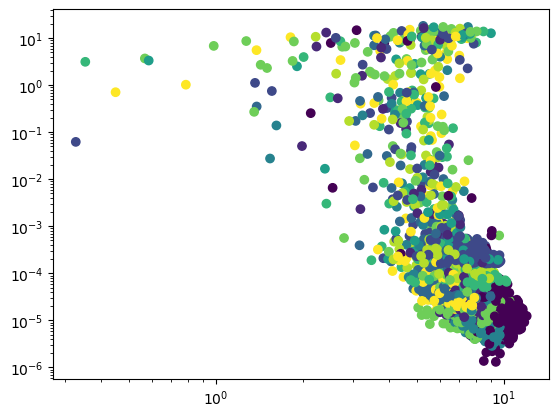

In [ ]:
n,p = model(x_test)
plt.scatter(torch.log(n).cpu().detach(),(-torch.log(p[torch.arange(p.shape[0]),y_test])).cpu().detach(), c=y_test.cpu().detach())
plt.yscale('log')
plt.xscale('log')

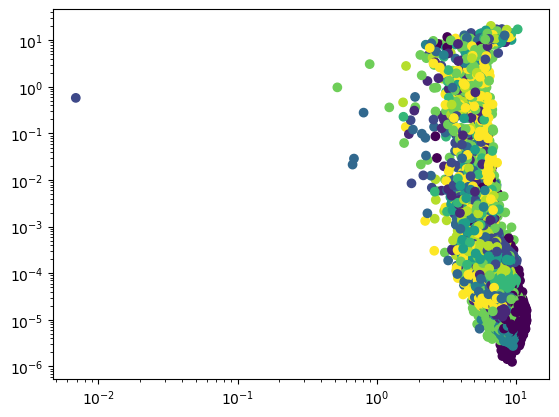

In [ ]:
n,p = model(x_train)
plt.scatter(torch.log(n).cpu().detach(),(-torch.log(p[torch.arange(p.shape[0]),y_train])).cpu().detach(), c=y_train.cpu().detach())
plt.yscale('log')
plt.xscale('log')

In [ ]:
scipy.stats.linregress(torch.sqrt(n).view(-1).cpu().detach(),(-torch.log(p[torch.arange(p.shape[0]),y_test])).view(-1).cpu().detach())

LinregressResult(slope=-0.0042021880910789325, intercept=0.4371320322876631, rvalue=-0.1327140357001789, pvalue=1.5753747821667214e-40, stderr=0.0003138653444842077, intercept_stderr=0.024253682103448086)

In [ ]:
scipy.stats.linregress(n.view(-1).cpu().detach(),(-torch.log(p[torch.arange(p.shape[0]),y_test])).view(-1).cpu().detach())

LinregressResult(slope=-8.5209012717378e-06, intercept=0.21313060071628356, rvalue=-0.06552634102254454, pvalue=5.4219104144107465e-11, stderr=1.2977130638118397e-06, intercept_stderr=0.015133346018552526)

In [ ]:
scipy.stats.linregress(torch.log(n).view(-1).cpu().detach(),(-torch.log(p[torch.arange(p.shape[0]),y_test])).view(-1).cpu().detach())

LinregressResult(slope=-0.2693596647898704, intercept=2.323652650116236, rvalue=-0.25436409392155396, pvalue=1.892677656095893e-147, stderr=0.010242250751708195, intercept_stderr=0.0831461404954673)

In [ ]:
scipy.stats.linregress(torch.log(torch.log(n)).view(-1).cpu().detach(),(-torch.log(p[torch.arange(p.shape[0]),y_test])).view(-1).cpu().detach())

LinregressResult(slope=nan, intercept=nan, rvalue=nan, pvalue=nan, stderr=nan, intercept_stderr=nan)

In [ ]:
torch.sqrt(n).view(-1).cpu().detach()

tensor([ 25.1907,  42.9610,  44.8431,  ...,  37.4591,  50.9036, 145.9310])

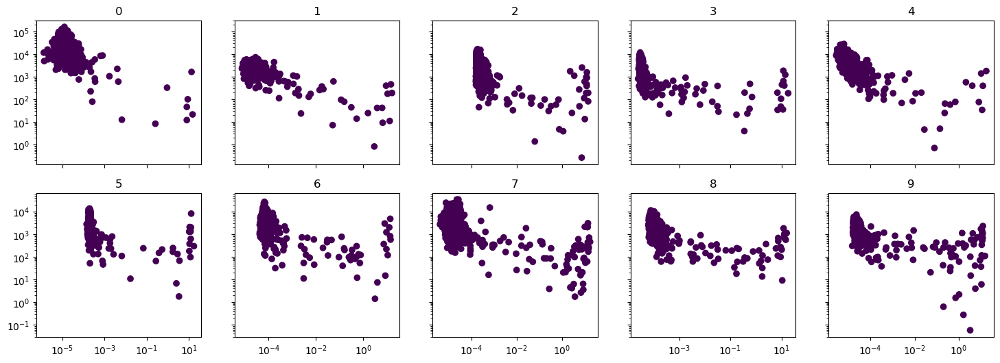

In [ ]:
fig, axes = plt.subplots(2,5, sharex='col', sharey='row',figsize=(18,6))
for i in range(10):
    ax = axes[i//5, i%5]
    ax.scatter((-torch.log(p[torch.arange(p.shape[0]),y_test])[y_test==i]).cpu().detach(), (n[y_test==i]).cpu().detach(), c=y_test[y_test==i].cpu())
    ax.set_yscale('log')
    ax.set_xscale('log')
    ax.set_title(i)

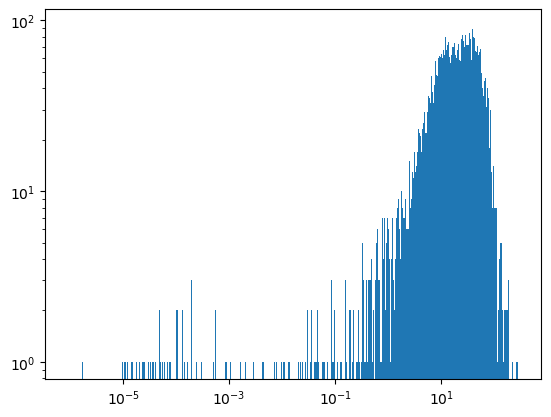

In [ ]:
plt.hist((p[torch.arange(p.shape[0]),y_test]*n.view(-1)).cpu().detach(),bins = logbins)
plt.yscale('log')
plt.xscale('log')

In [ ]:
p[torch.arange((p[torch.arange(p.shape[0]),y_test]*n.view(-1)).min(),(p[torch.arange(p.shape[0]),y_test]*n.view(-1)).max())

SyntaxError: incomplete input (2816539692.py, line 1)

tensor([1.1701e-14, 1.8459e-14, 2.9121e-14, 4.5941e-14, 7.2476e-14, 1.1434e-13,
        1.8038e-13, 2.8456e-13, 4.4892e-13, 7.0821e-13, 1.1173e-12, 1.7626e-12,
        2.7806e-12, 4.3867e-12, 6.9204e-12, 1.0917e-11, 1.7223e-11, 2.7171e-11,
        4.2865e-11, 6.7623e-11, 1.0668e-10, 1.6830e-10, 2.6551e-10, 4.1886e-10,
        6.6079e-10, 1.0425e-09, 1.6446e-09, 2.5945e-09, 4.0930e-09, 6.4570e-09,
        1.0187e-08, 1.6070e-08, 2.5352e-08, 3.9995e-08, 6.3096e-08, 9.9539e-08,
        1.5703e-07, 2.4773e-07, 3.9082e-07, 6.1655e-07, 9.7266e-07, 1.5345e-06,
        2.4208e-06, 3.8189e-06, 6.0247e-06, 9.5045e-06, 1.4994e-05, 2.3655e-05,
        3.7317e-05, 5.8872e-05, 9.2875e-05, 1.4652e-04, 2.3115e-04, 3.6465e-04,
        5.7527e-04, 9.0754e-04, 1.4317e-03, 2.2587e-03, 3.5633e-03, 5.6213e-03,
        8.8682e-03, 1.3990e-02, 2.2071e-02, 3.4819e-02, 5.4930e-02, 8.6657e-02,
        1.3671e-01, 2.1567e-01, 3.4024e-01, 5.3676e-01, 8.4678e-01, 1.3359e+00,
        2.1075e+00, 3.3247e+00, 5.2450e+

In [ ]:
(p[torch.arange(p.shape[0]),y_test]*n.view(-1)).max().item()

289.914306640625

In [ ]:
(p[torch.arange(p.shape[0]),y_test]*n.view(-1)).min().item()

8.902335366656189e-07

In [ ]:
(p[torch.arange(p.shape[0]),y_test]*n.view(-1)).min()

tensor(8.9023e-07, device='mps:0', grad_fn=<MinBackward1>)

In [ ]:
n,p = model(x_test)
-torch.sqrt(p[torch.arange(p.shape[0]),y_test]*n.view(-1))

tensor([-1.9055, -5.0034, -6.2839,  ..., -3.7141, -2.9646, -3.5130],
       device='mps:0', grad_fn=<NegBackward0>)

In [ ]:
p[torch.arange(p.shape[0]),y_test]

tensor([0.9994, 0.9994, 0.9998,  ..., 0.9995, 1.0000, 0.9999], device='mps:0',
       grad_fn=<IndexBackward0>)

In [ ]:
x=torch.randn(1000)

act(x)

tensor([ 0.3923,  1.2304,  2.0224,  2.6539,  1.2487, -1.1229, -0.7440, -1.5398,
        -2.1913,  0.7430,  1.5233,  2.3854,  0.1690,  0.0826,  3.0000, -2.0374,
        -0.6052, -0.3171,  0.8037,  2.4754, -2.0840, -0.2133,  2.0581, -1.0101,
        -2.2476,  0.6340,  1.2336,  0.7906, -2.6191,  0.2388, -0.5183, -2.0336,
        -0.5434,  0.3461,  1.2293,  2.7212,  2.0554,  2.7861,  2.6641,  0.4381,
         0.9625, -0.3476, -0.5570, -2.8337, -1.9760, -2.1002,  1.9254, -0.1400,
         2.5069,  2.0723, -0.0181, -2.0629,  3.6494, -2.4057,  1.6362, -0.6377,
         1.4736,  2.3368, -1.6304,  2.3708, -0.5092, -1.4065,  0.2186,  2.0241,
         3.2071, -0.9032,  3.6086, -0.0953, -1.6123, -1.5268, -2.4343, -2.4760,
         0.5794,  0.7986, -0.5742, -2.1070,  0.9182,  1.8184, -0.3645,  1.3195,
         2.1123,  1.3475, -0.3098, -1.1953,  2.1599,  0.7723, -1.3034,  3.3171,
         0.6968,  2.8468,  0.1179, -0.8758, -0.8454, -0.0164, -2.3389,  1.1698,
        -2.5544,  0.3067, -2.0145,  2.20

In [ ]:
nn.functional.nll_loss(p[:1], y_test[:1])

tensor(-0.0001, device='mps:0', grad_fn=<NllLossBackward0>)

(array([ 262.,  137.,  122.,  109.,  106.,  105.,   93.,   88.,  112.,
          91.,  100.,   93.,   87.,   75.,   66.,   82.,   98.,   73.,
          89.,   79.,   86.,   78.,   80.,   57.,   88.,   95.,   79.,
          88.,   86.,   67.,   72.,   74.,   75.,   81.,   81.,   81.,
          86.,   69.,   98.,   86.,   79.,   90.,   77.,   92.,   88.,
          64.,   88.,   97.,   98.,   88.,   77.,   92.,   75.,   99.,
          95.,   98.,  102.,   93.,   83.,  101.,  106.,  103.,   86.,
         107.,   91.,  116.,  104.,  107.,  126.,  122.,  103.,  117.,
         146.,  118.,  110.,  125.,  116.,  122.,  131.,  128.,  111.,
         105.,  153.,  135.,  116.,  145.,  118.,  140.,  169.,  142.,
         129.,  131.,  163.,  169.,  141.,  142.,  151.,  171.,  167.,
         143.,  169.,  192.,  192.,  177.,  181.,  208.,  173.,  182.,
         192.,  196.,  178.,  212.,  201.,  225.,  213.,  216.,  248.,
         240.,  212.,  253.,  255.,  256.,  245.,  262.,  269.,  265.,
      

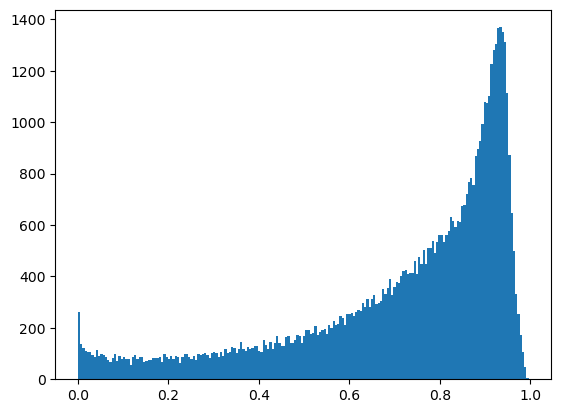

In [ ]:
n,p = model(x_train)
plt.hist(p[torch.arange(p.shape[0]),y_train].cpu().detach(), bins=200)

(array([88.,  6.,  0.,  1.,  0.,  0.,  1.,  0.,  2.,  2.]),
 array([4.87857278e-06, 9.41922963e-02, 1.88379705e-01, 2.82567114e-01,
        3.76754552e-01, 4.70941961e-01, 5.65129399e-01, 6.59316778e-01,
        7.53504217e-01, 8.47691596e-01, 9.41879034e-01]),
 <BarContainer object of 10 artists>)

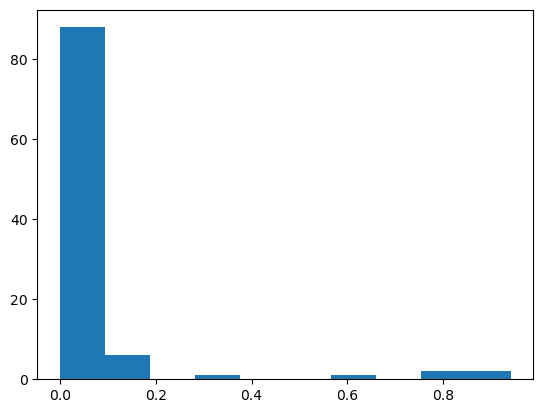

In [ ]:
p[:1]

tensor([[7.2376e-05, 1.0281e-04, 2.8496e-05, 9.9962e-01, 5.3647e-06, 1.2347e-05,
         1.6241e-05, 1.1171e-04, 8.9031e-08, 3.3811e-05]], device='mps:0',
       grad_fn=<SliceBackward0>)

In [ ]:
y_test[:1]

tensor([7], device='mps:0')

In [ ]:
p[torch.arange(x_train_batch.size(0)).unsqueeze(1), y_train_batch]

tensor([[1.7350e-01, 2.0985e-01, 8.3218e-02,  ..., 3.3378e-02, 9.5333e-02,
         3.3378e-02],
        [5.5000e-03, 2.7143e-01, 1.3735e-02,  ..., 9.3895e-02, 9.5584e-02,
         9.3895e-02],
        [2.3710e-02, 1.9366e-02, 9.9844e-02,  ..., 2.2553e-01, 1.4959e-01,
         2.2553e-01],
        ...,
        [9.9779e-02, 9.2894e-02, 2.1422e-03,  ..., 9.1250e-02, 1.4847e-01,
         9.1250e-02],
        [1.2167e-05, 4.9528e-02, 1.2332e-01,  ..., 4.3094e-01, 9.1068e-02,
         4.3094e-01],
        [1.5612e-01, 6.2260e-02, 1.1646e-01,  ..., 5.0778e-03, 2.0178e-02,
         5.0778e-03]], device='mps:0', grad_fn=<IndexBackward0>)

In [ ]:
p[:2][:,y_train_batch[:2]]

tensor([[0.1735, 0.2099],
        [0.0055, 0.2714]], device='mps:0', grad_fn=<IndexBackward0>)

In [ ]:
p[:2]

tensor([[0.0246, 0.1735, 0.1669, 0.2099, 0.0832, 0.0334, 0.0953, 0.0129, 0.1827,
         0.0176],
        [0.2317, 0.0055, 0.1410, 0.2714, 0.0137, 0.0939, 0.0956, 0.0160, 0.1107,
         0.0204]], device='mps:0', grad_fn=<SliceBackward0>)

In [ ]:
p[y_train_batch.unsqueeze(-1)]

tensor([[[2.3169e-01, 5.5000e-03, 1.4102e-01, 2.7143e-01, 1.3735e-02,
          9.3895e-02, 9.5584e-02, 1.5955e-02, 1.1075e-01, 2.0440e-02]],

        [[7.1387e-02, 9.5835e-02, 1.7482e-01, 2.5136e-01, 6.9281e-02,
          1.1440e-01, 2.9985e-03, 5.9907e-03, 1.8083e-01, 3.3099e-02]],

        [[6.2274e-02, 1.5370e-01, 9.3011e-02, 3.1308e-03, 2.0306e-01,
          9.0633e-02, 4.6815e-02, 3.9389e-02, 1.4655e-01, 1.6144e-01]],

        [[7.1387e-02, 9.5835e-02, 1.7482e-01, 2.5136e-01, 6.9281e-02,
          1.1440e-01, 2.9985e-03, 5.9907e-03, 1.8083e-01, 3.3099e-02]],

        [[5.0234e-03, 4.8850e-02, 4.7354e-02, 4.4158e-02, 1.3664e-01,
          1.9489e-01, 1.1586e-01, 1.6717e-02, 1.3235e-01, 2.5816e-01]],

        [[7.1387e-02, 9.5835e-02, 1.7482e-01, 2.5136e-01, 6.9281e-02,
          1.1440e-01, 2.9985e-03, 5.9907e-03, 1.8083e-01, 3.3099e-02]],

        [[6.2274e-02, 1.5370e-01, 9.3011e-02, 3.1308e-03, 2.0306e-01,
          9.0633e-02, 4.6815e-02, 3.9389e-02, 1.4655e-01, 1.6144e-01]],


In [ ]:
-torch.log(p[torch.arange(p.shape[0]),y_train_batch]).mean()

tensor(2.2318, device='mps:0', grad_fn=<NegBackward0>)

In [ ]:
p.shape

torch.Size([100, 10])

In [ ]:
y_train_batch[:10]

tensor([1, 3, 4, 3, 8, 3, 4, 0, 0, 8], device='mps:0')

In [ ]:
p

tensor([[2.4632e-02, 1.7350e-01, 1.6694e-01, 2.0985e-01, 8.3218e-02, 3.3378e-02,
         9.5333e-02, 1.2895e-02, 1.8268e-01, 1.7575e-02],
        [2.3169e-01, 5.5000e-03, 1.4102e-01, 2.7143e-01, 1.3735e-02, 9.3895e-02,
         9.5584e-02, 1.5955e-02, 1.1075e-01, 2.0440e-02],
        [1.1873e-02, 2.3710e-02, 2.2690e-06, 1.9366e-02, 9.9844e-02, 2.2553e-01,
         1.4959e-01, 6.3551e-02, 7.5916e-02, 3.3061e-01],
        [7.1387e-02, 9.5835e-02, 1.7482e-01, 2.5136e-01, 6.9281e-02, 1.1440e-01,
         2.9985e-03, 5.9907e-03, 1.8083e-01, 3.3099e-02],
        [6.2274e-02, 1.5370e-01, 9.3011e-02, 3.1308e-03, 2.0306e-01, 9.0633e-02,
         4.6815e-02, 3.9389e-02, 1.4655e-01, 1.6144e-01],
        [4.2175e-02, 1.0392e-01, 7.2630e-04, 1.1416e-01, 1.0596e-01, 9.0772e-02,
         3.2737e-01, 2.0220e-03, 2.0537e-01, 7.5185e-03],
        [1.7664e-02, 1.4859e-02, 2.9257e-02, 1.0066e-01, 3.2922e-02, 6.9654e-02,
         2.1699e-01, 2.1779e-01, 2.5918e-01, 4.1014e-02],
        [8.4722e-02, 2.0156

In [ ]:
y_train_batch.unsqueeze(-1).shape

torch.Size([100, 1])

In [ ]:
y_train_batch[:2]

tensor([1, 3], device='mps:0')

In [ ]:
p[y_train_batch.unsqueeze(0)].shape

torch.Size([1, 100, 10])

In [ ]:
p[:,y_train_batch]

tensor([[8.0063e-01, 1.2594e-02, 3.0462e-02,  ..., 5.6745e-03, 8.0063e-01,
         5.6745e-03],
        [2.0477e-04, 2.9866e-01, 1.0993e-04,  ..., 3.8420e-01, 2.0477e-04,
         3.8420e-01],
        [8.7198e-02, 3.9500e-02, 4.4437e-01,  ..., 7.4237e-03, 8.7198e-02,
         7.4237e-03],
        ...,
        [9.0586e-04, 4.1175e-02, 3.8319e-02,  ..., 6.2268e-01, 9.0586e-04,
         6.2268e-01],
        [7.5995e-01, 2.3664e-05, 9.0275e-04,  ..., 9.5114e-05, 7.5995e-01,
         9.5114e-05],
        [5.8167e-03, 6.1912e-02, 7.3116e-03,  ..., 8.0111e-01, 5.8167e-03,
         8.0111e-01]], device='mps:0', grad_fn=<IndexBackward0>)

In [ ]:
y_train_batch.shape

torch.Size([100])

In [ ]:
p_hat, p_0 = torch.rand(1000), torch.rand(1000)
n_hat, n_0 = torch.exp(torch.randn(1000)+3), torch.exp(torch.randn(1000)+3)

In [ ]:
def a(p_hat, n_0, p_0):
    return p_0*(torch.digamma(p_0*n_0+1)-torch.log(p_hat)) + (1-p_0)*(torch.digamma((1-p_0)*n_0+1)-torch.log(1-p_hat))-torch.digamma(n_0+1)

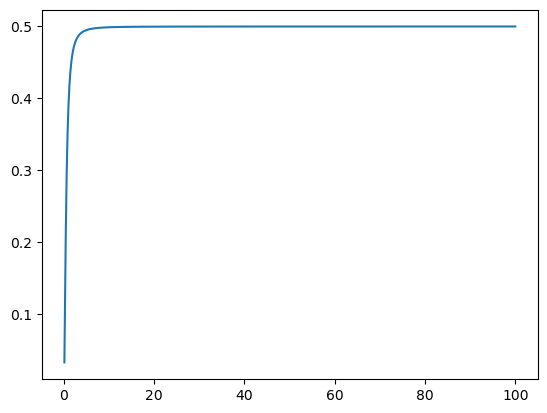

In [ ]:
p_0 = torch.ones(1000)*.1
n_0 = torch.linspace(0, 100, 1000)
b = a(p_0, n_0, p_0)
n_div = n_0/2*(2*b*n_0-1)*torch.polygamma(3,n_0)+(4*b*n_0-3/2)*torch.polygamma(2,n_0) + 2*b*torch.polygamma(1,n_0)
plt.plot(n_0, n_div*n_0**2)